In [1]:
from PIL import Image, ImageDraw
import random
import seaborn as sns
import cProfile
import pstats
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt

def matrix(string):
    return np.array(list(map(int, string.replace('\xa0','0').split(','))))

class Nonogram:
    def __init__(self, height = 30, width = 30, step_size = 25):
        
        image = Image.new(mode='L', size=(height* step_size, width * step_size), color=255)

        # Draw some lines
        draw = ImageDraw.Draw(image)
        y_start = 0
        y_end = image.height

        for x in range(0, image.width, step_size):
            line = ((x, y_start), (x, y_end))
            draw.line(line, fill=128)

        x_start = 0
        x_end = image.width

        for y in range(0, image.height, step_size):
            line = ((x_start, y), (x_end, y))
            draw.line(line, fill=128)
        
        self.step_size = step_size
        self.imgdraw = ImageDraw.Draw(image)
        self.image = image  
        
    def color(self,i,j):        
        self.imgdraw.rectangle([(i * self.step_size, j * self.step_size),((i + 1) * self.step_size,(j + 1) *self.step_size)], fill = 0)
    

    def draw(self,i,j,text):
        i= (i + 0.4) * self.step_size
        j= (j + 0.3) * self.step_size
        self.imgdraw.text((i,j), text, fill =0)

    def matrixdraw(self,M, start = (0,0)):
        for i, m in enumerate(M):
            for j, v in enumerate(m):
                self.draw(i + start[0],j + start[1],str(v) if v != 0 else '')


class Matrix(Nonogram):
    def __init__(self,data):
        size = (data['sizeCol'],data['sizeRow'])
        c = matrix(data['colClues']).reshape(size[0],-1).T
        r = matrix(data['rowClues']).reshape(-1,size[1]).T
        super().__init__(r.shape[0] + c.shape[0],r.shape[1] + c.shape[1])
        self.matrixdraw(r, start = (c.shape[0],0))
        self.matrixdraw(c, start = (0,r.shape[1]))
        self.emptyshape = (c.shape[0],r.shape[1])
        self.c = c.T
        self.r = r
        self.difficulty = data['difficulty']
        self.shape = (c.shape[1],r.shape[0])
        self.solution = data['solution']
        self.imagecopy = self.image.copy()
        self.R = [{'len':len([c for c in r if c!=0]),
                 'sum': sum(r),
                 'entity':np.array([[c] for c in r if c!=0])} for r in self.r]
        self.C = [{'len':len([c for c in r if c!=0]),
                 'sum': sum(r),
                 'entity':np.array([[c] for c in r if c!=0])} for r in self.c]
        
    def Mdraw(self,M = None):
        if(M is None):
            M = np.zeros(self.shape)
            
        self.image = self.imagecopy.copy()
        self.imgdraw = ImageDraw.Draw(self.image)
        M = M.T
        for i, m in enumerate(M):
            for j, v in enumerate(m):
                if(v):
                    self.color(i + self.emptyshape[0],j + self.emptyshape[1])
        return self.image
                    



In [2]:
def Stats(f):
    profile = cProfile.Profile()
    profile.runcall(f)
    ps = pstats.Stats(profile)
    ps.print_stats()

In [3]:
class AIC:    
#     def sort(self,M):
#         n = np.prod(self.shape)
#         A = np.zeros(n-len(M),dtype = int)
#         for m in M:
#             A = np.insert(A, m,1)
#         return np.flatnonzero(A)

    def sort(self,s):
        s = np.sort(s)
        while True:
          dp = np.flatnonzero(s[1:] == s[:-1])
          if(not len(dp)): break        
          s[dp]-=1 
        return s
    
    def __init__(self, M):
        minim = np.zeros(M.shape,dtype=bool)
        maxim = np.zeros(M.shape,dtype=bool)
        for i,c in enumerate(M.C):
            maxim[i][-c['len']-c['sum']+1:-c['sum']+1] = True
            minim[i][:c['len']] = True
        self.maxim = np.flatnonzero(maxim)
        self.minim = np.flatnonzero(minim)     
        self.M = M
        self.shape = M.shape
                
        mask = np.ones(M.shape,dtype=bool)
        nmask = np.ones(M.shape,dtype=bool)
        for i,c in enumerate(M.C):
            if(1-c['sum']):
             mask[i][-c['sum']+1:] = False
            nmask[i][c['len']:] = False
        self.mask = mask
        self.nmask = nmask     
    
    def generate(self):
        diff = self.maxim - self.minim        
        return self.sort(self.minim + np.round(diff * np.random.rand(*diff.shape)).astype(int))

    def unmaskop(row, arr):
        (iones,) = np.where(row)
        shift = np.roll(arr,1)
        shift[0] = 0
        iones = 2**(iones +np.cumsum(shift) )      
        return AIC.binify(np.sum((2**(arr)-1)*iones),len(row))
    
    def unmask(self,arr):
        M = np.bincount(arr).astype(bool)
        M.resize(self.shape)
        return np.vstack([AIC.unmaskop(m,n[n!=0]) for m,n in zip(M,self.M.c)])

    def boundary(self,M):
        return np.minimum(np.maximum(M,self.minim),self.maxim)
    
    def crossover(self,M1,M2):
        mask = np.random.binomial(p=0.5,n=1,size = M1.shape).astype(bool)        
        return self.sort(M1*mask + M2*(1-mask))          
    

    def mutate(self,A,mrate):
        mask = np.random.binomial(p=mrate,n=1,size = A.shape).astype(bool)
        index = np.flatnonzero(mask)
        even = index[index%2==0]
        odd = index[index%2==1]
        return self.boundary(self.sort(self.hmutate(self.hmutate(A,odd),even)))

    def hmutate(self, A,pivot):
        last = False
        if(len(A)-1 in pivot):
            pivot = pivot[:-1]
            last = True
        maxim = np.minimum(A[pivot+1],self.maxim[pivot])
        minim = np.maximum(A[pivot-1],self.minim[pivot])
        if(0 in pivot):
            minim[0] = 0
        if(last):
            maxim = np.append(maxim,self.maxim[-1])
            minim = np.append(minim,A[-2])
            pivot = np.append(pivot,len(A)-1)

        diff = maxim - minim
        A[pivot] =  minim + np.ceil(diff * np.random.rand(len(diff))).astype(int)
        return A
          
    
    def binify(arr,n):
        return (np.array([*np.binary_repr(arr).zfill(n)]) == '1')[::-1]

class AIR(AIC):
    def __init__(self, M):
        shape = (M.shape[1],M.shape[0])
        minim = np.zeros(shape,dtype=bool)
        maxim = np.zeros(shape,dtype=bool)
        for i,c in enumerate(M.R):
            maxim[i][-c['len']-c['sum']+1:-c['sum']+1] = True
            minim[i][:c['len']] = True
        self.maxim = np.flatnonzero(maxim)
        self.minim = np.flatnonzero(minim)     
        self.M = M
        self.shape = shape      
        
        shape = (M.shape[1],M.shape[0])
        mask = np.ones(shape,dtype=bool)
        nmask = np.ones(shape,dtype=bool)
        for i,c in enumerate(M.R):
            if(1-c['sum']):
             mask[i][-c['sum']+1:] = False
            nmask[i][c['len']:] = False
        self.mask = mask
        self.nmask = nmask      
        self.M = M
        self.shape = M.shape
    
    def unmask(self,arr):
        M = np.bincount(arr).astype(bool)
        M.resize(self.shape)
        return np.vstack([AIC.unmaskop(m,n[n!=0]) for m,n in zip(M,self.M.r)]).T    


In [4]:
def LC(n,k):
    def LF(n):
        return np.sum(np.log(np.arange(1,n+1)))
    """
    logarithm of n choose k
    """
    return LF(n)-LF(k)-LF(n-k)


In [5]:
class Fitness:
    def setup(aic,air):
        C = np.array([LC(n,k) for n,k in zip(np.sum(aic.mask,1),np.sum(aic.nmask,1))])
        R = np.array([LC(n,k) for n,k in zip(np.sum(air.mask,1),np.sum(air.nmask,1))])
        FM = (C.reshape(-1,1) @ R.reshape(1,-1))
        FM[FM == 0] = 1/np.sum(FM)            
        Fitness.matrix = 1/FM
        Fitness.matrix = Fitness.matrix*0+1
        
    def goal():
        return np.sum(Fitness.matrix)
        
    def fitness(ai):
        return np.sum((~(ai.R & ai.C))* Fitness.matrix)    
    
class AI:
    def __init__(self,M,aic,air,C,R):
        self.M = M
        self.aic = aic
        self.air = air
        self._C = C
        self._R = R
        self.goal = Fitness.goal()
        
    @property
    def C(self):
        return self.aic.unmask(self._C)
    
    @property
    def R(self):
        return self.air.unmask(self._R)
    
    @property
    def fitness(self):
        return Fitness.fitness(self)

    def mutate(self, mrate = 0.05):        
        self._C,self._R = self.aic.mutate(self._C,mrate = mrate),self.air.mutate(self._R,mrate = mrate)
        return self
    
    @np.vectorize
    def crossover(self, ai2, mrate = 0.05):        
        C = self.aic.crossover(self._C,ai2._C)
        R = self.air.crossover(self._R,ai2._R)
        C,R = self.aic.mutate(C, mrate = mrate),self.air.mutate(R,mrate = mrate)        
        return AI(self.M,self.aic,self.air,C,R)
    
    def copy(self):
        ai =  AI(self.M,self.aic,self.air)
        ai._C = np.copy(self._C)
        ai._R = np.copy(self._R)
        return ai    
        
        

***goal**** 
1444.0
max fitness:  873.0 571.0


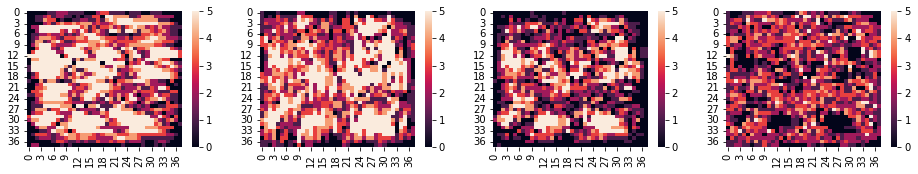

max fitness:  873.0 571.0
max fitness:  886.0 558.0
max fitness:  893.0 551.0
max fitness:  893.0 551.0
max fitness:  894.0 550.0
max fitness:  894.0 550.0
max fitness:  897.0 547.0
max fitness:  901.0 543.0
max fitness:  907.0 537.0
max fitness:  914.0 530.0


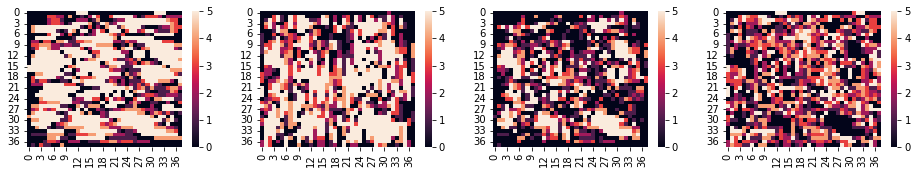

max fitness:  914.0 530.0
max fitness:  914.0 530.0
max fitness:  915.0 529.0
max fitness:  915.0 529.0
max fitness:  915.0 529.0
max fitness:  915.0 529.0
max fitness:  920.0 524.0
max fitness:  920.0 524.0
max fitness:  920.0 524.0
max fitness:  920.0 524.0


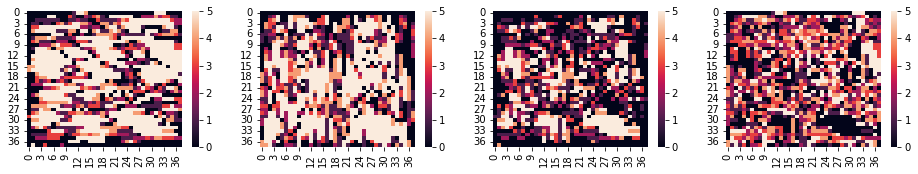

max fitness:  920.0 524.0
max fitness:  920.0 524.0
max fitness:  929.0 515.0
max fitness:  929.0 515.0
max fitness:  929.0 515.0
max fitness:  929.0 515.0
max fitness:  929.0 515.0
max fitness:  929.0 515.0
max fitness:  929.0 515.0
max fitness:  929.0 515.0


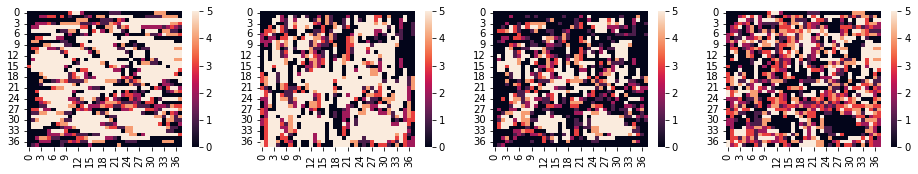

max fitness:  929.0 515.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0


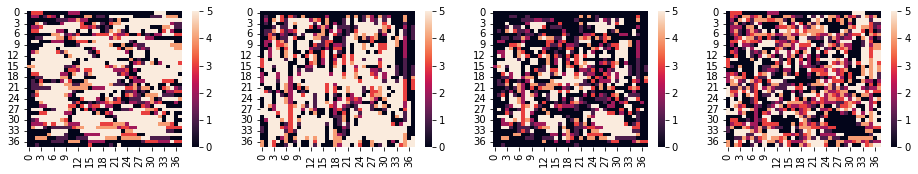

max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0
max fitness:  935.0 509.0


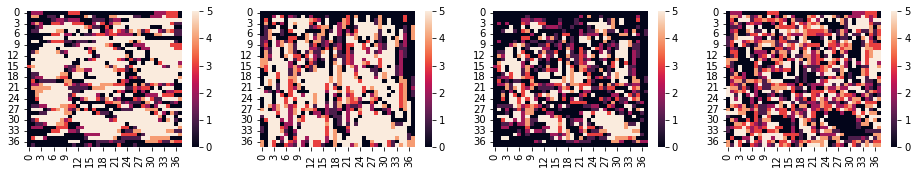

max fitness:  935.0 509.0
max fitness:  936.0 508.0
max fitness:  936.0 508.0
max fitness:  936.0 508.0
max fitness:  939.0 505.0
max fitness:  939.0 505.0
max fitness:  939.0 505.0
max fitness:  939.0 505.0
max fitness:  939.0 505.0
max fitness:  939.0 505.0


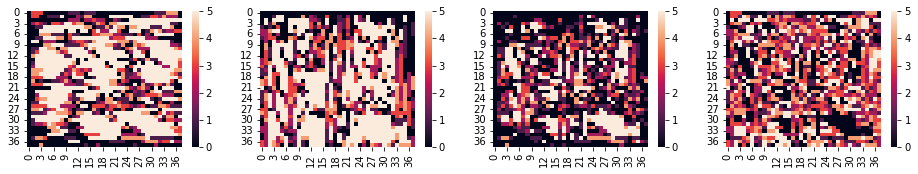

max fitness:  939.0 505.0
max fitness:  939.0 505.0
max fitness:  939.0 505.0
max fitness:  939.0 505.0
max fitness:  939.0 505.0
max fitness:  939.0 505.0
max fitness:  939.0 505.0
max fitness:  939.0 505.0
max fitness:  939.0 505.0
max fitness:  939.0 505.0


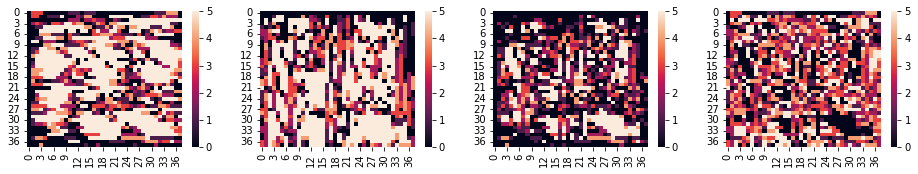

max fitness:  939.0 505.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0


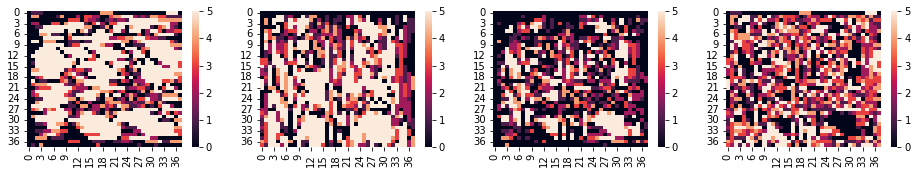

max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0


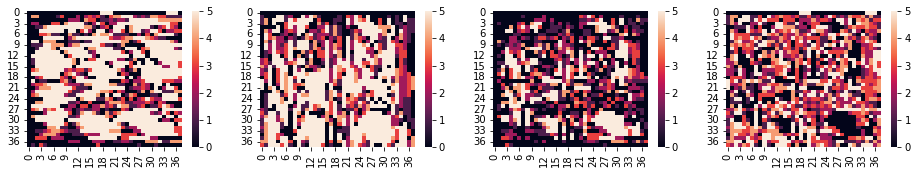

max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0


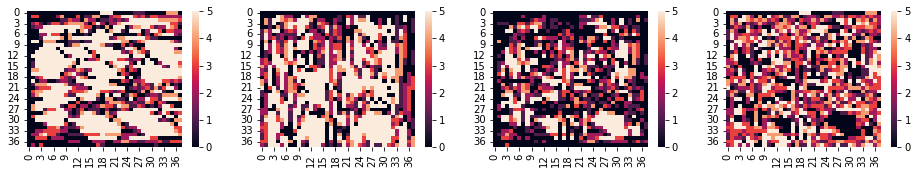

max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0


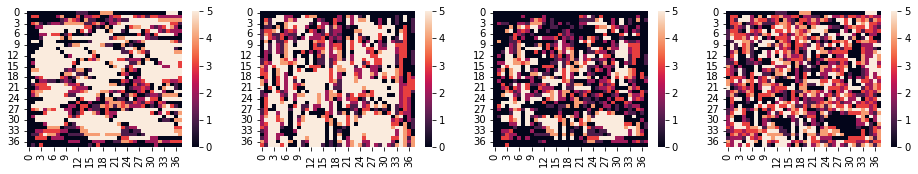

max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0


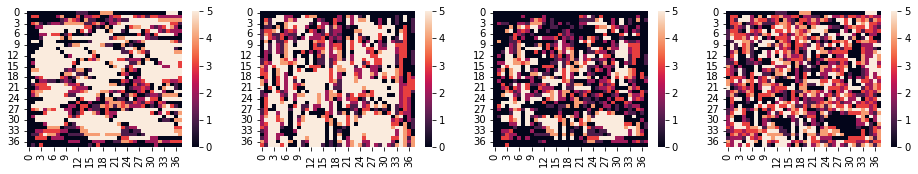

max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  941.0 503.0
max fitness:  945.0 499.0
max fitness:  945.0 499.0
max fitness:  945.0 499.0
max fitness:  945.0 499.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0


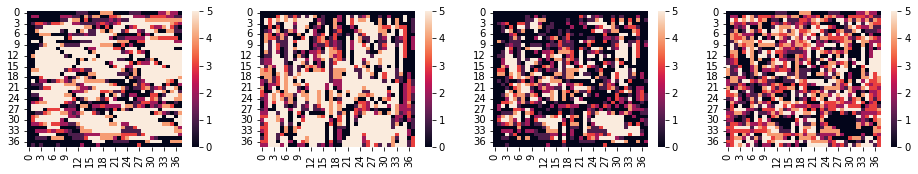

max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0


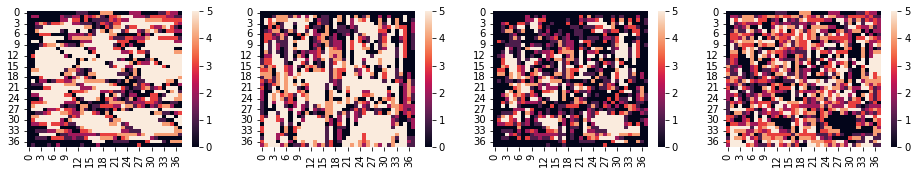

max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0


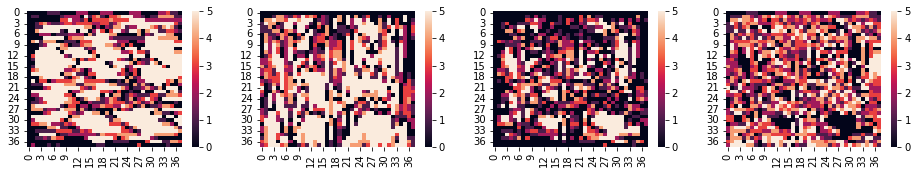

max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0


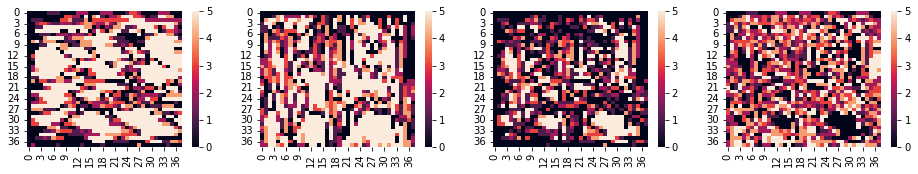

max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0


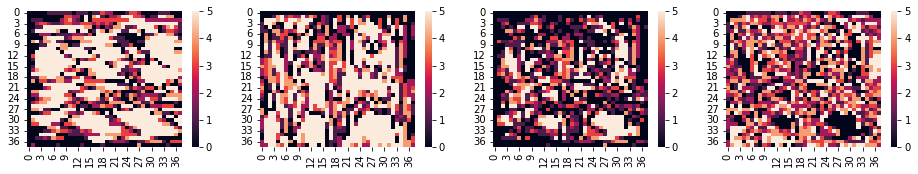

max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0


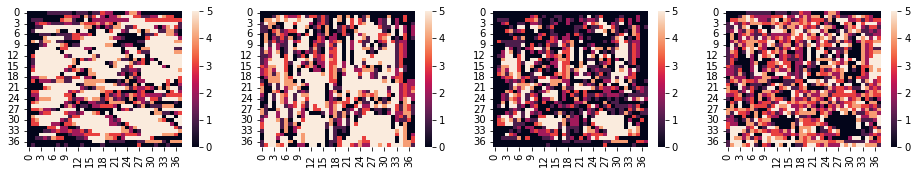

max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  950.0 494.0


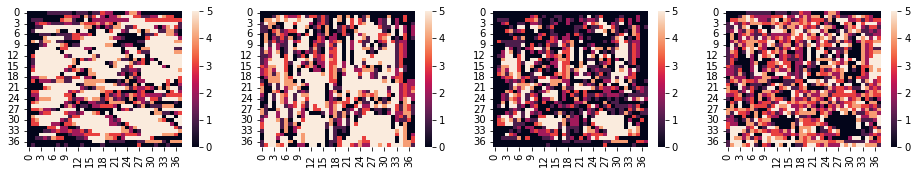

max fitness:  950.0 494.0
max fitness:  950.0 494.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0


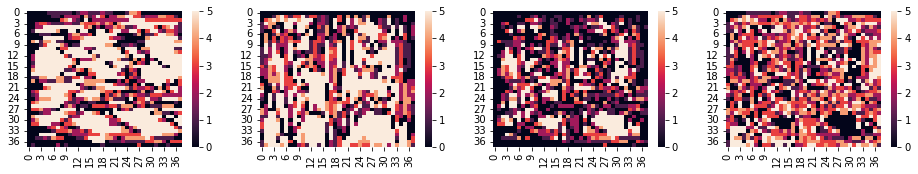

max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0
max fitness:  957.0 487.0


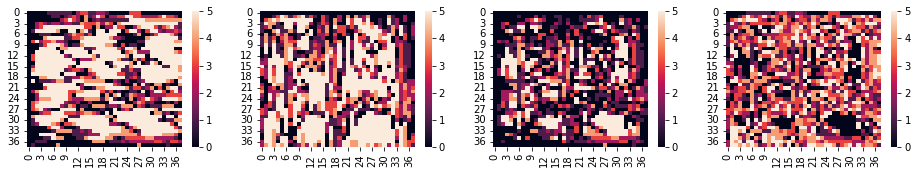

max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0


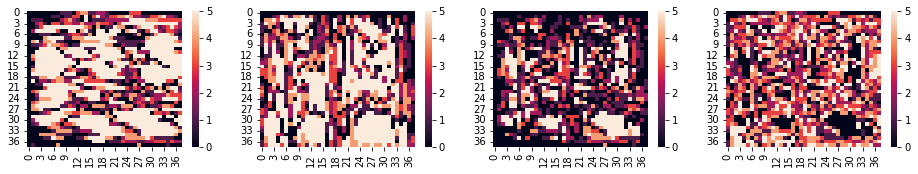

max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0


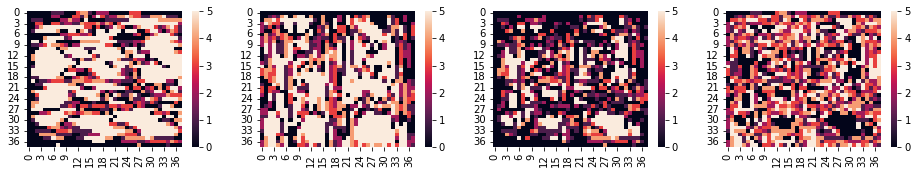

max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0


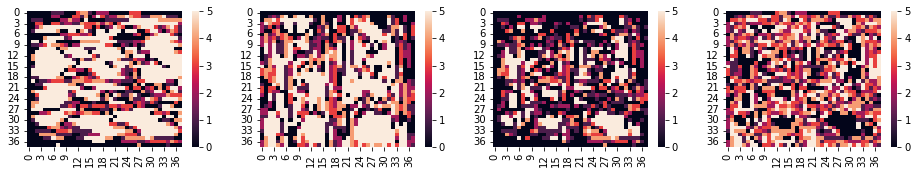

max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0


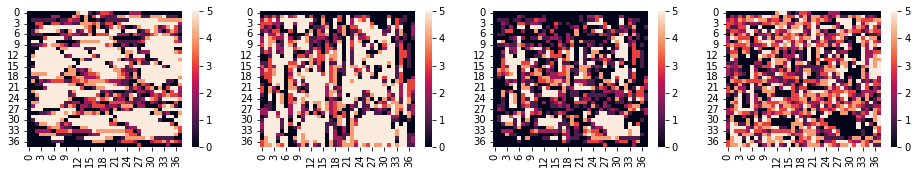

max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0


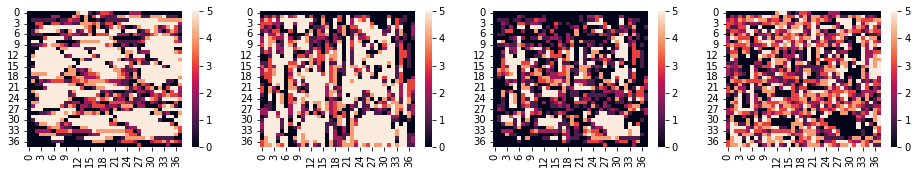

max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0


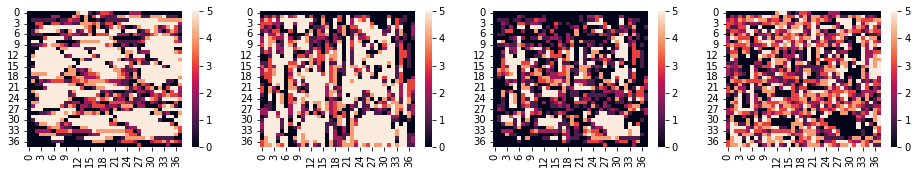

max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0


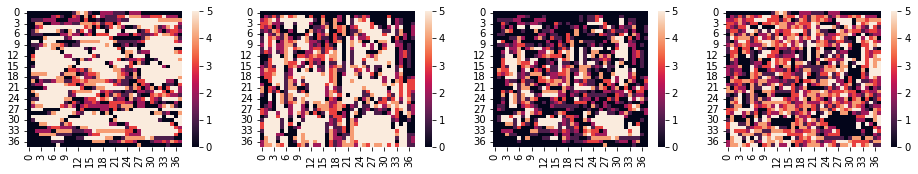

max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0


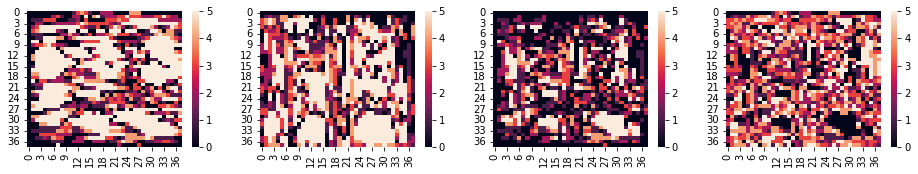

max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0


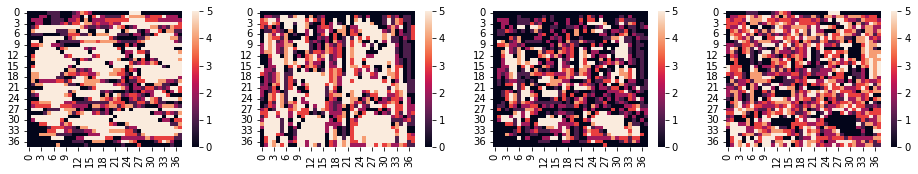

max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  959.0 485.0
max fitness:  961.0 483.0


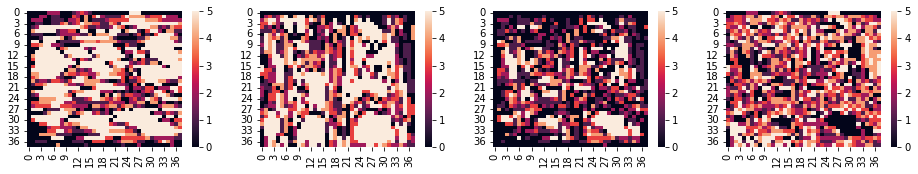

max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0


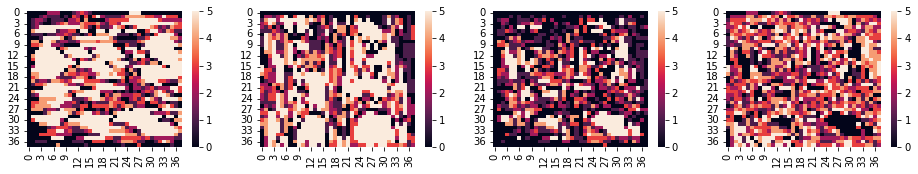

max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0


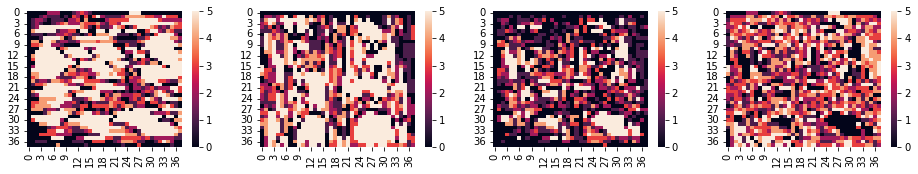

max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0


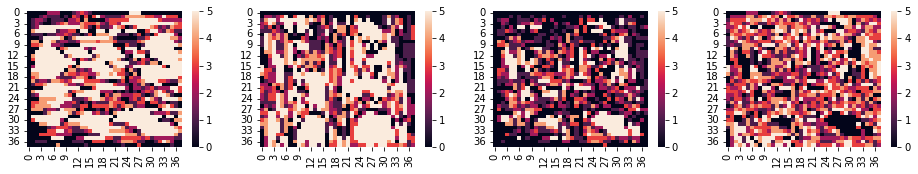

max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0
max fitness:  961.0 483.0


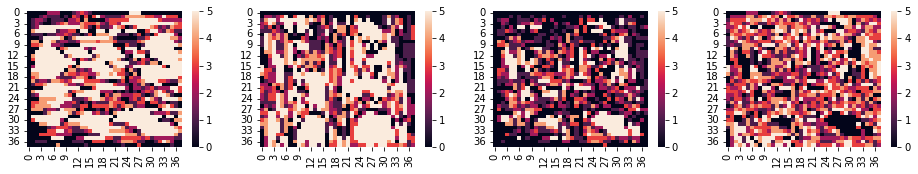

max fitness:  961.0 483.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0


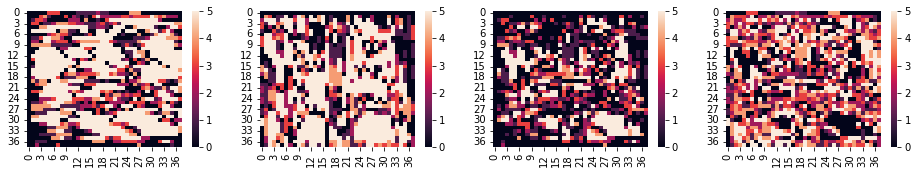

max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0


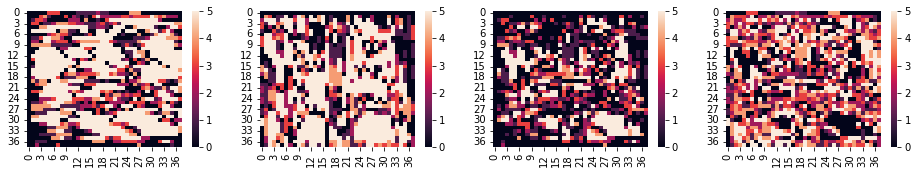

max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  962.0 482.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0


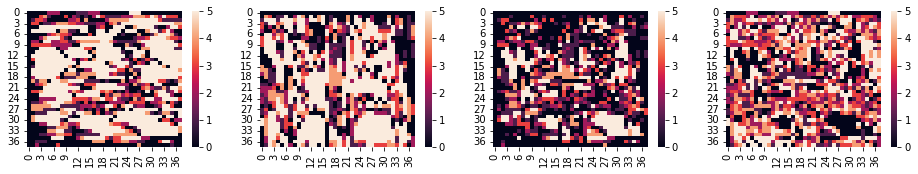

max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0


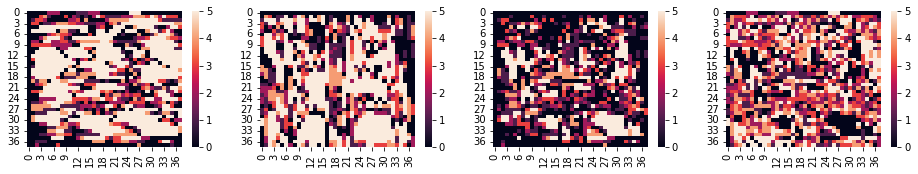

max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0


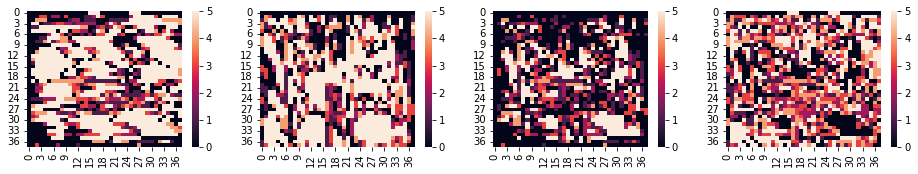

max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0


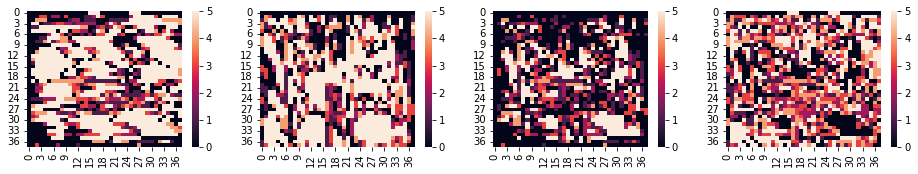

max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0


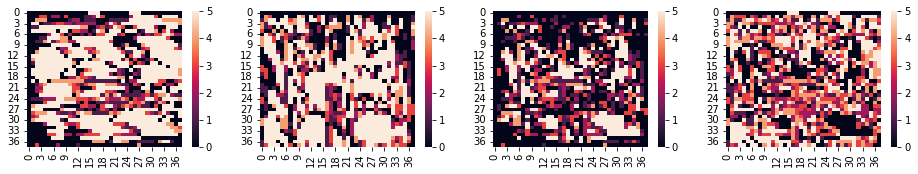

max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0


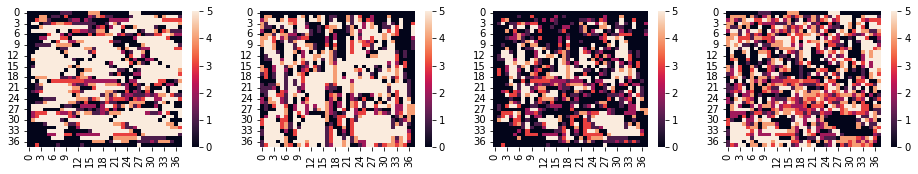

max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0


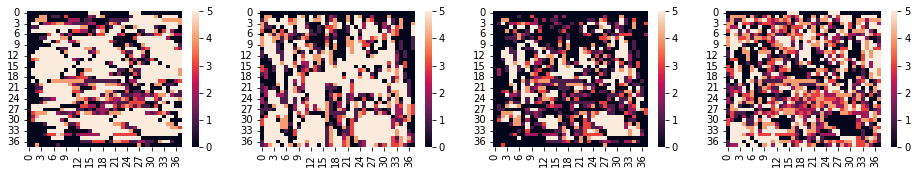

max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0


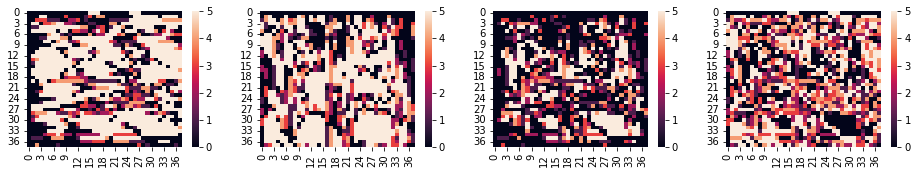

max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0


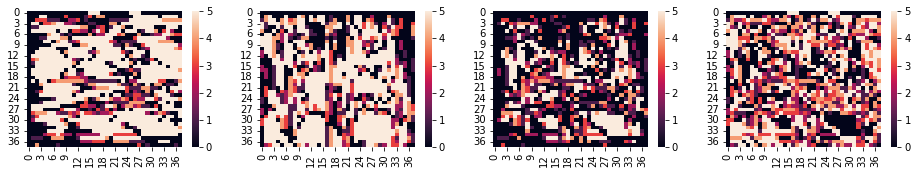

max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0


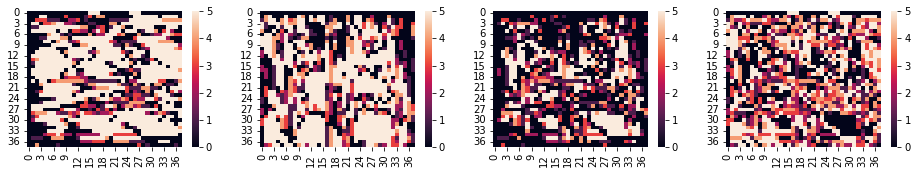

max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  963.0 481.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0


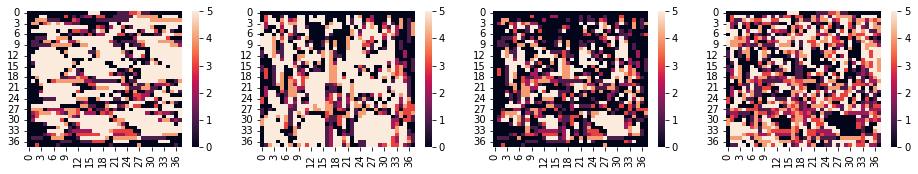

max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0


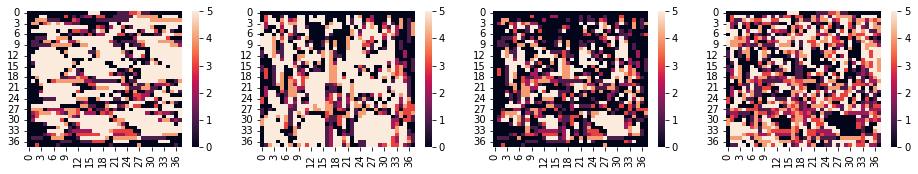

max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0


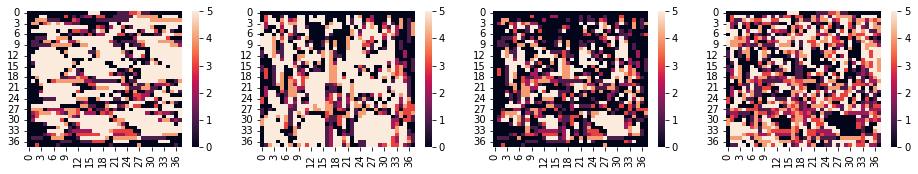

max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  964.0 480.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0


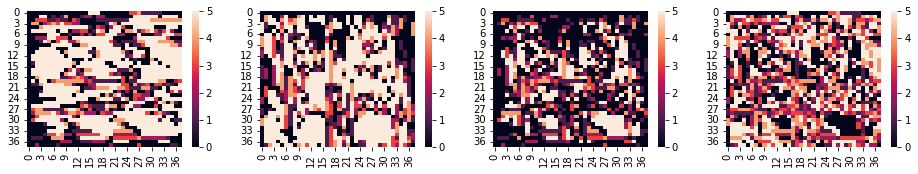

max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0


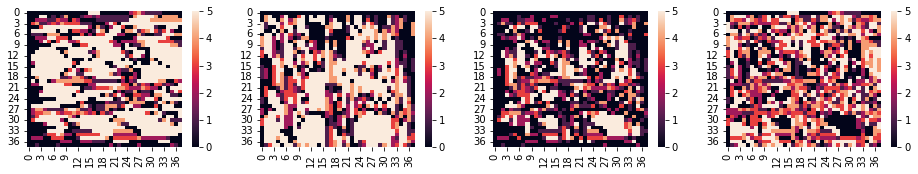

max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0


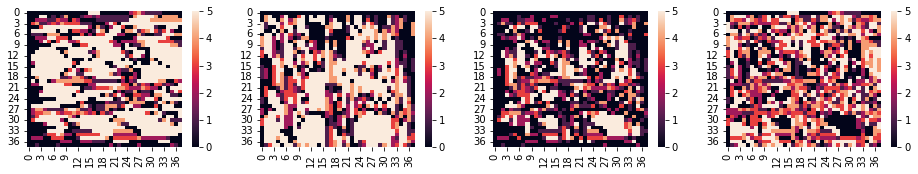

max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0


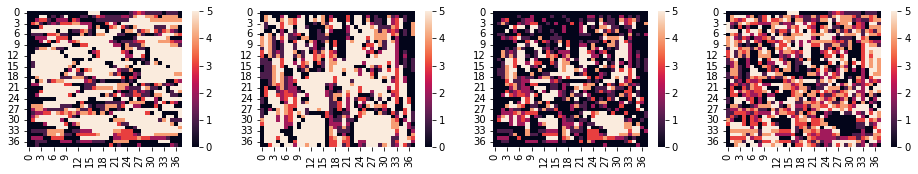

max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0


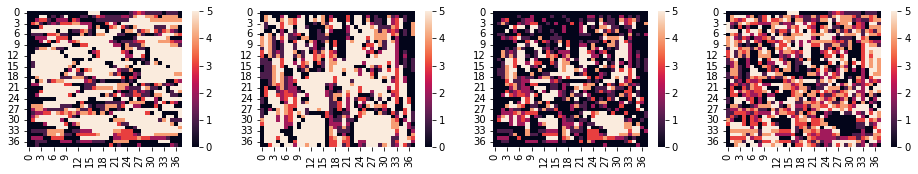

max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0


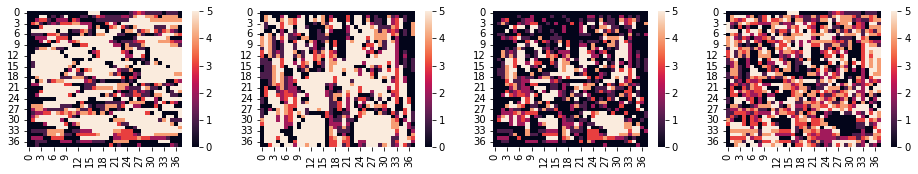

max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0


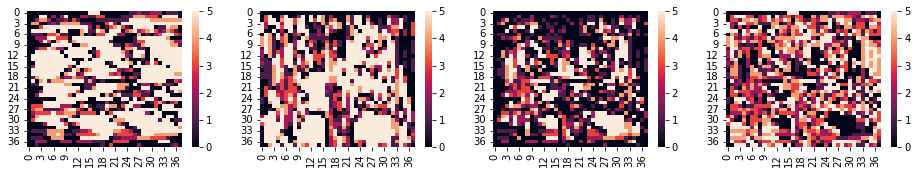

max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  965.0 479.0
max fitness:  969.0 475.0


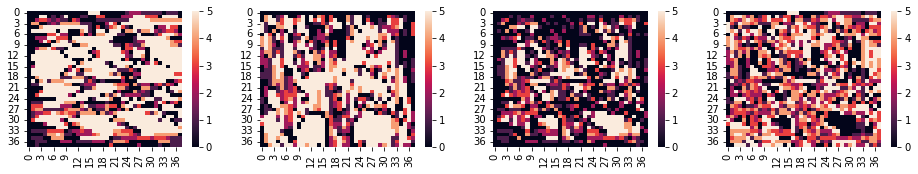

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


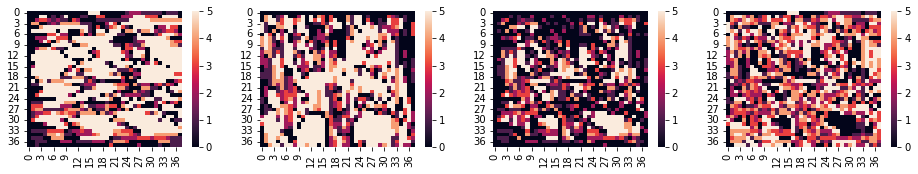

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


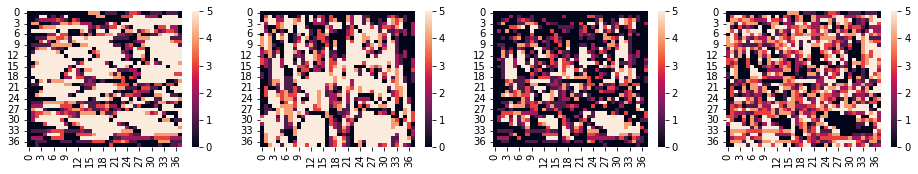

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


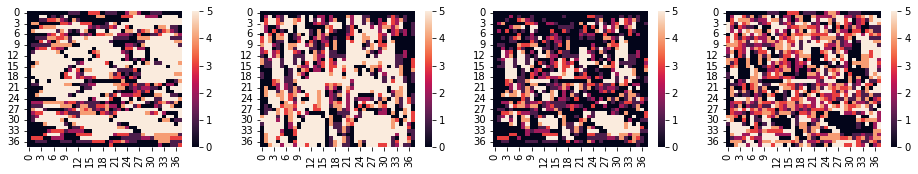

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


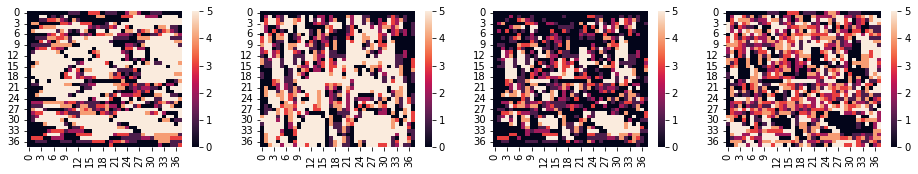

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


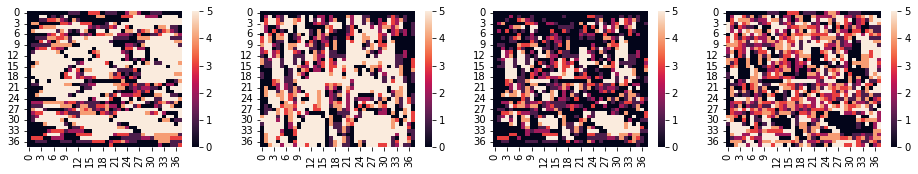

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


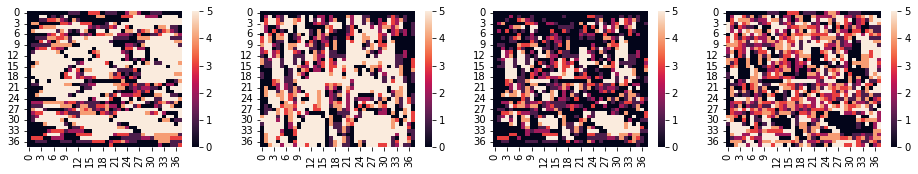

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


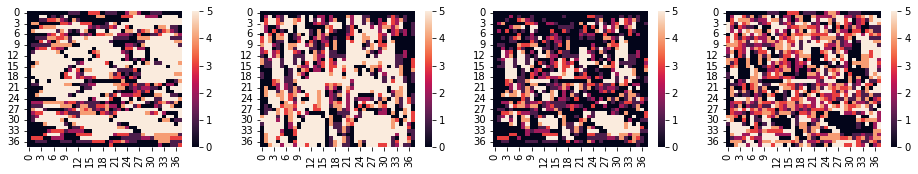

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


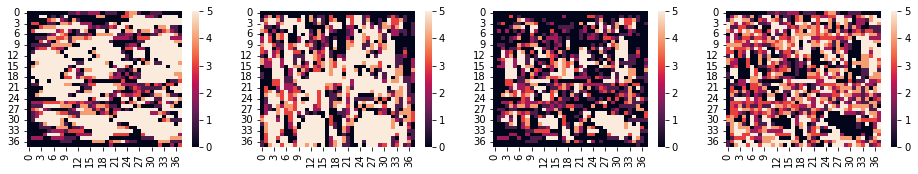

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


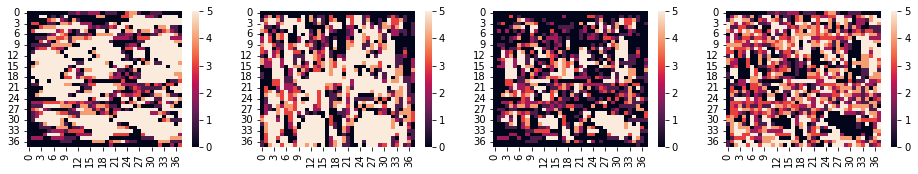

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


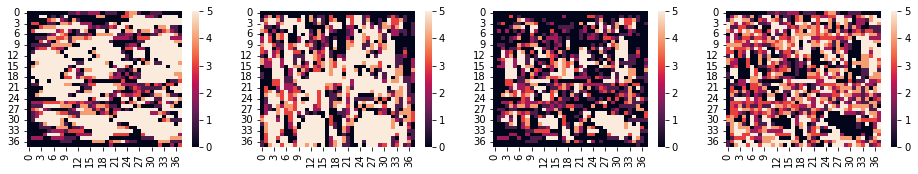

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


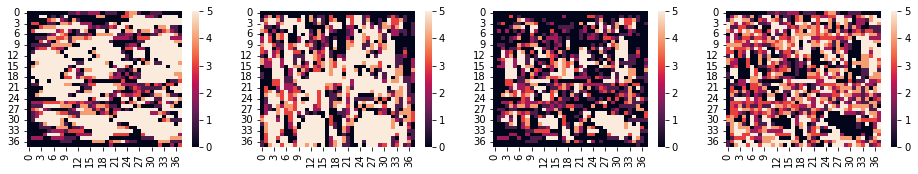

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


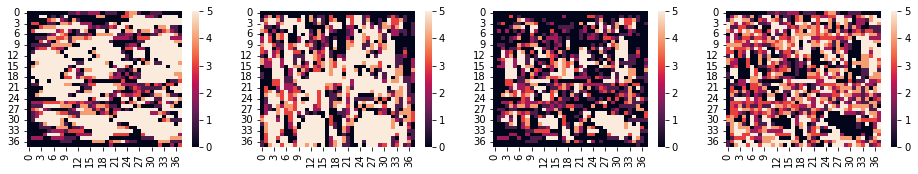

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


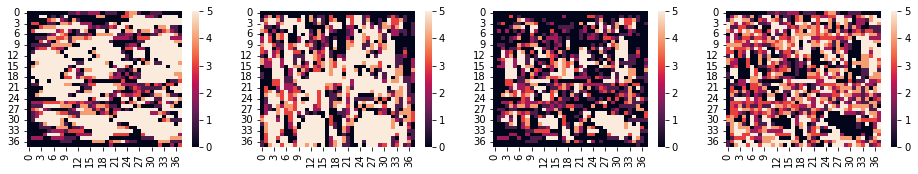

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


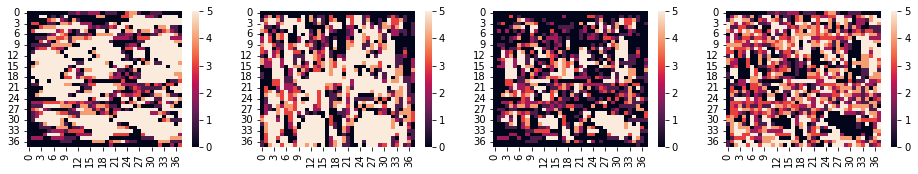

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


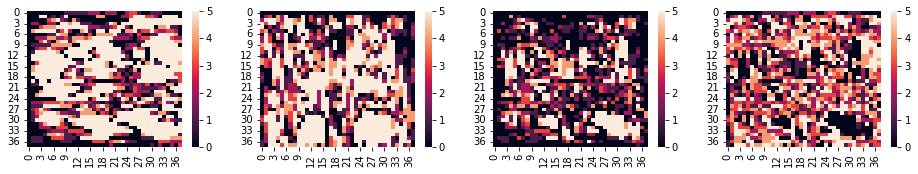

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


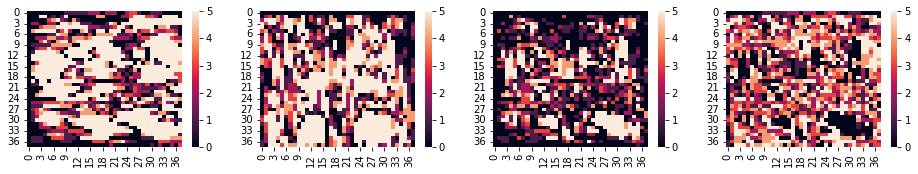

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


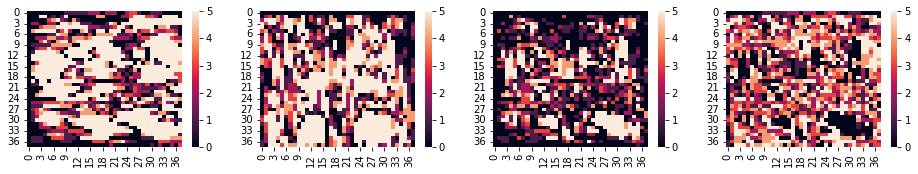

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


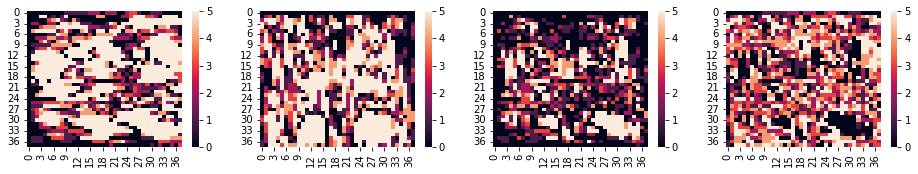

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


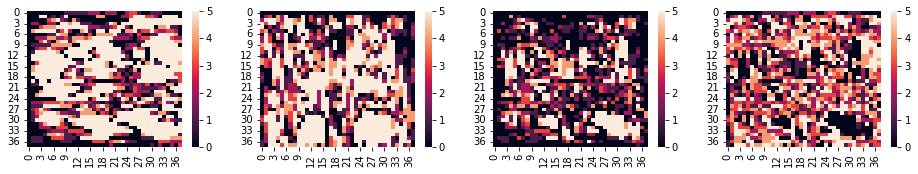

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


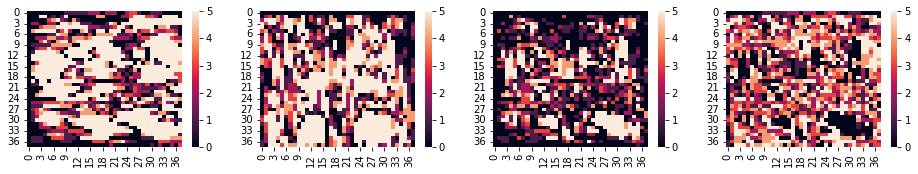

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


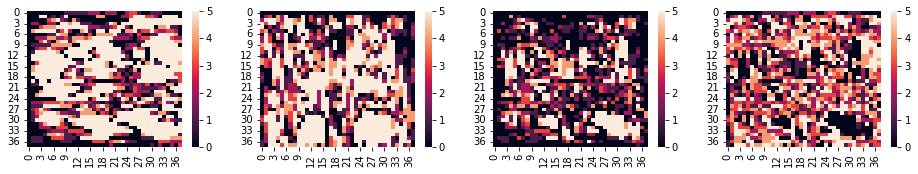

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


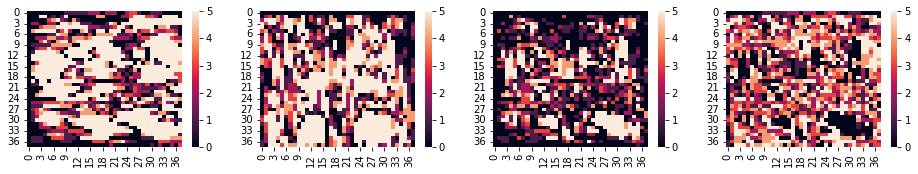

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


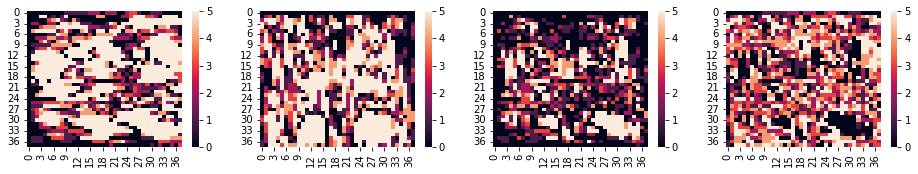

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


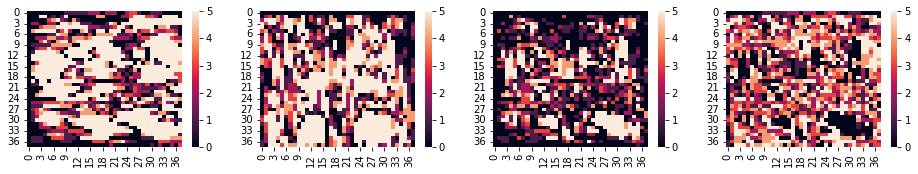

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


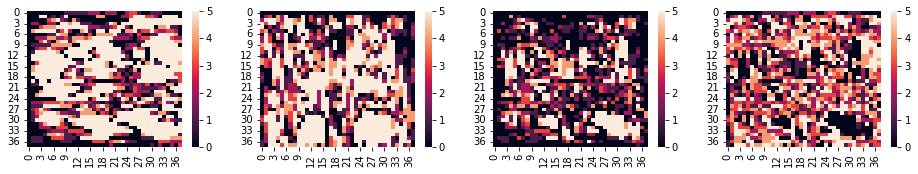

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


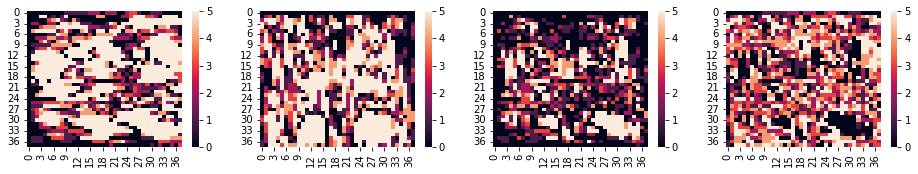

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


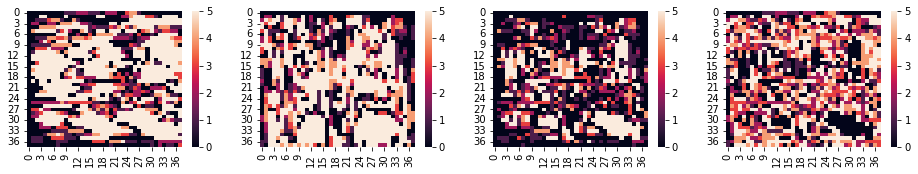

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0


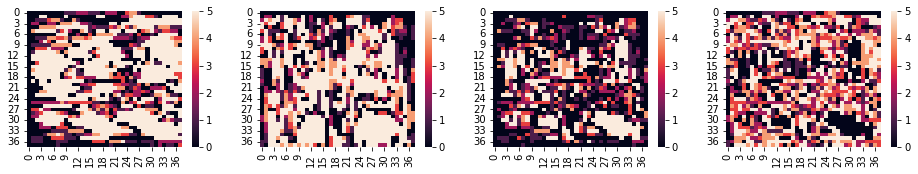

max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  969.0 475.0
max fitness:  972.0 472.0


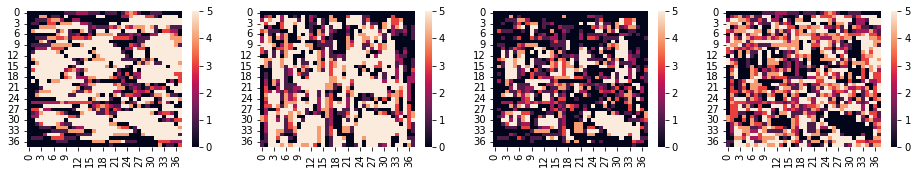

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


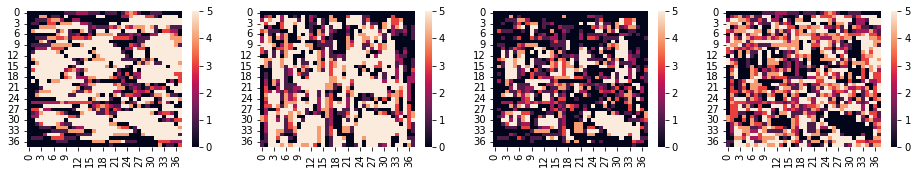

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


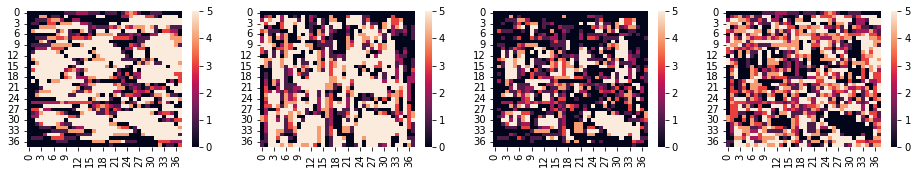

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


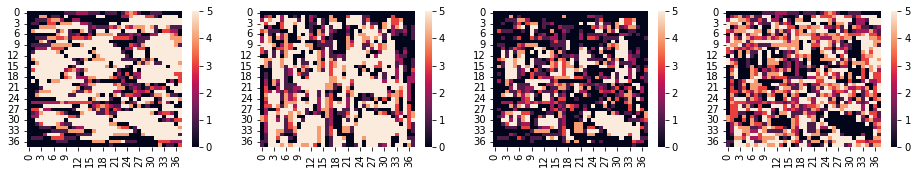

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


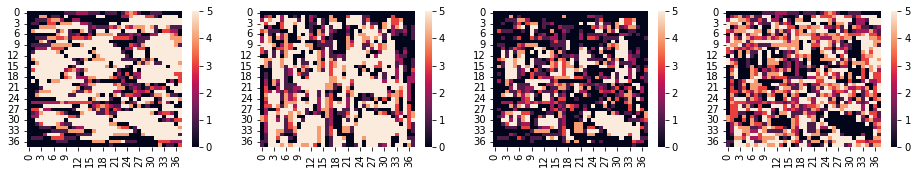

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


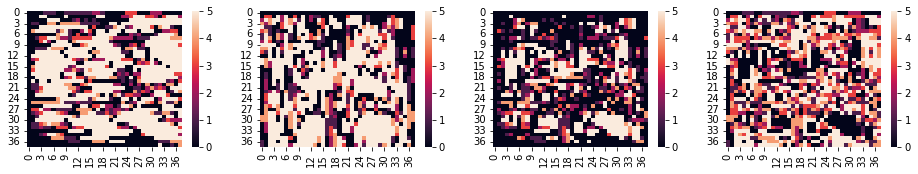

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


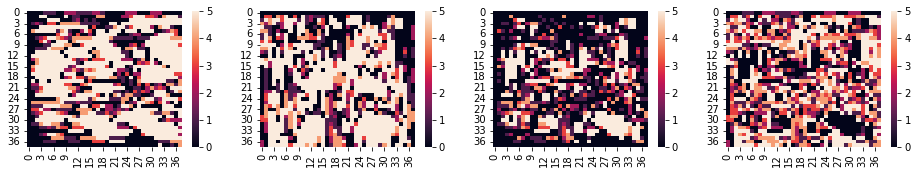

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


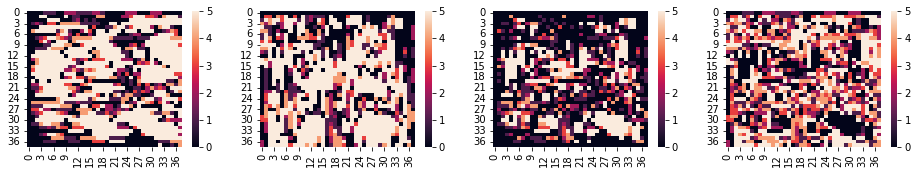

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


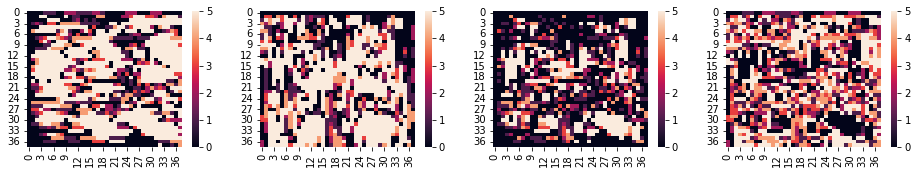

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


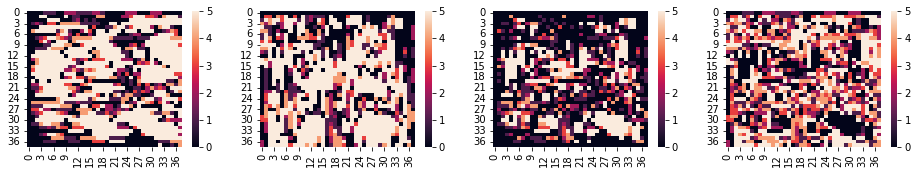

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


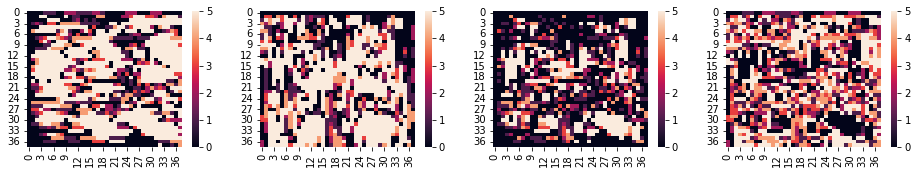

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


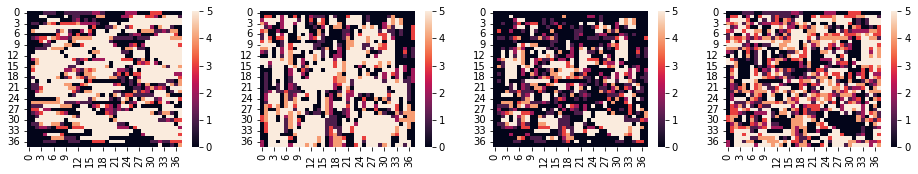

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


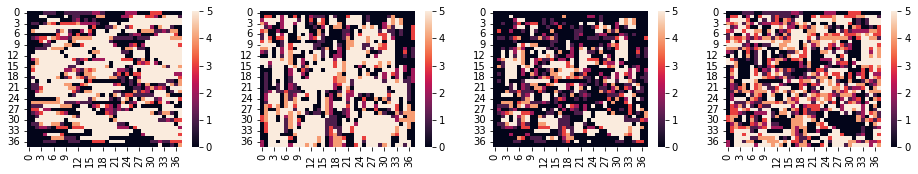

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


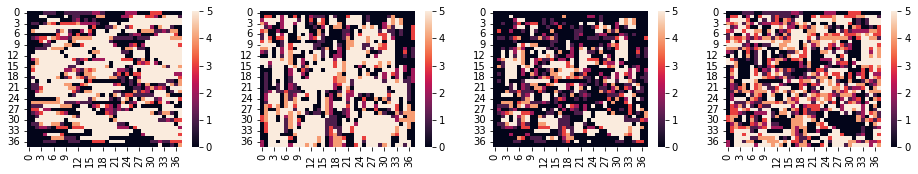

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


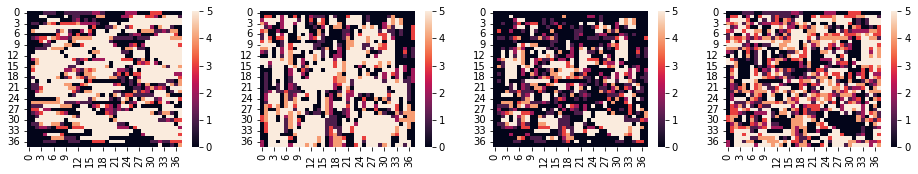

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


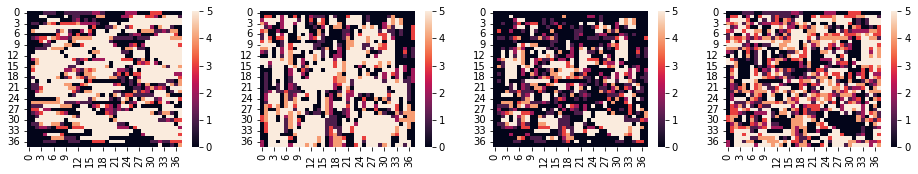

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


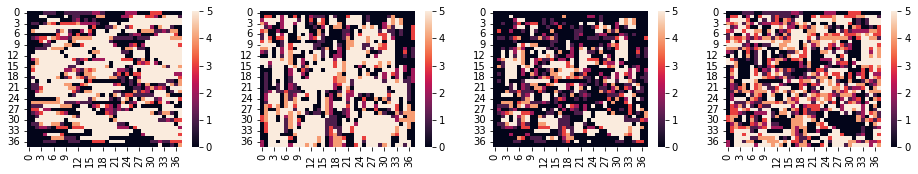

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


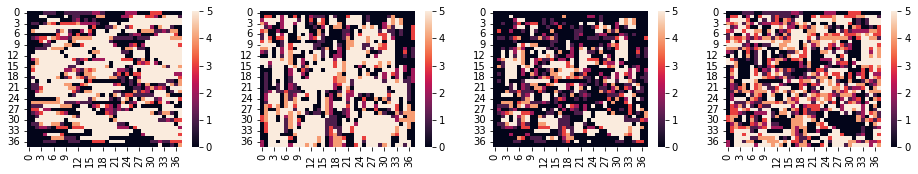

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


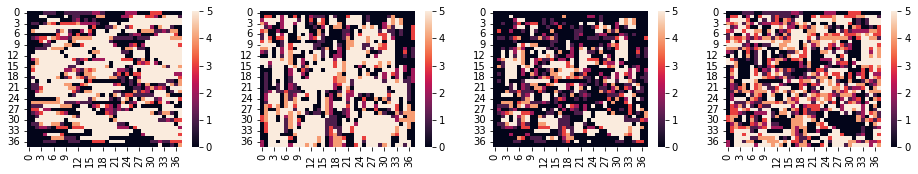

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


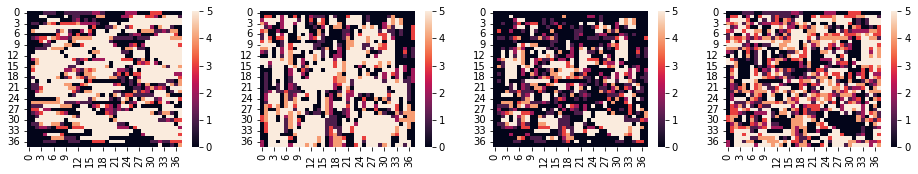

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


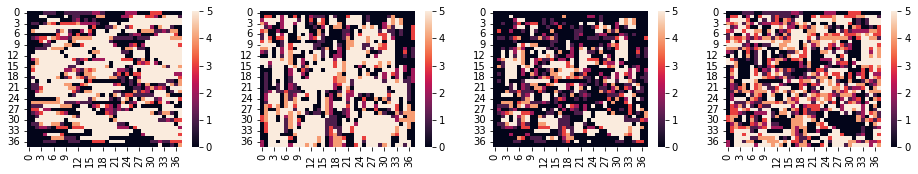

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


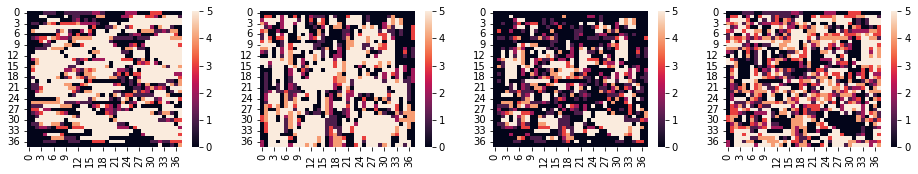

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


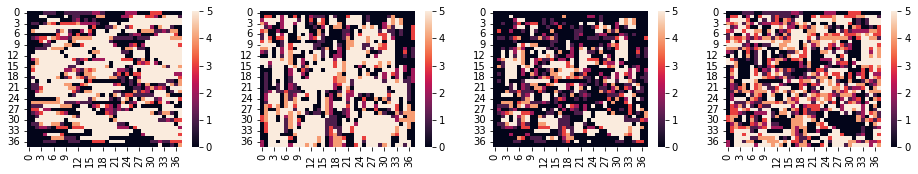

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


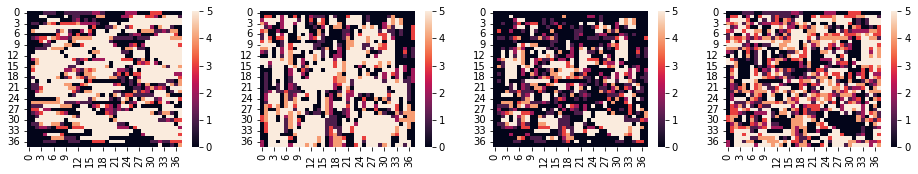

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


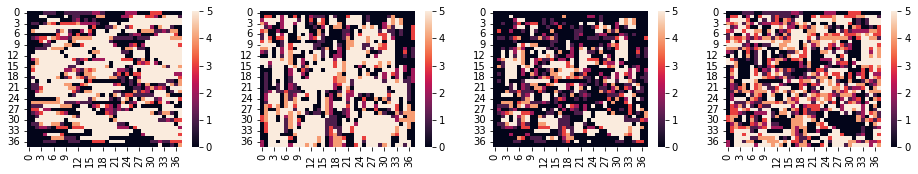

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


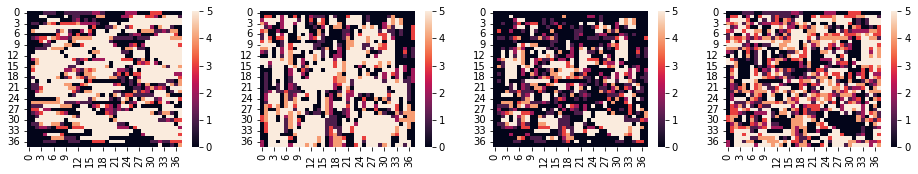

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  972.0 472.0


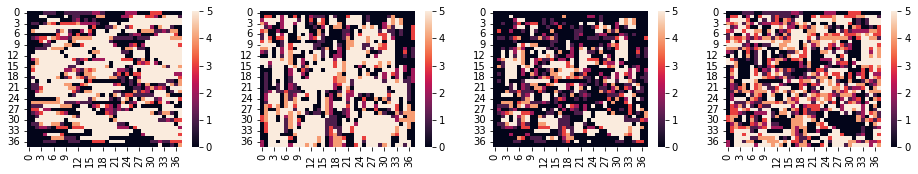

max fitness:  972.0 472.0
max fitness:  972.0 472.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0


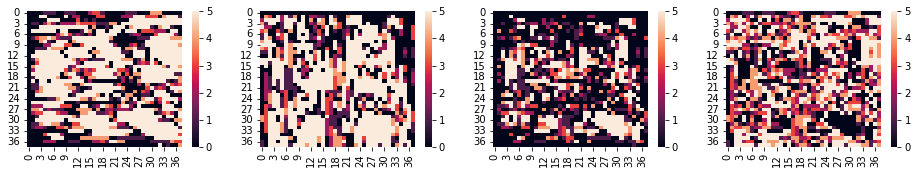

max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0


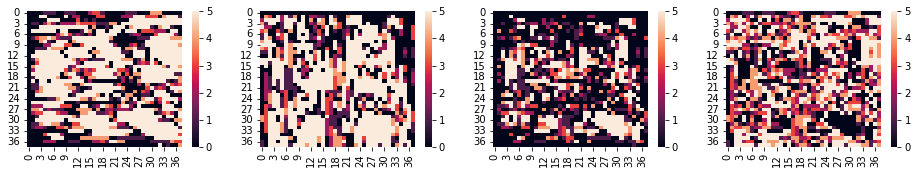

max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  974.0 470.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0


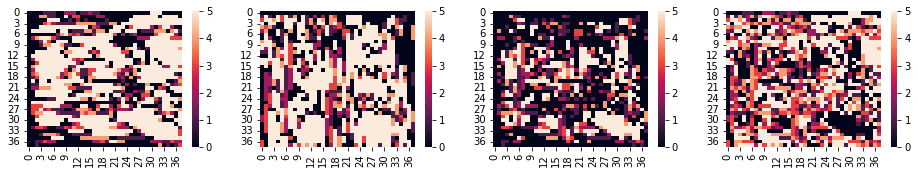

max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0


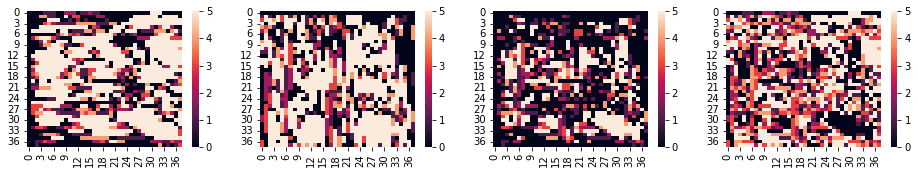

max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0


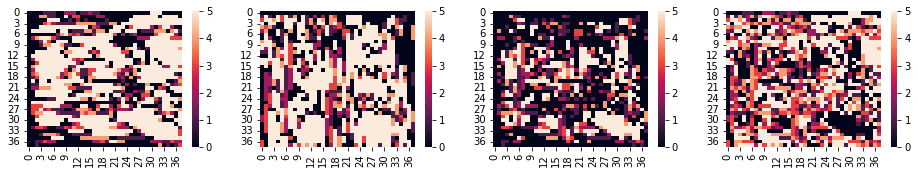

max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0


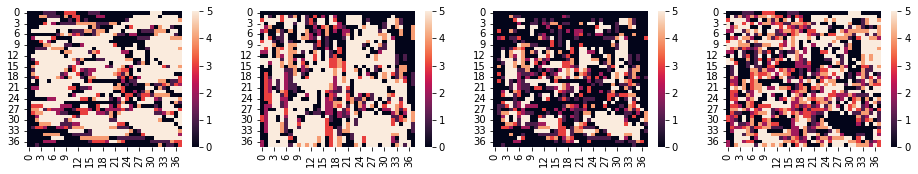

max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0


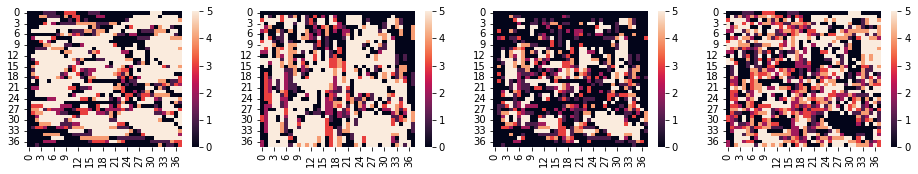

max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0


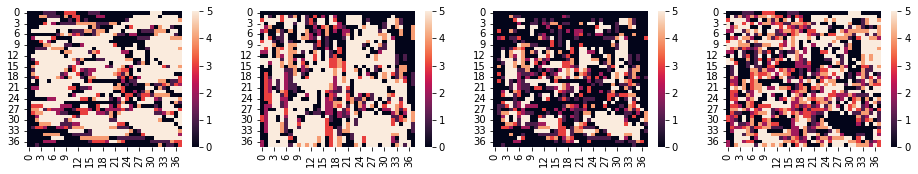

max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  975.0 469.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


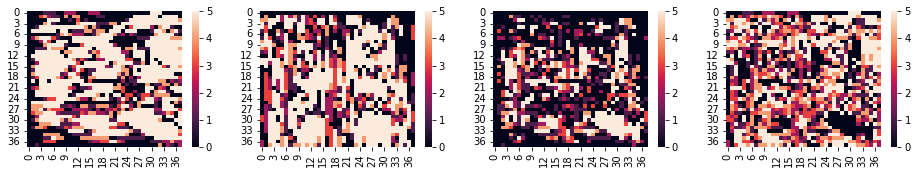

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


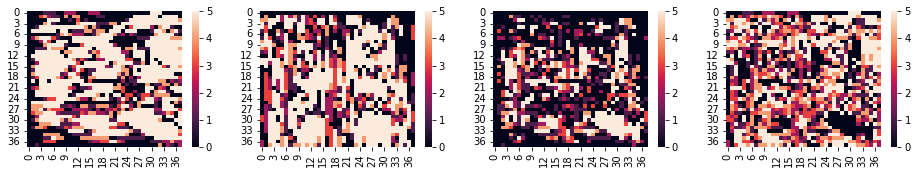

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


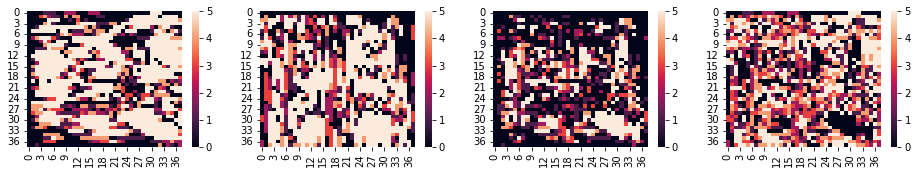

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


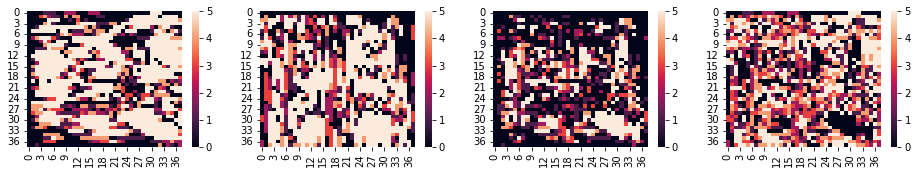

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


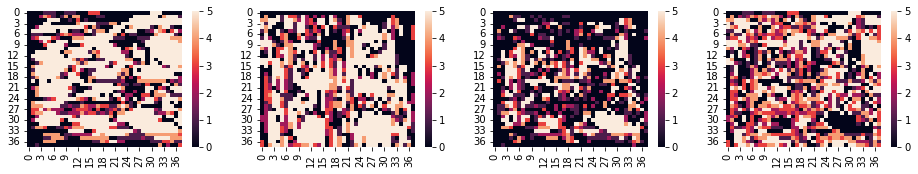

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


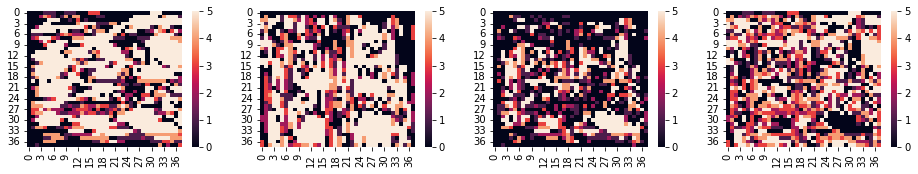

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


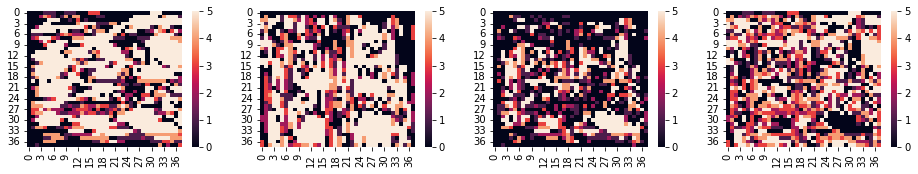

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


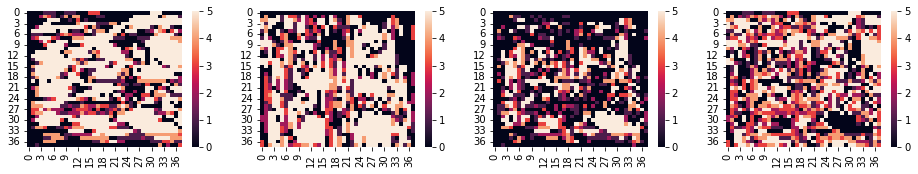

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


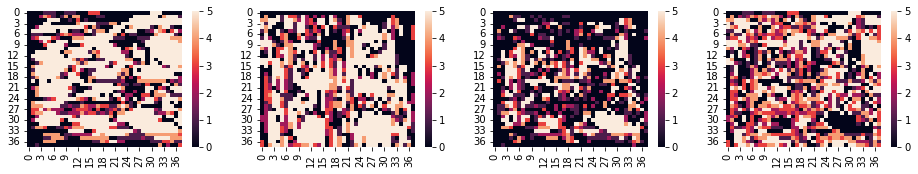

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


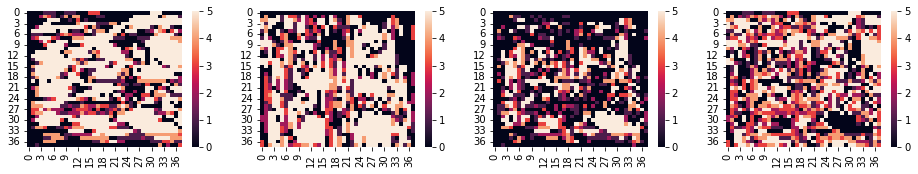

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


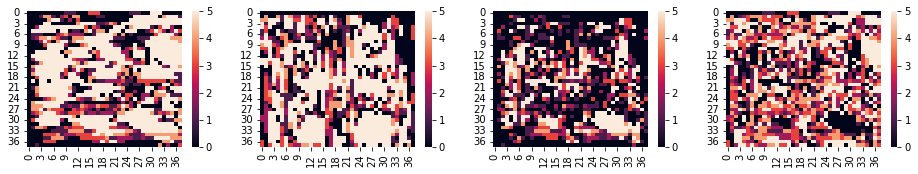

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


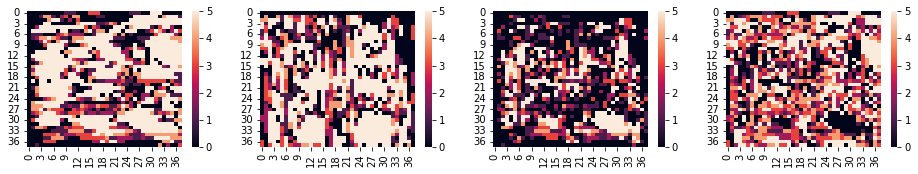

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


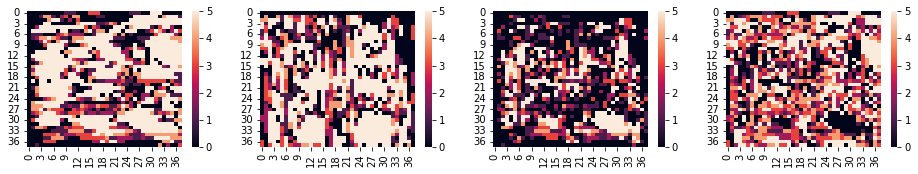

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


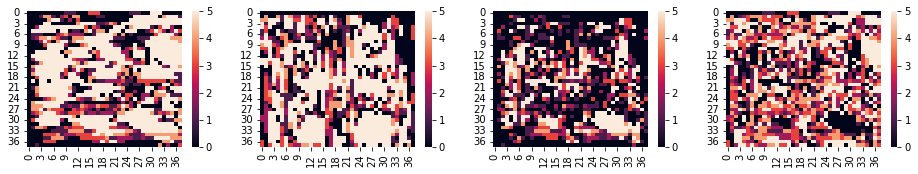

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  978.0 466.0


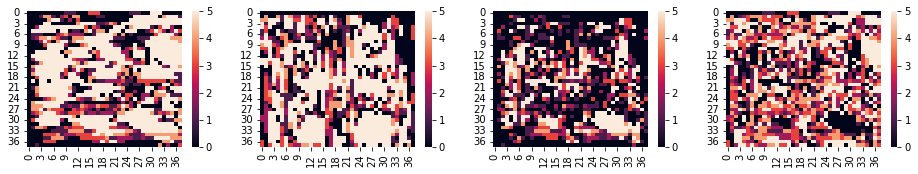

max fitness:  978.0 466.0
max fitness:  978.0 466.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


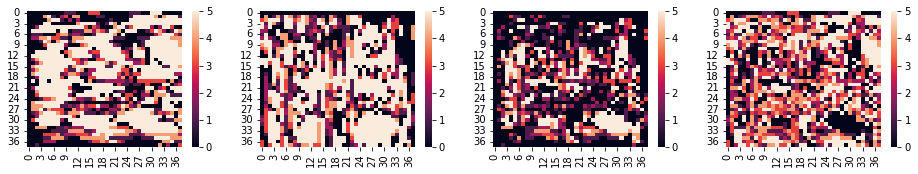

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


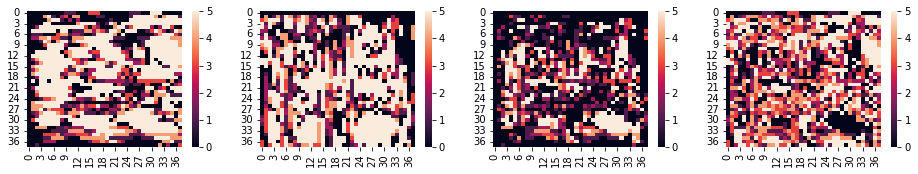

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


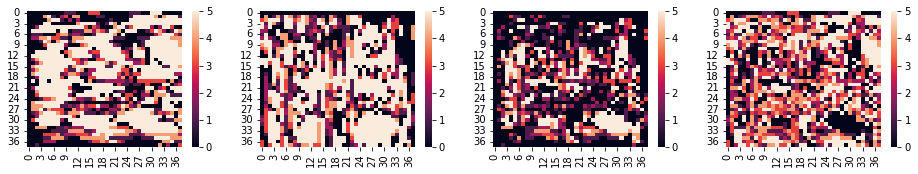

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


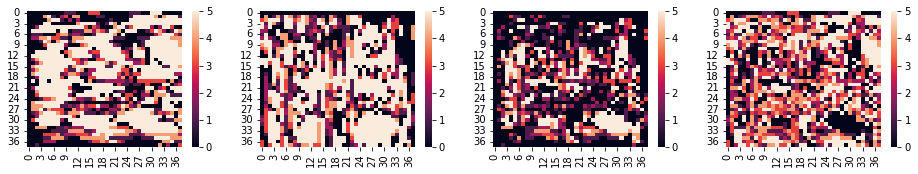

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


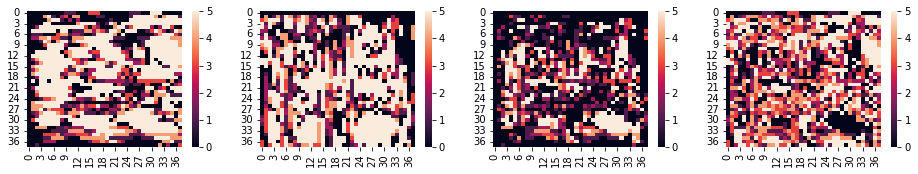

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


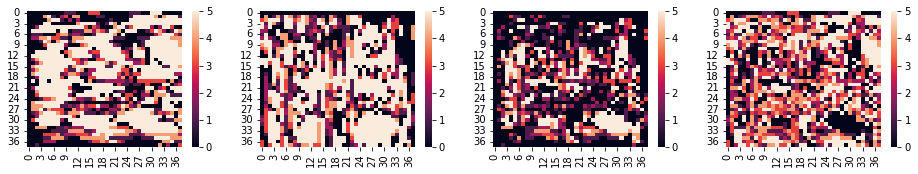

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


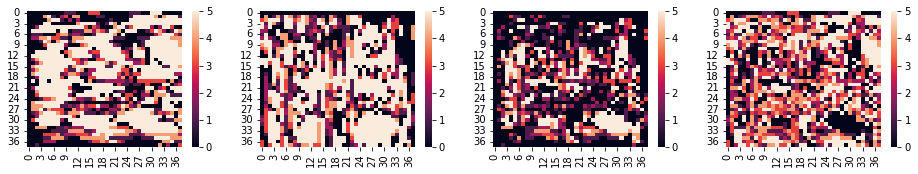

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


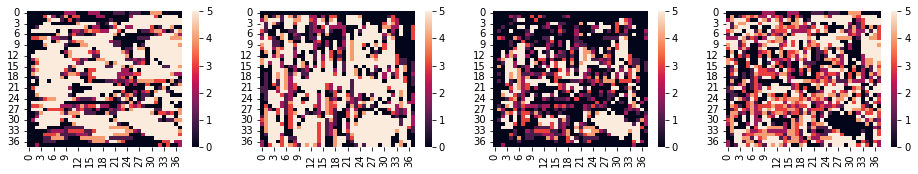

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


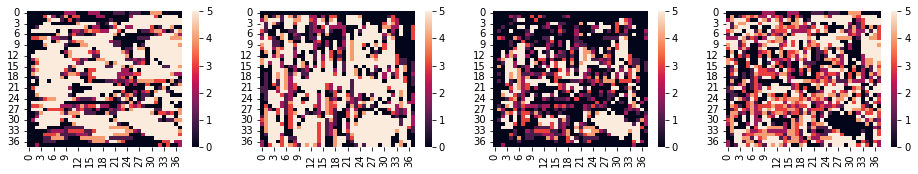

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


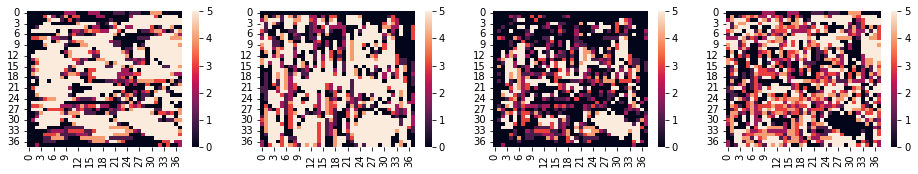

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


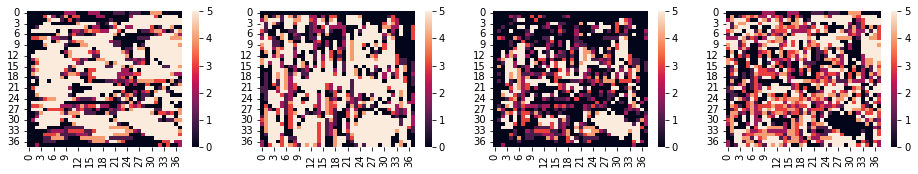

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


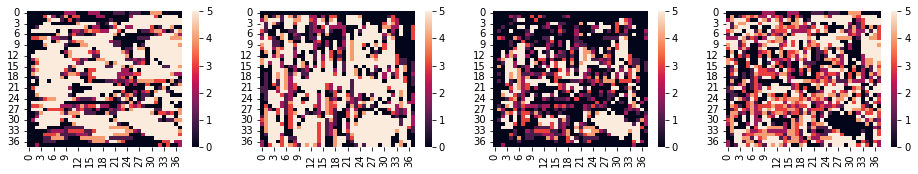

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


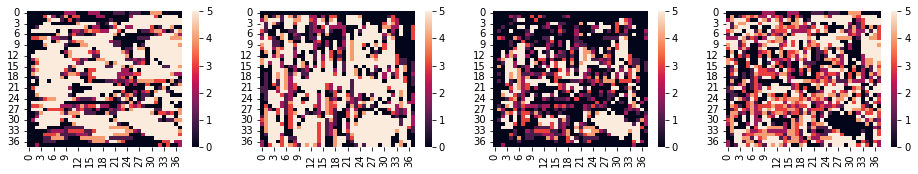

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


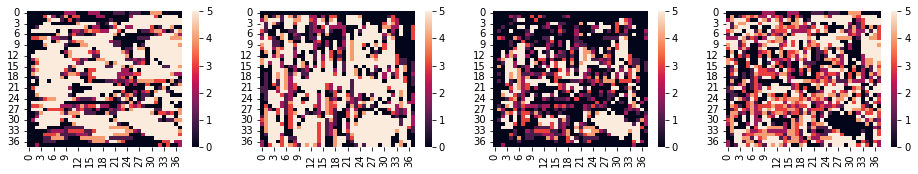

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


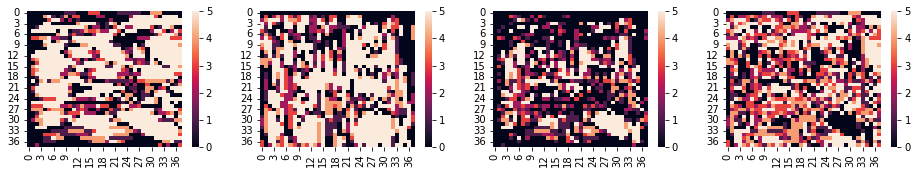

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


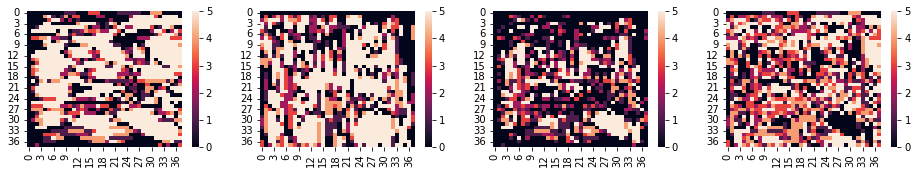

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


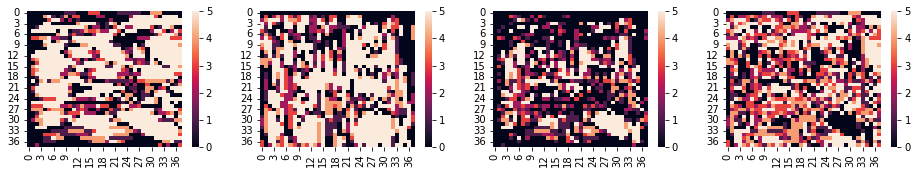

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


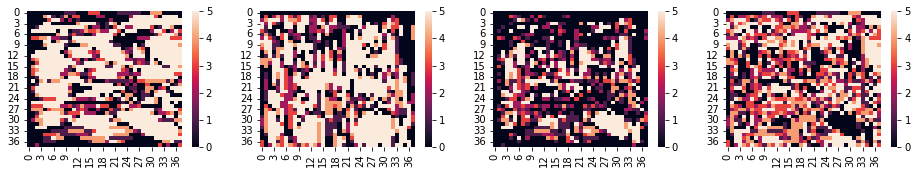

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


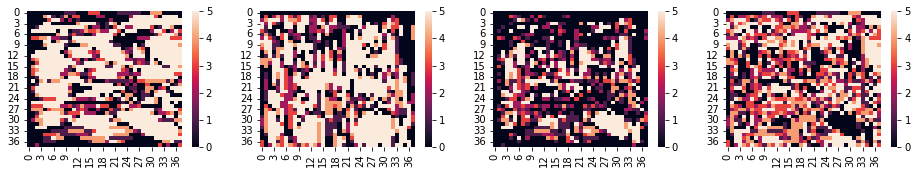

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


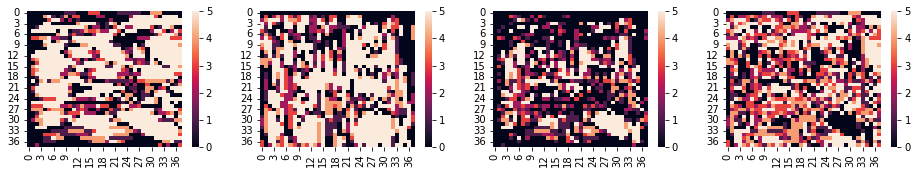

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


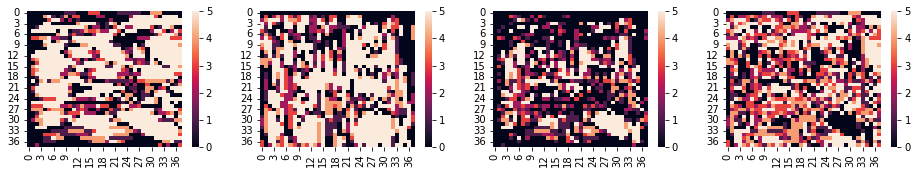

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


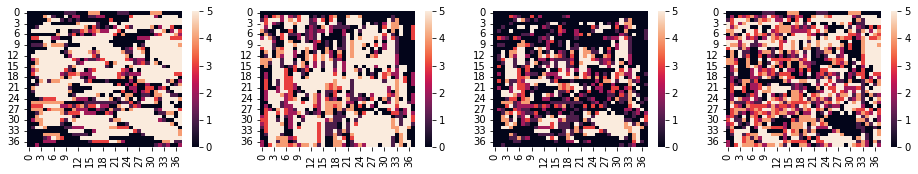

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


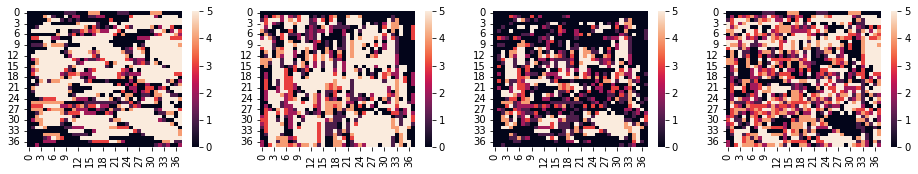

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


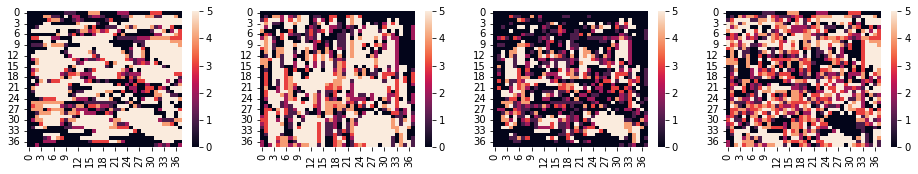

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


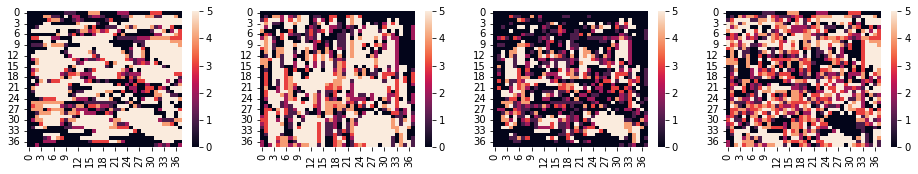

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


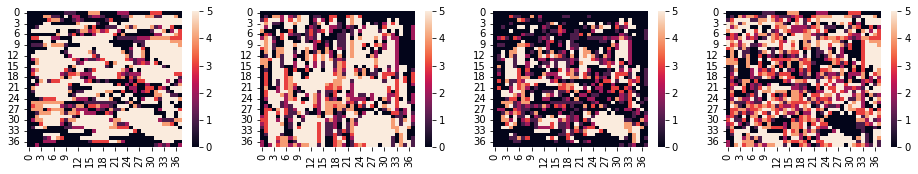

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


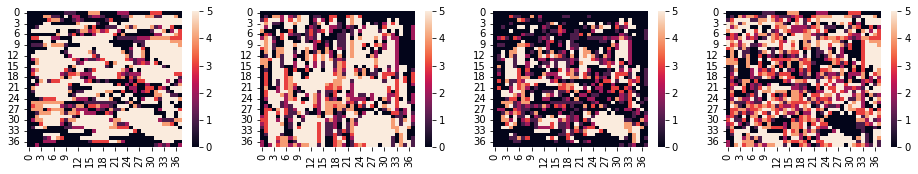

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


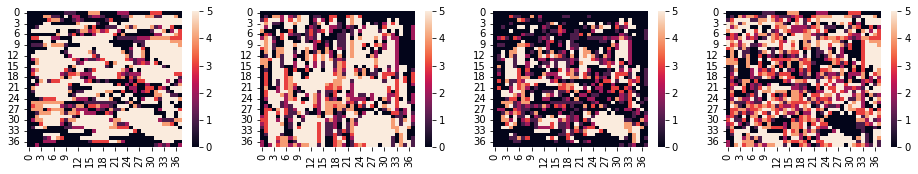

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


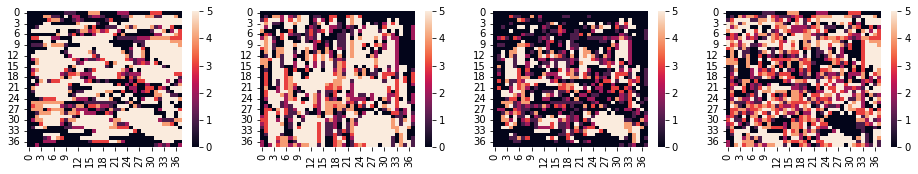

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


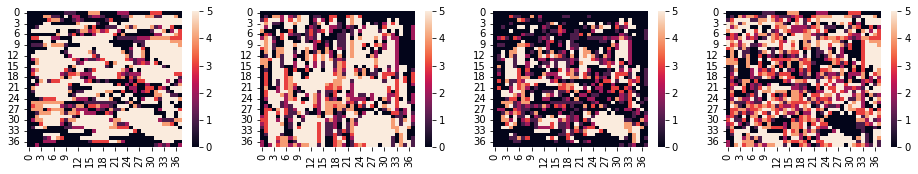

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


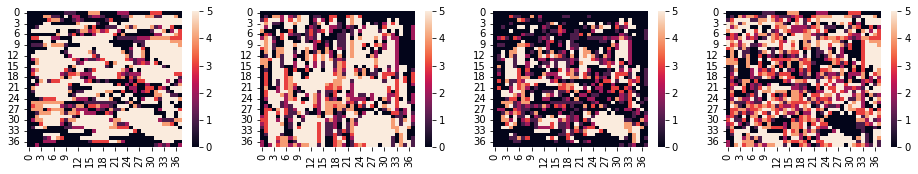

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


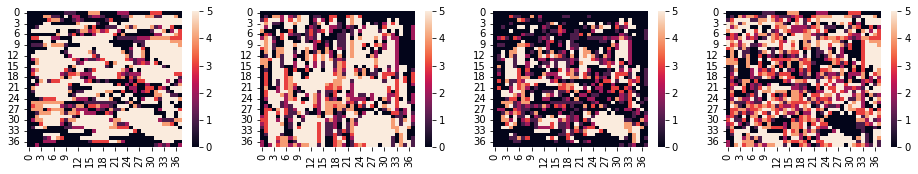

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


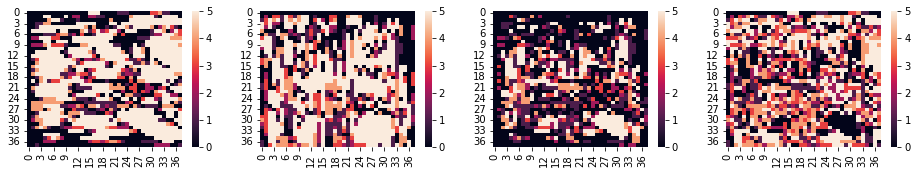

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


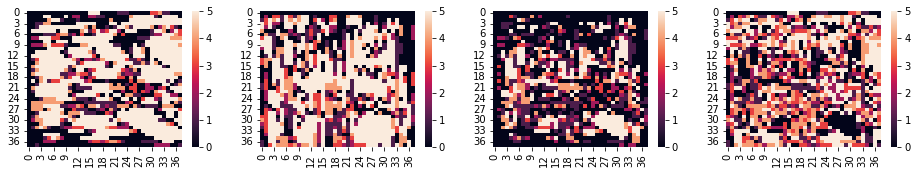

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


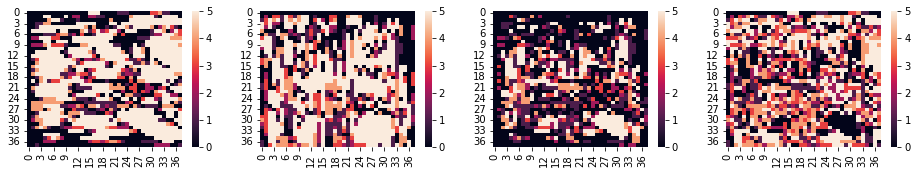

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


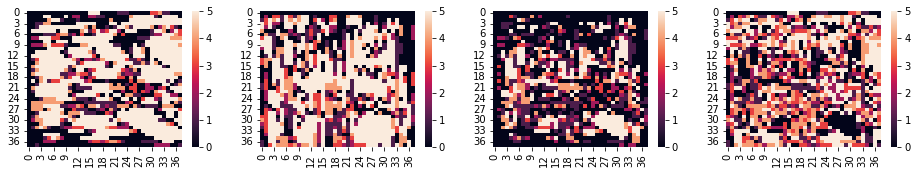

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


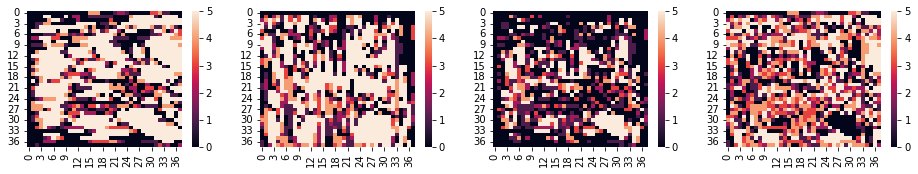

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


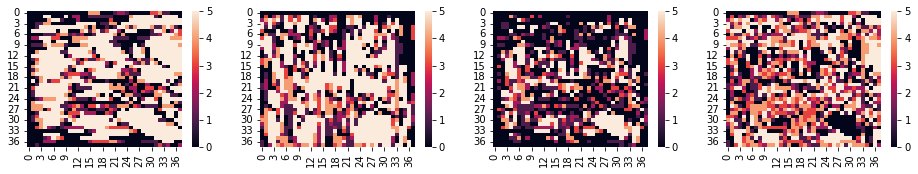

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


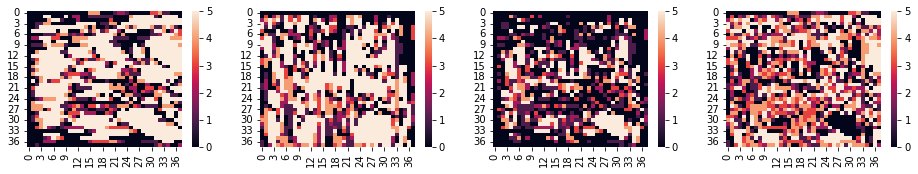

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


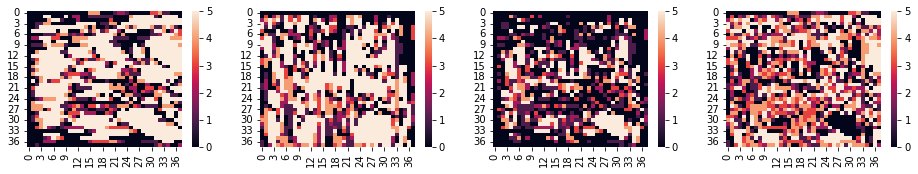

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


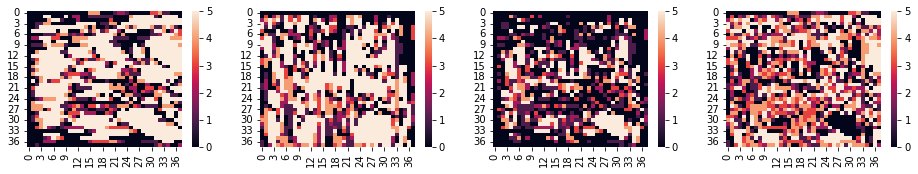

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


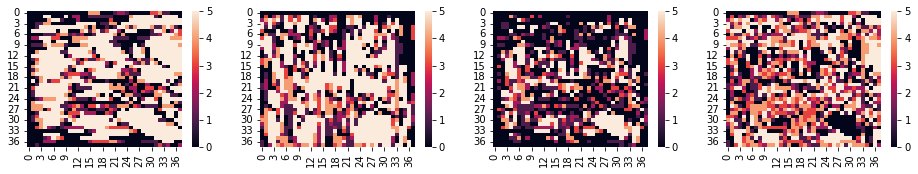

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


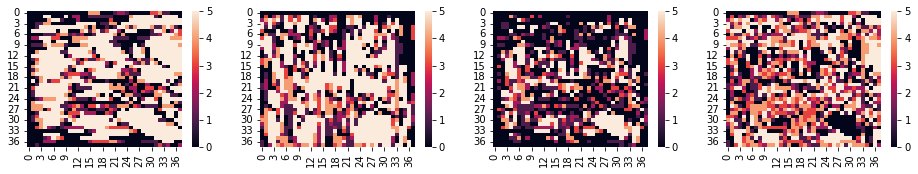

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


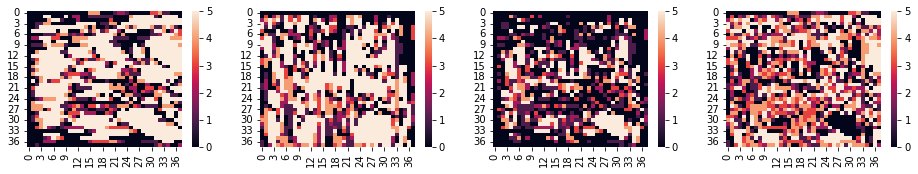

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


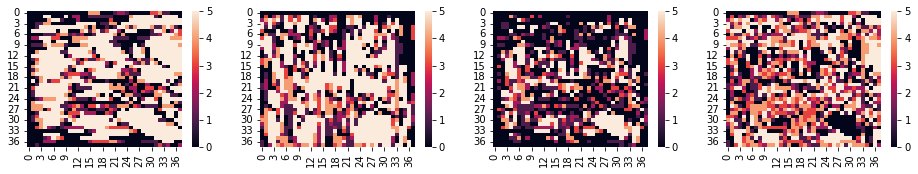

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


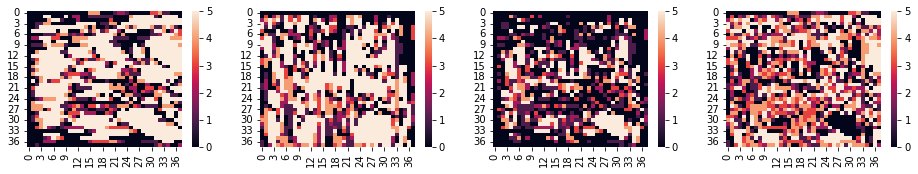

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


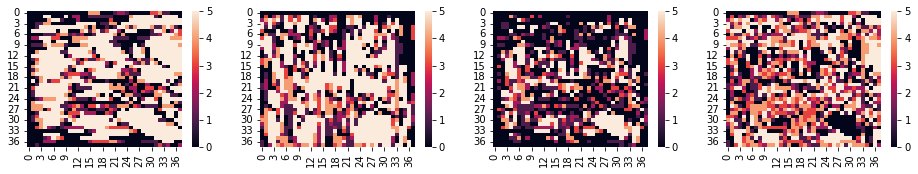

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


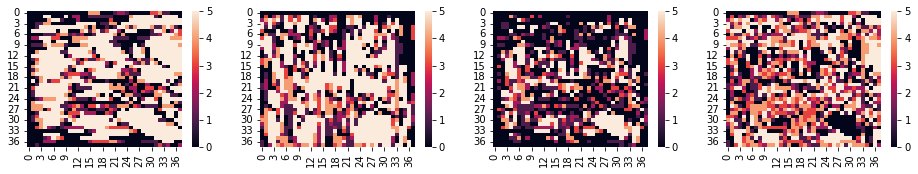

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


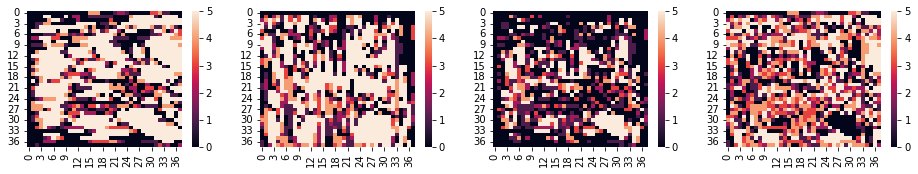

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


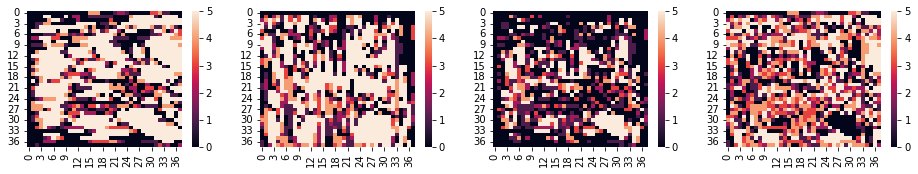

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


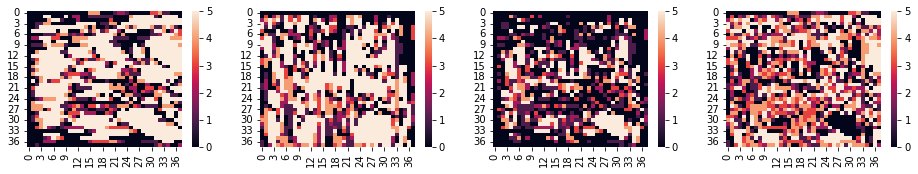

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


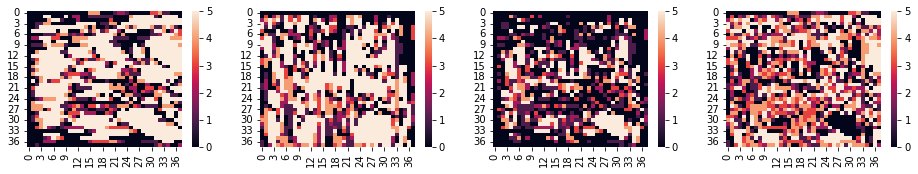

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


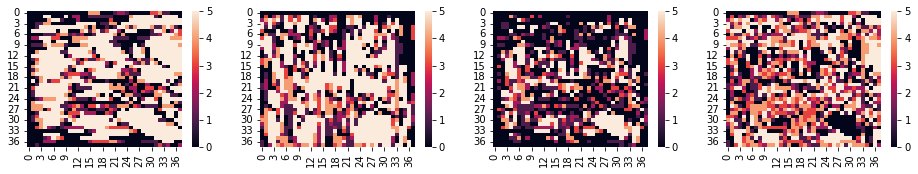

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


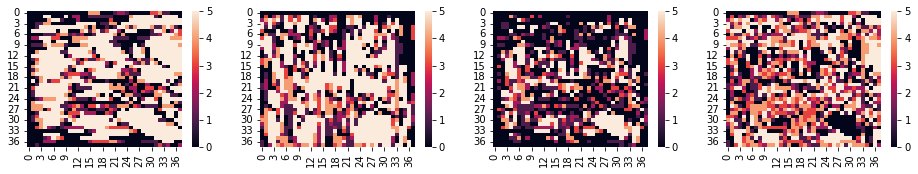

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


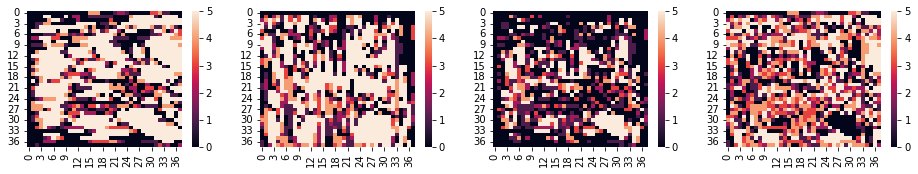

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


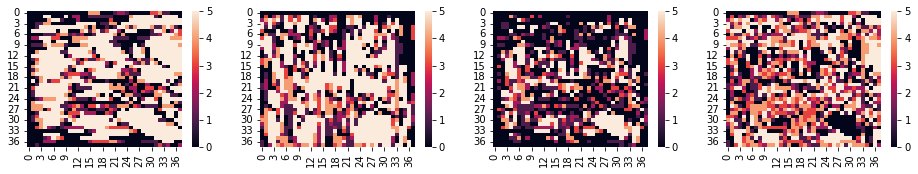

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


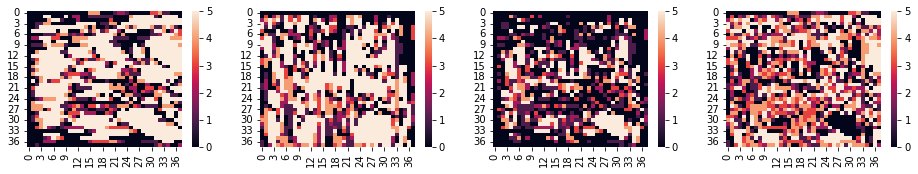

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


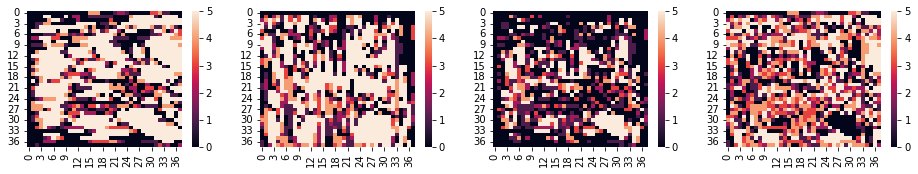

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


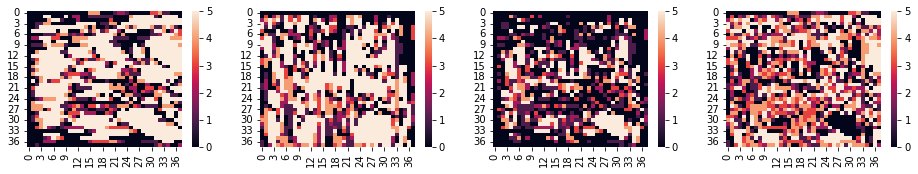

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


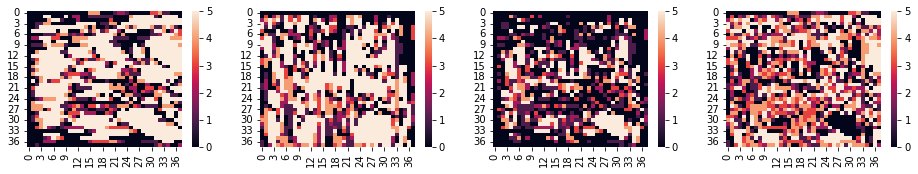

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


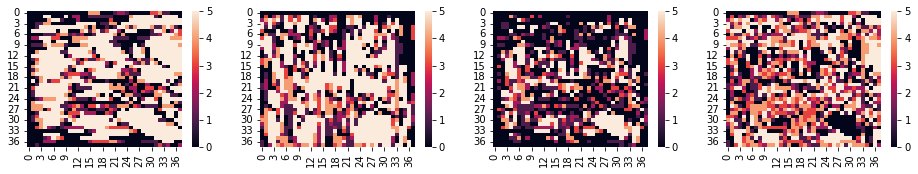

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


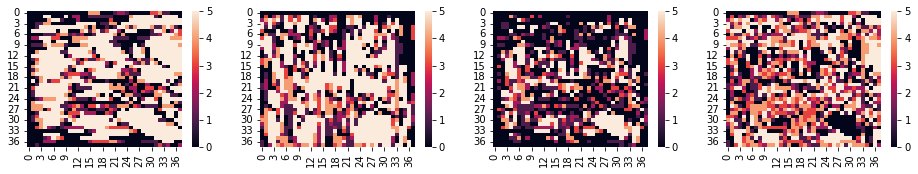

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


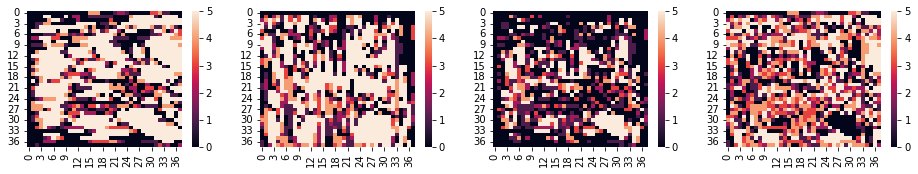

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


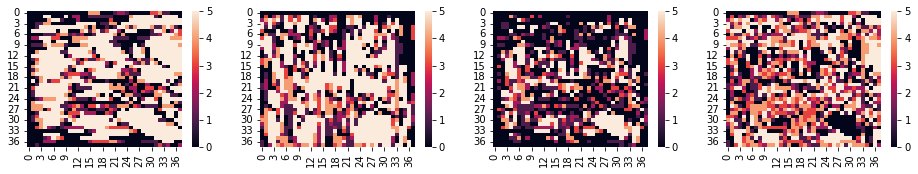

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


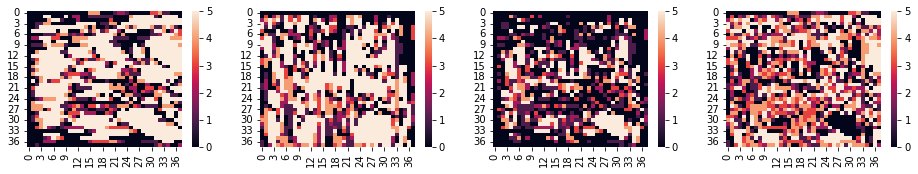

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


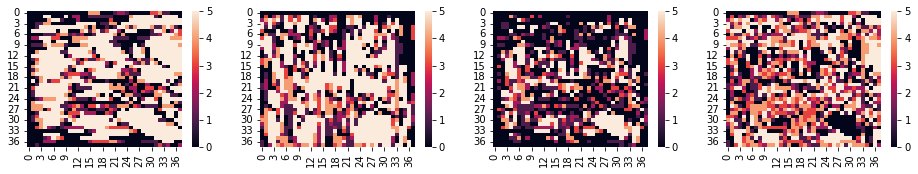

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


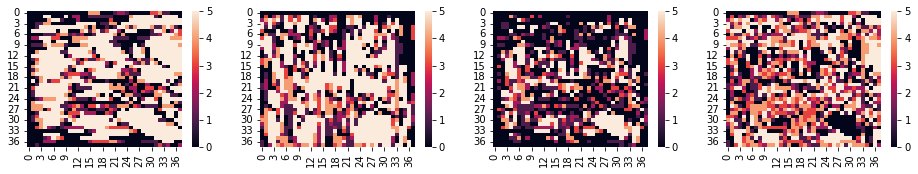

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


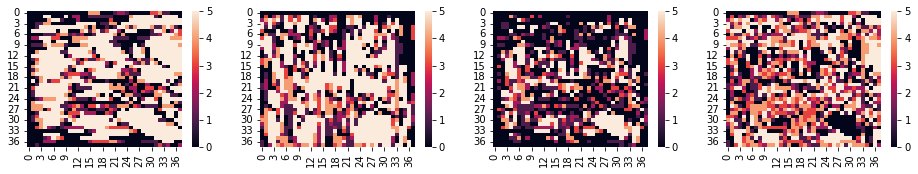

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


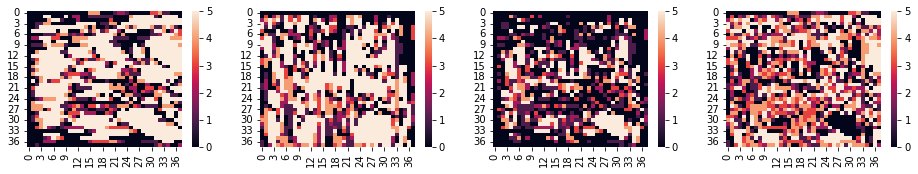

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


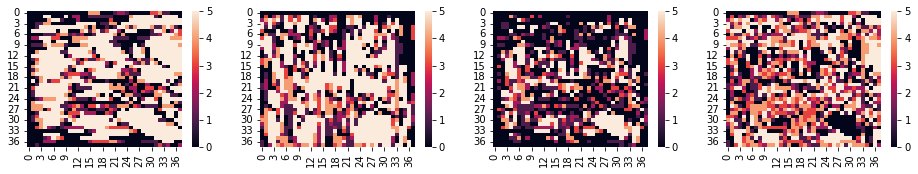

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


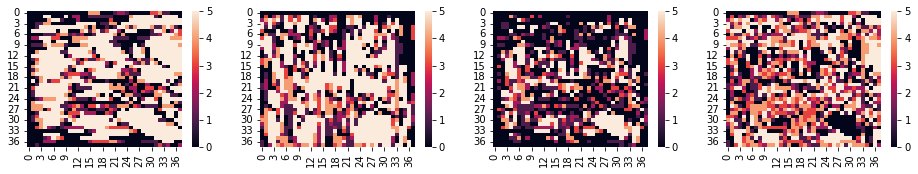

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


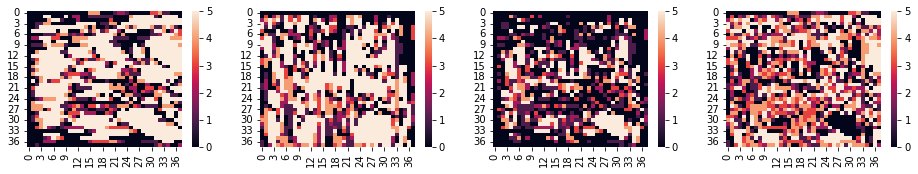

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


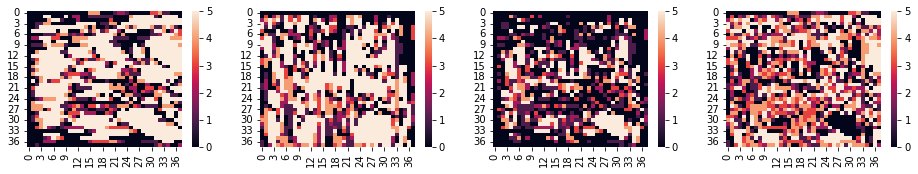

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


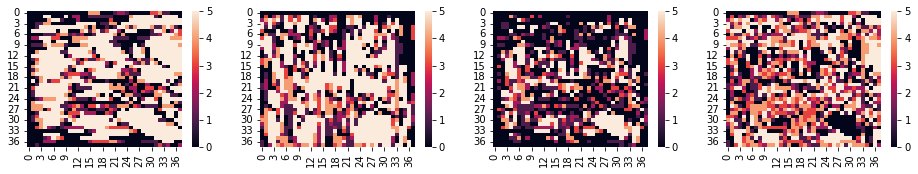

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


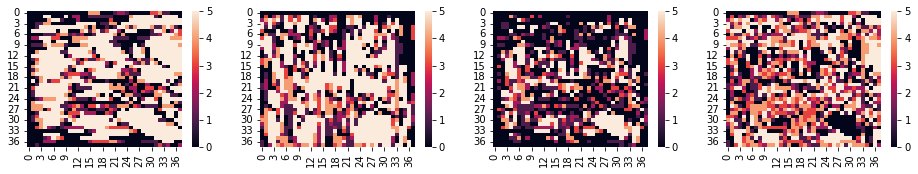

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


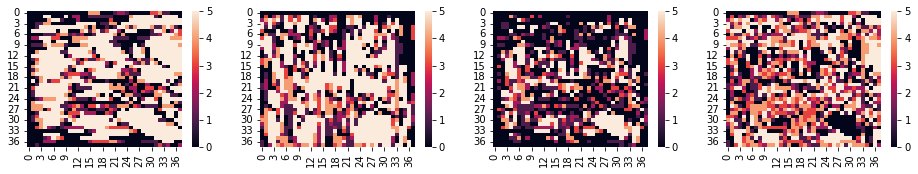

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


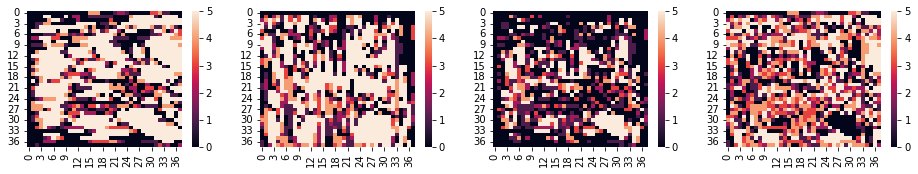

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


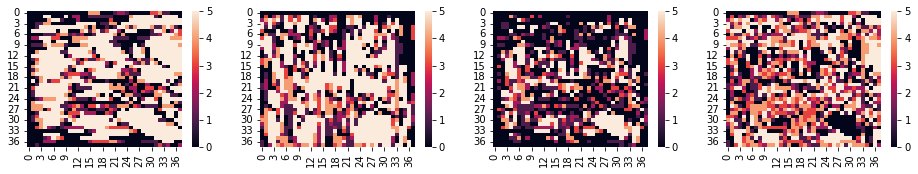

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


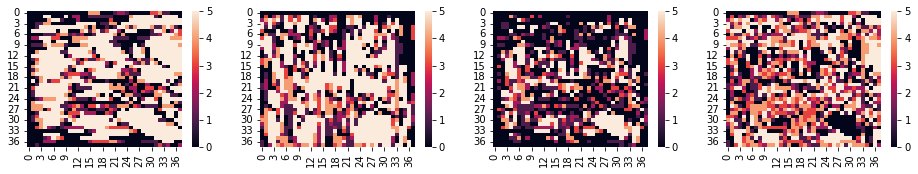

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


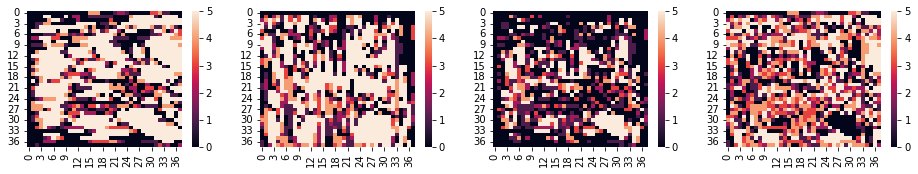

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


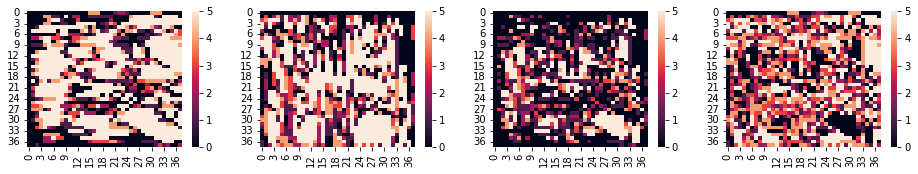

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


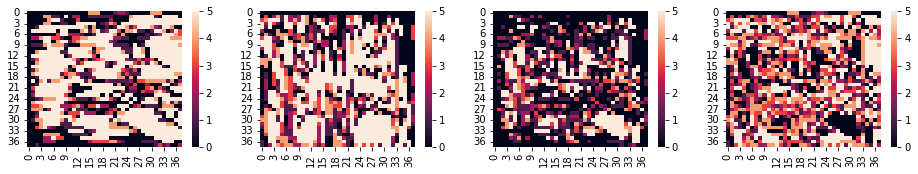

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


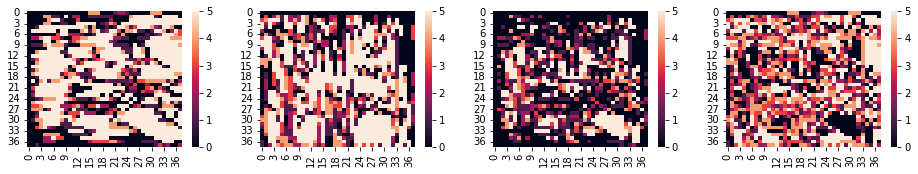

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


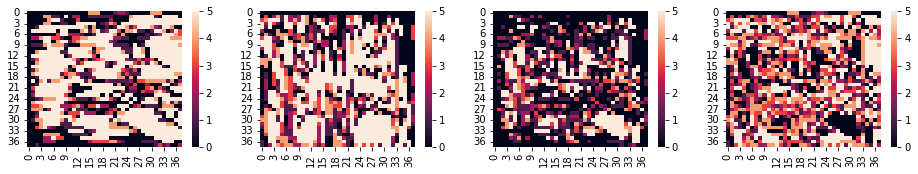

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


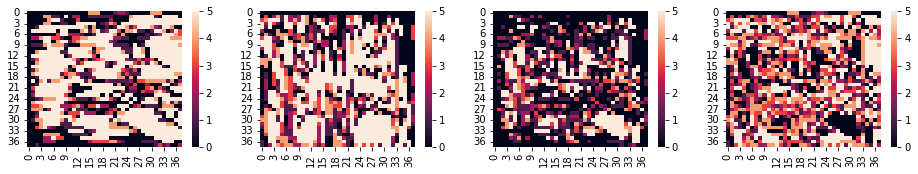

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


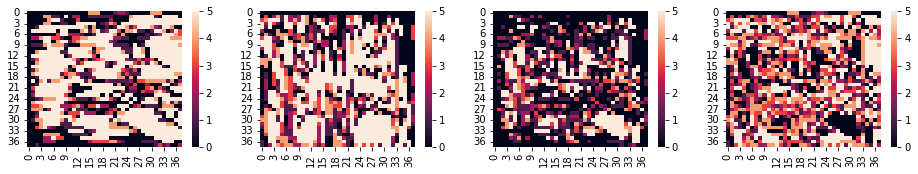

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


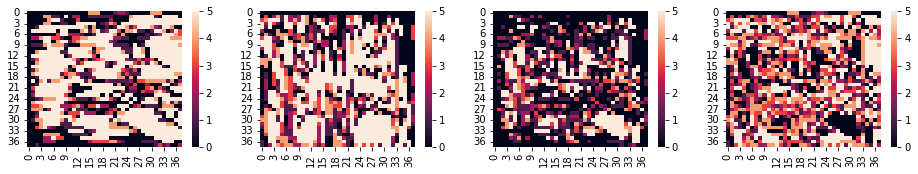

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


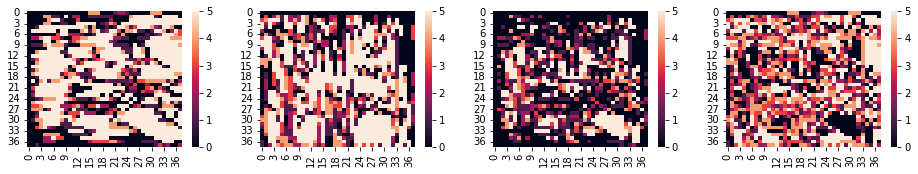

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


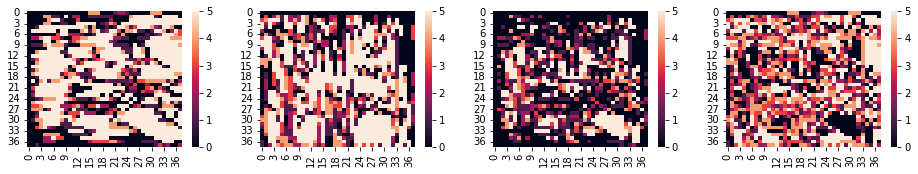

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


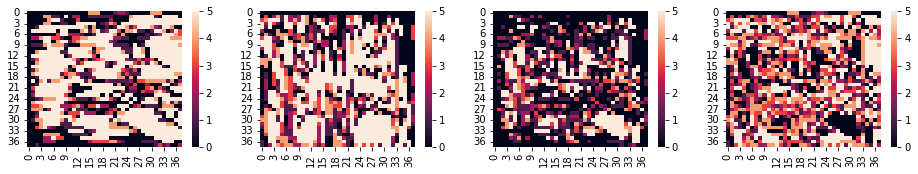

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


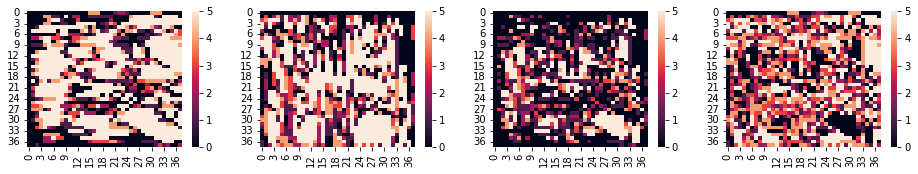

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


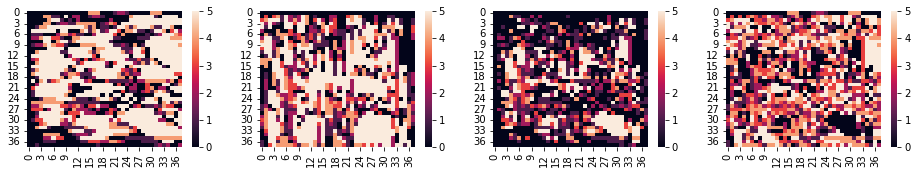

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


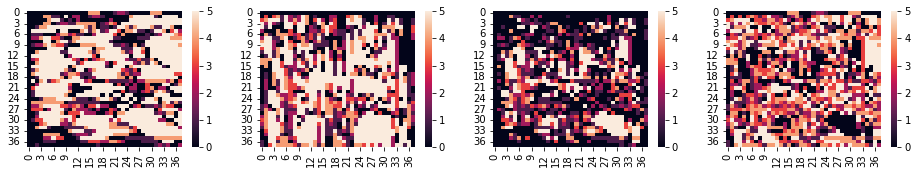

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


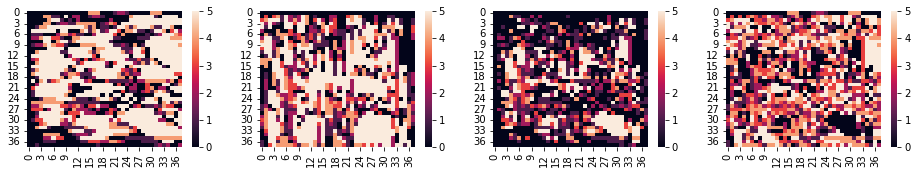

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


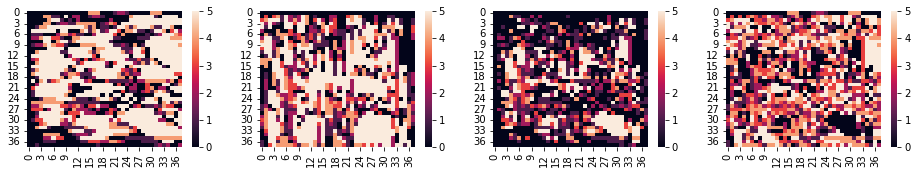

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


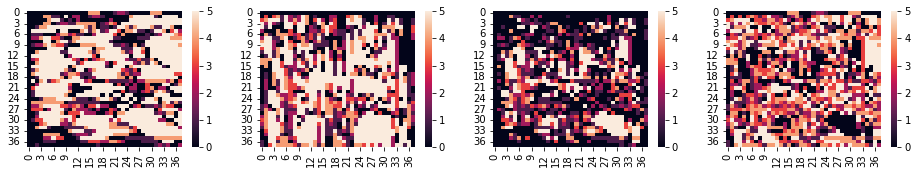

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


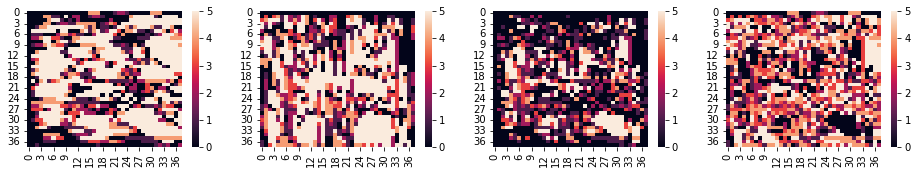

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


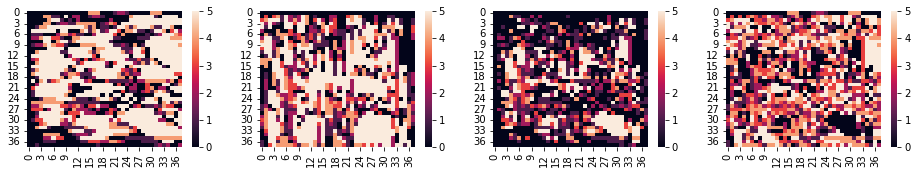

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


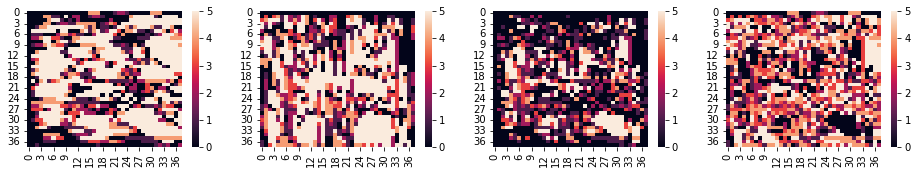

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


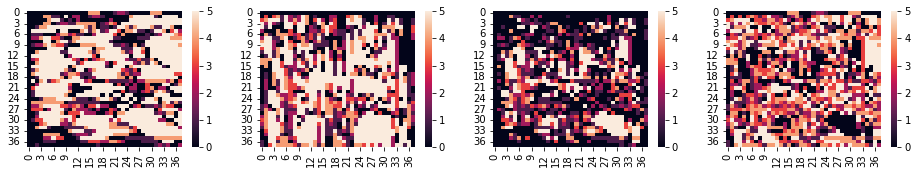

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


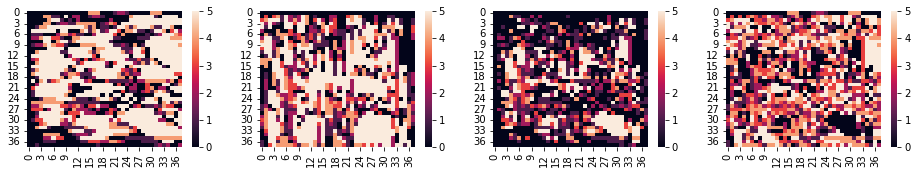

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


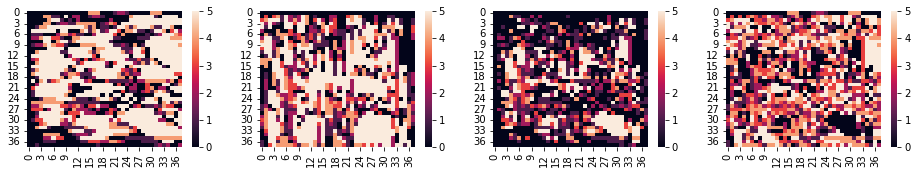

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


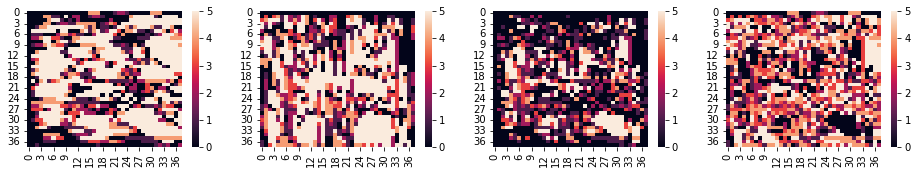

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


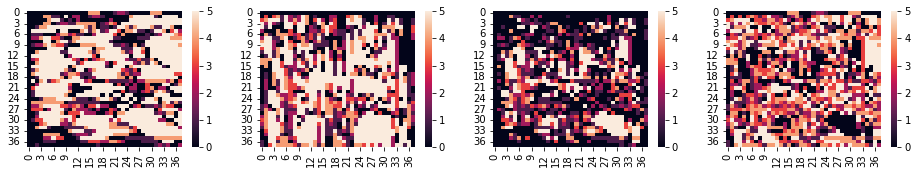

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


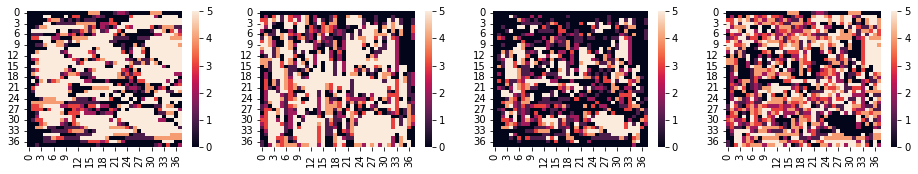

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


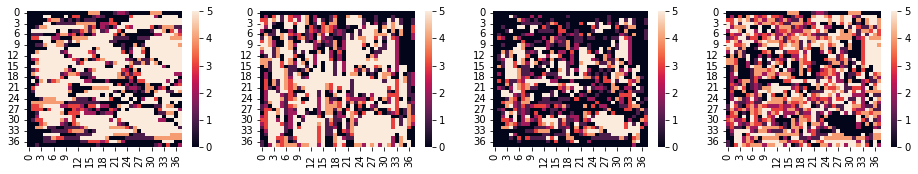

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


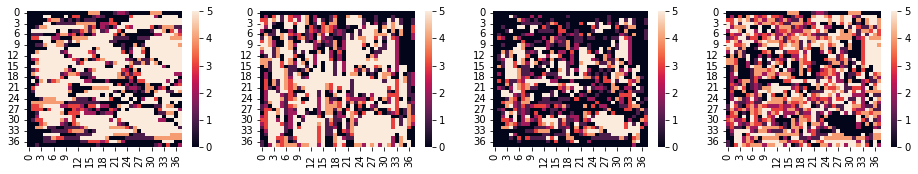

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


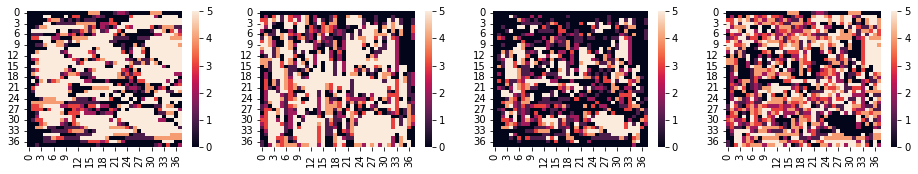

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


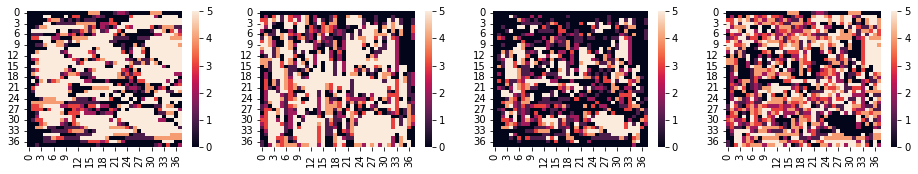

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


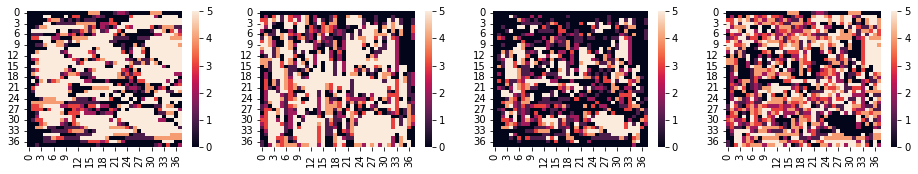

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


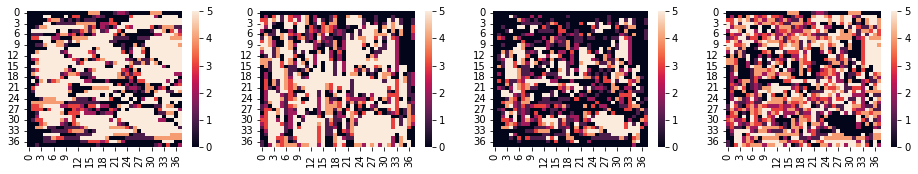

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


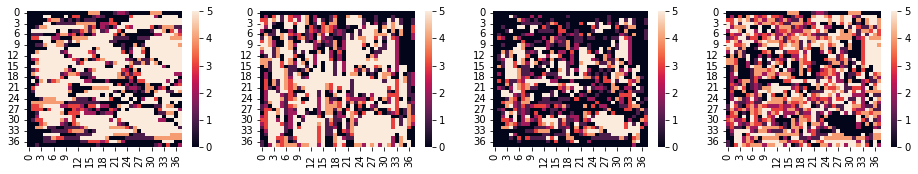

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  979.0 465.0


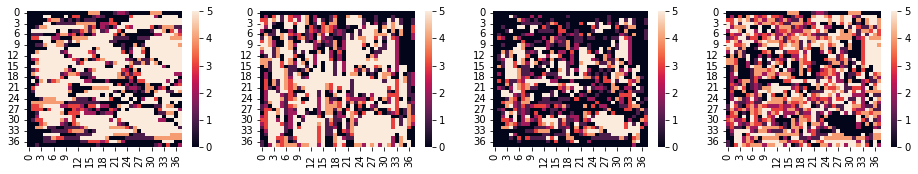

max fitness:  979.0 465.0
max fitness:  979.0 465.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


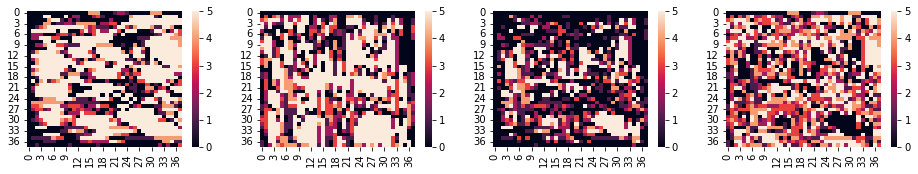

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


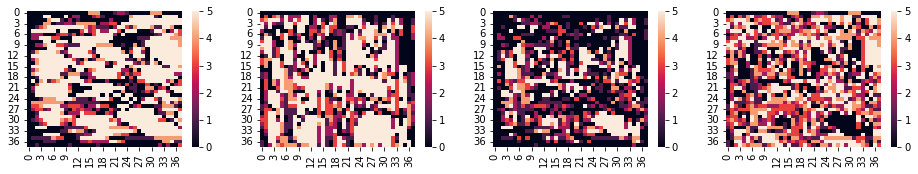

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


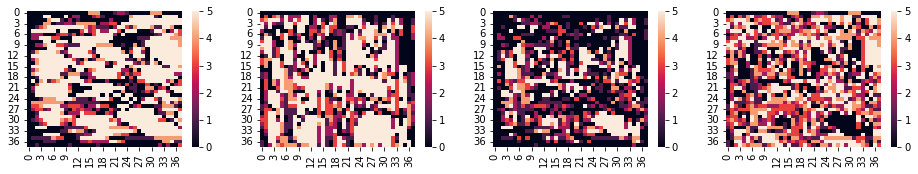

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


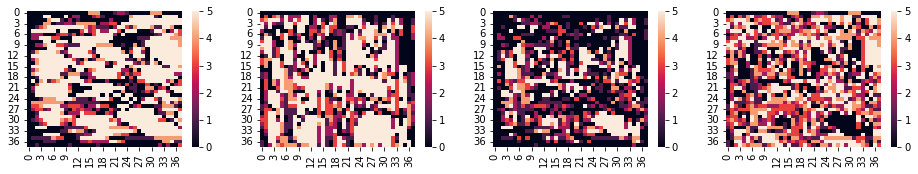

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


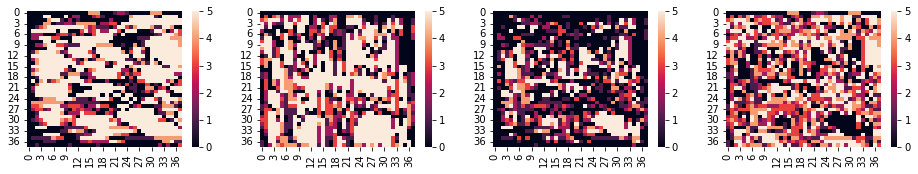

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


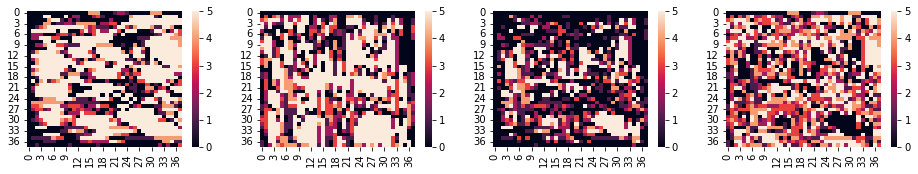

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


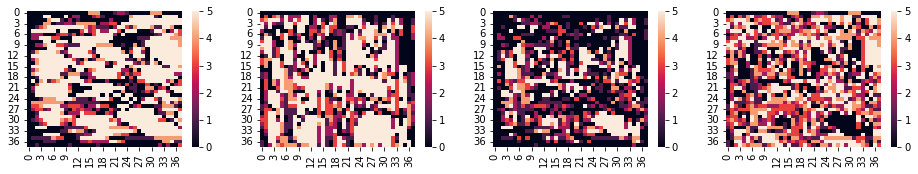

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


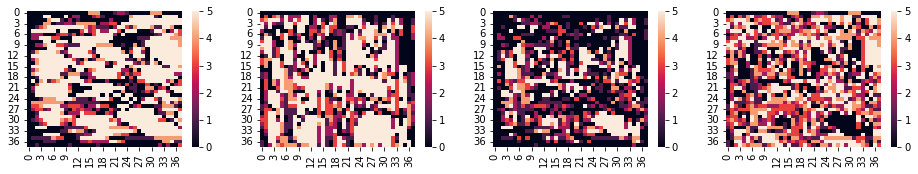

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


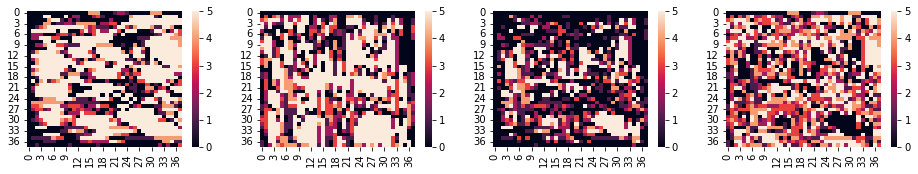

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


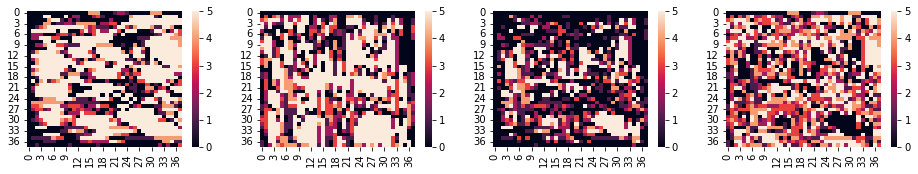

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


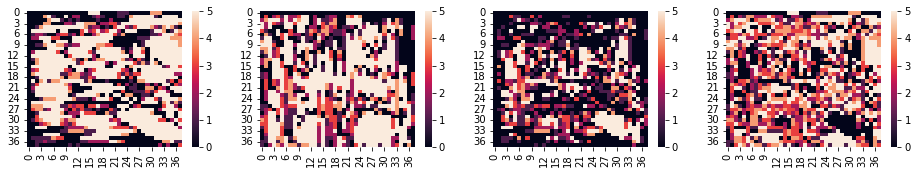

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


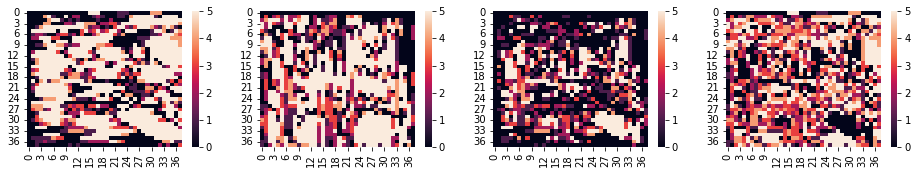

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


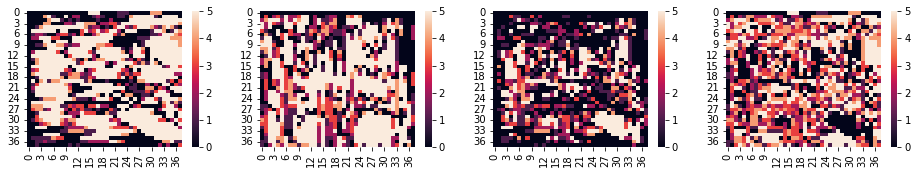

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


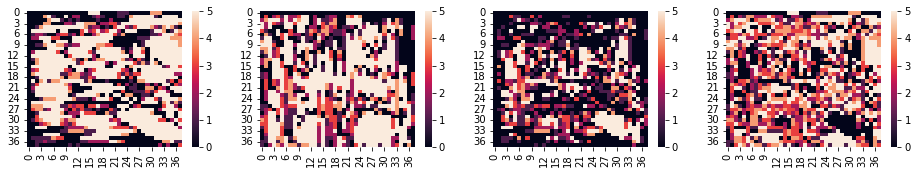

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


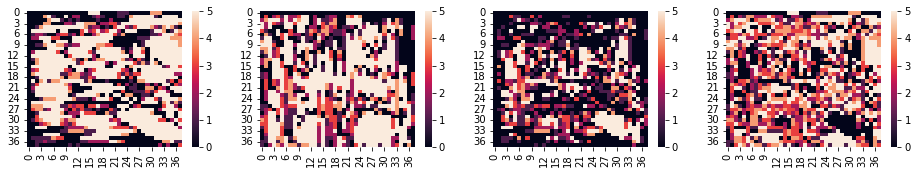

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


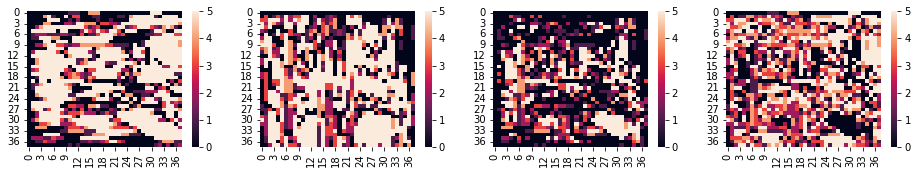

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


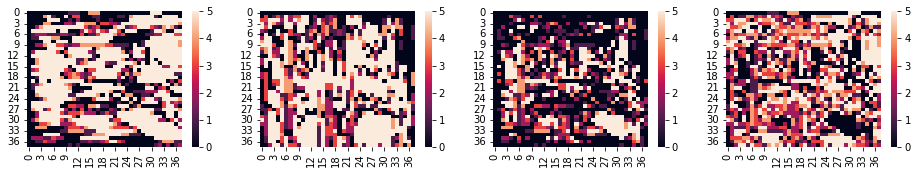

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


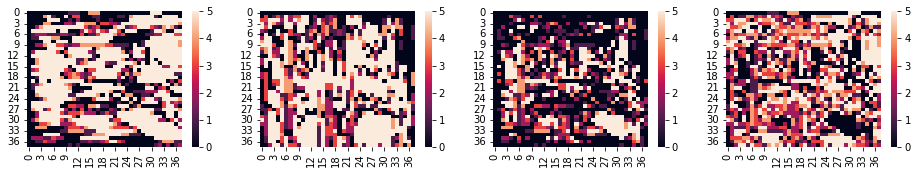

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


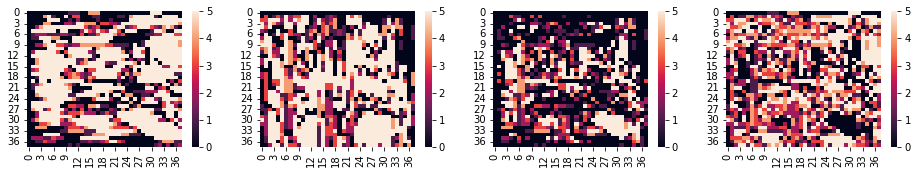

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


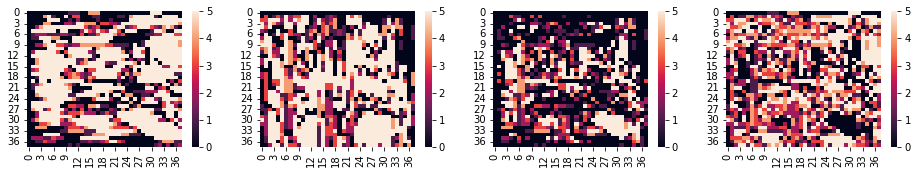

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


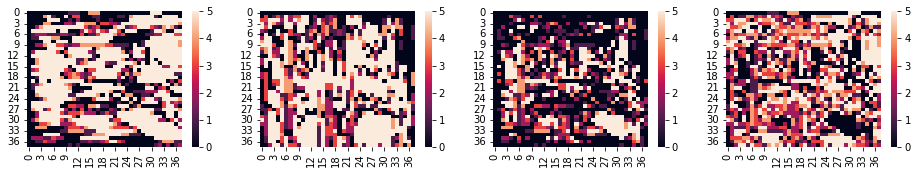

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


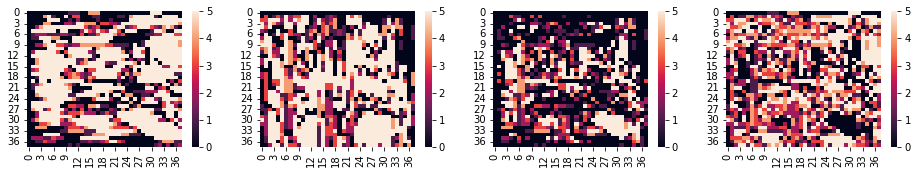

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


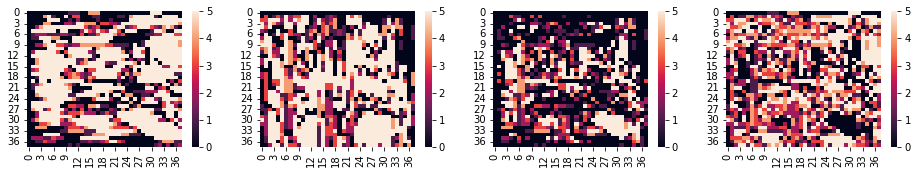

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


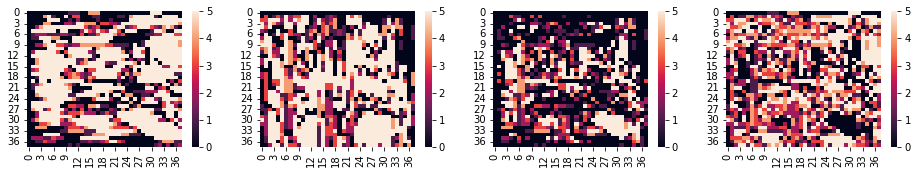

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


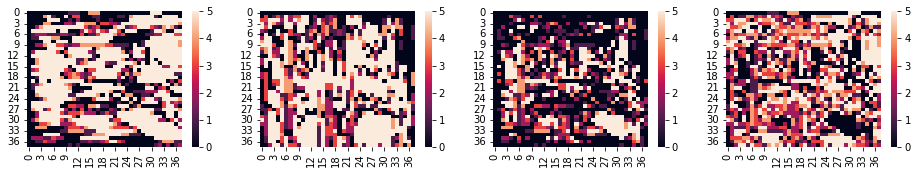

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


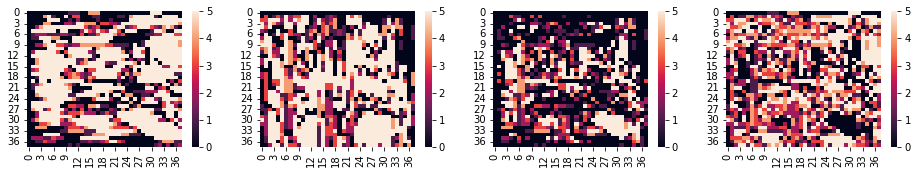

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


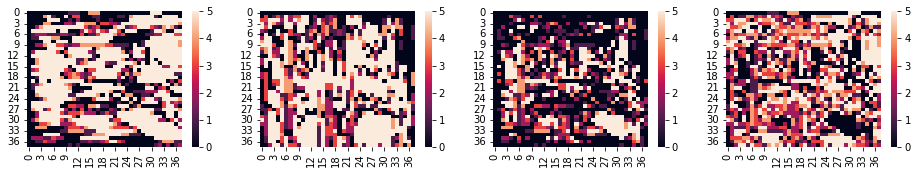

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


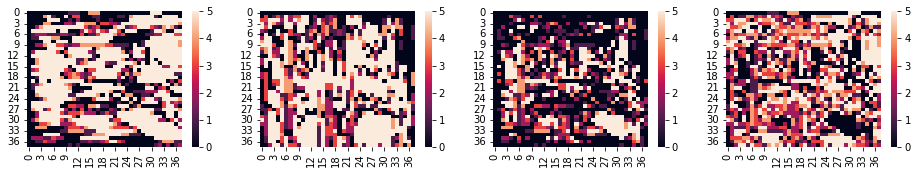

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


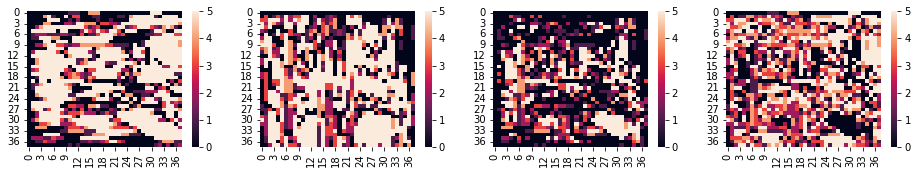

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


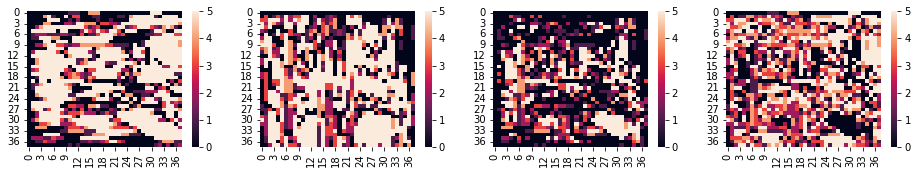

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


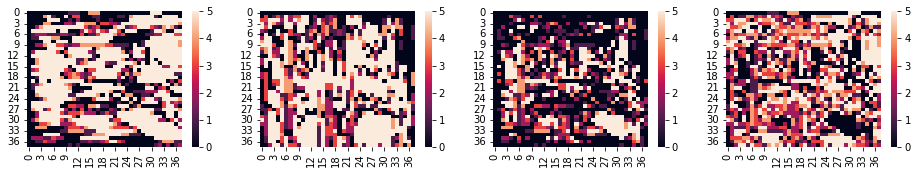

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


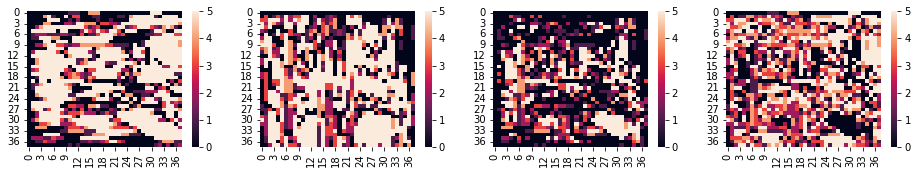

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


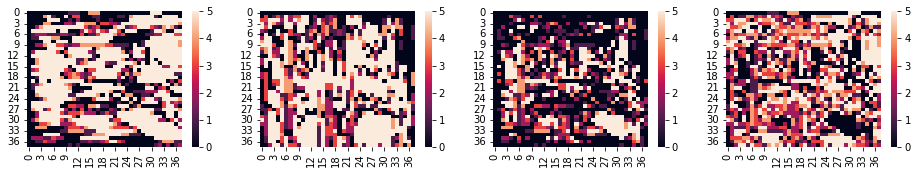

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


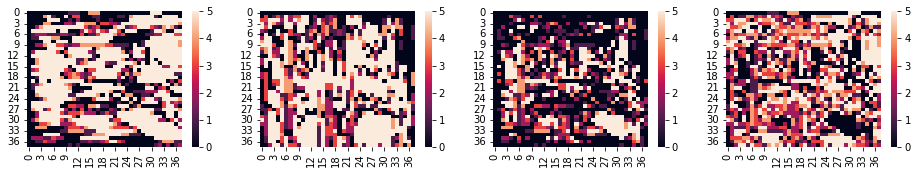

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


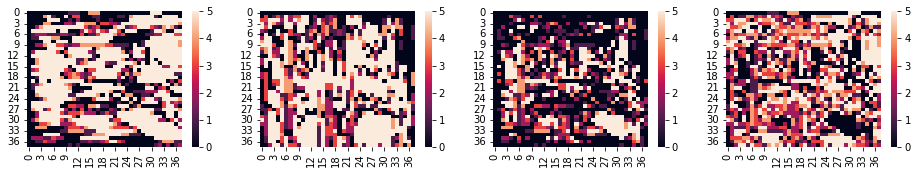

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


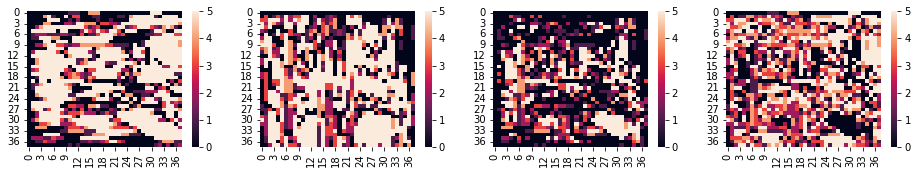

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


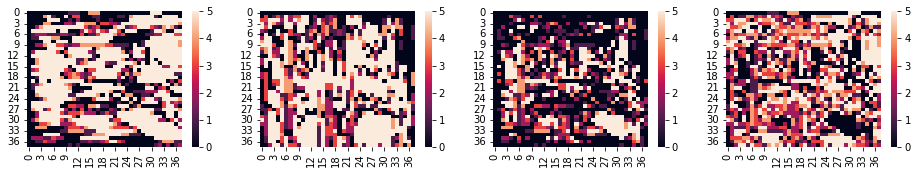

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


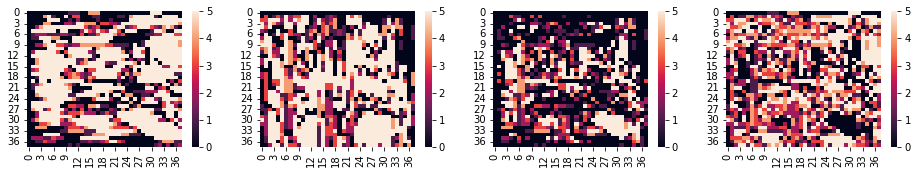

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


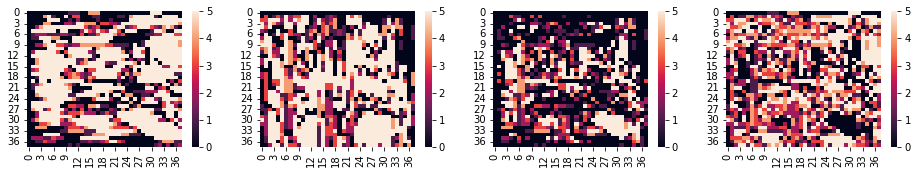

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


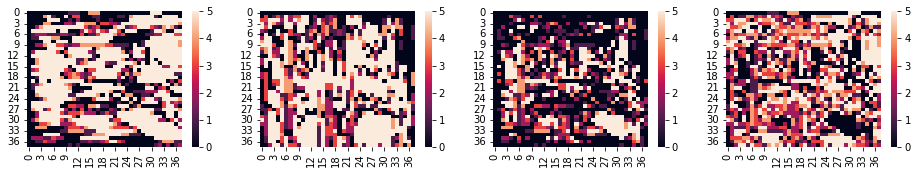

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


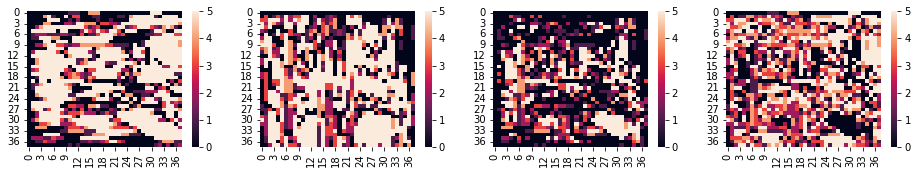

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


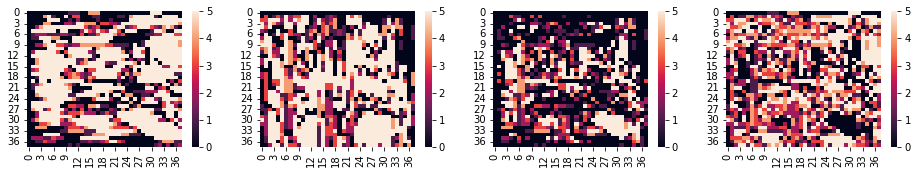

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


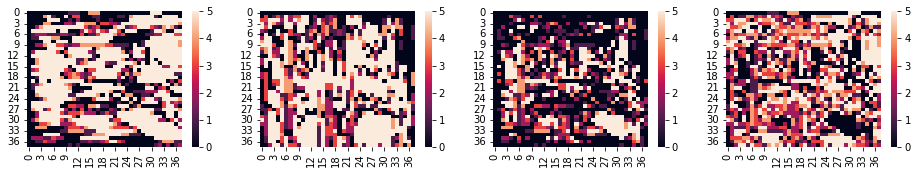

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


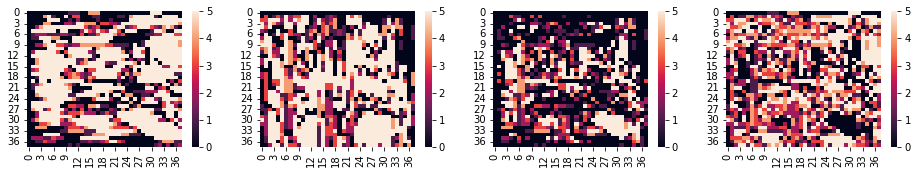

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


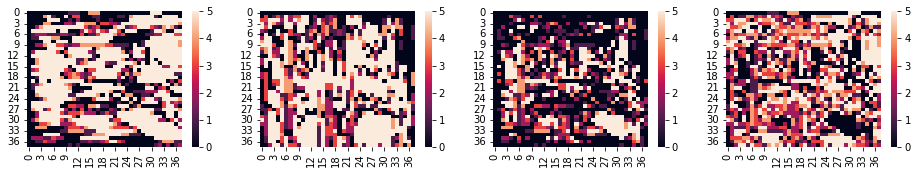

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


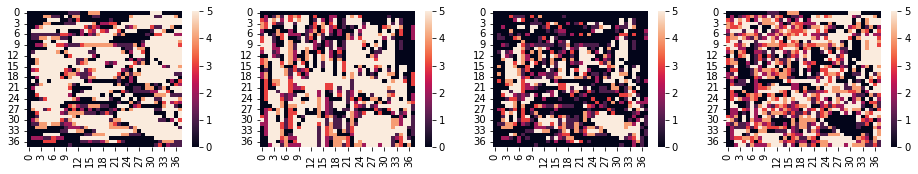

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


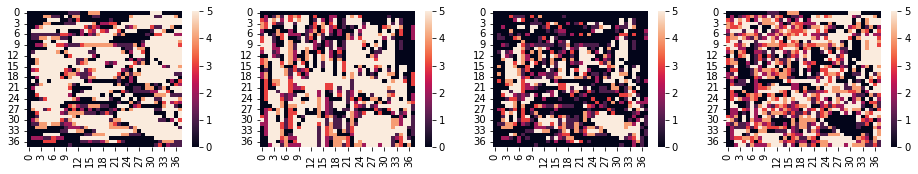

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


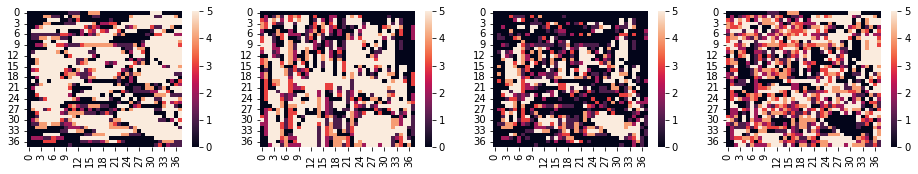

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


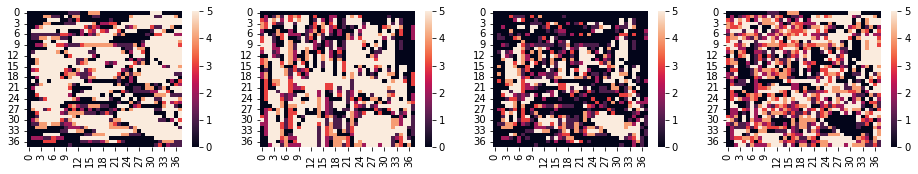

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


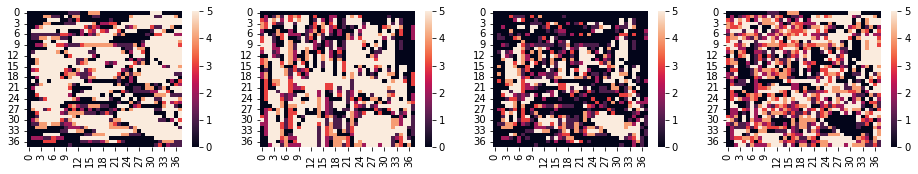

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


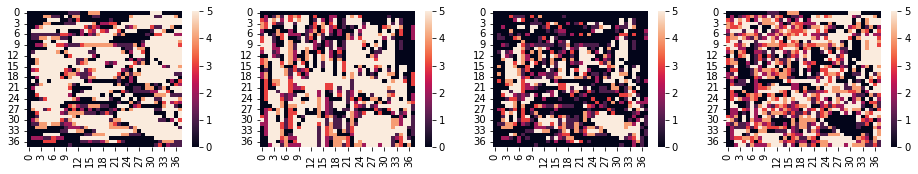

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


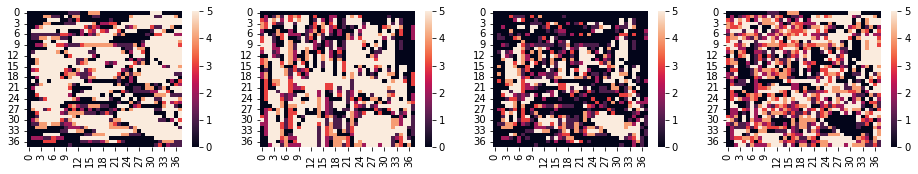

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


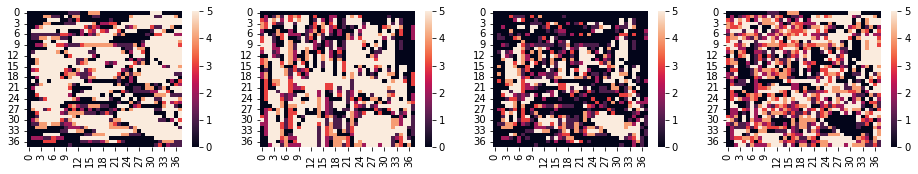

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


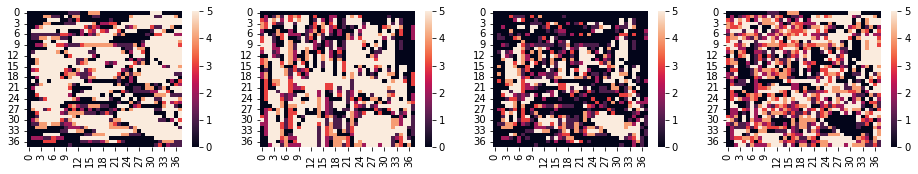

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


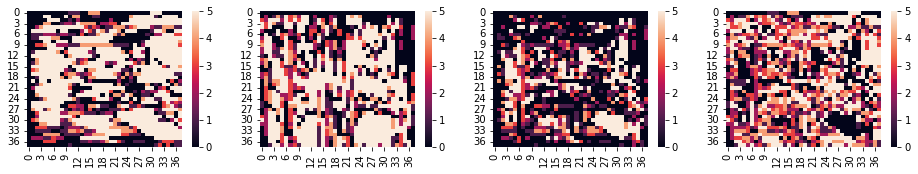

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


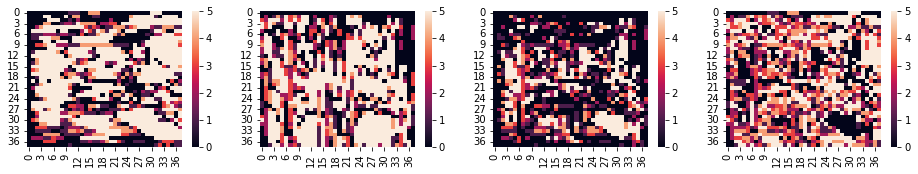

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


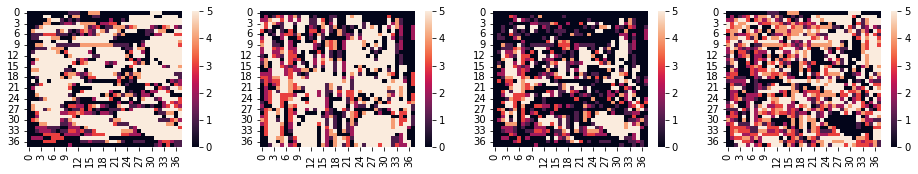

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


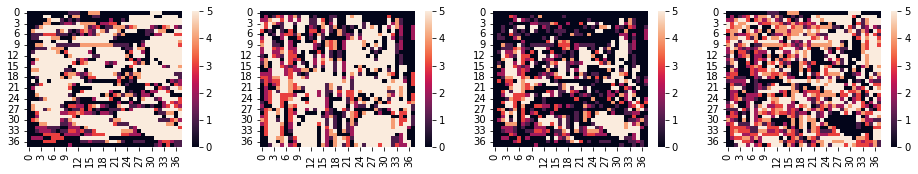

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


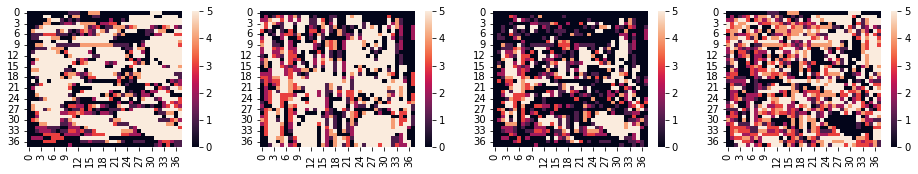

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


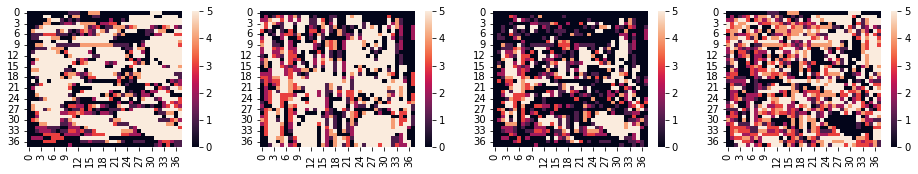

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


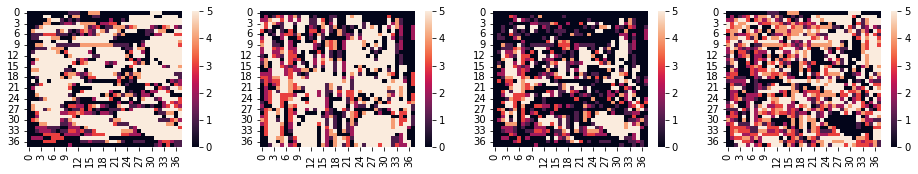

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


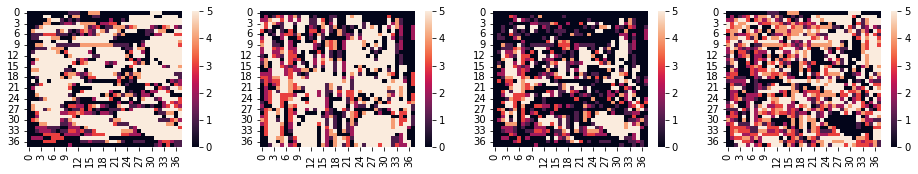

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


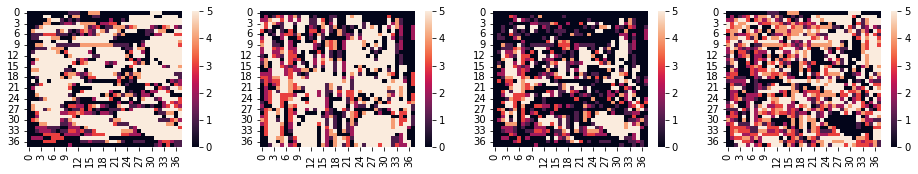

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


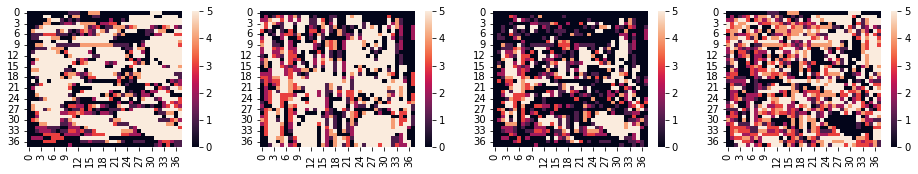

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


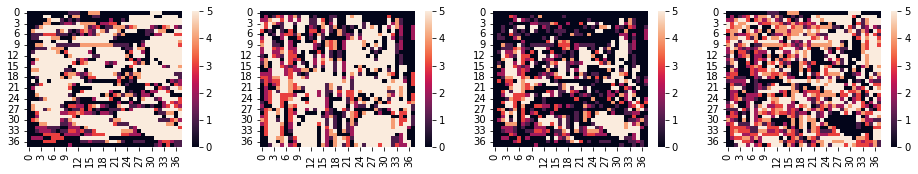

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


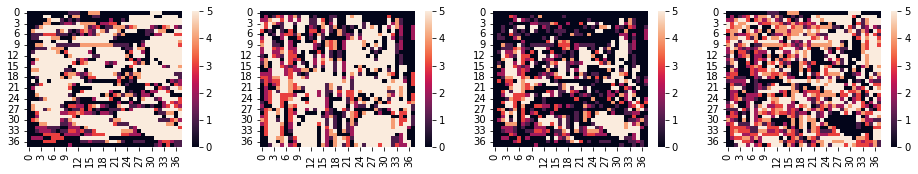

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


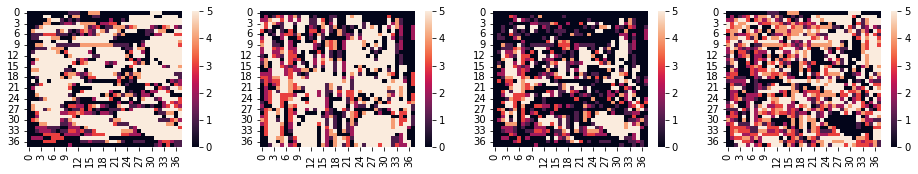

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


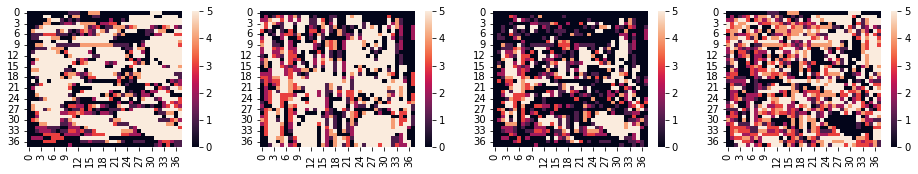

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


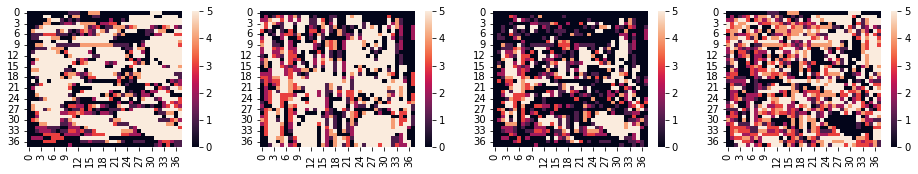

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


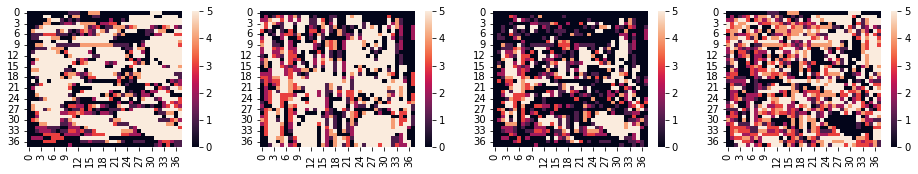

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


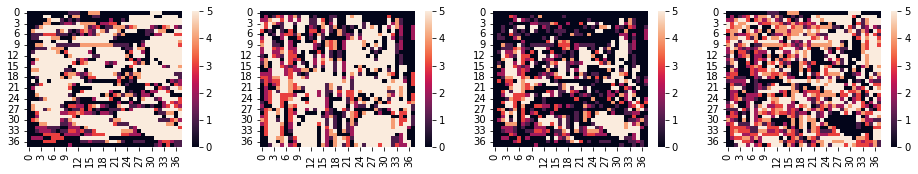

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


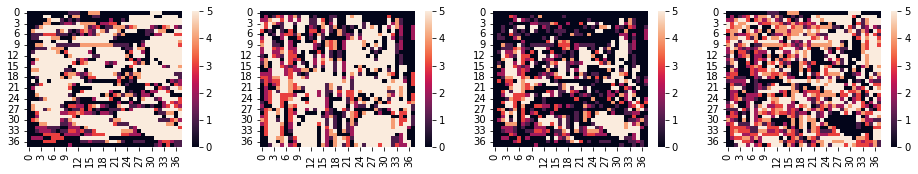

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


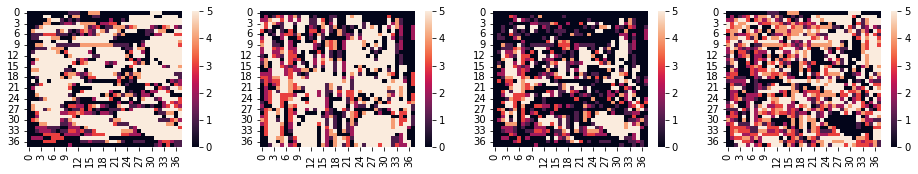

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


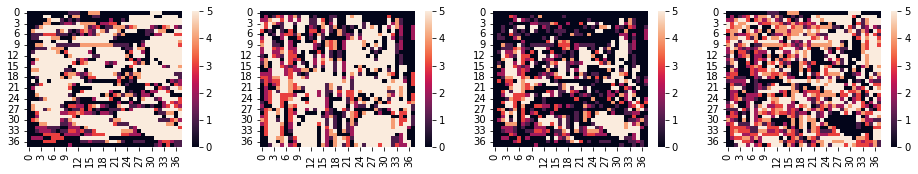

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


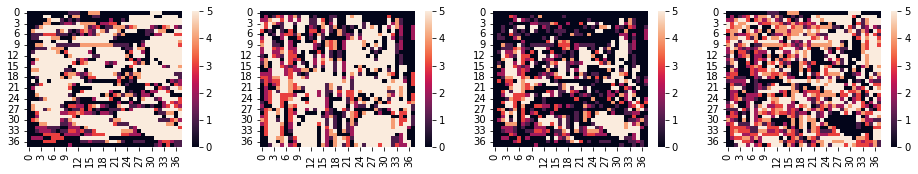

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


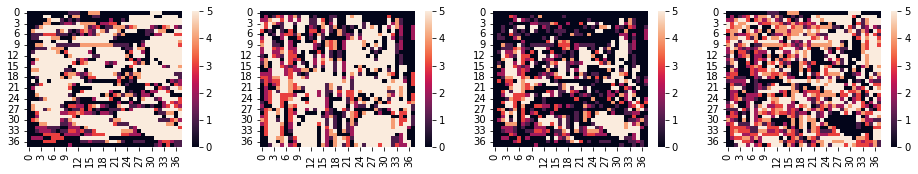

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


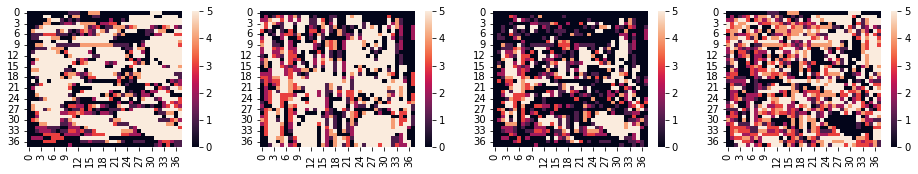

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


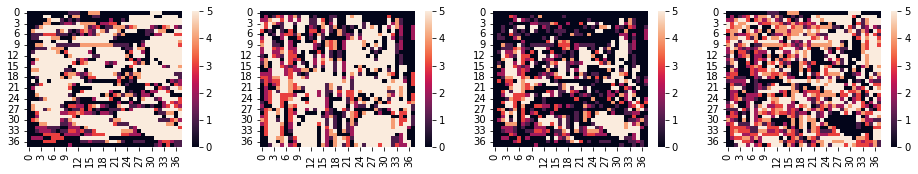

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


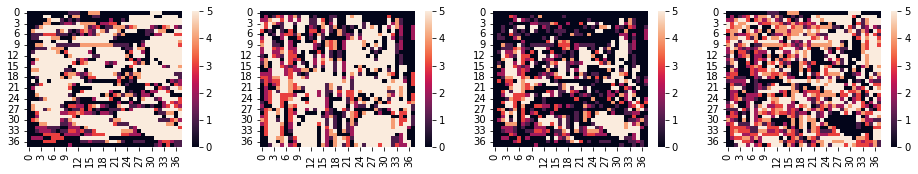

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


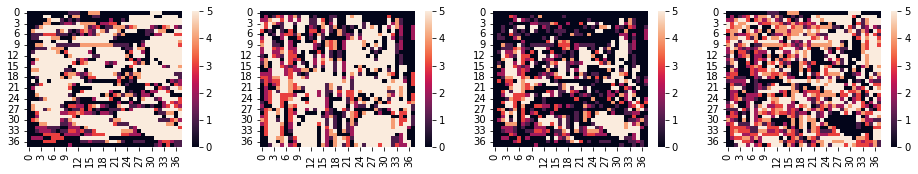

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


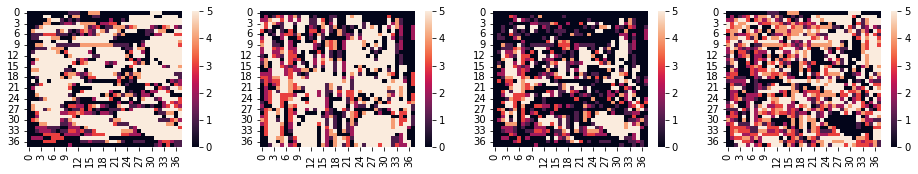

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


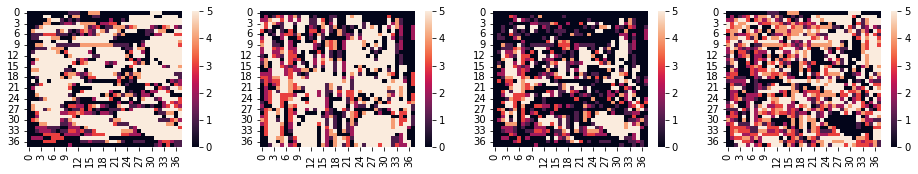

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


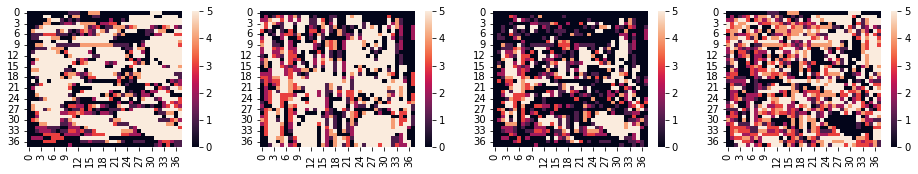

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


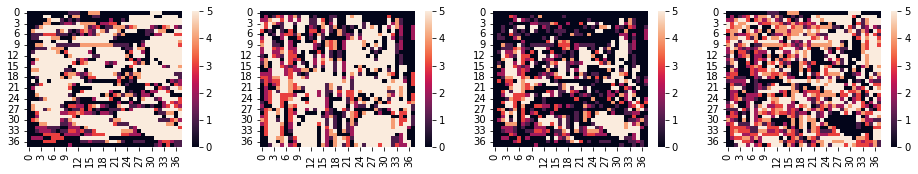

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


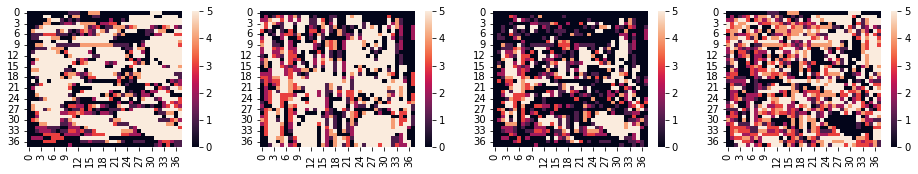

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


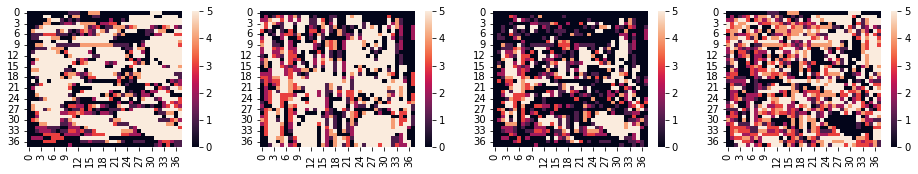

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


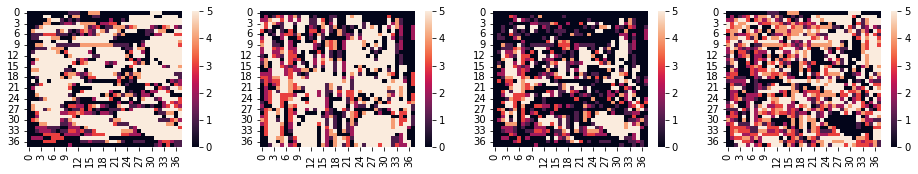

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


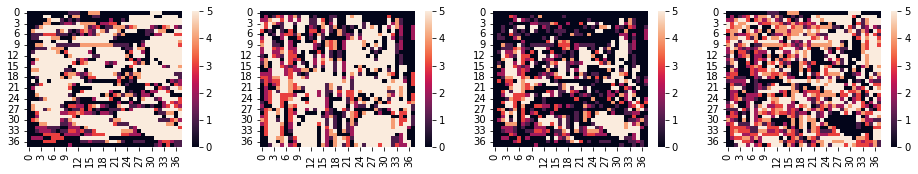

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


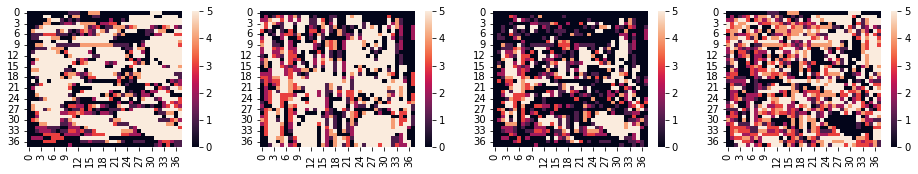

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


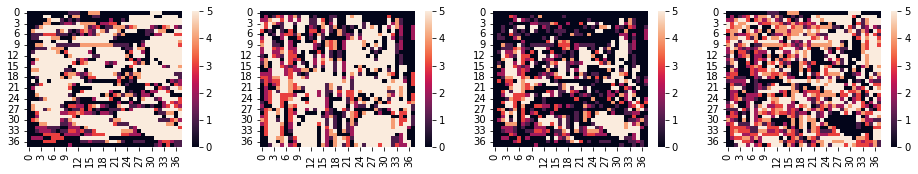

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


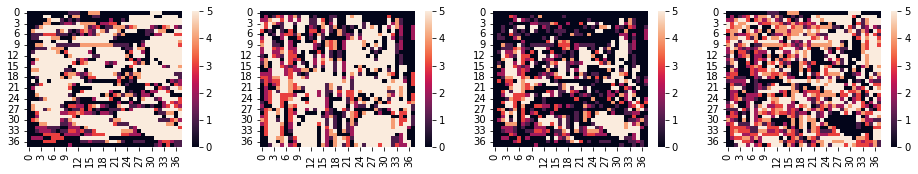

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


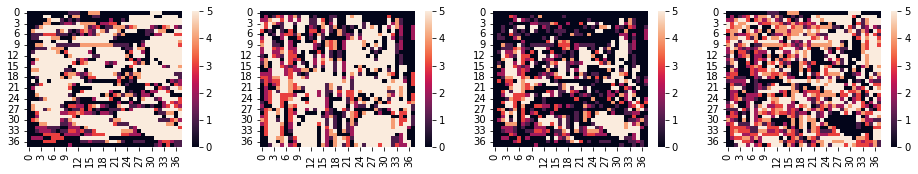

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


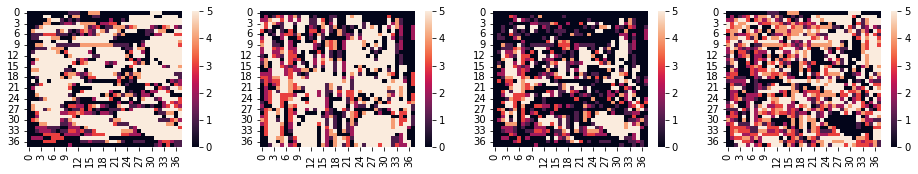

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


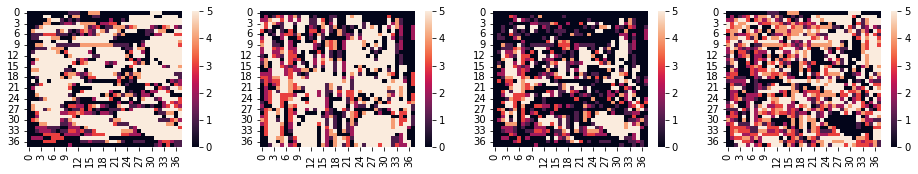

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


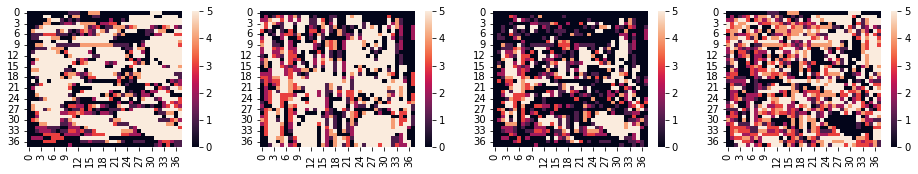

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


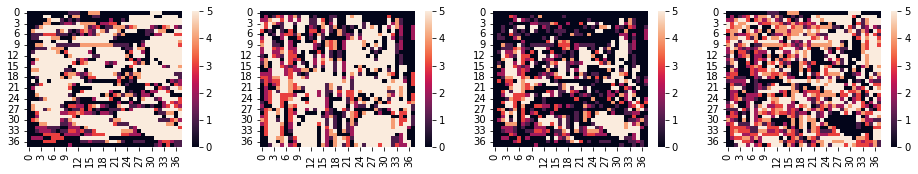

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


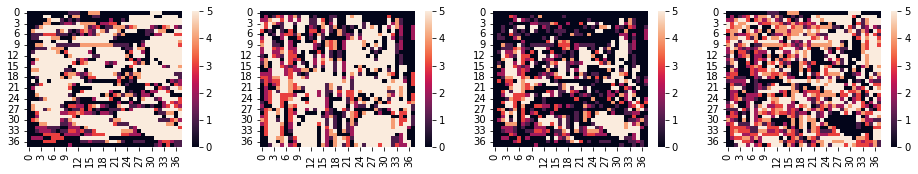

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


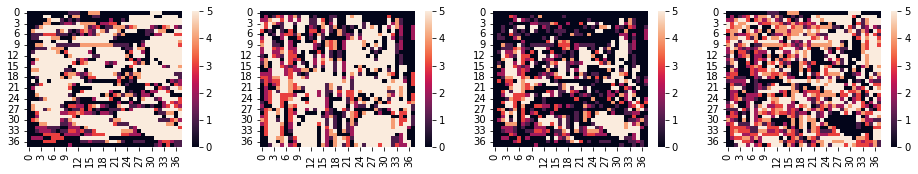

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


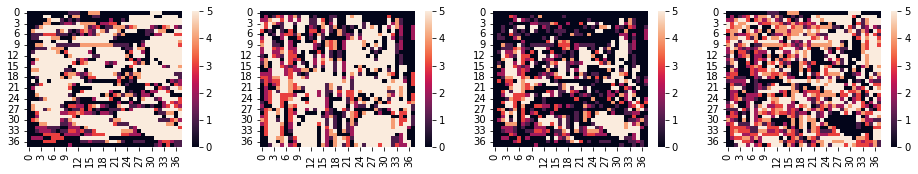

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


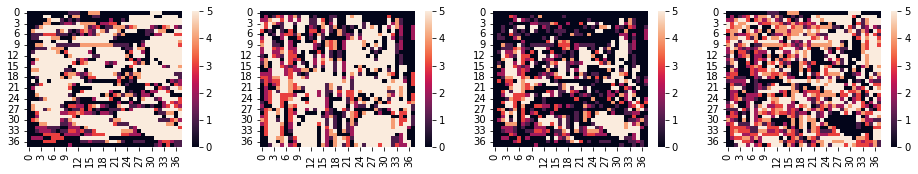

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


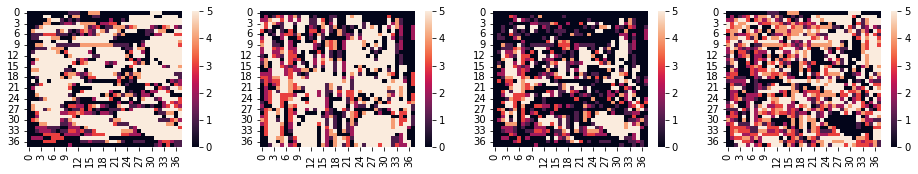

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


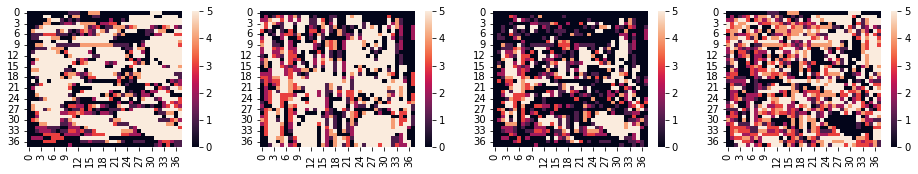

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


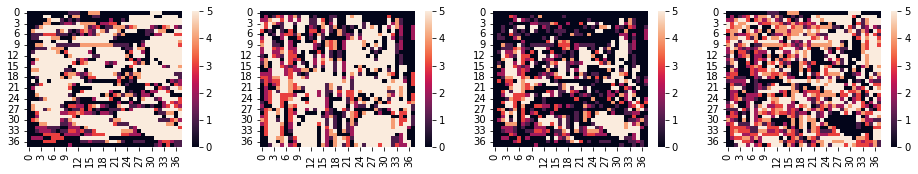

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


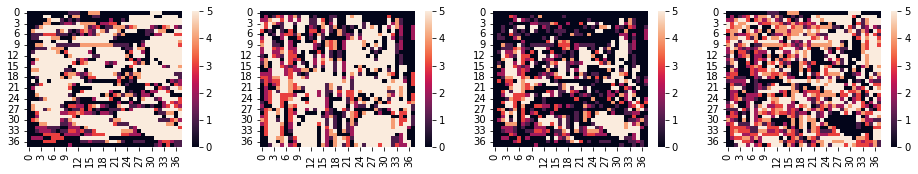

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


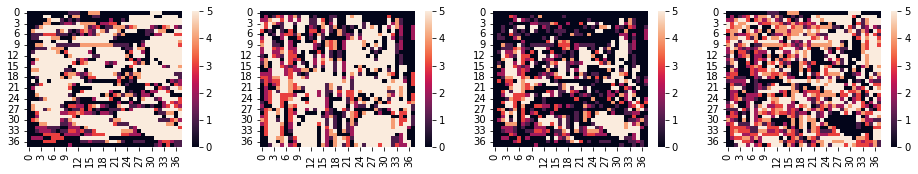

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


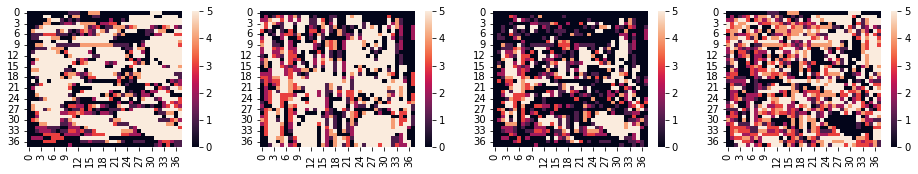

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


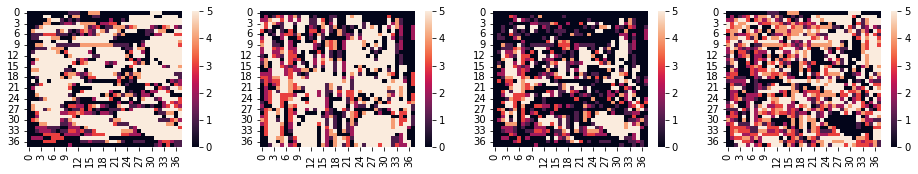

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


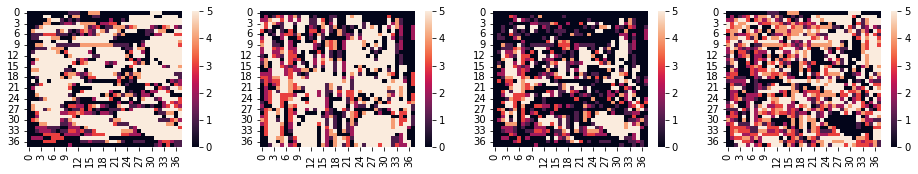

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


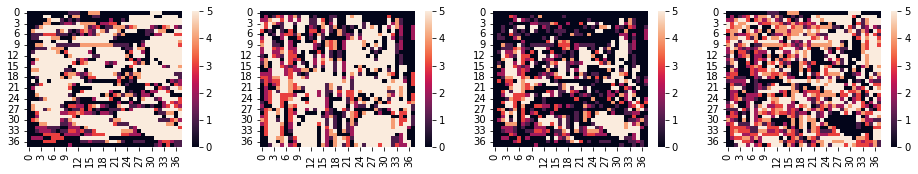

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


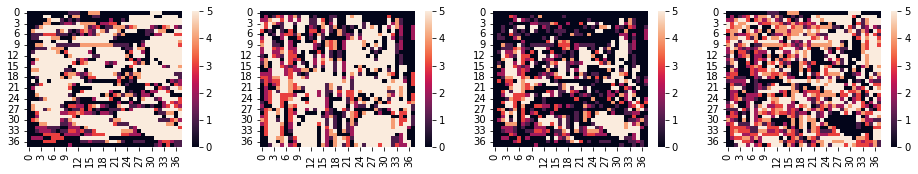

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


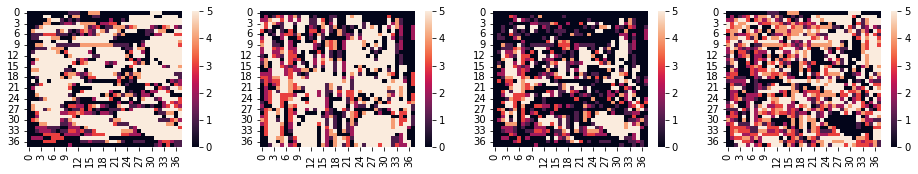

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


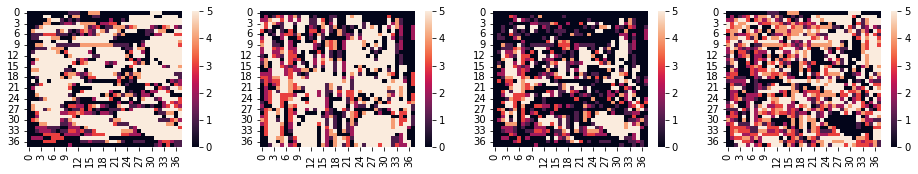

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


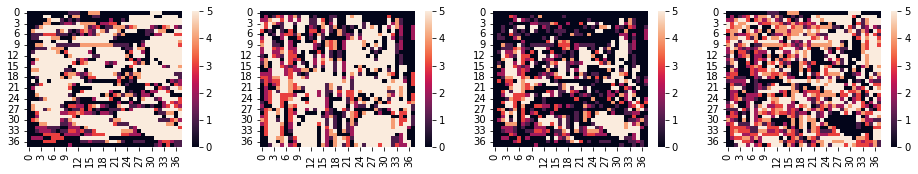

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


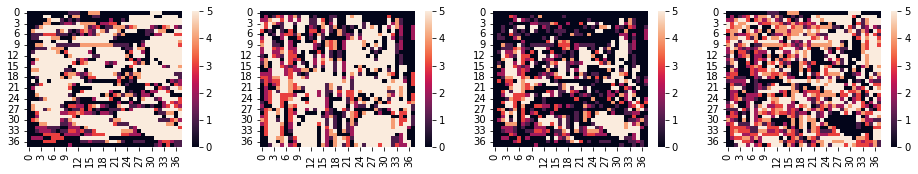

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


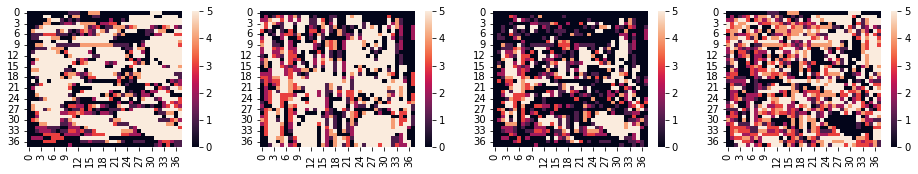

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


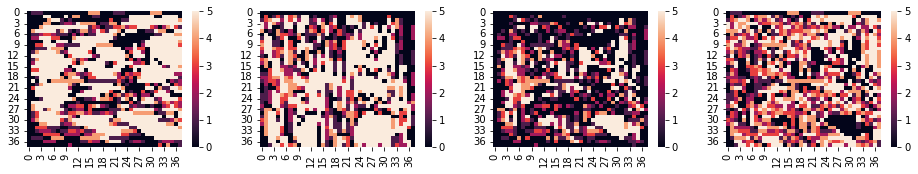

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


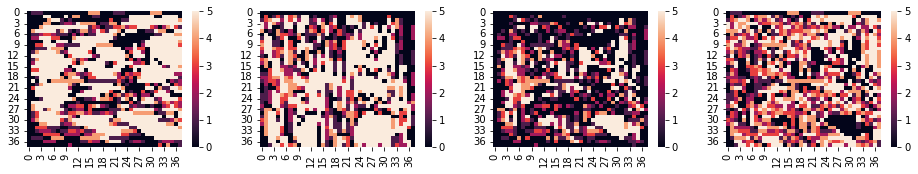

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


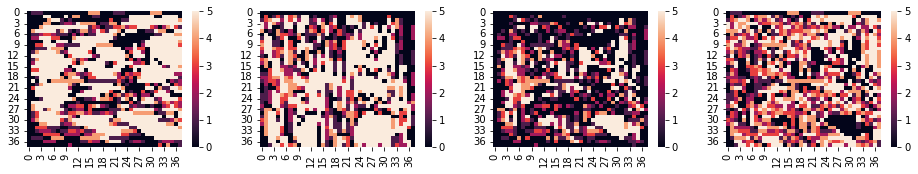

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


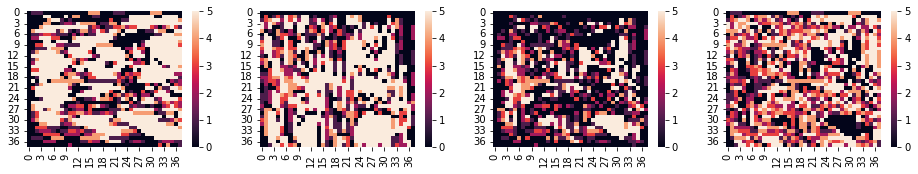

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


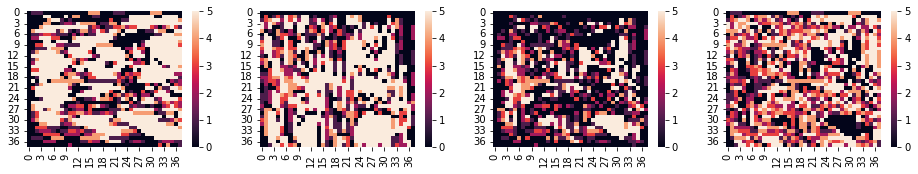

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


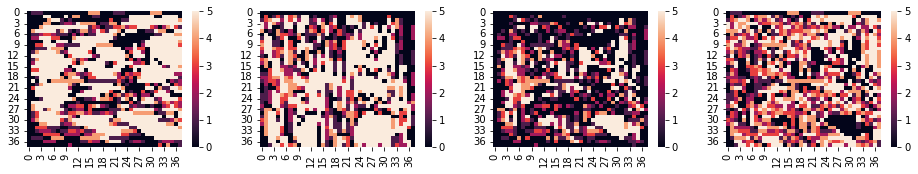

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


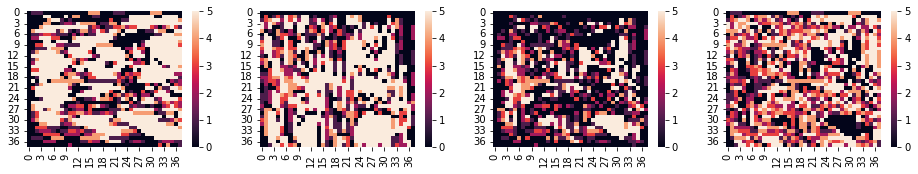

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


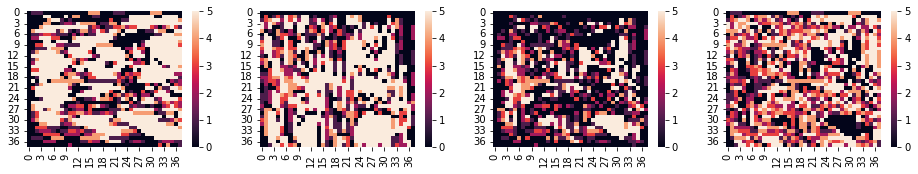

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


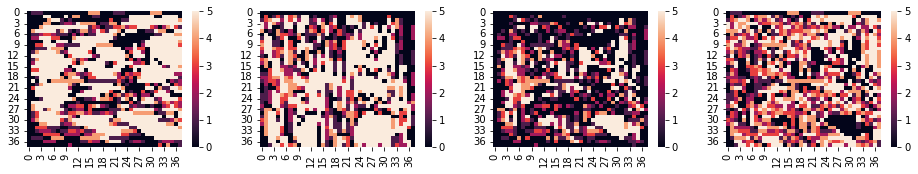

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


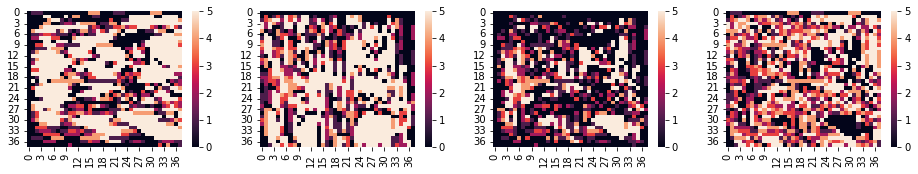

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


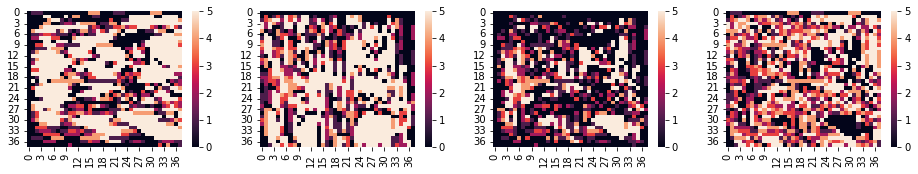

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


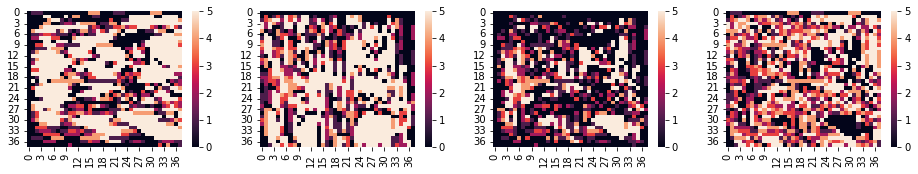

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


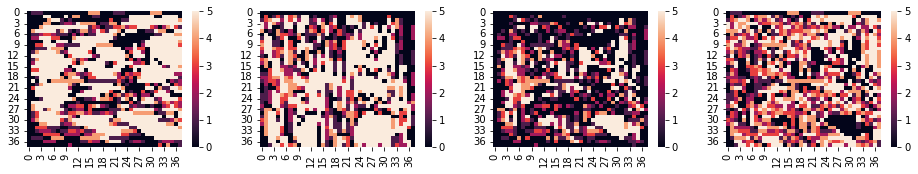

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


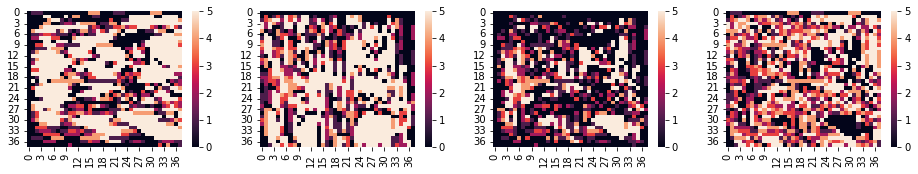

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


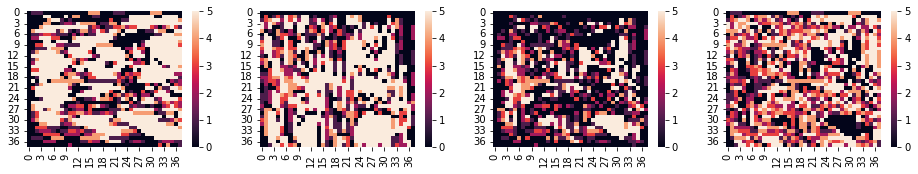

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


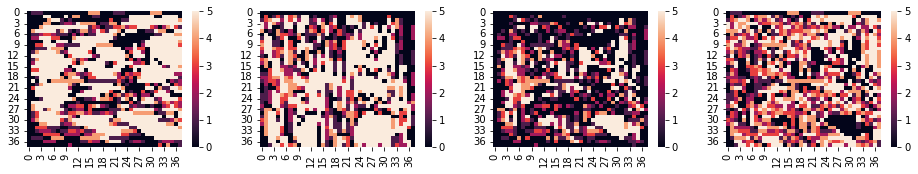

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


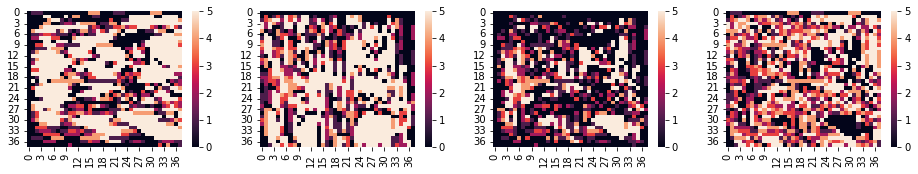

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


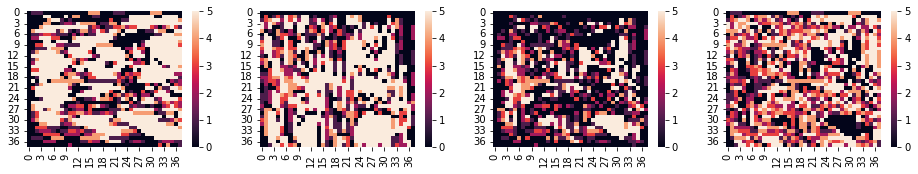

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


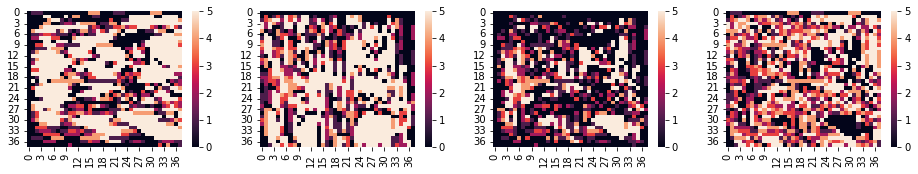

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


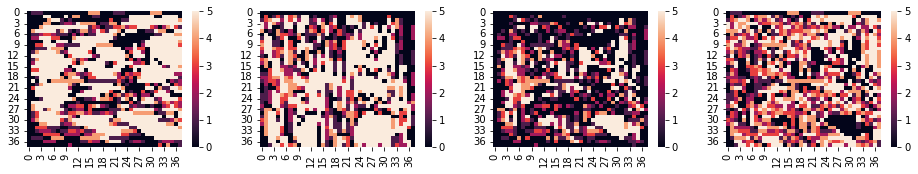

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


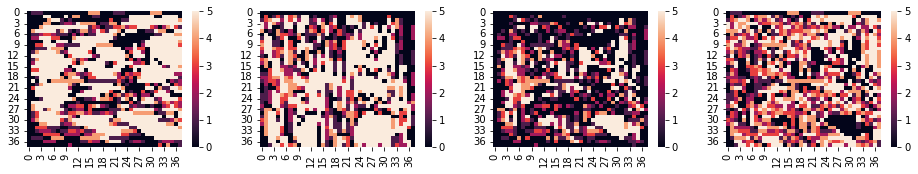

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


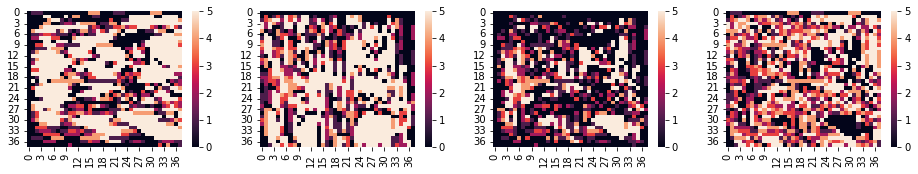

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


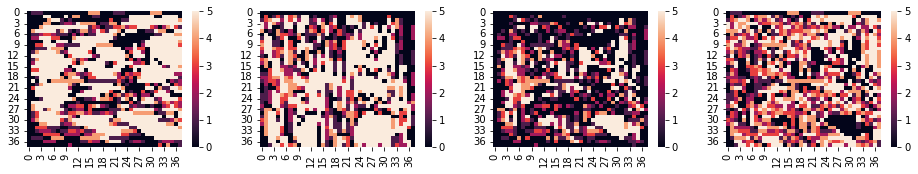

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


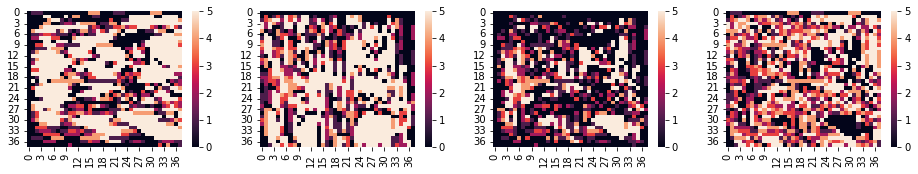

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


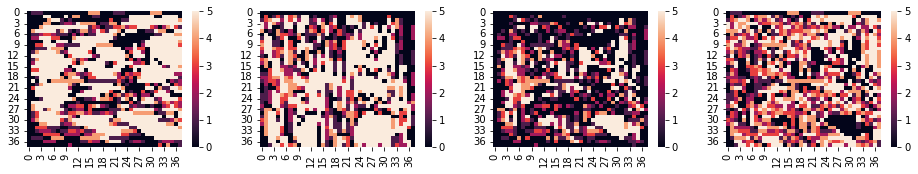

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


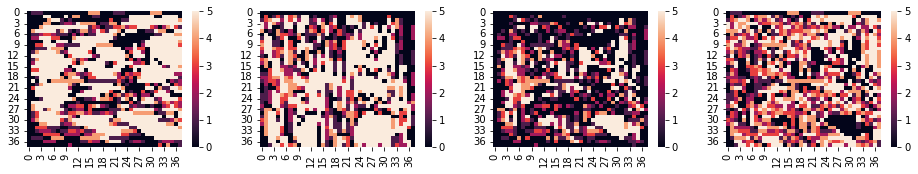

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


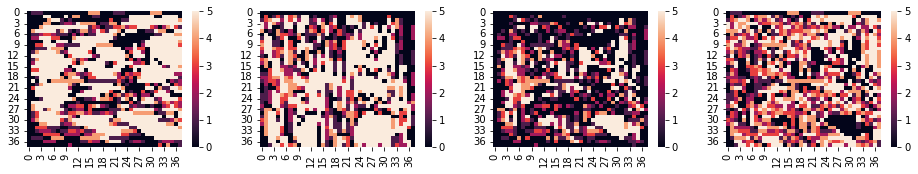

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


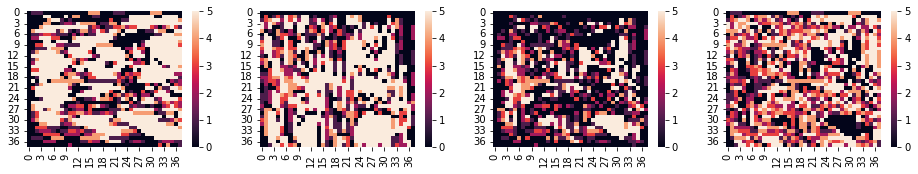

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


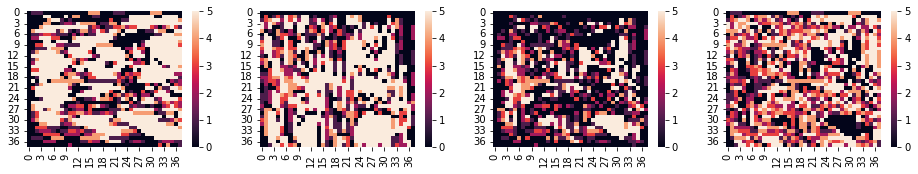

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


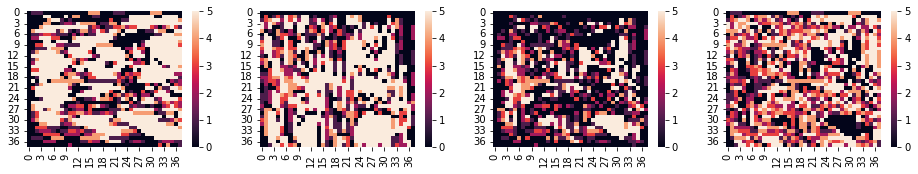

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


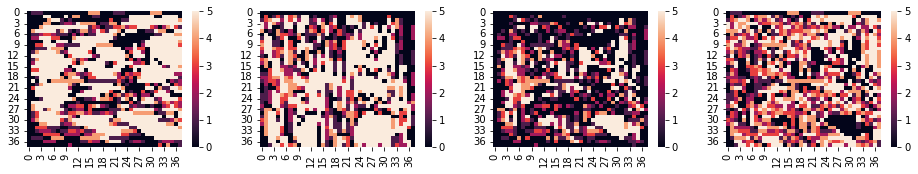

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


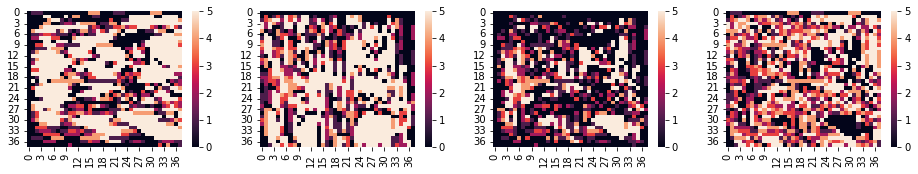

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


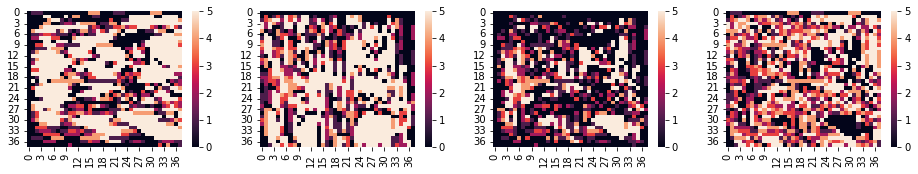

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


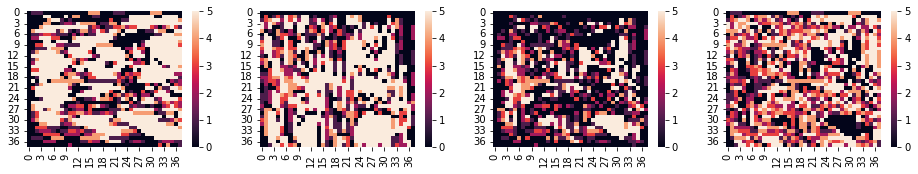

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


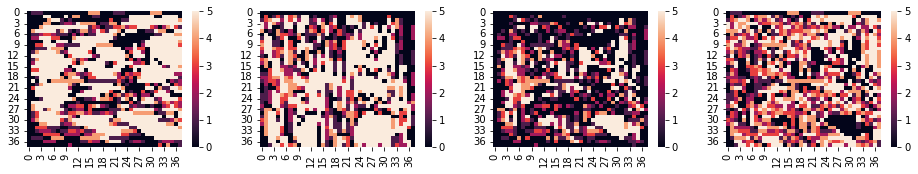

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


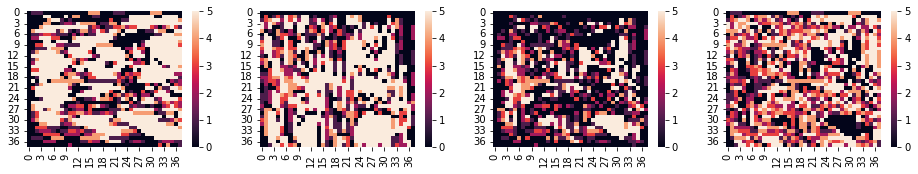

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


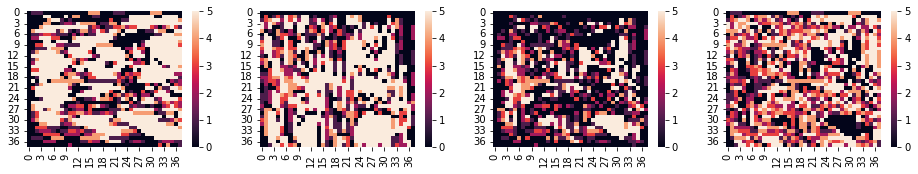

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


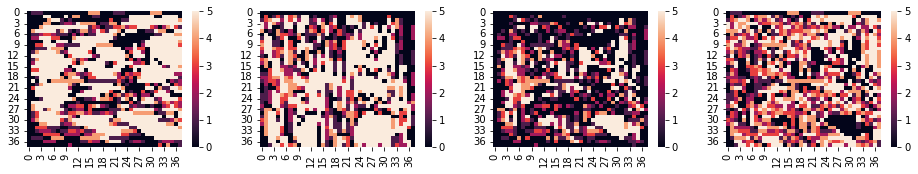

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


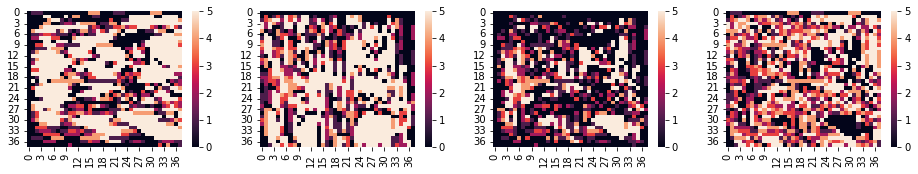

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


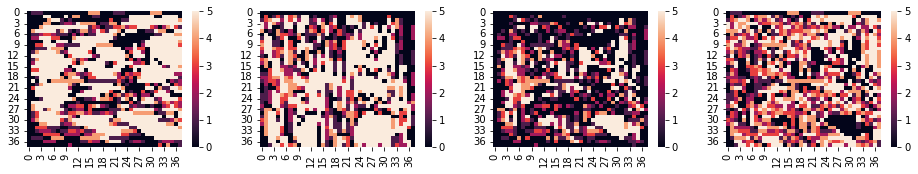

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


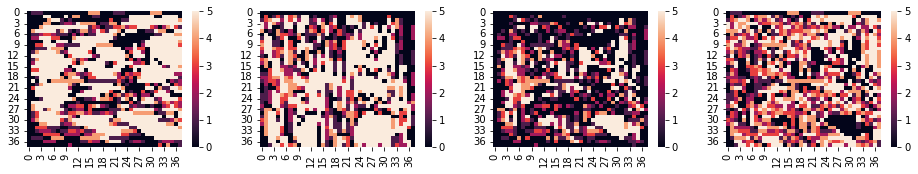

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


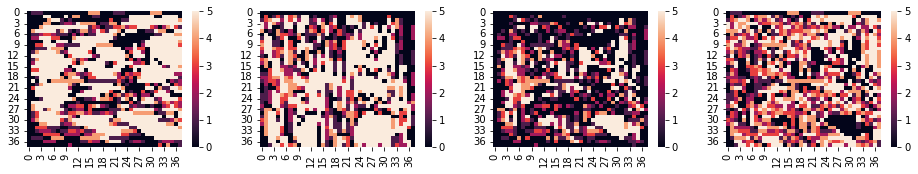

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


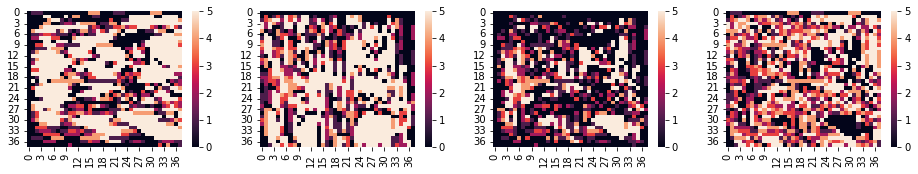

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


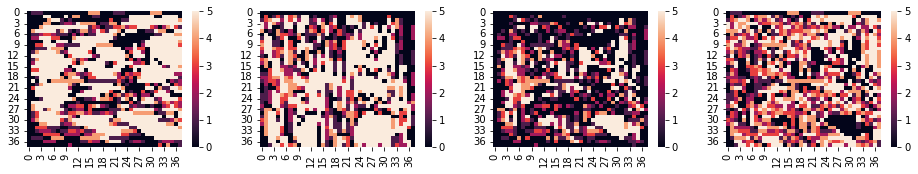

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


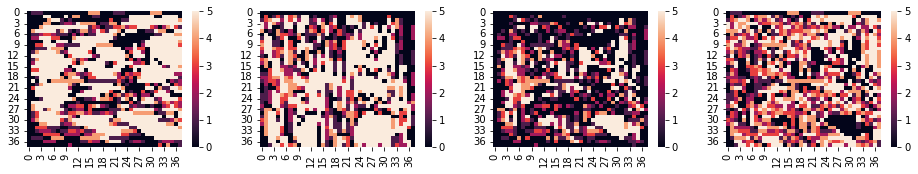

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


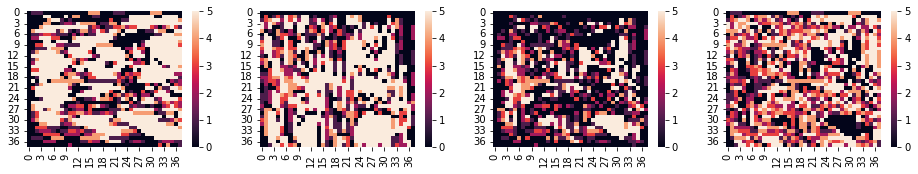

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


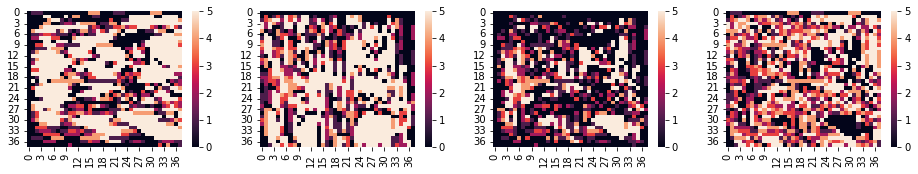

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


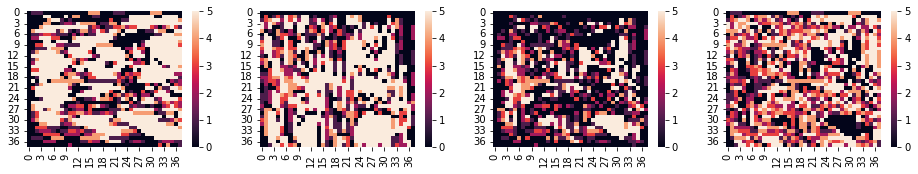

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


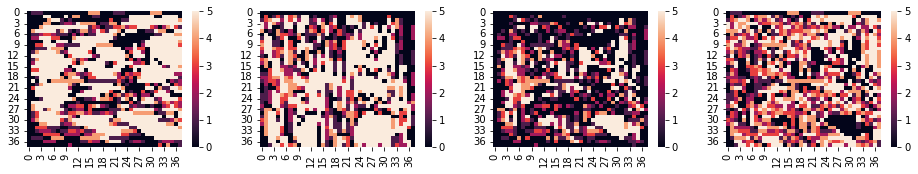

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


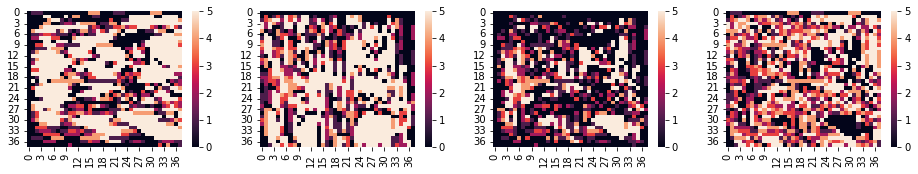

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


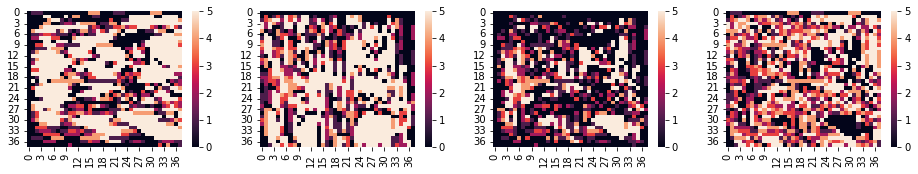

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


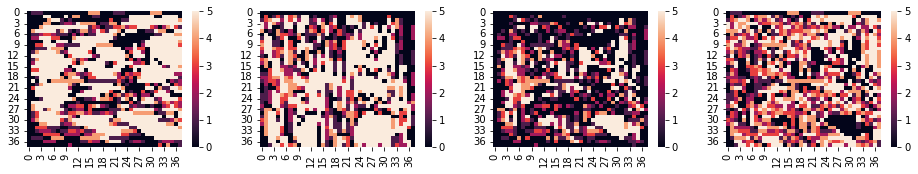

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


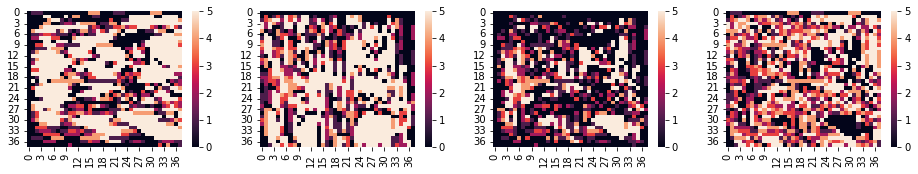

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


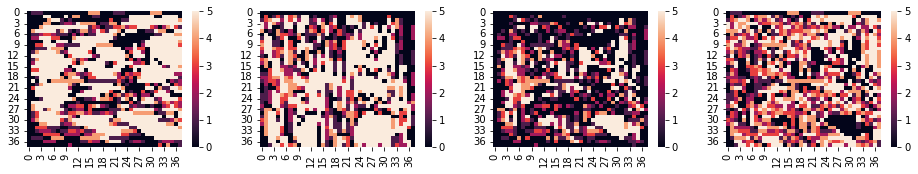

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


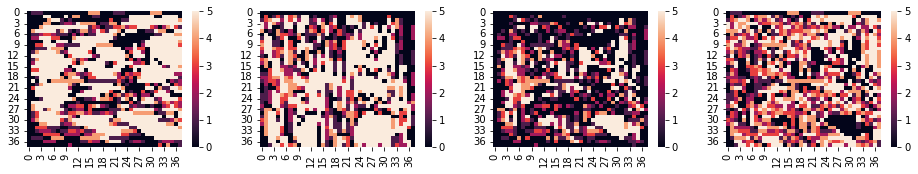

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


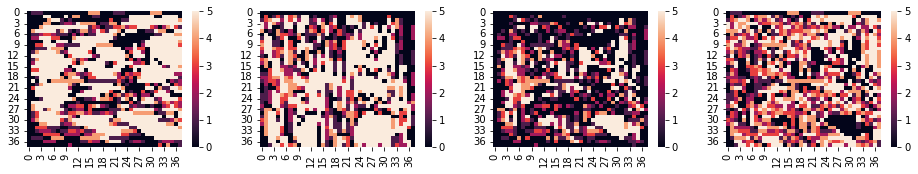

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


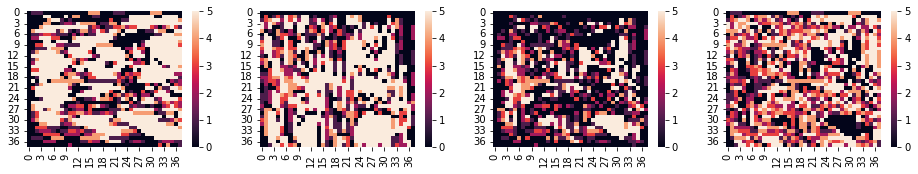

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


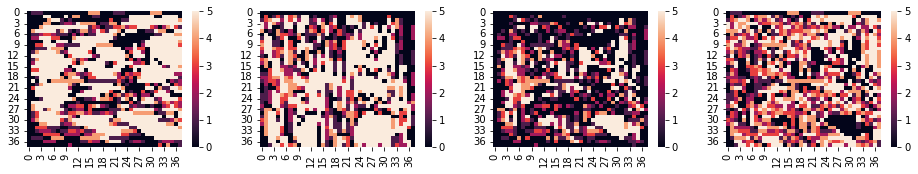

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


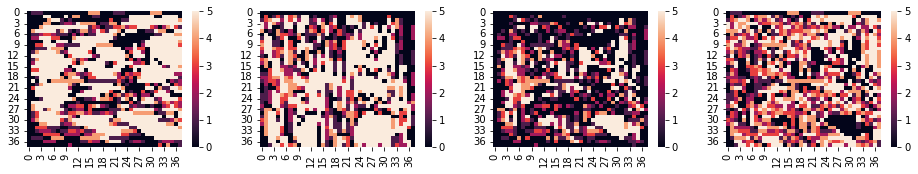

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


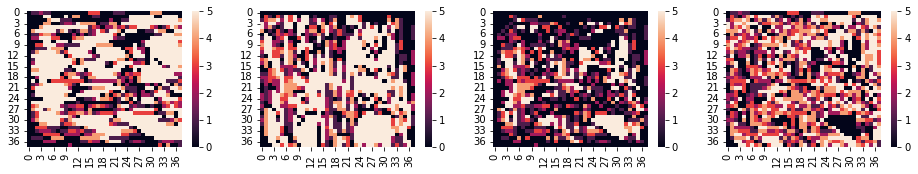

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


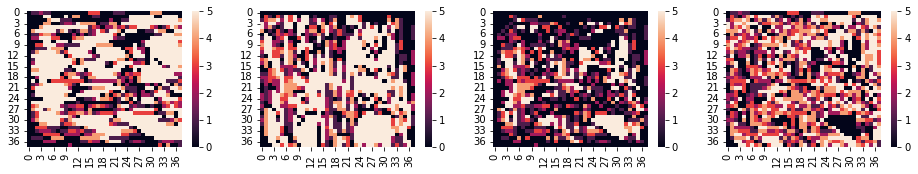

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


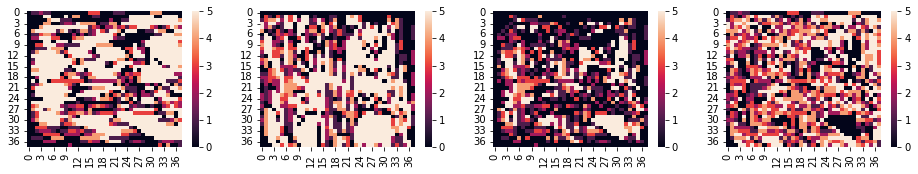

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


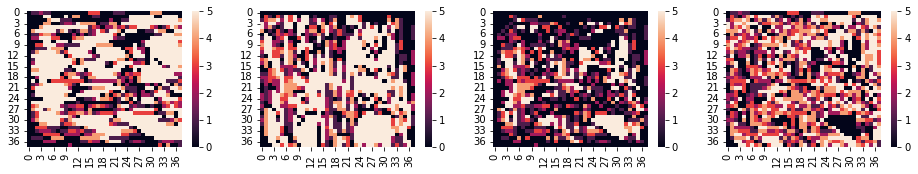

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


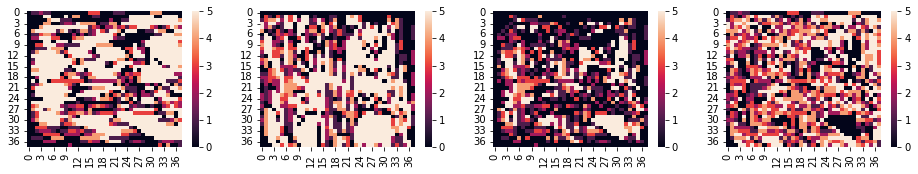

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


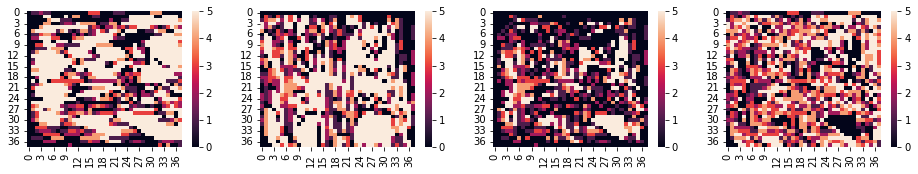

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


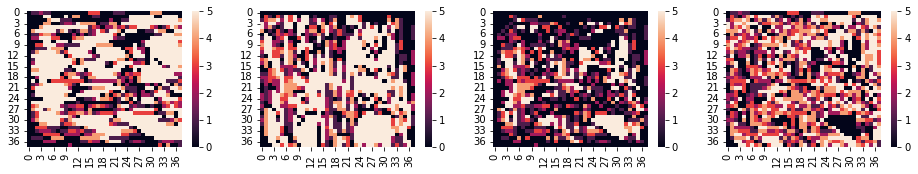

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


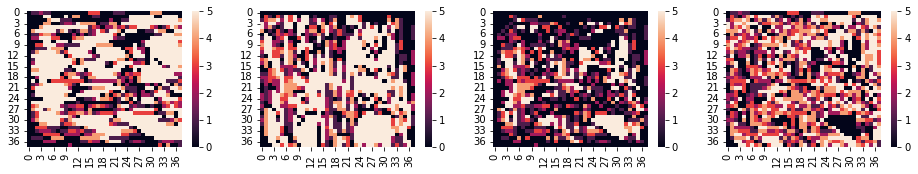

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


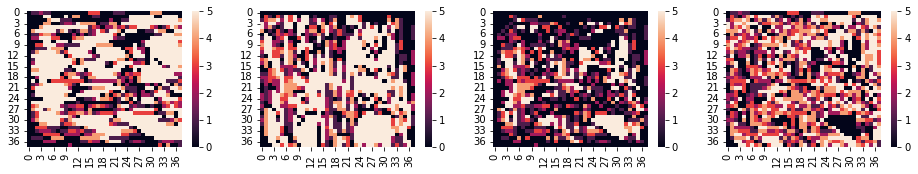

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


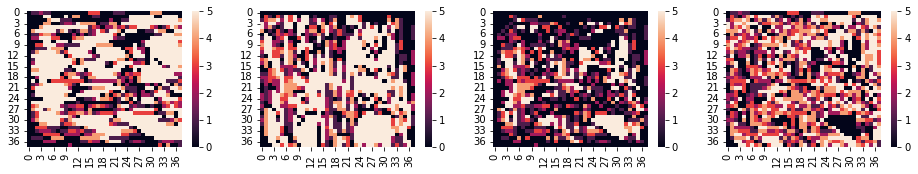

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


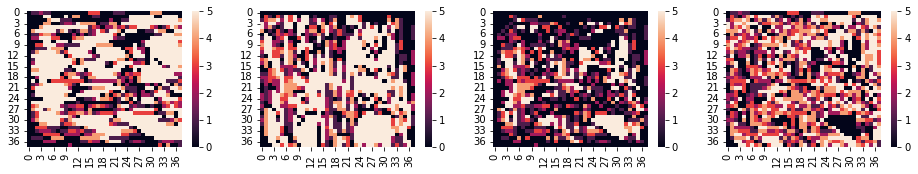

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


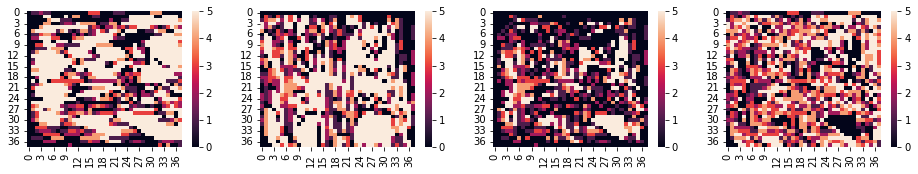

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


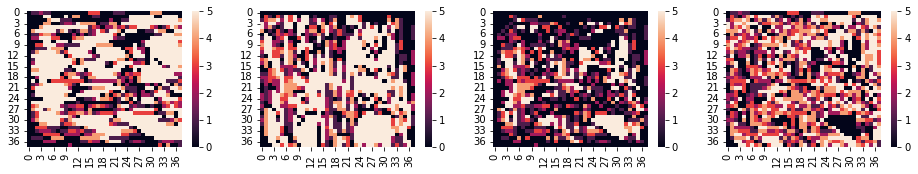

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


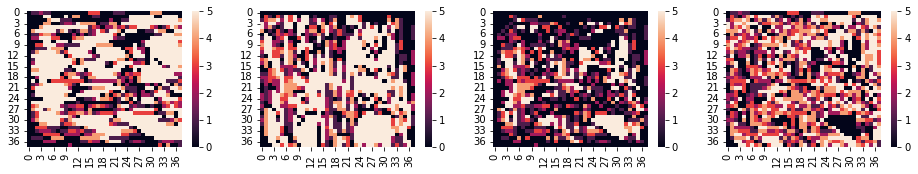

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


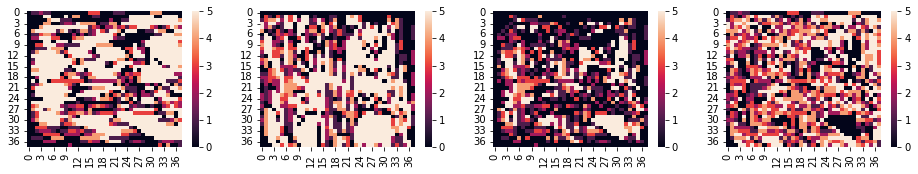

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


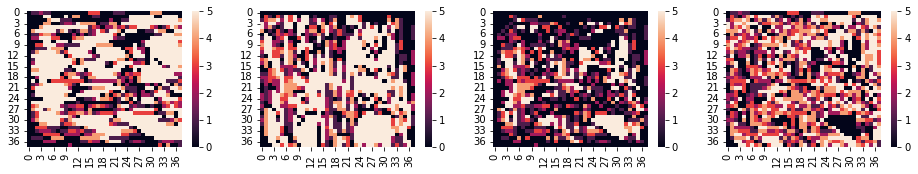

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


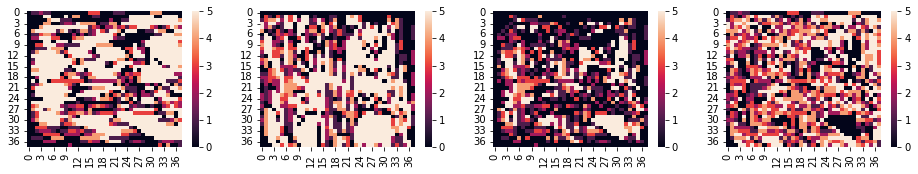

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


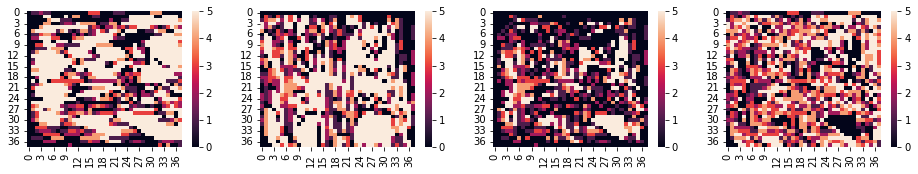

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


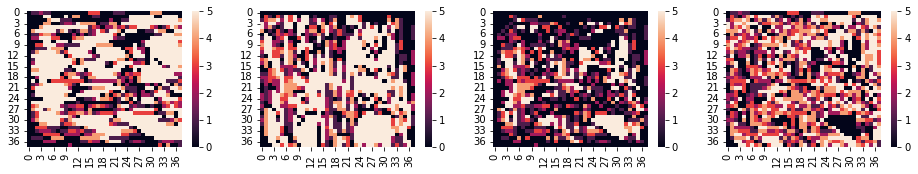

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


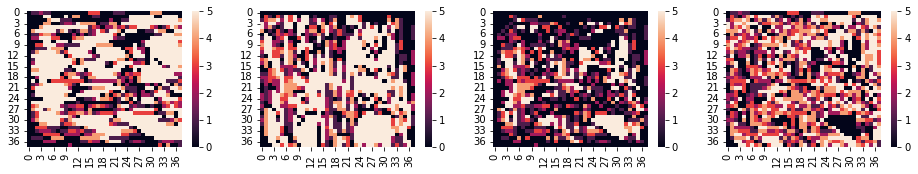

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


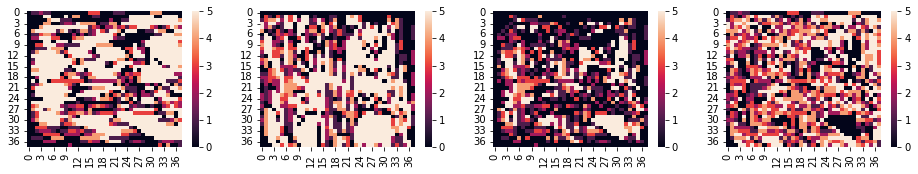

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


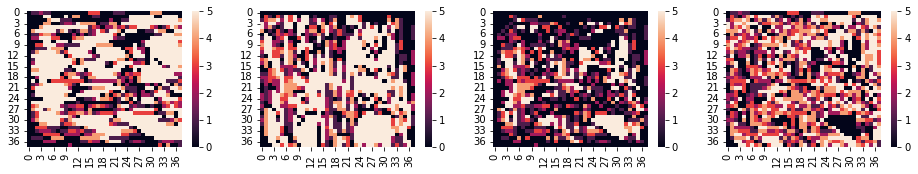

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


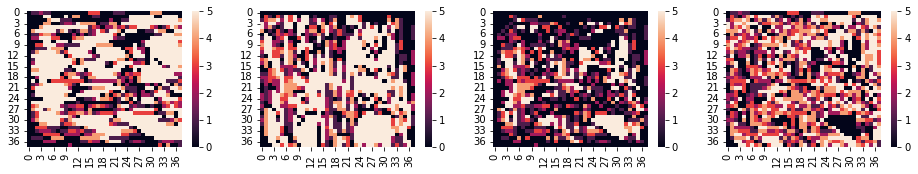

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


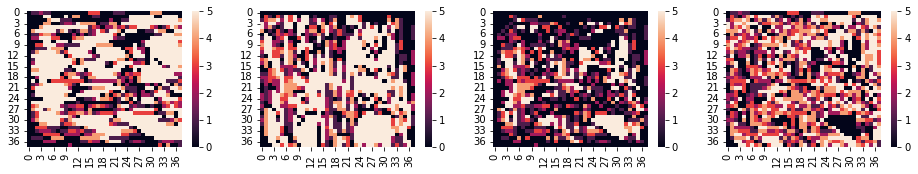

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


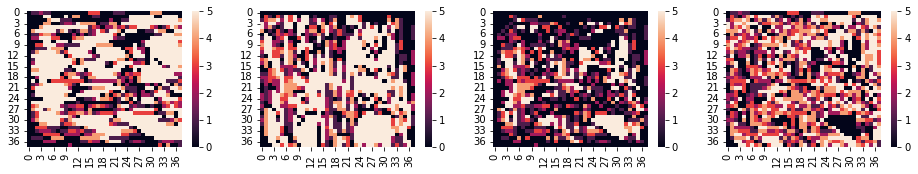

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


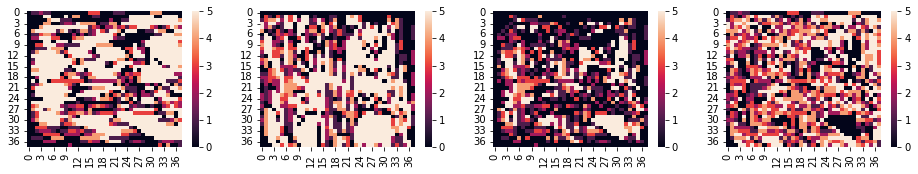

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


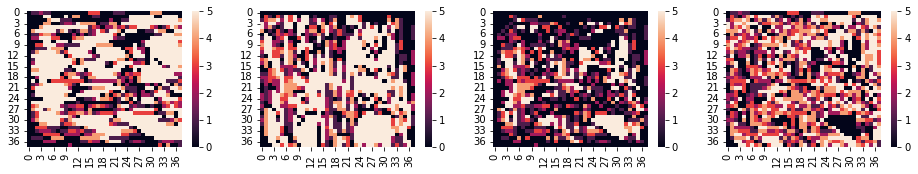

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


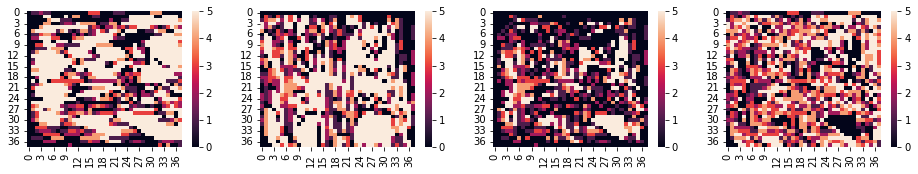

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


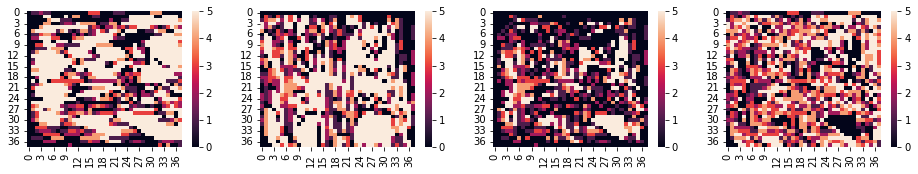

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


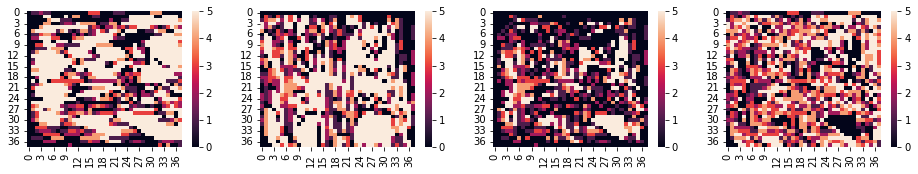

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


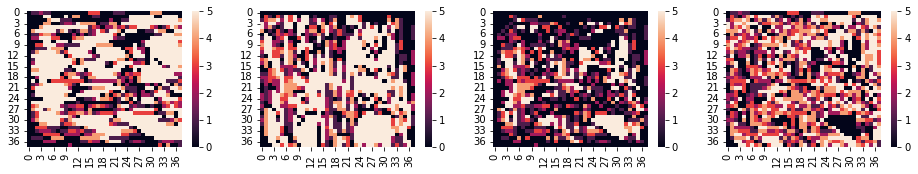

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


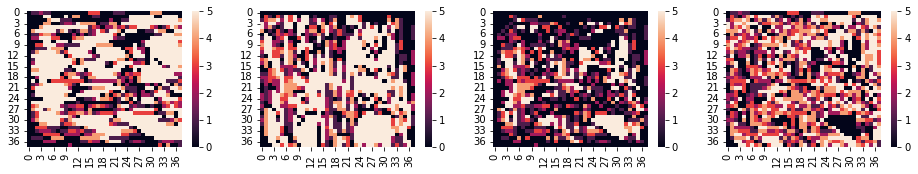

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


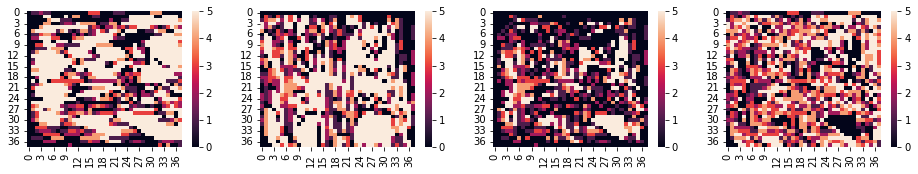

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


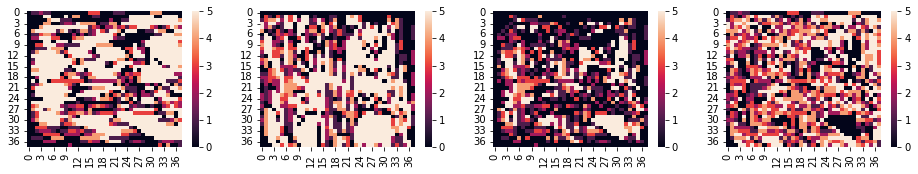

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


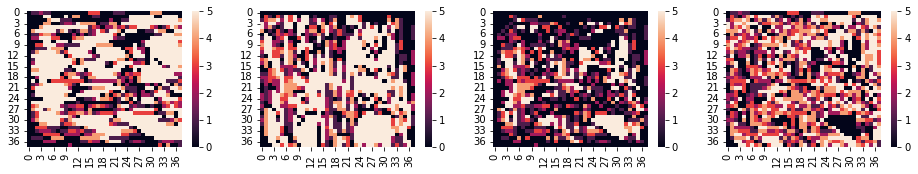

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


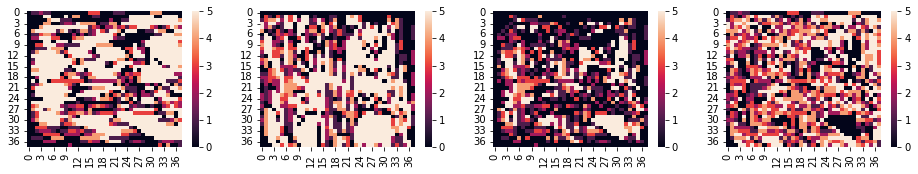

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


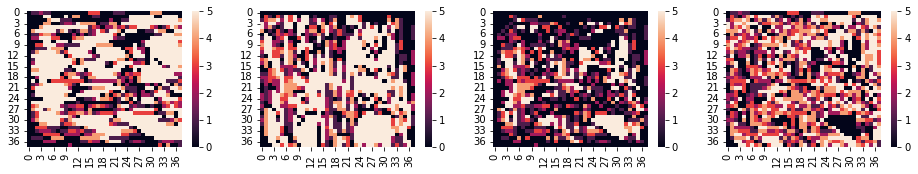

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


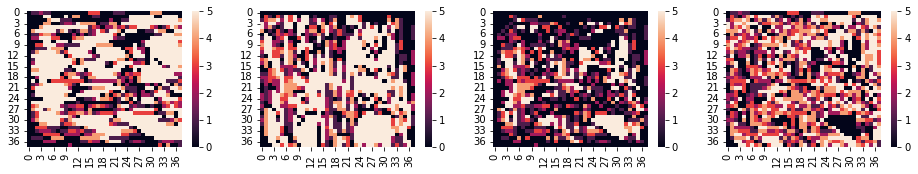

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


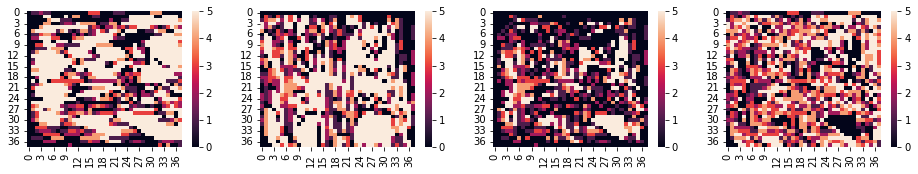

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


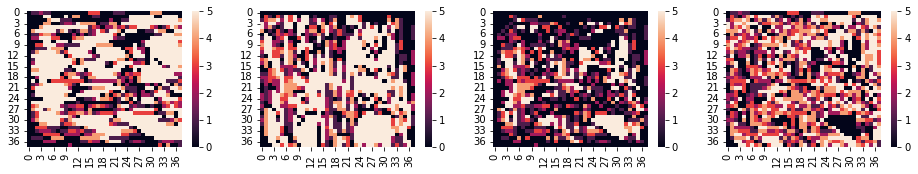

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


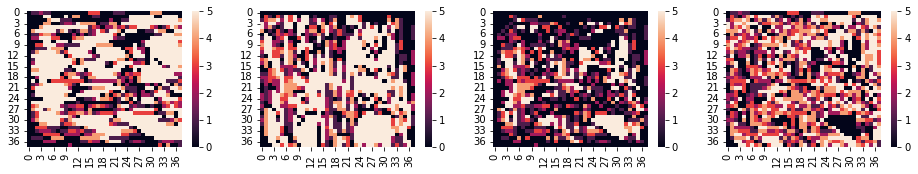

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


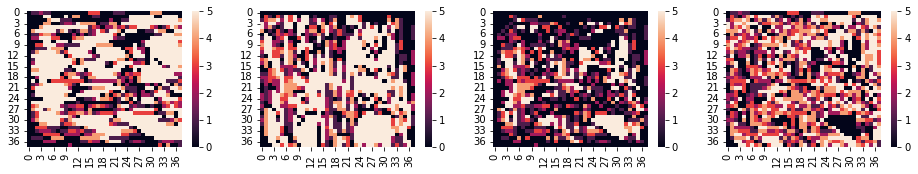

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


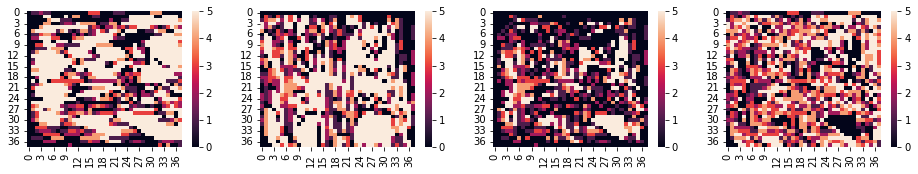

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


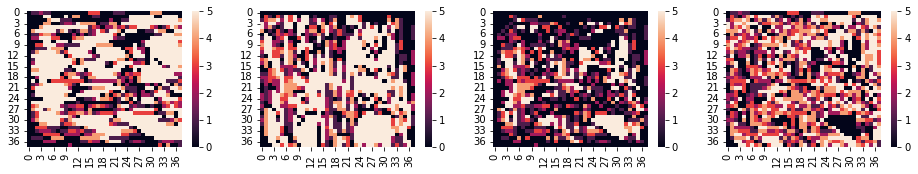

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


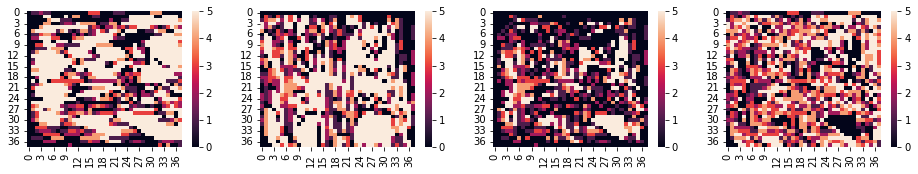

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


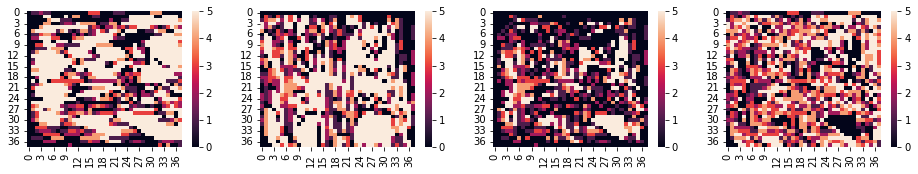

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


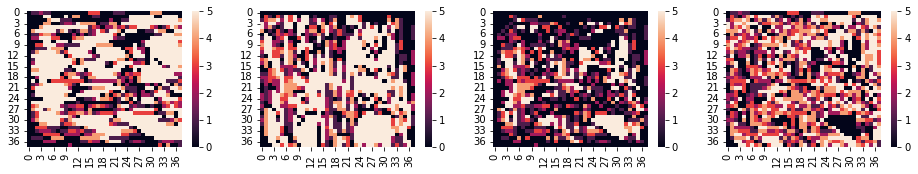

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


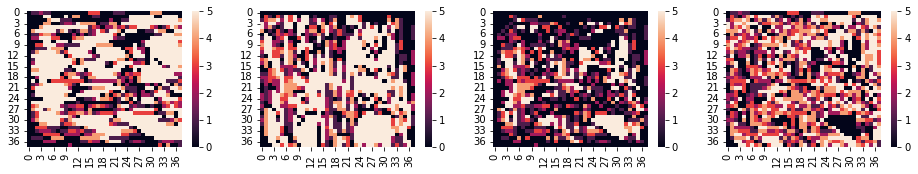

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


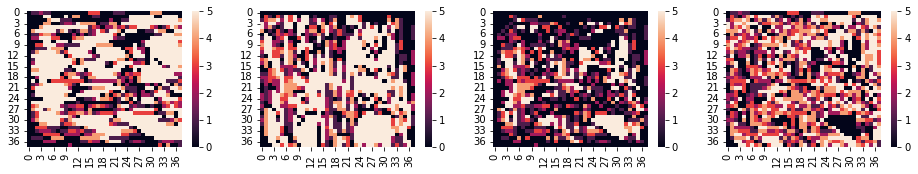

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


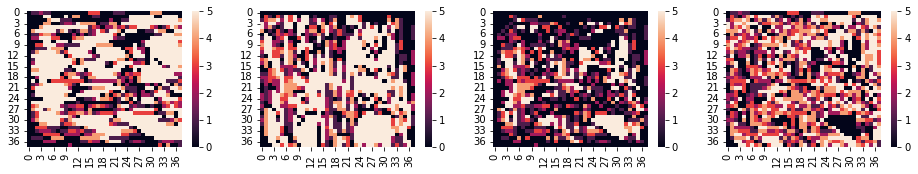

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


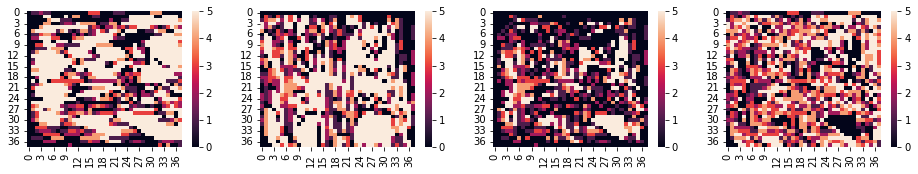

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


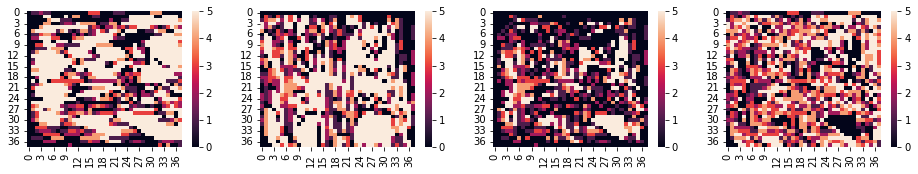

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


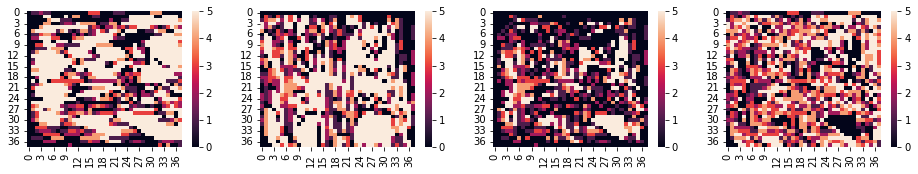

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


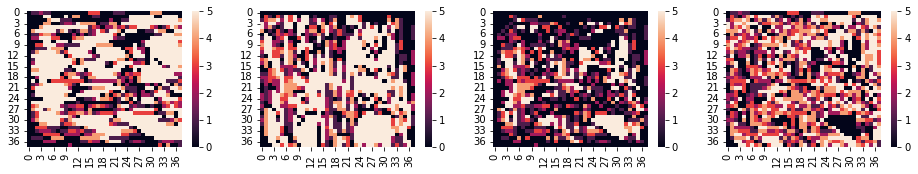

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


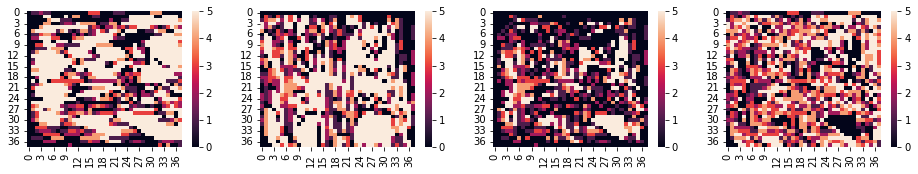

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


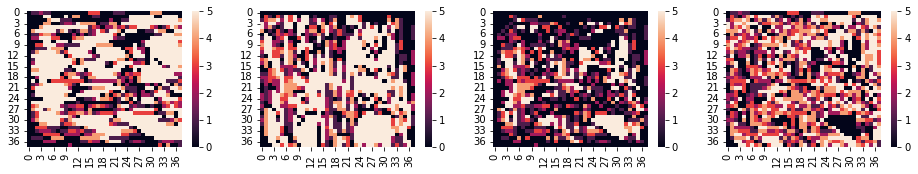

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


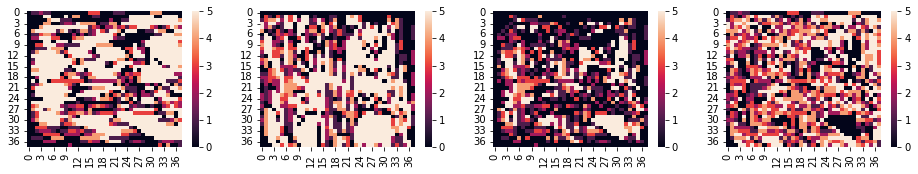

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


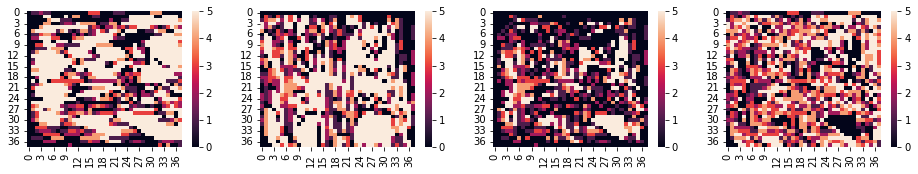

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


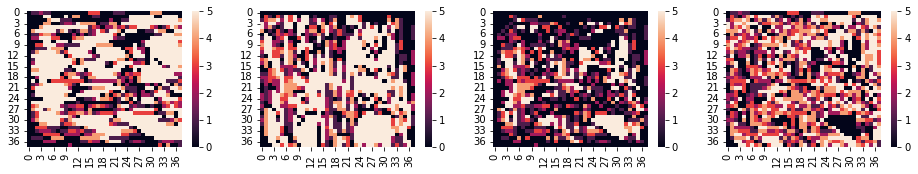

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


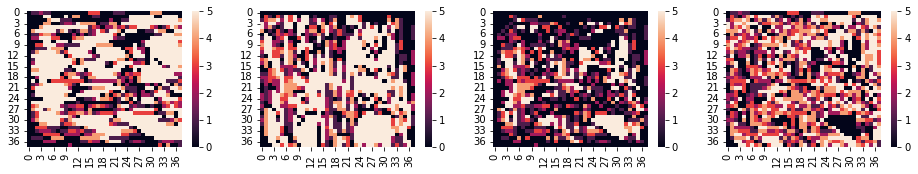

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


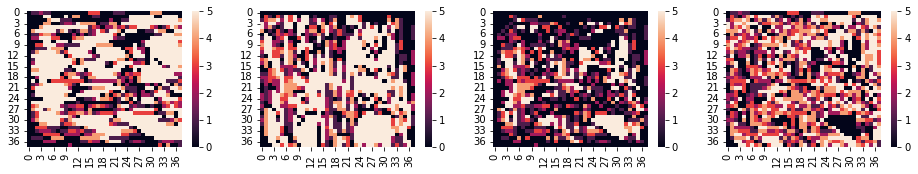

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


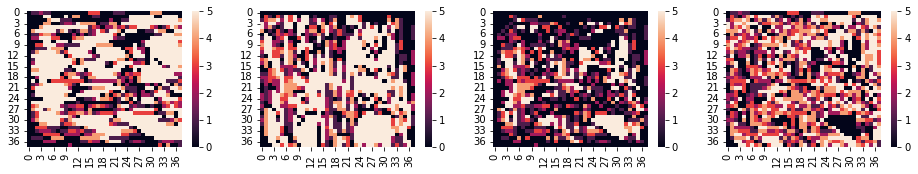

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


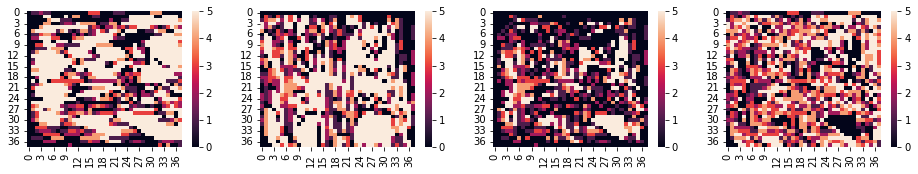

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


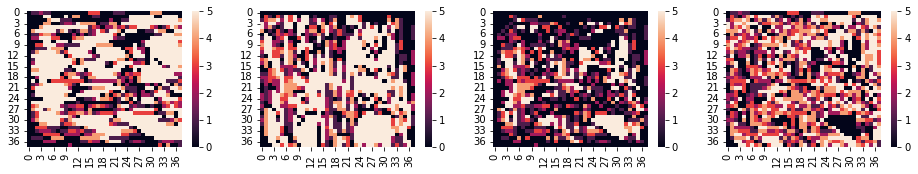

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


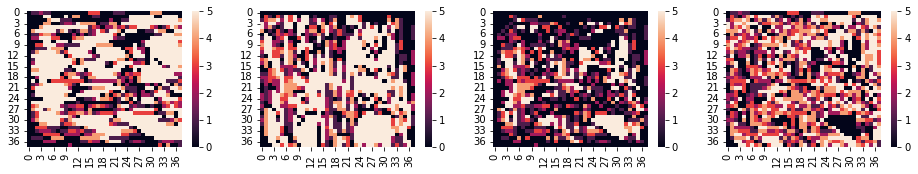

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


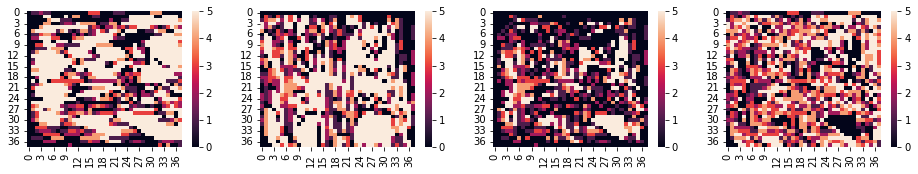

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


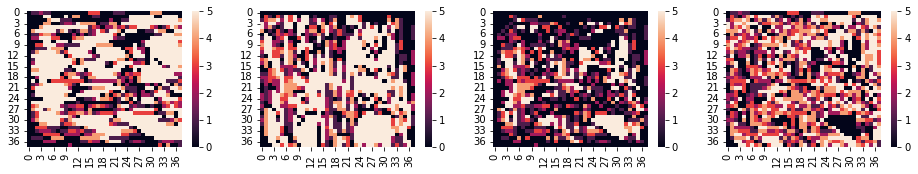

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


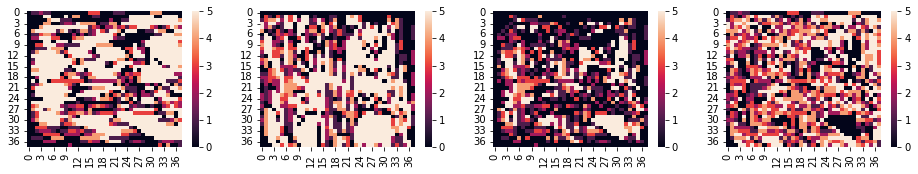

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


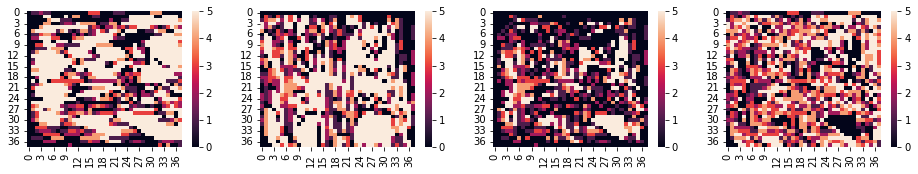

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


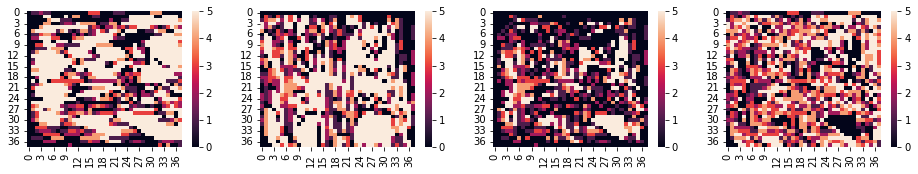

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


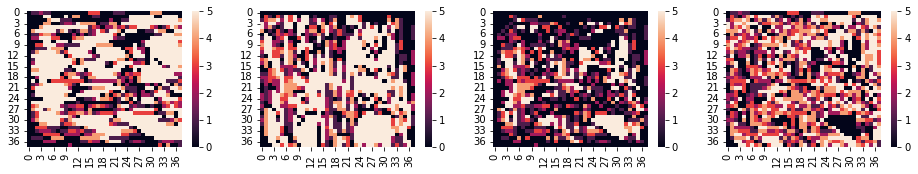

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


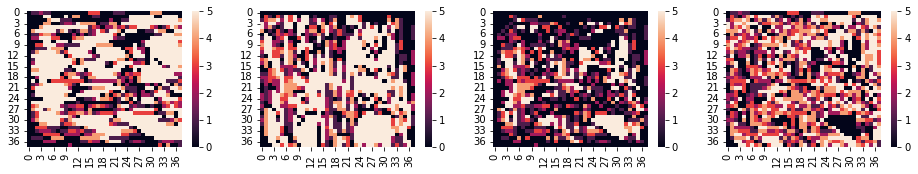

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


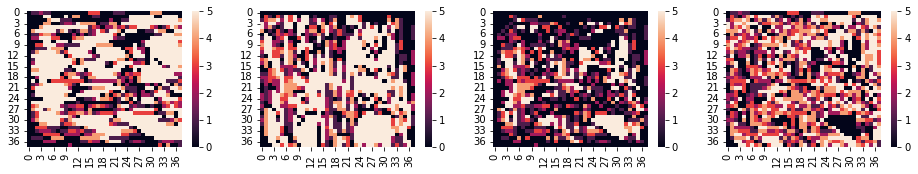

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


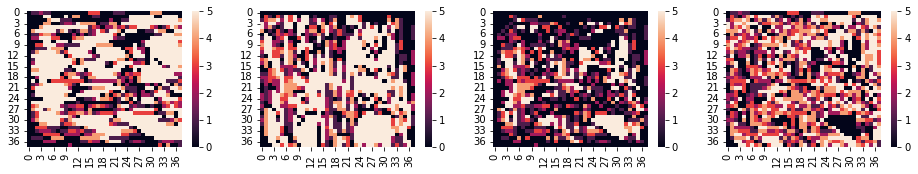

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


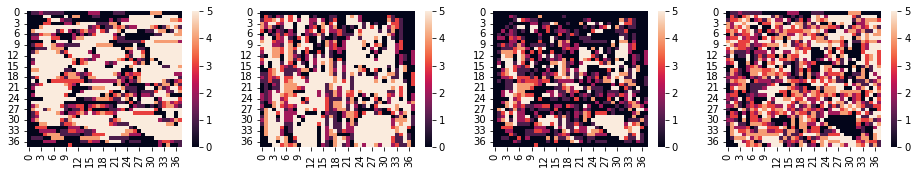

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


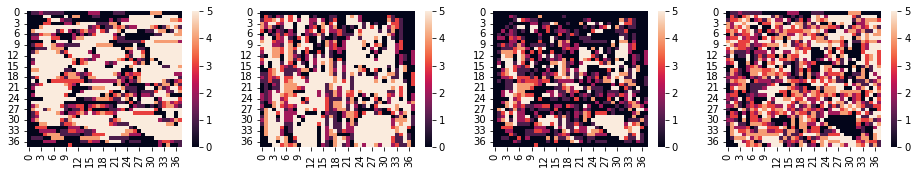

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


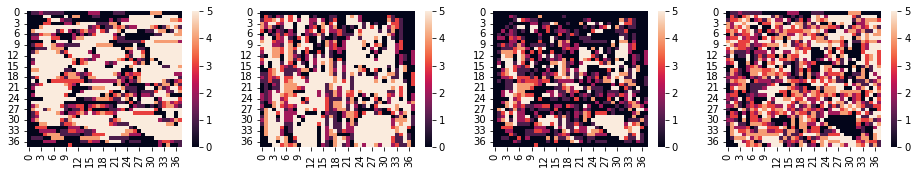

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


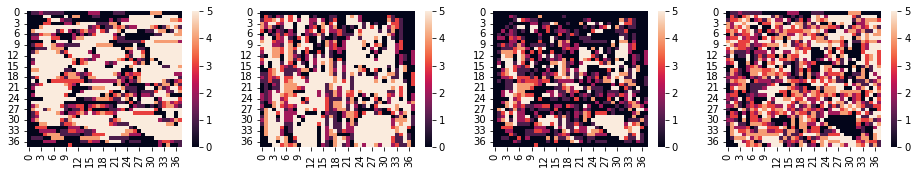

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


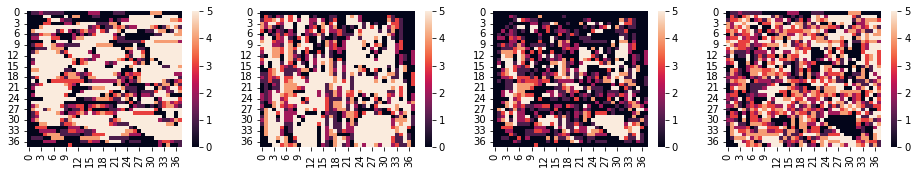

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


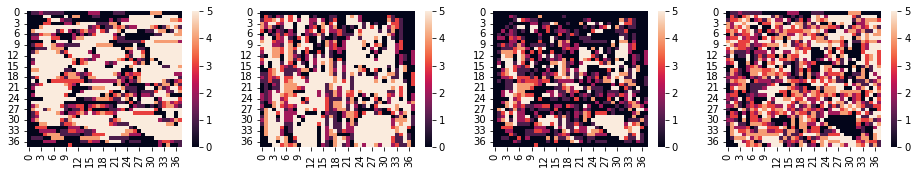

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


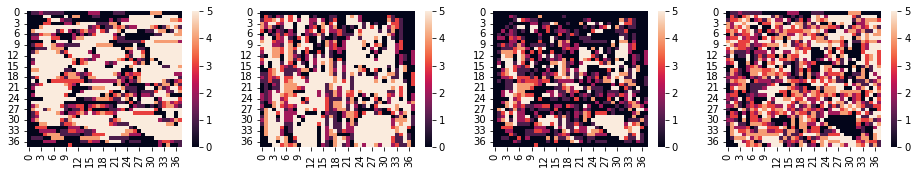

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


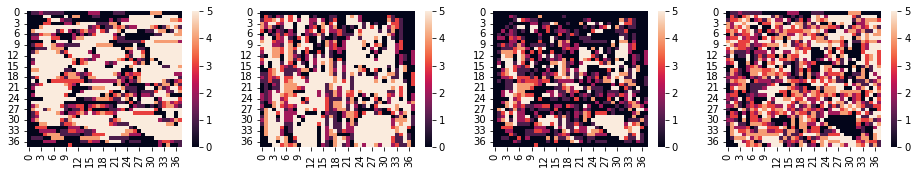

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


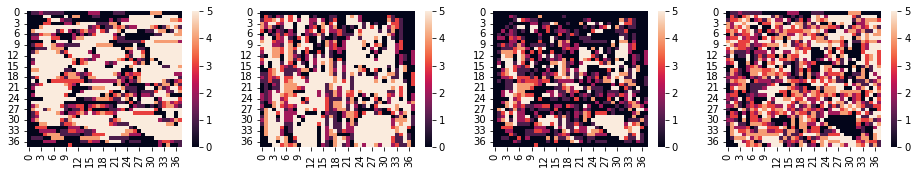

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


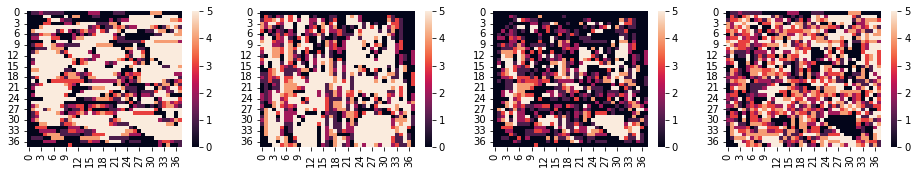

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


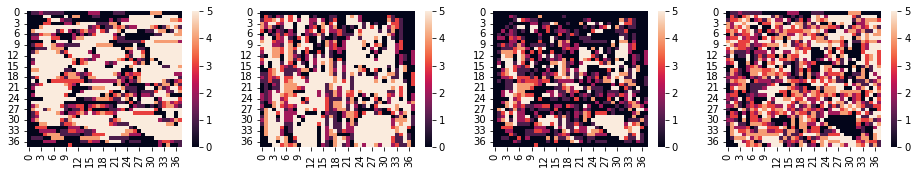

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


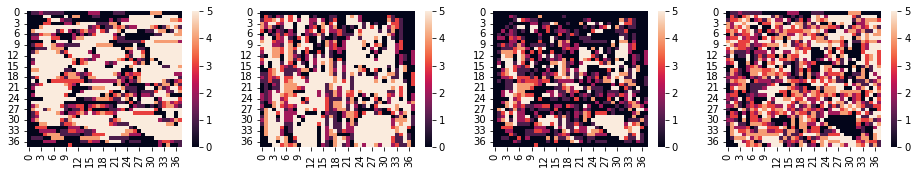

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


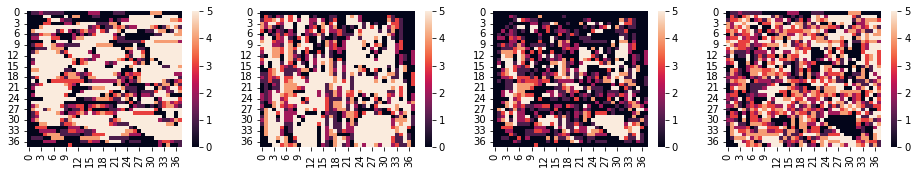

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


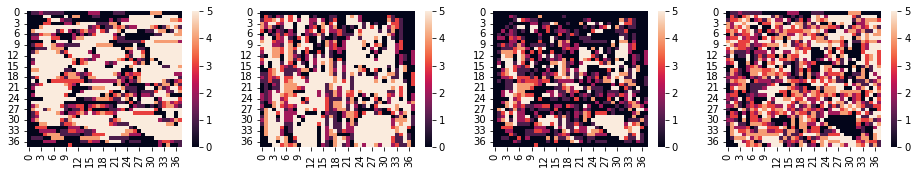

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


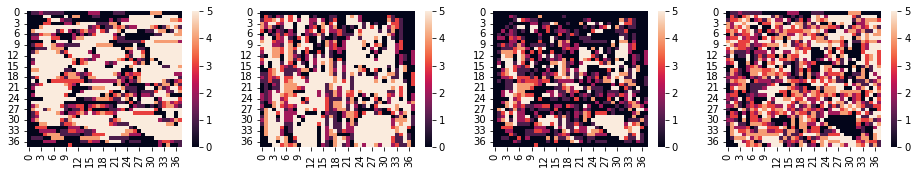

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


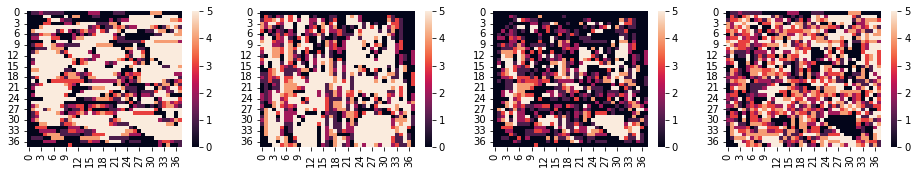

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


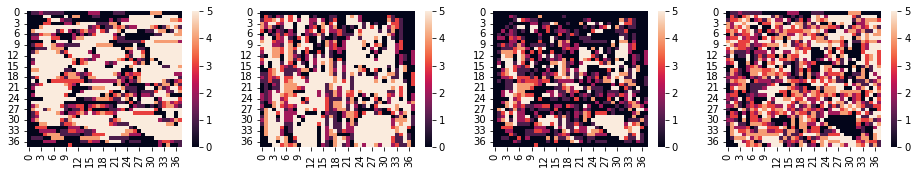

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


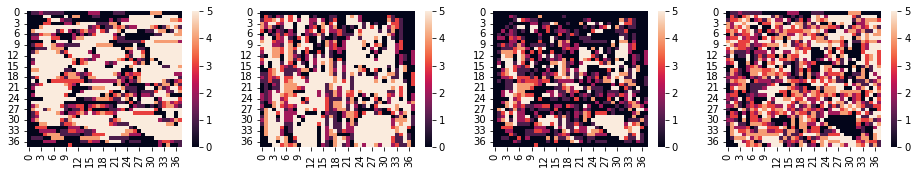

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


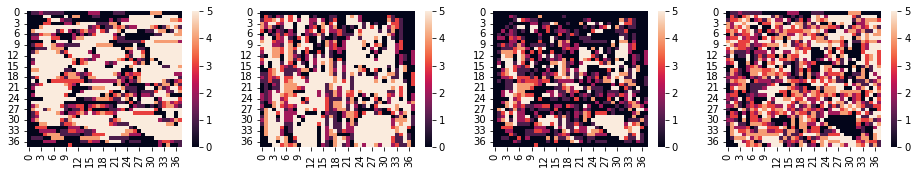

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


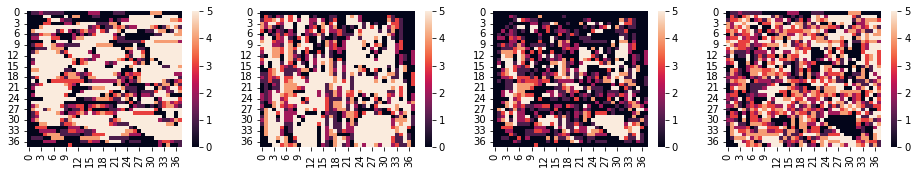

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


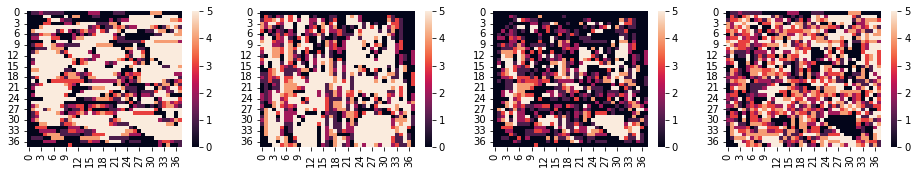

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


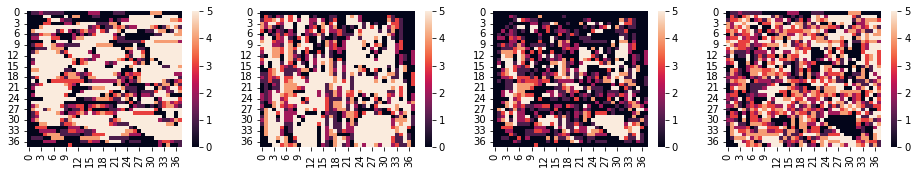

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


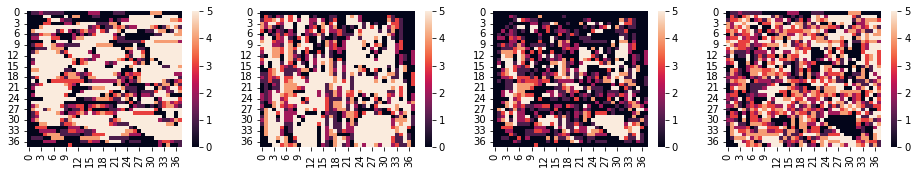

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


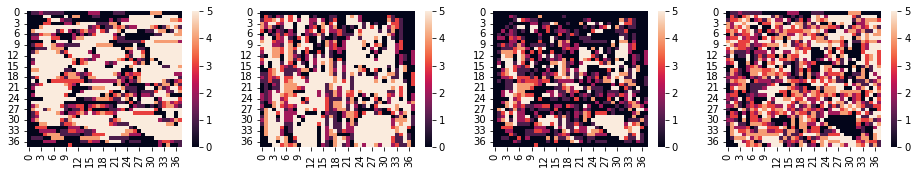

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


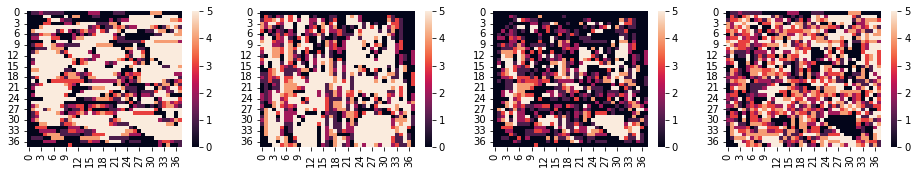

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


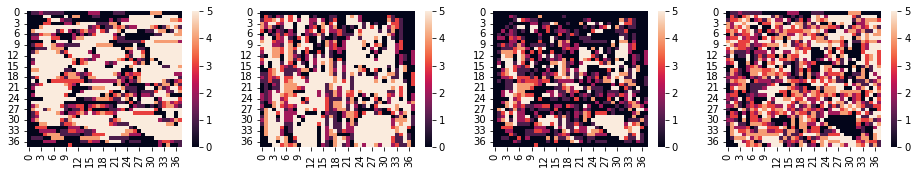

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


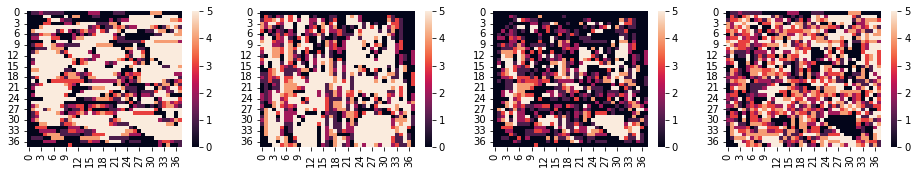

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


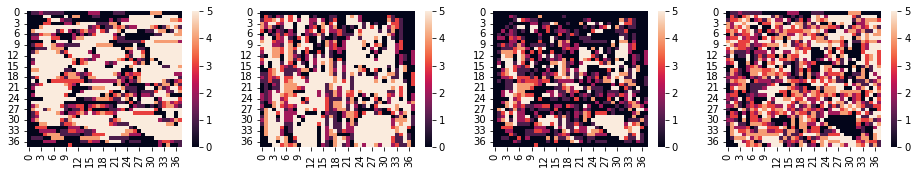

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


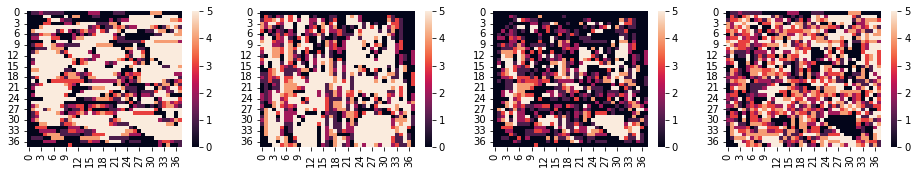

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


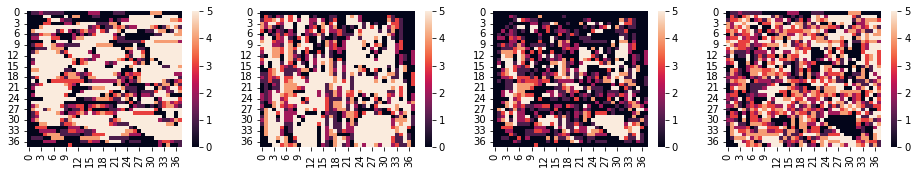

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


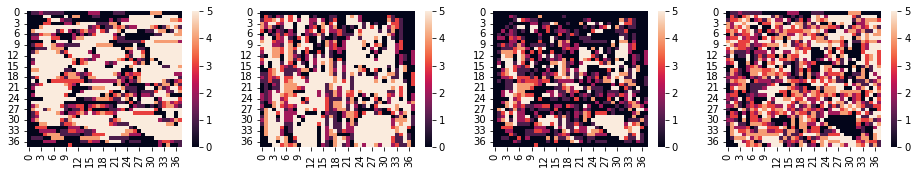

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


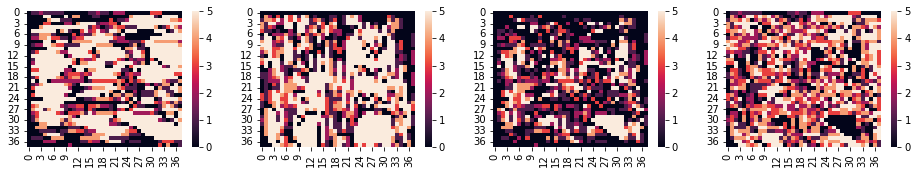

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


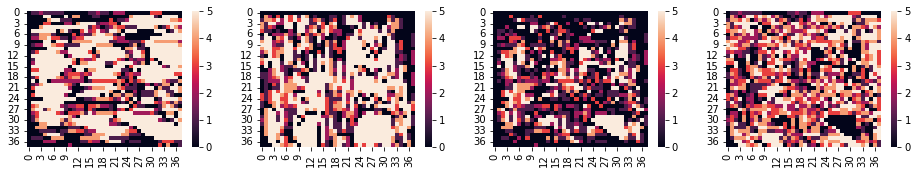

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


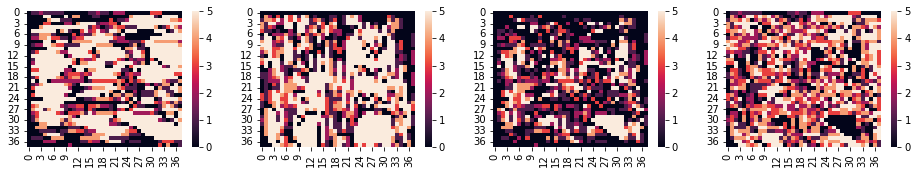

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


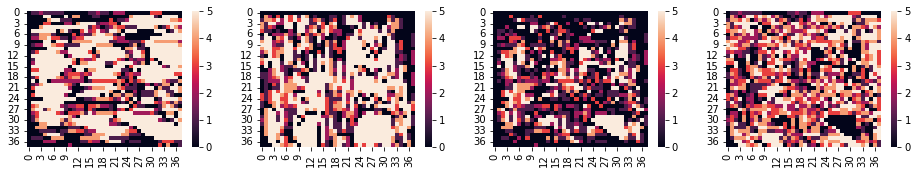

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


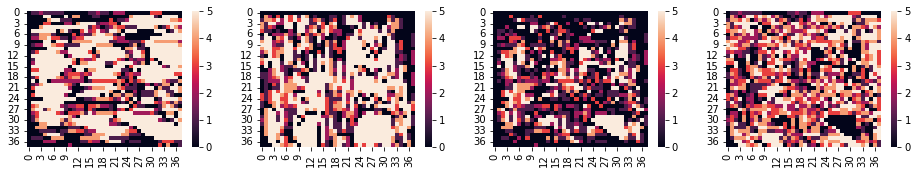

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


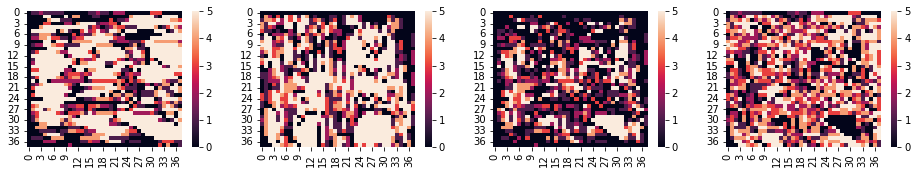

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


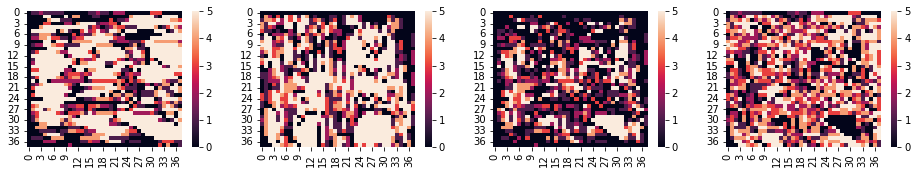

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


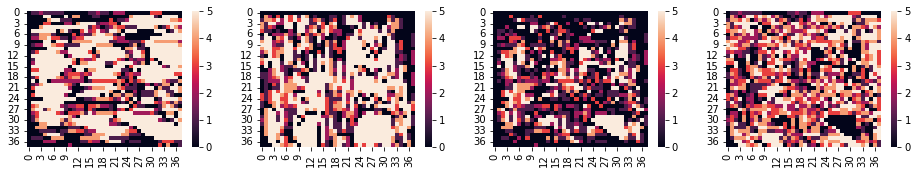

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


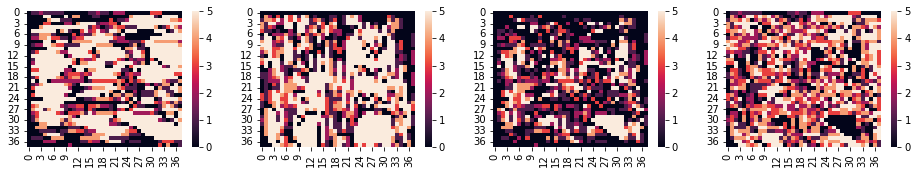

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


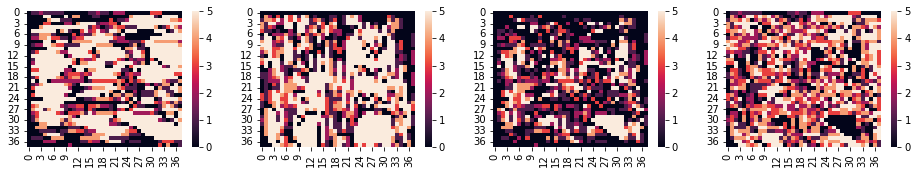

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


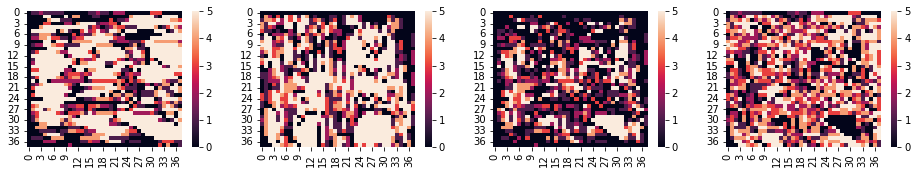

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


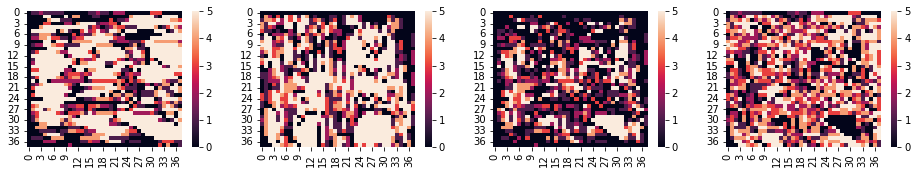

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


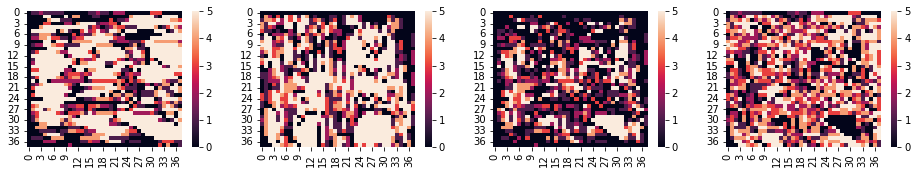

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


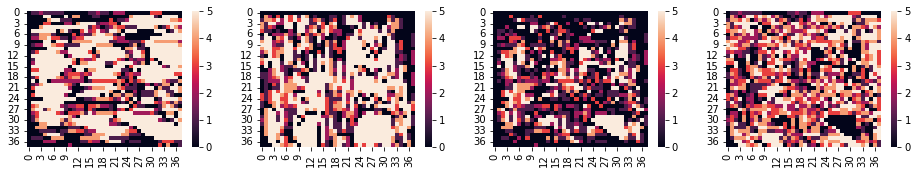

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


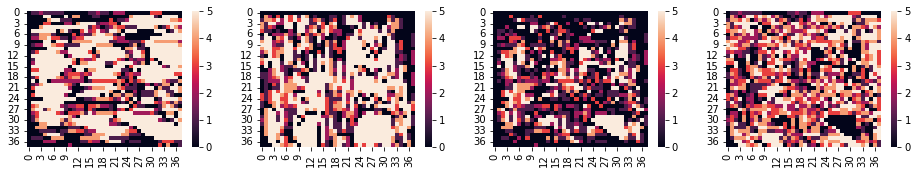

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


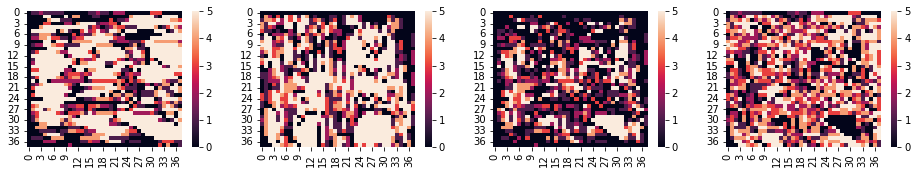

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


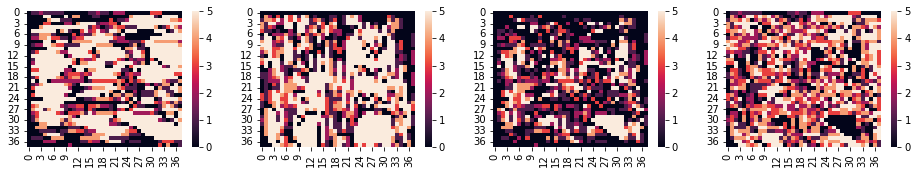

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


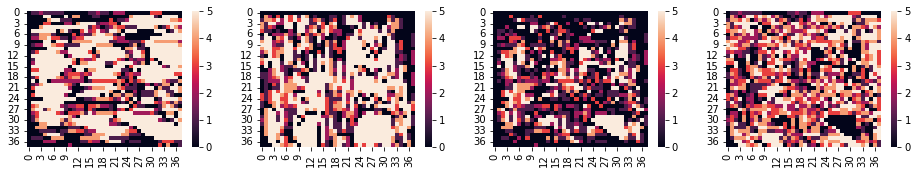

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


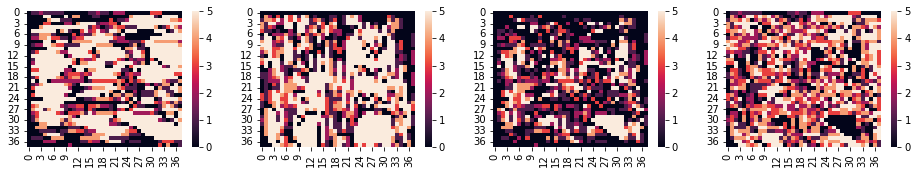

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


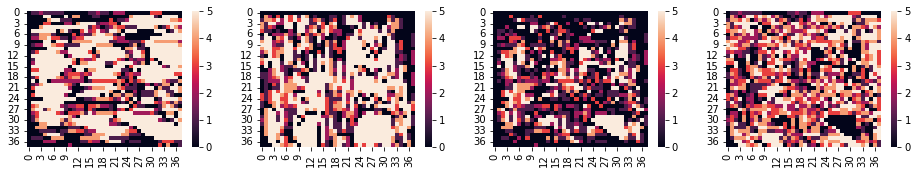

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


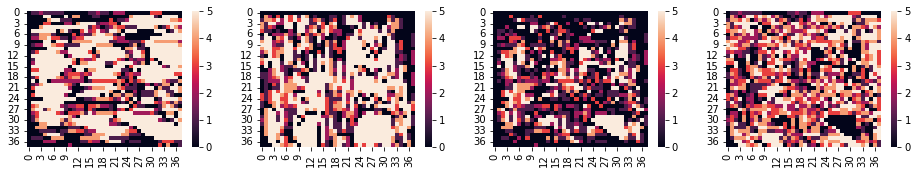

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


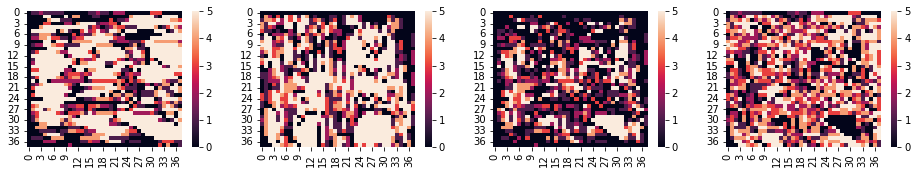

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


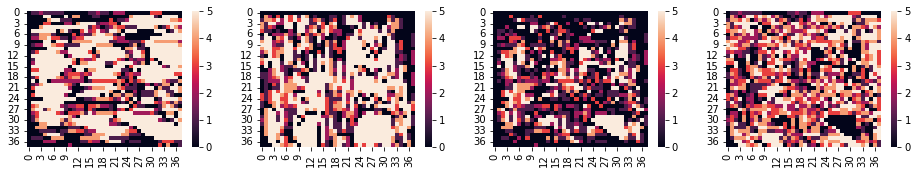

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


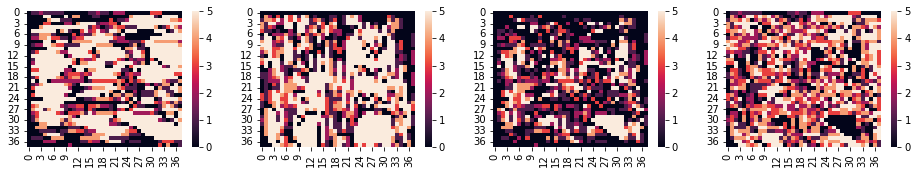

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


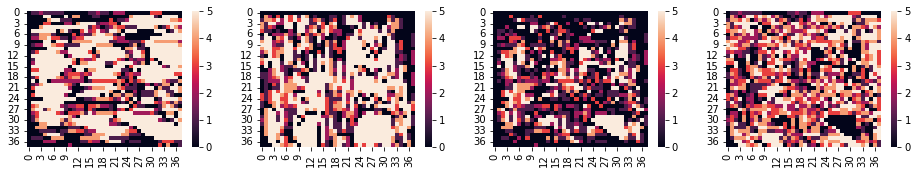

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


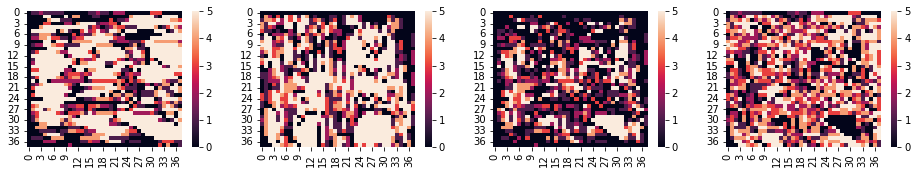

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


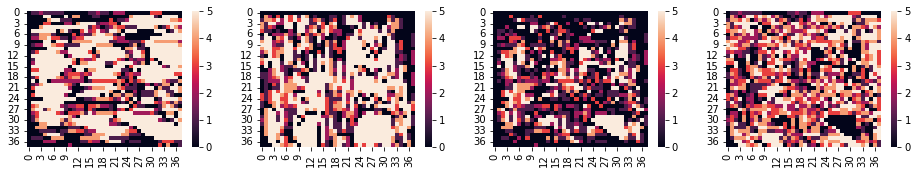

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


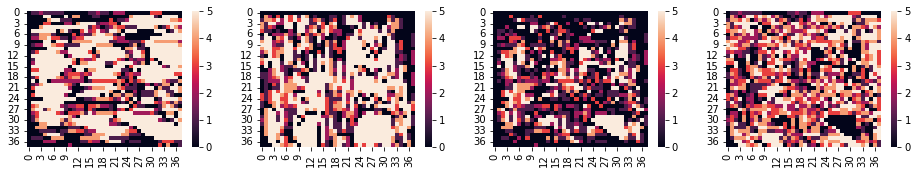

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0


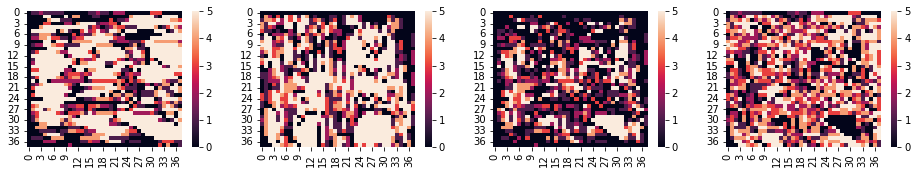

max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  982.0 462.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


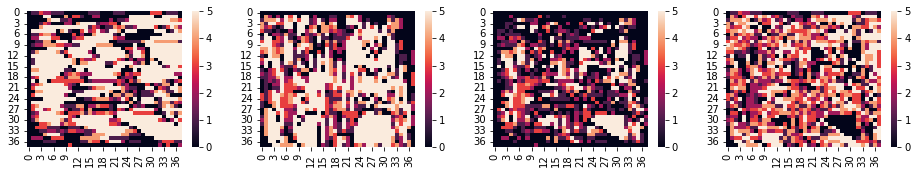

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


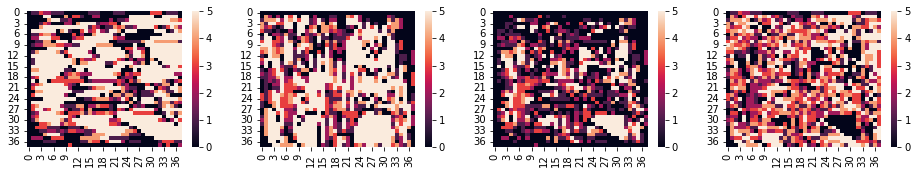

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


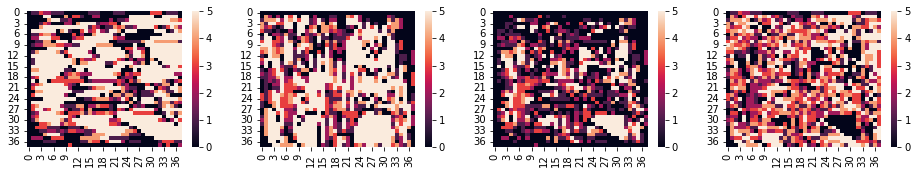

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


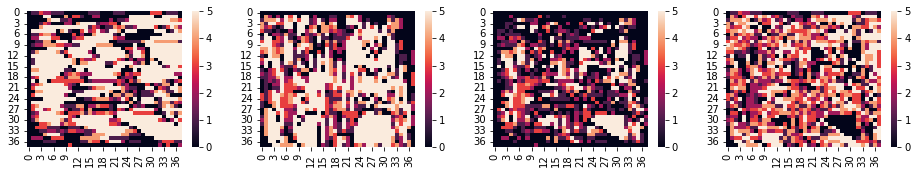

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


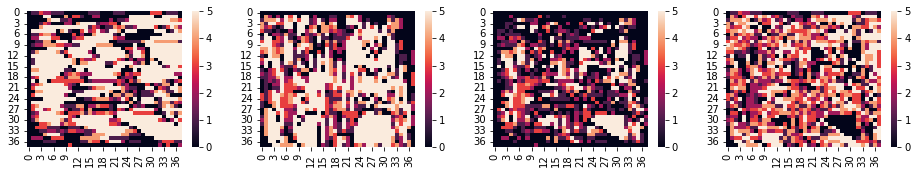

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


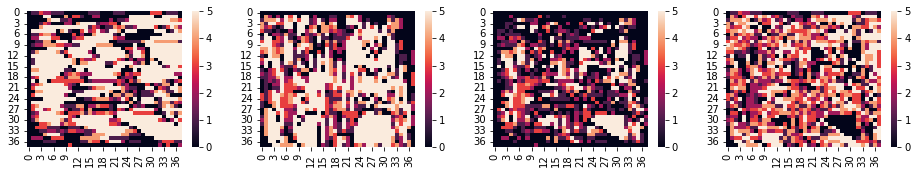

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


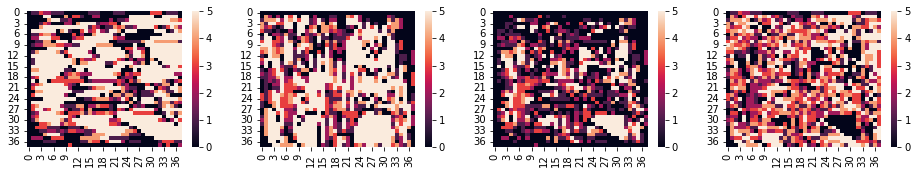

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


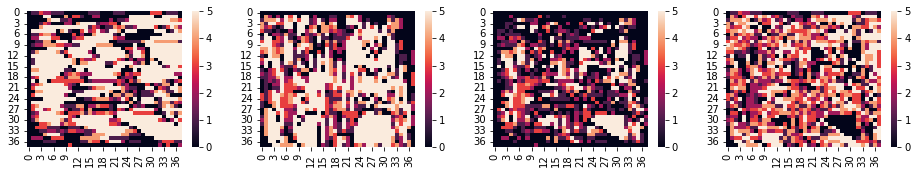

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


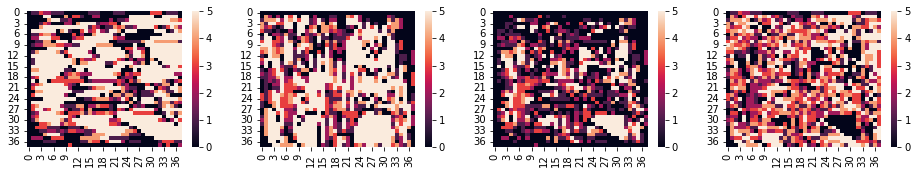

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


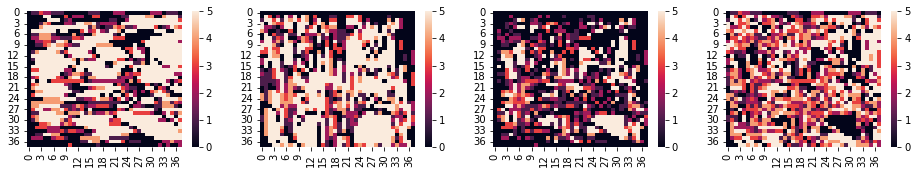

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


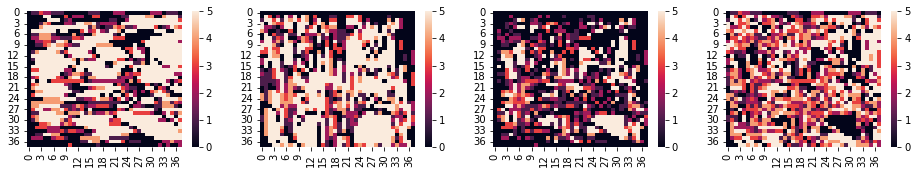

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


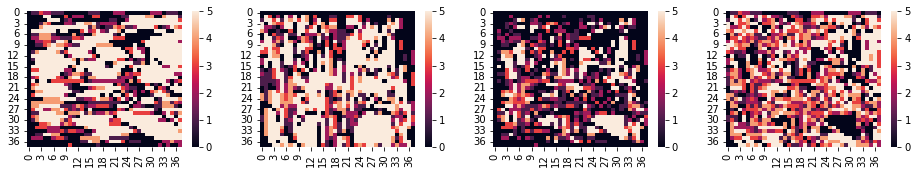

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


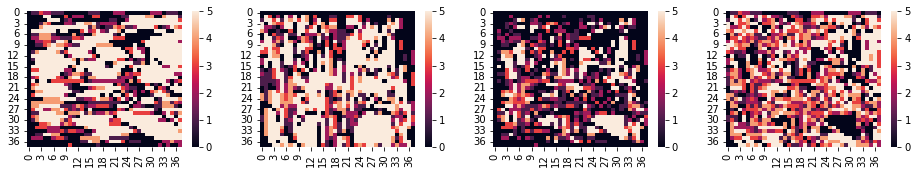

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


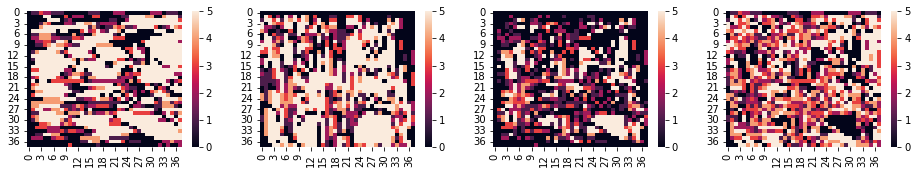

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


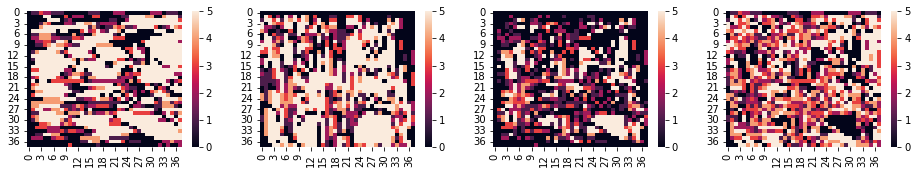

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


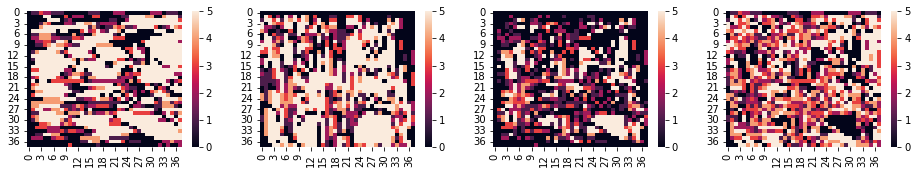

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


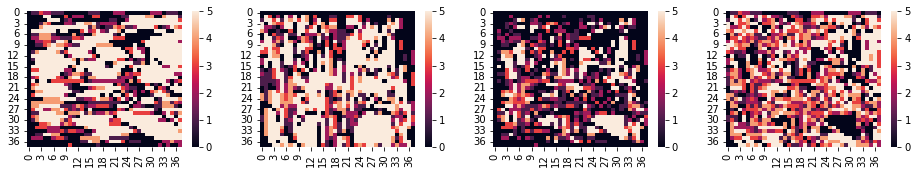

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


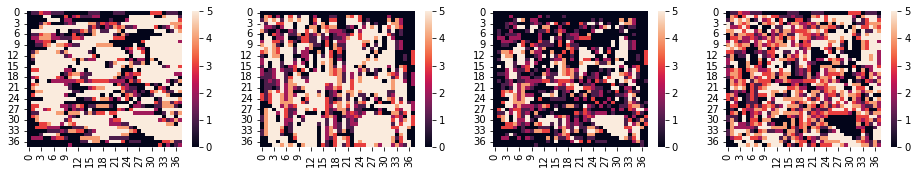

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


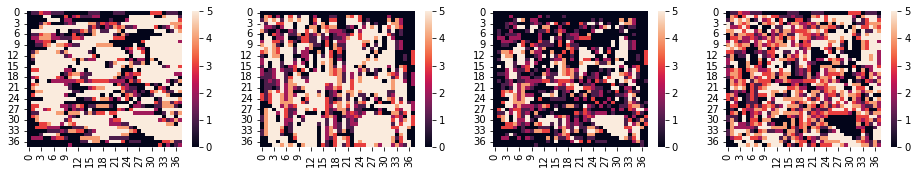

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


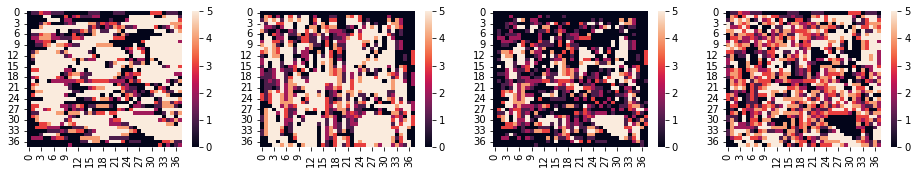

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


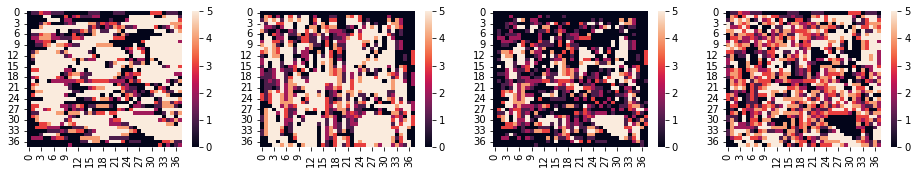

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


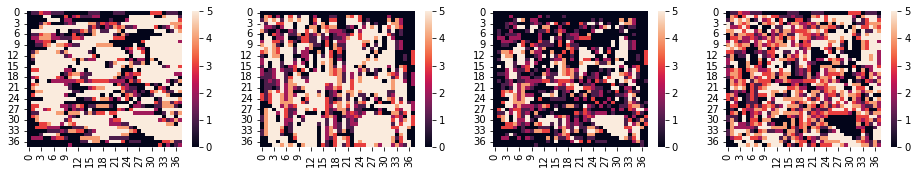

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


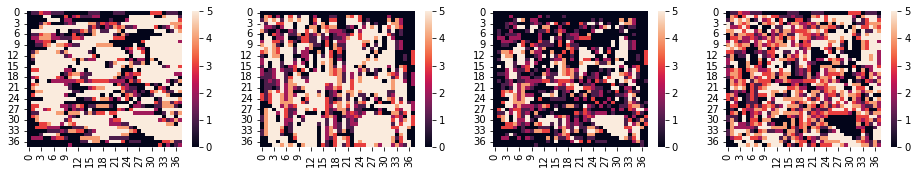

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


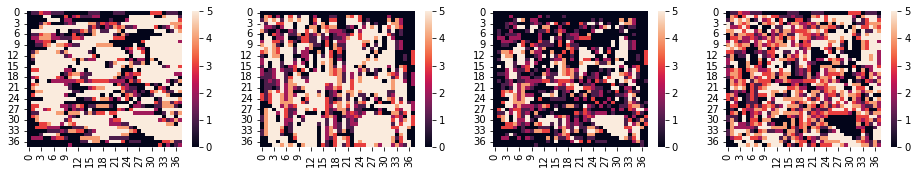

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


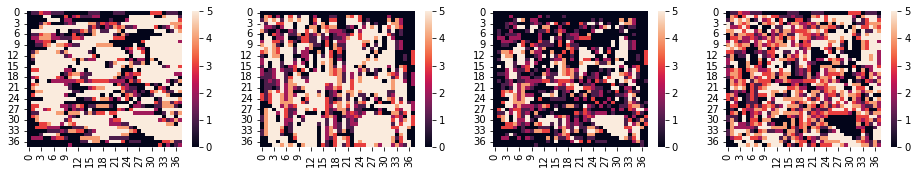

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


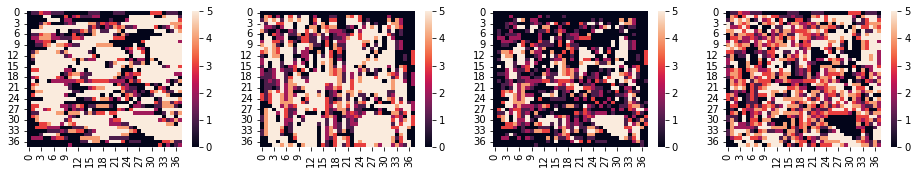

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


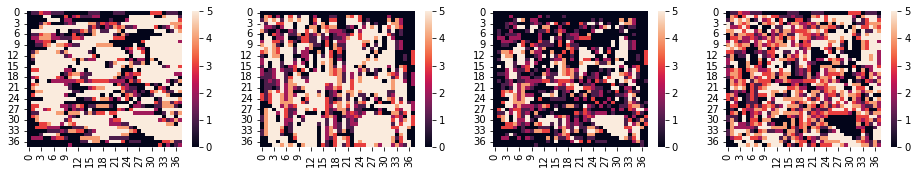

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


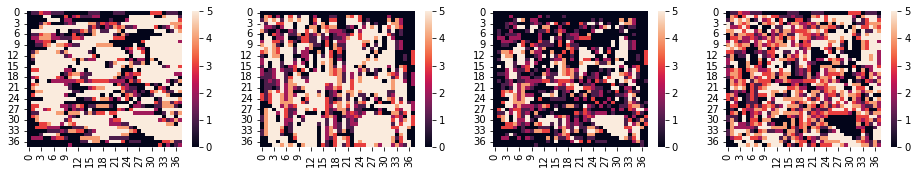

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


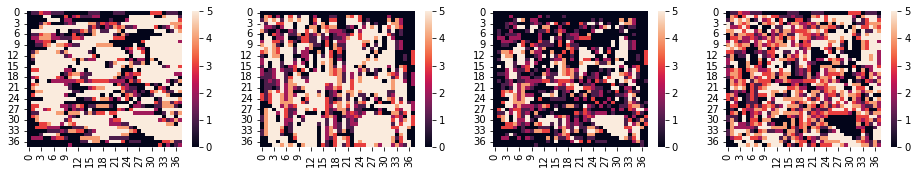

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


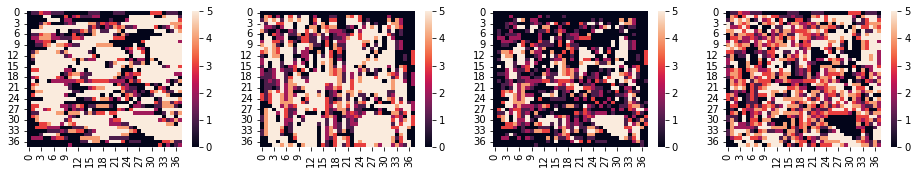

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


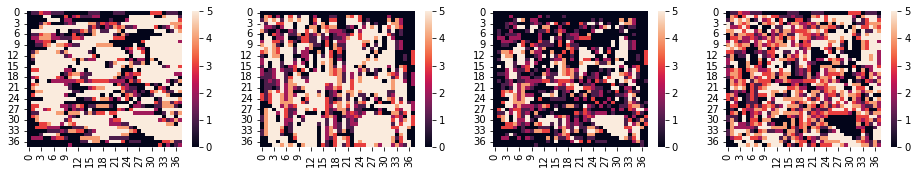

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


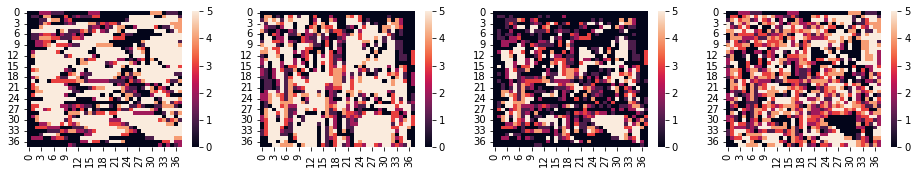

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


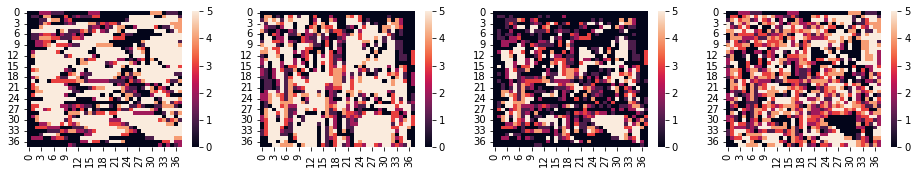

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


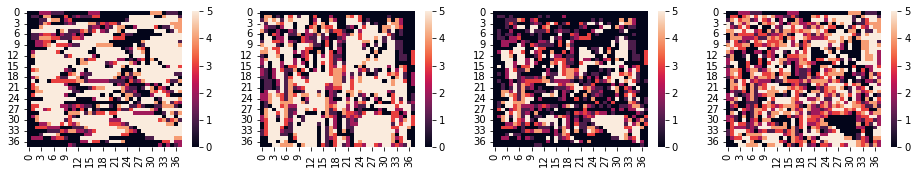

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


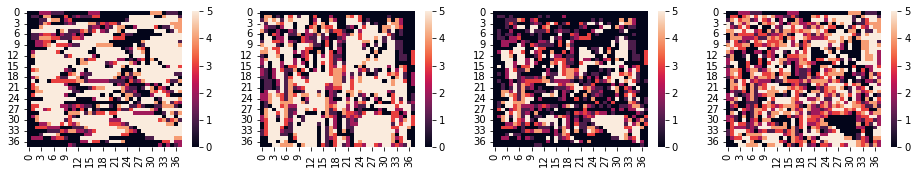

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


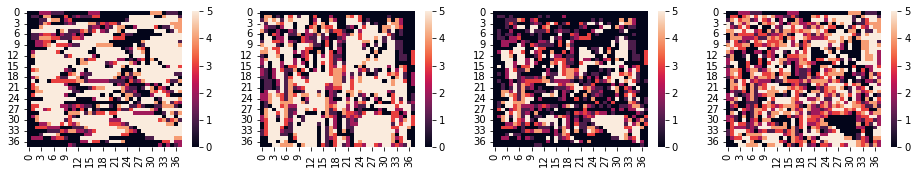

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


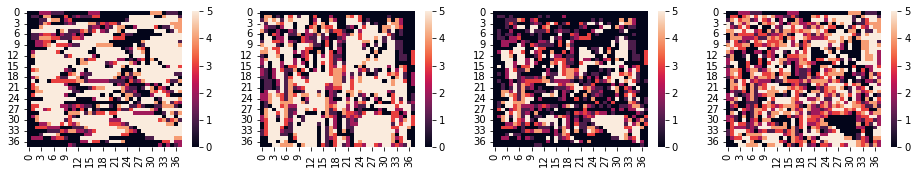

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


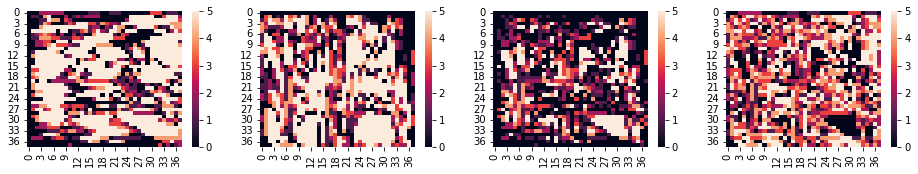

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


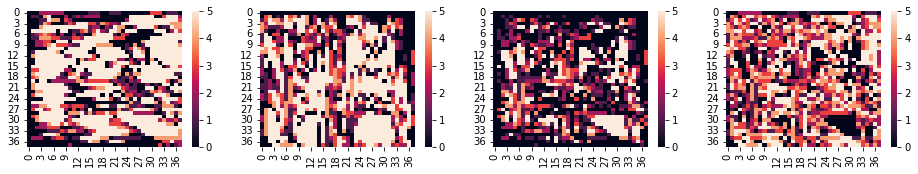

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


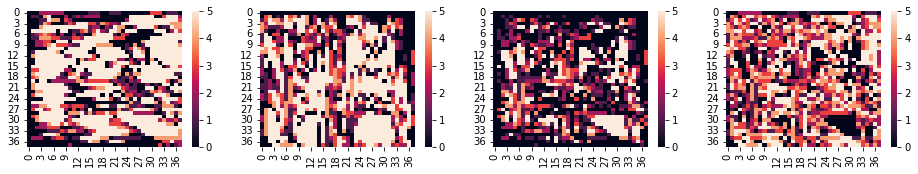

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


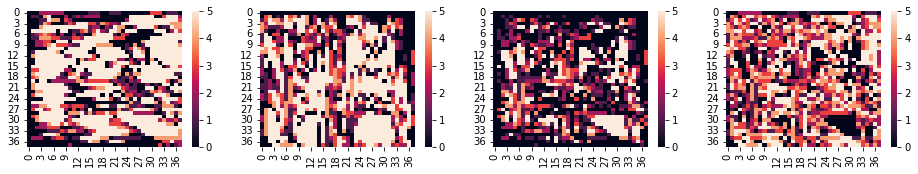

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


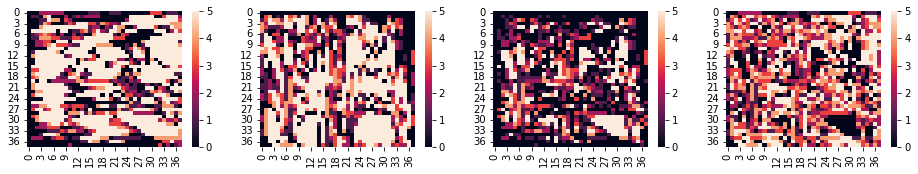

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


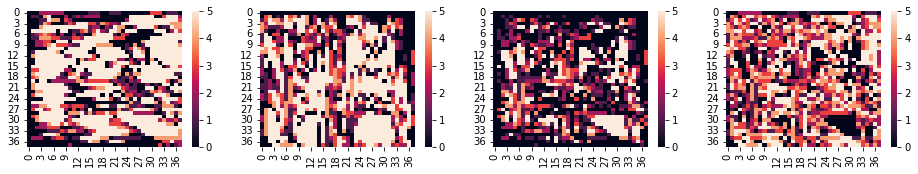

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


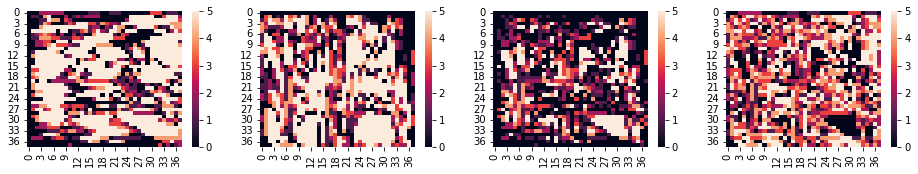

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


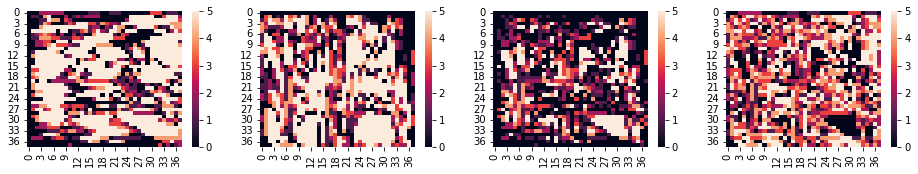

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


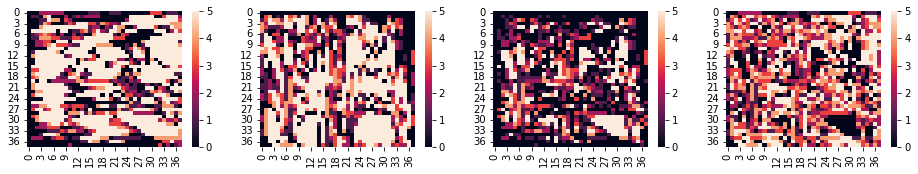

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


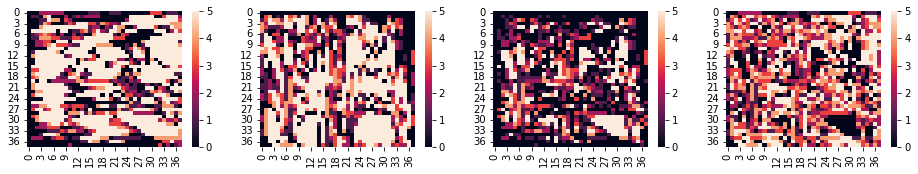

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


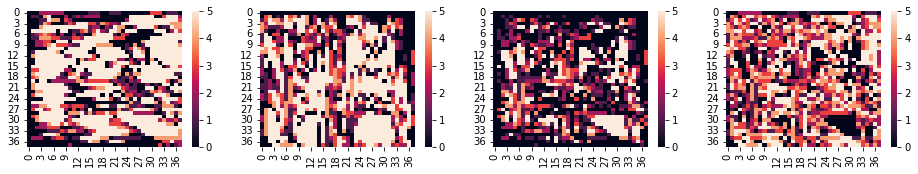

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


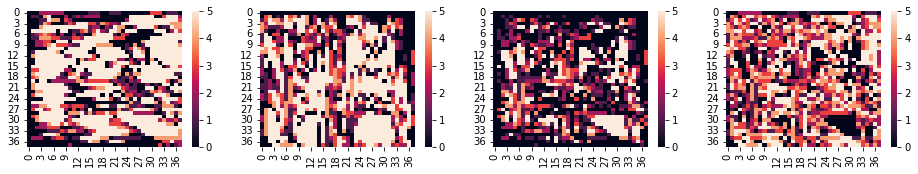

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


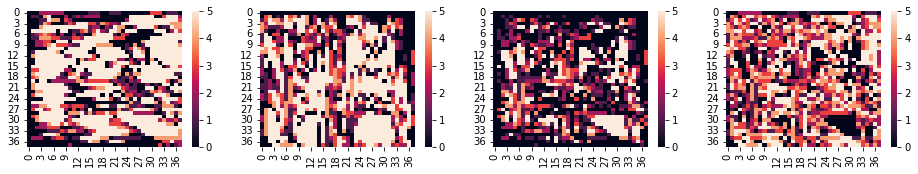

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


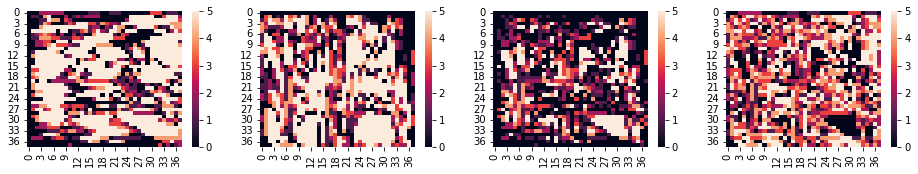

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


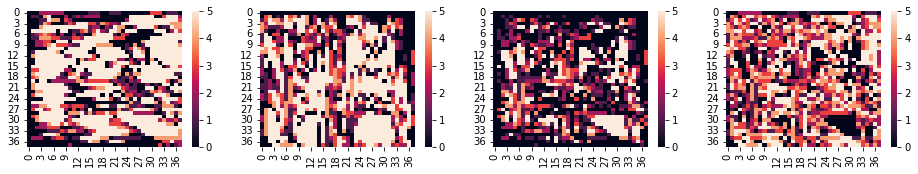

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


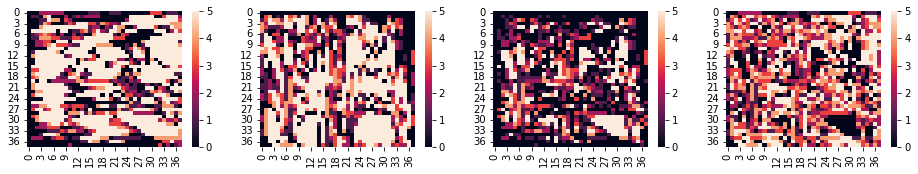

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


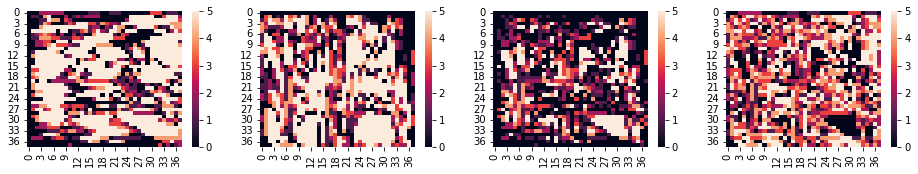

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


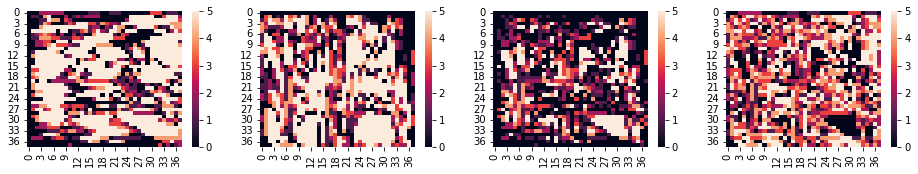

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


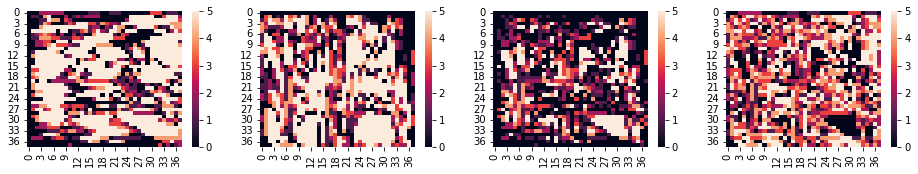

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


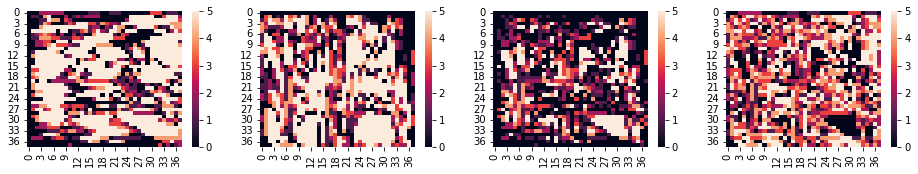

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


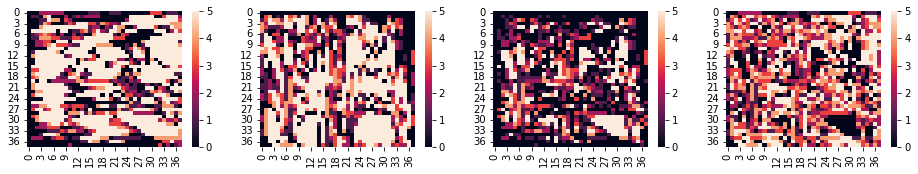

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


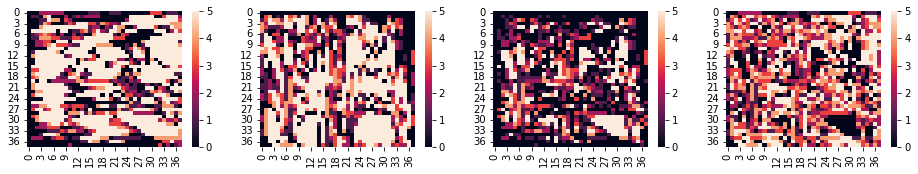

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


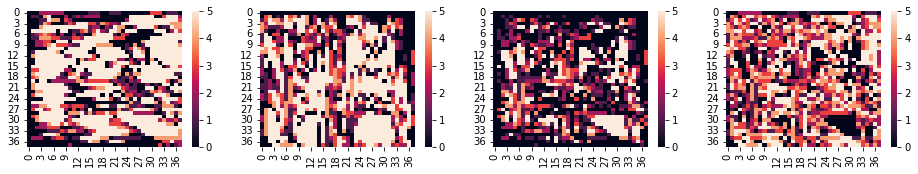

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


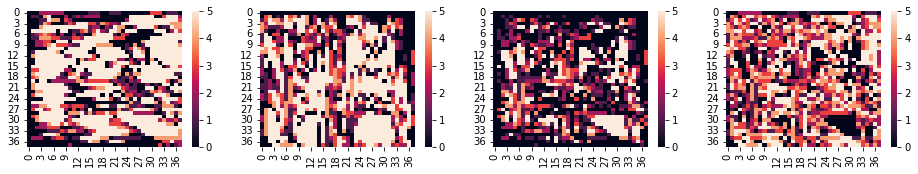

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


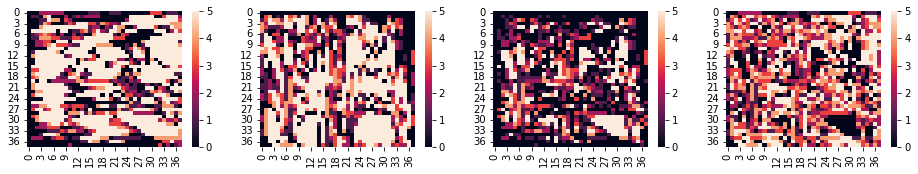

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


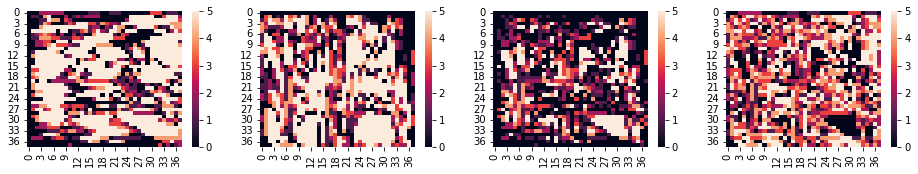

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


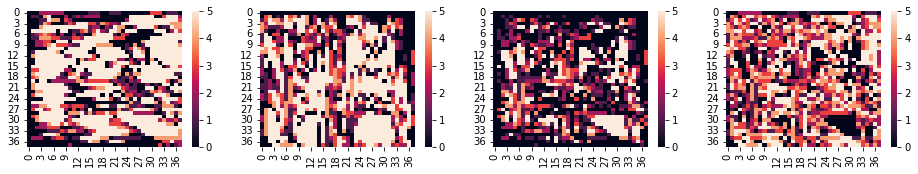

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


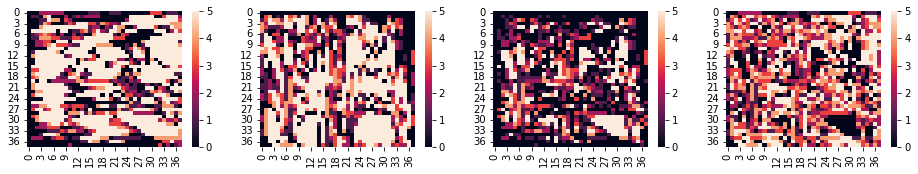

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


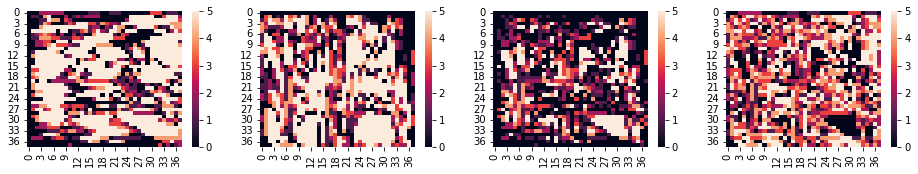

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


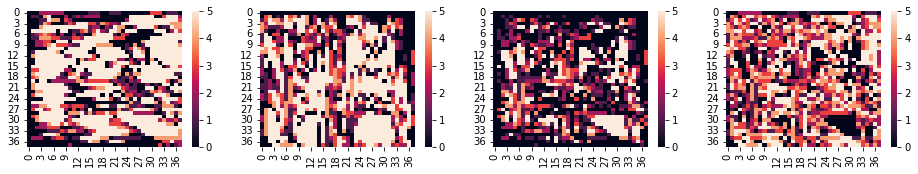

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


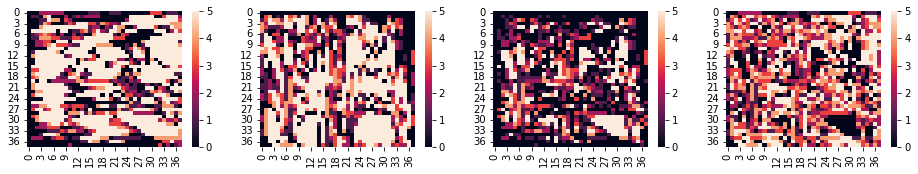

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


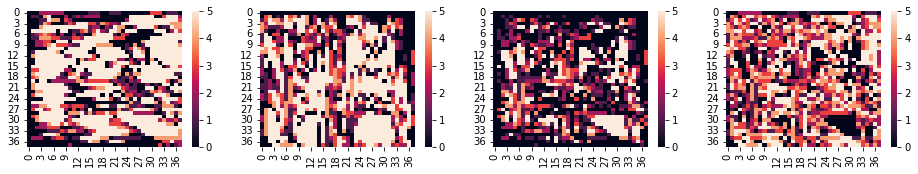

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


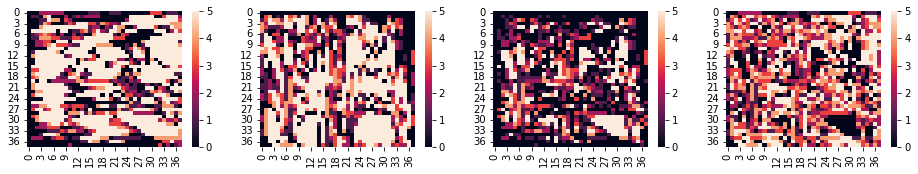

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


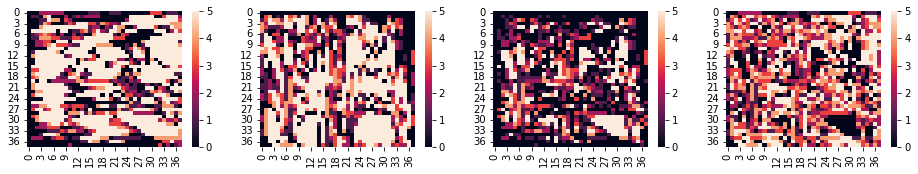

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


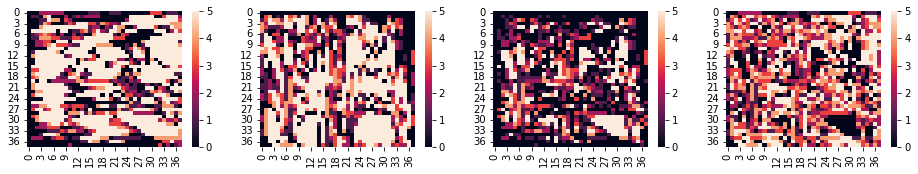

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


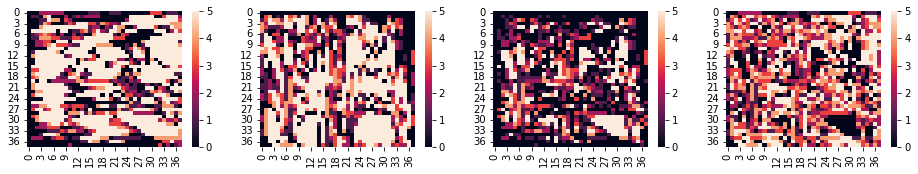

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


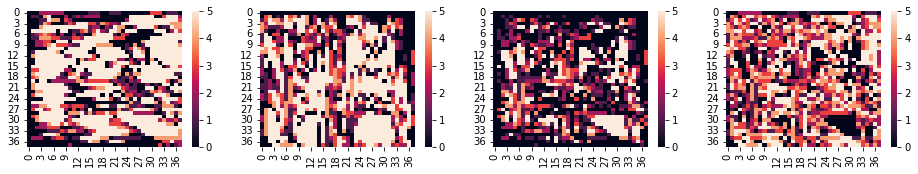

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


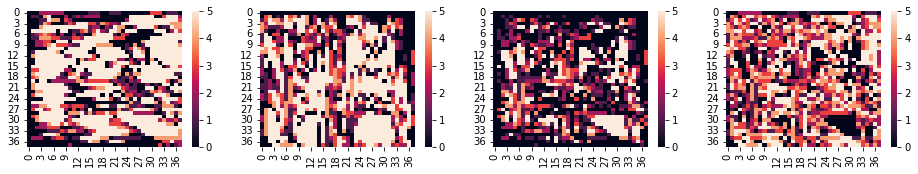

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


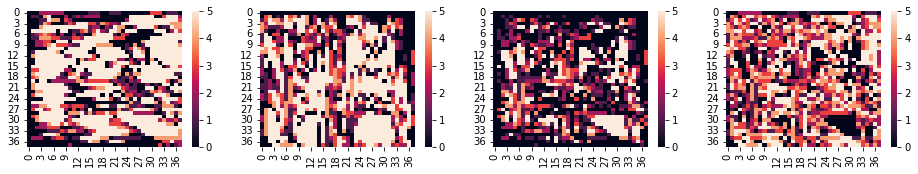

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


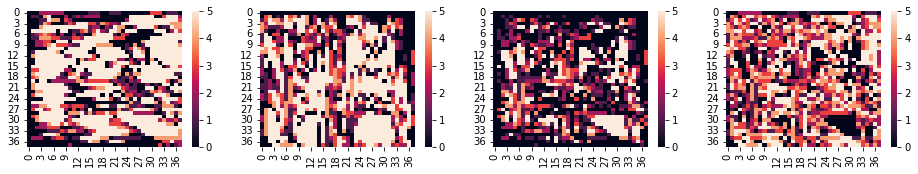

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


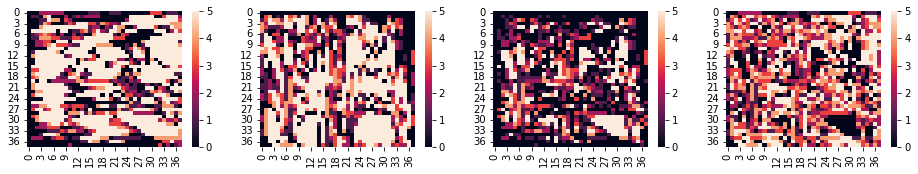

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


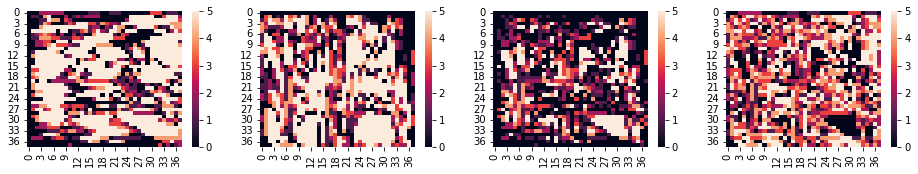

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


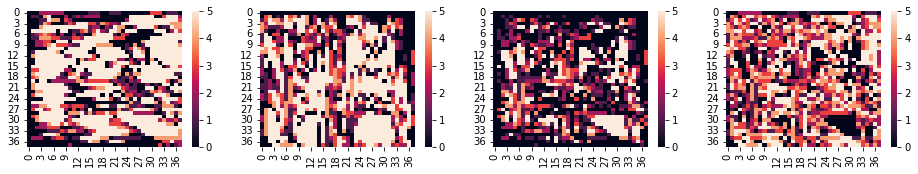

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


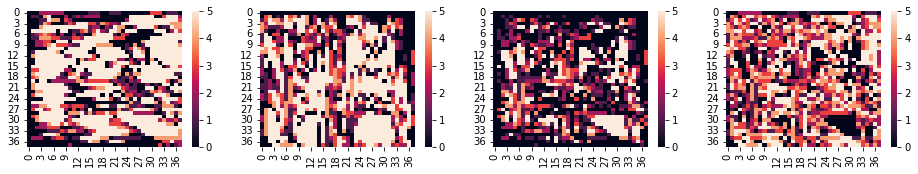

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


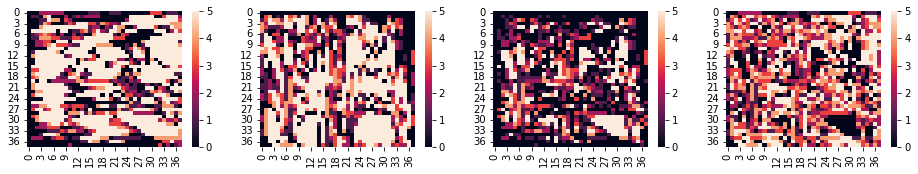

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


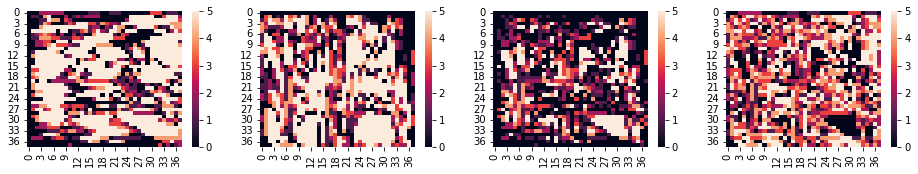

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


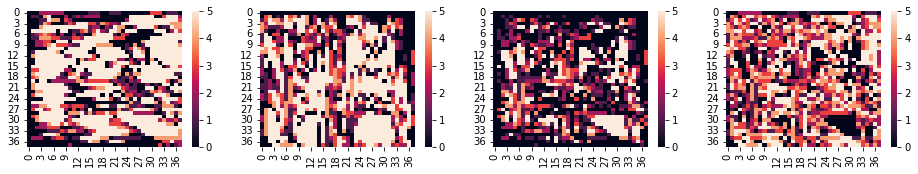

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


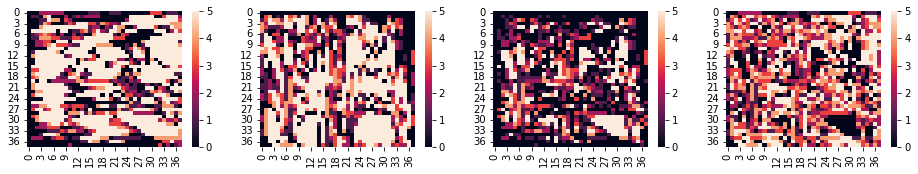

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


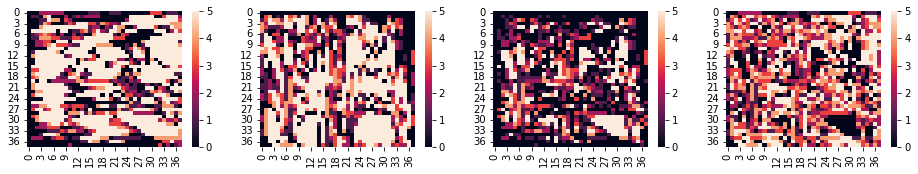

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


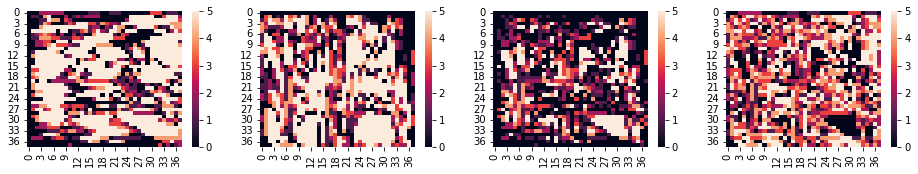

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


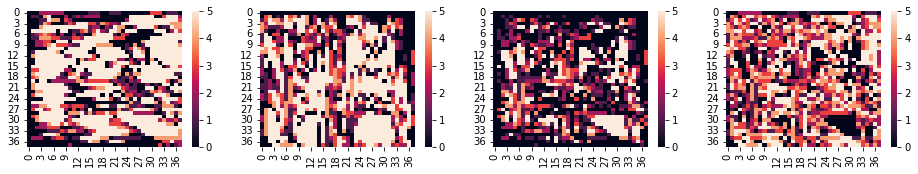

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


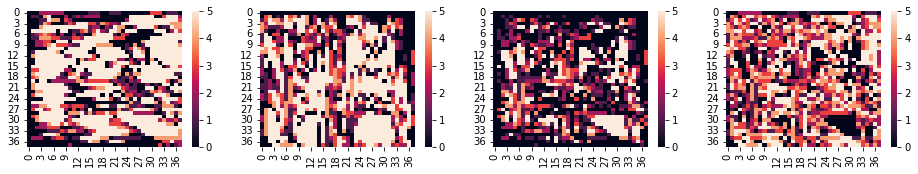

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


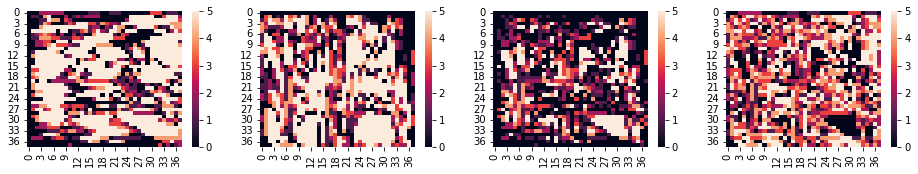

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


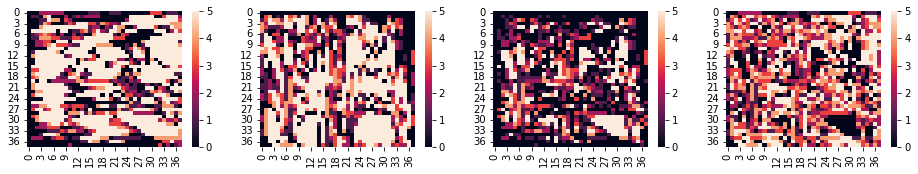

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


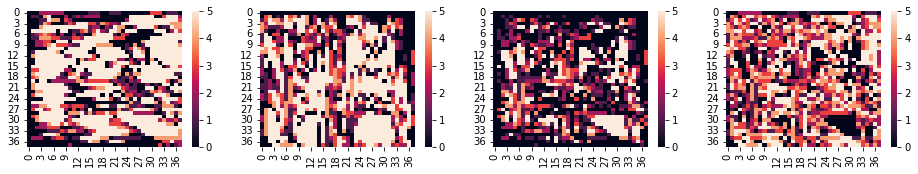

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


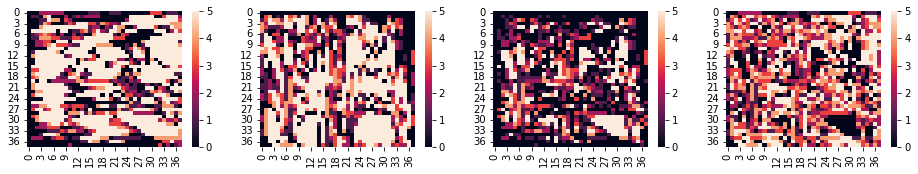

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


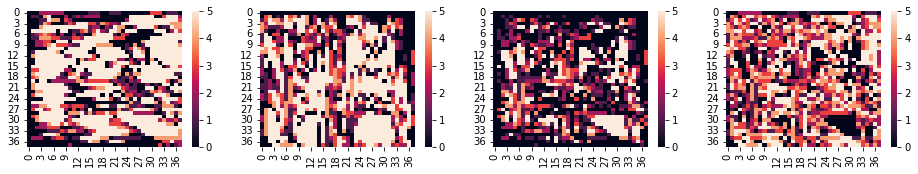

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


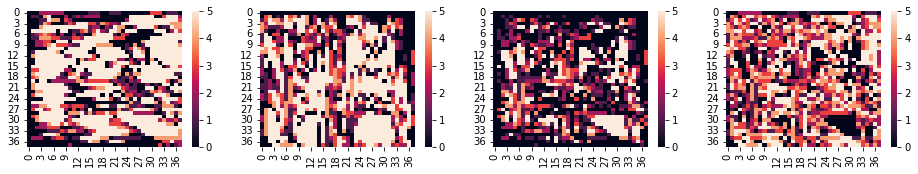

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


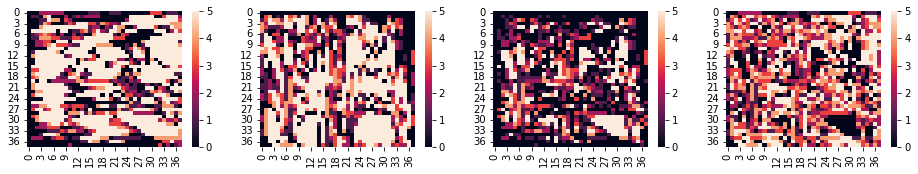

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


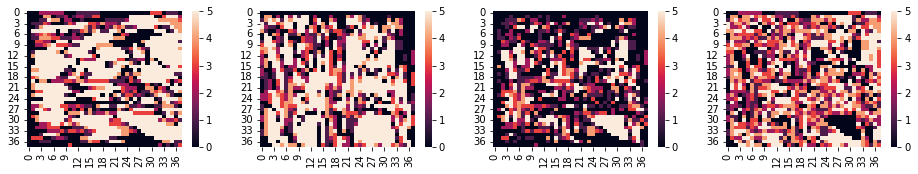

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


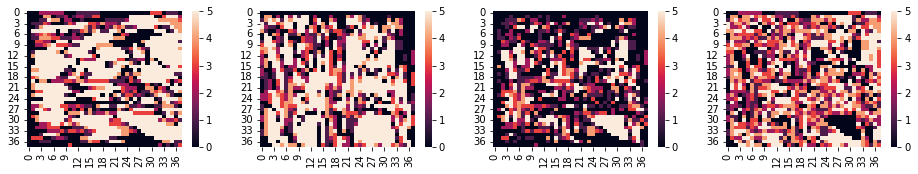

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


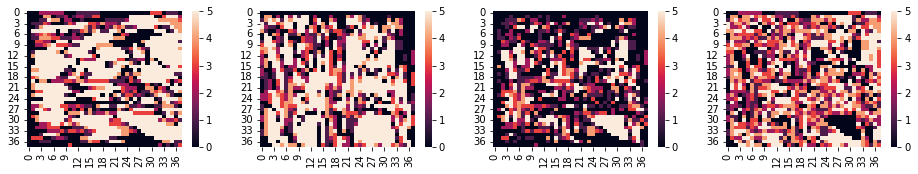

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


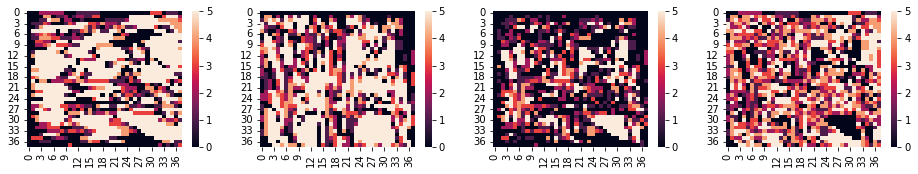

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


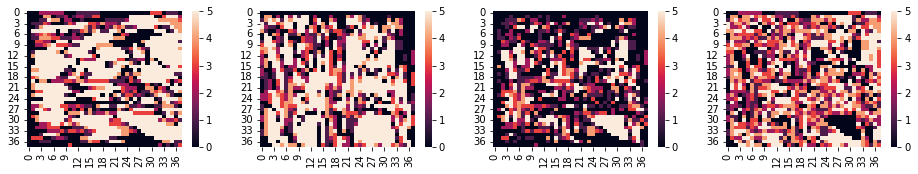

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


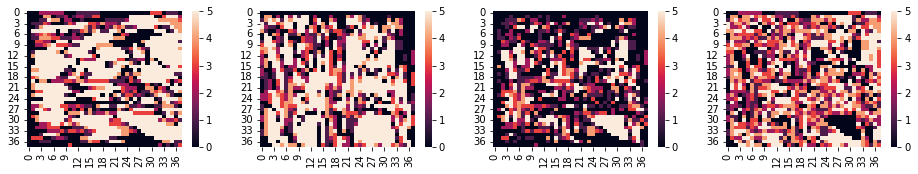

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


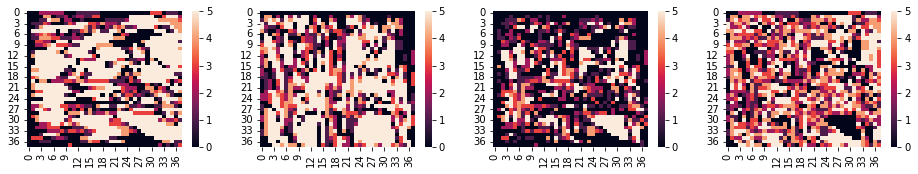

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


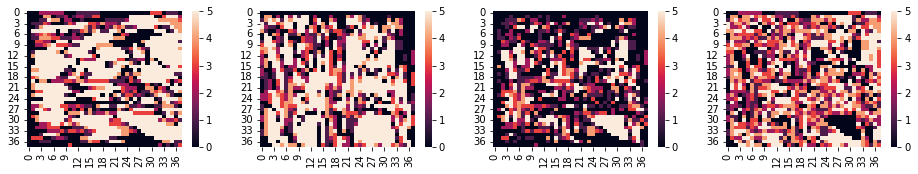

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


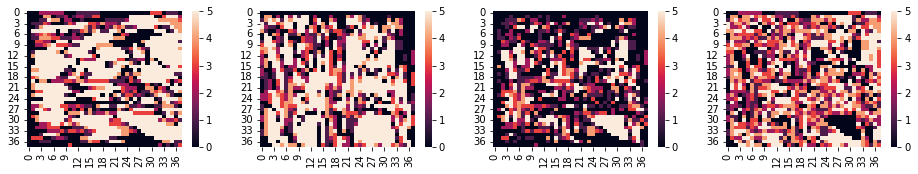

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


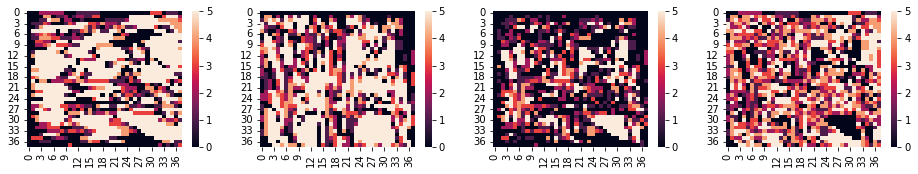

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


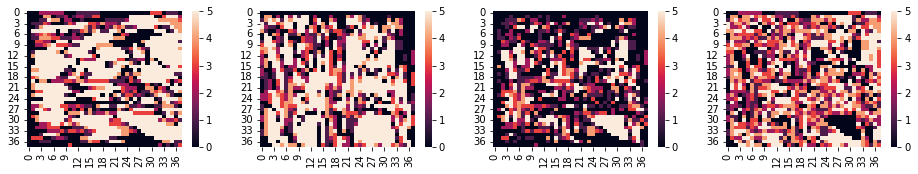

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


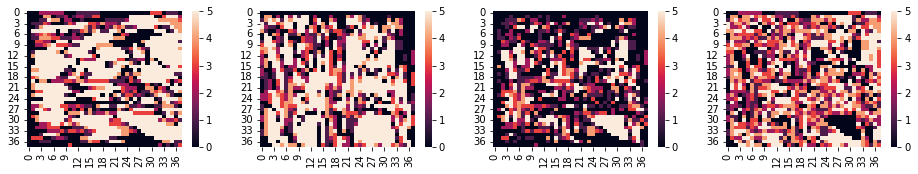

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


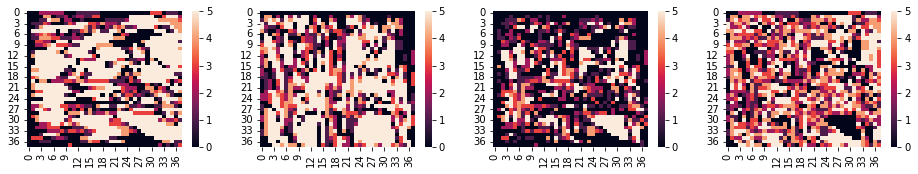

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


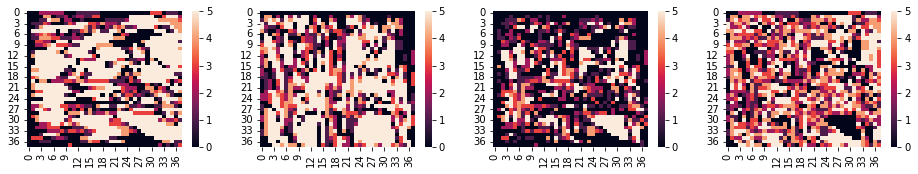

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


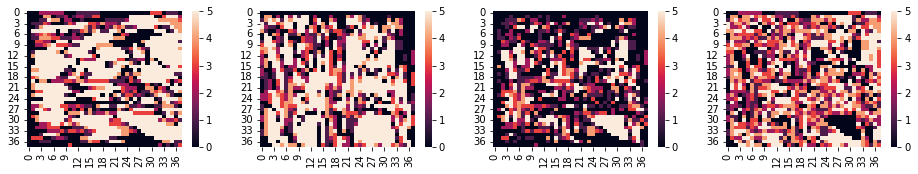

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


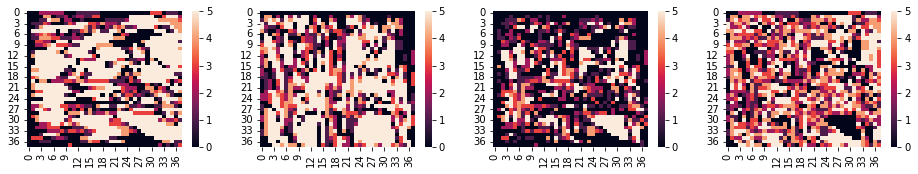

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


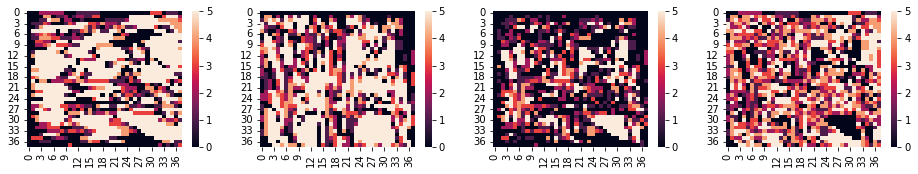

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


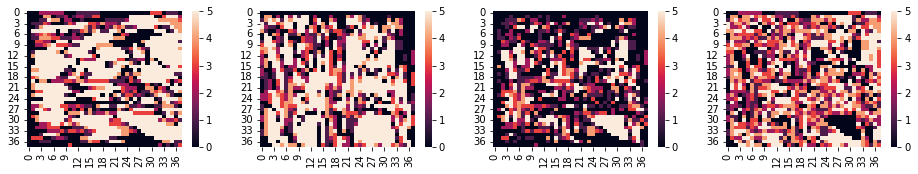

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


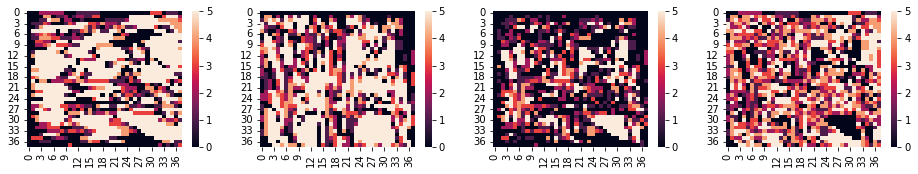

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


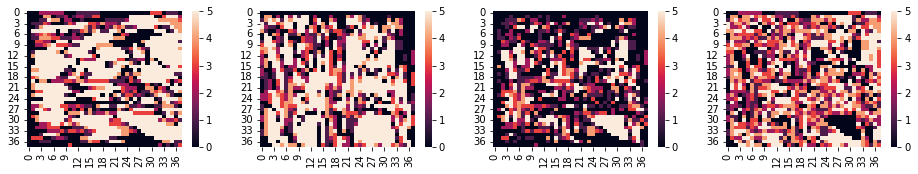

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


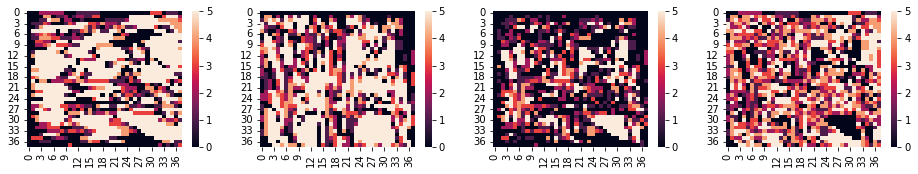

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


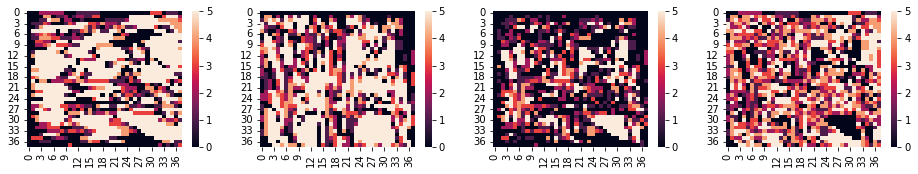

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


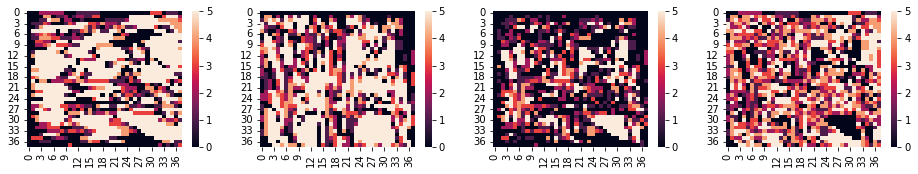

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


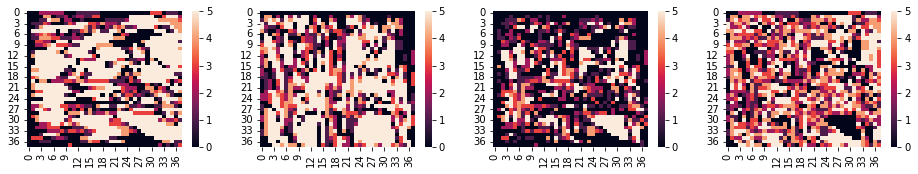

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


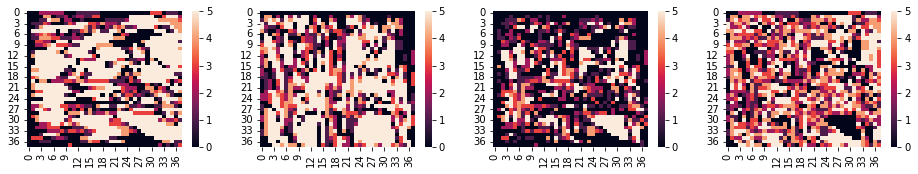

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


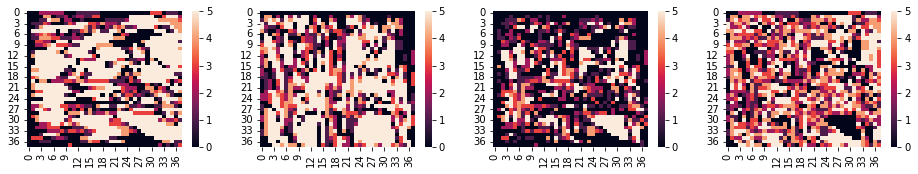

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


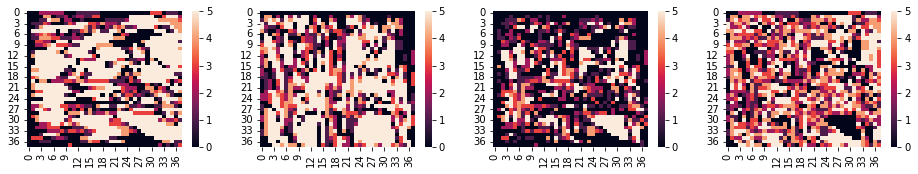

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


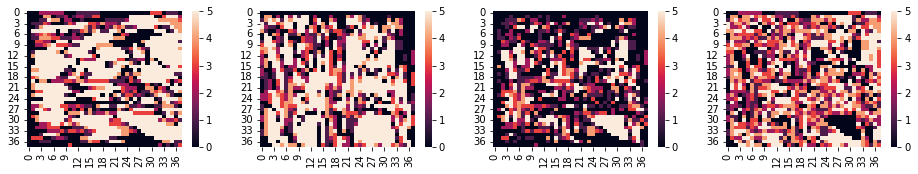

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


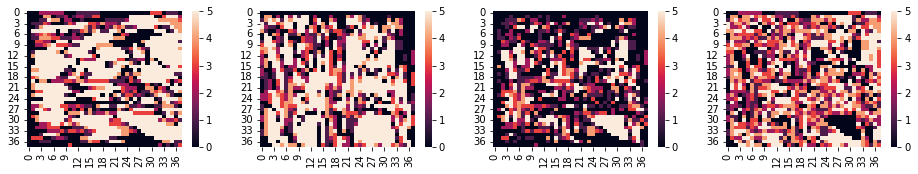

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


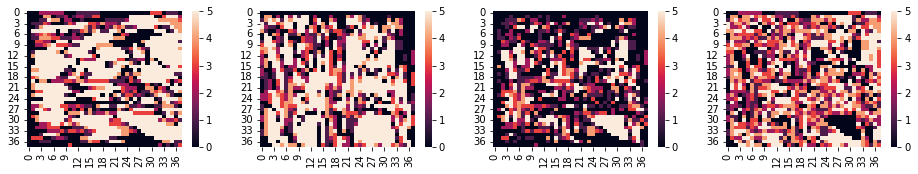

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


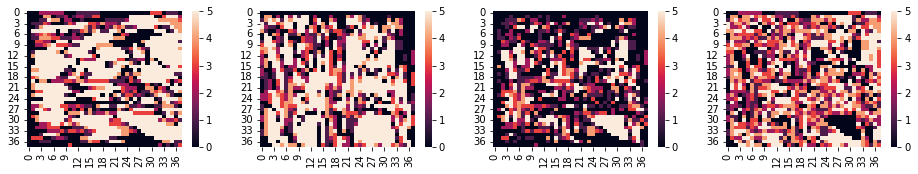

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


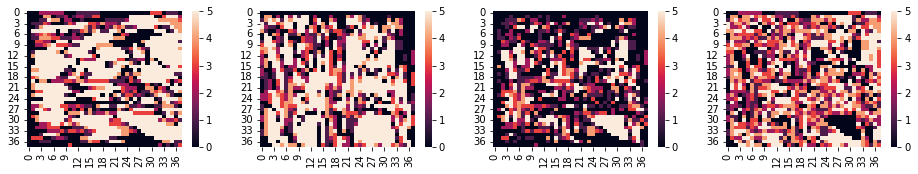

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


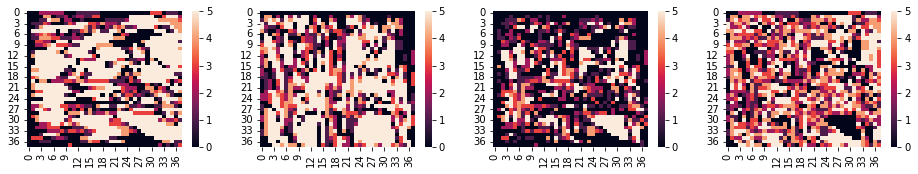

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


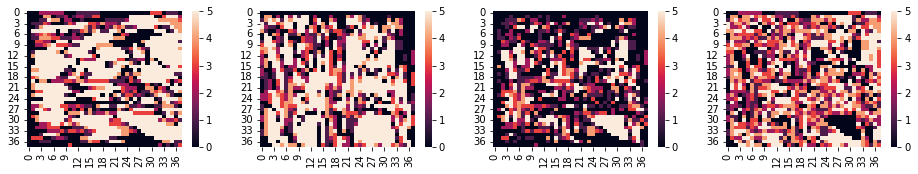

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


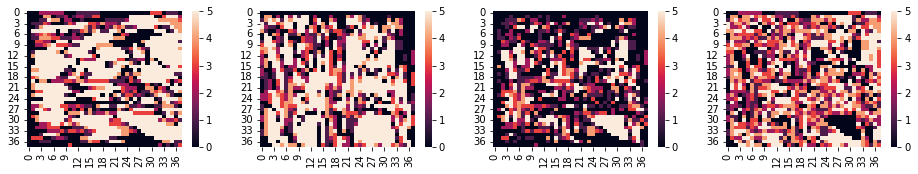

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


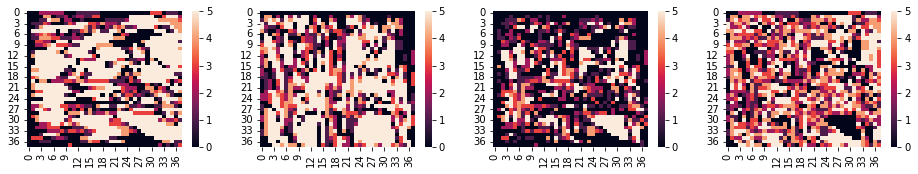

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


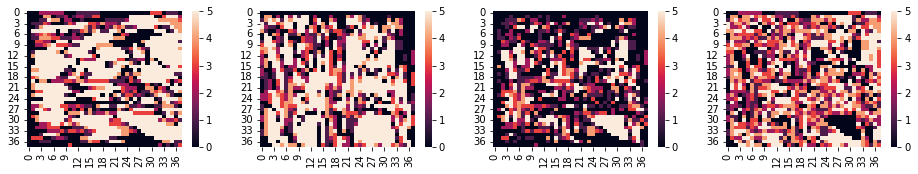

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


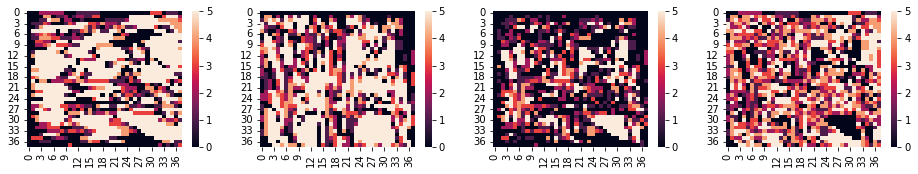

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


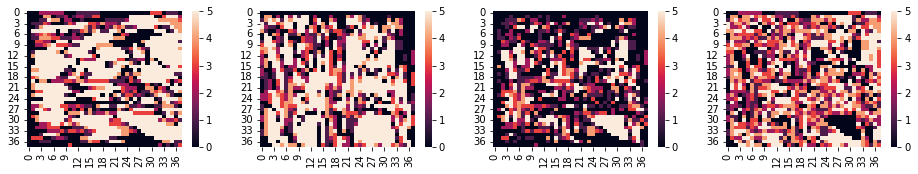

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


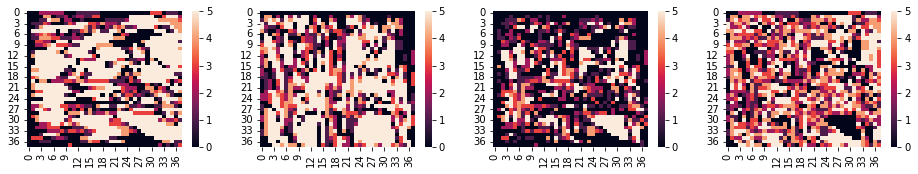

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


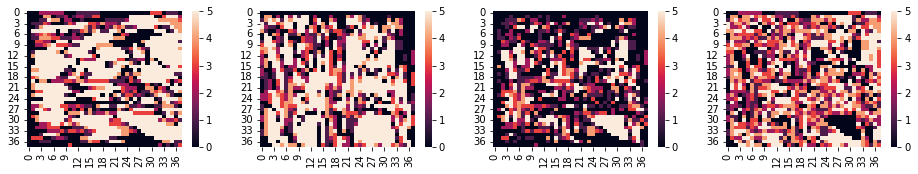

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


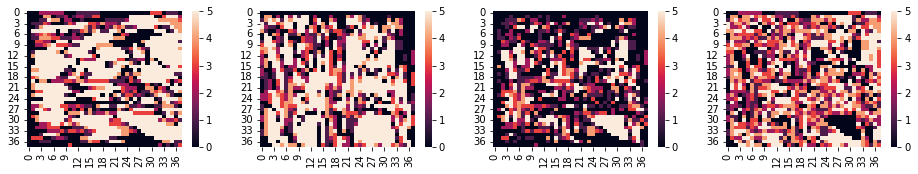

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


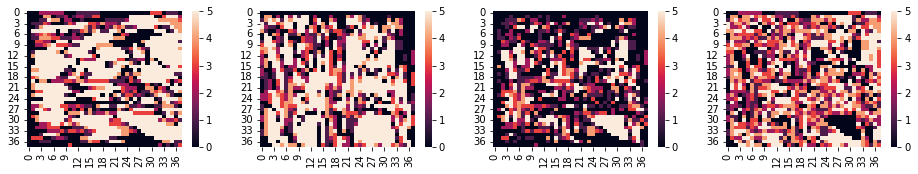

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


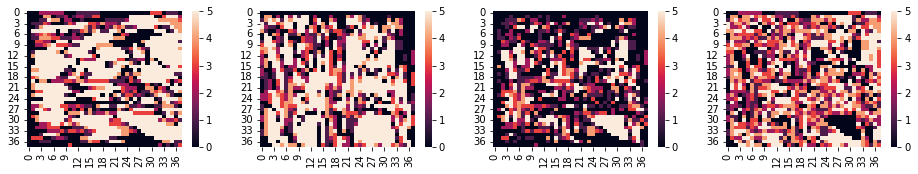

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


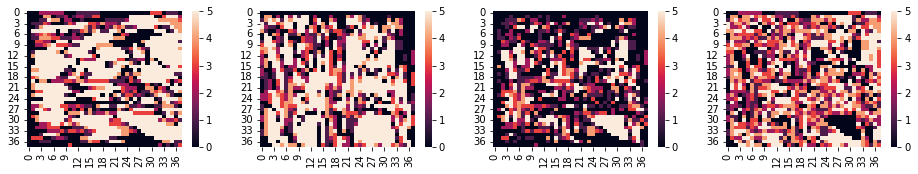

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


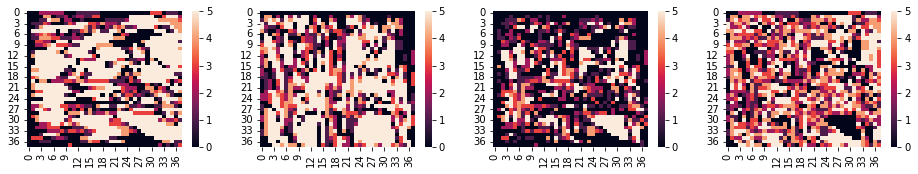

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


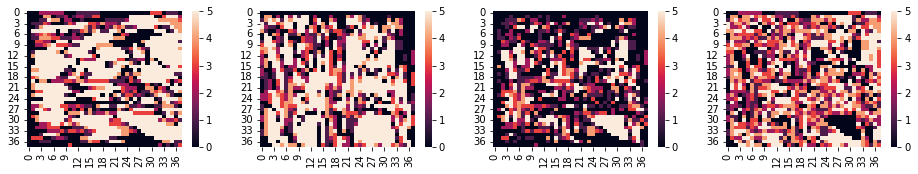

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


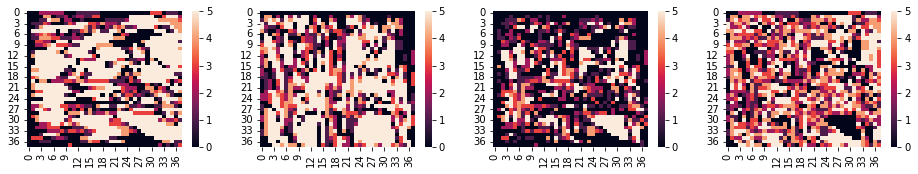

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


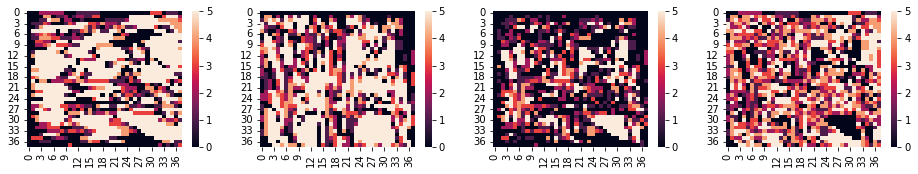

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


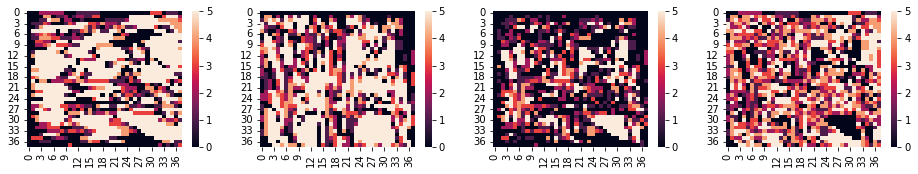

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


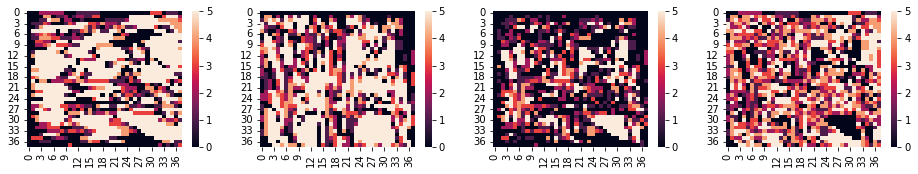

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


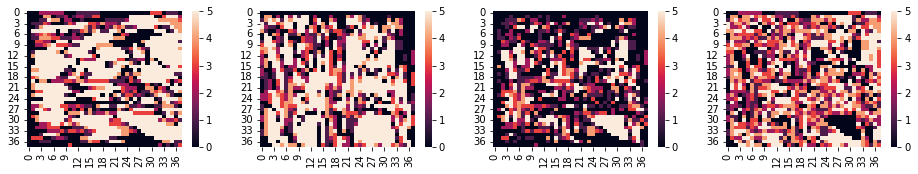

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


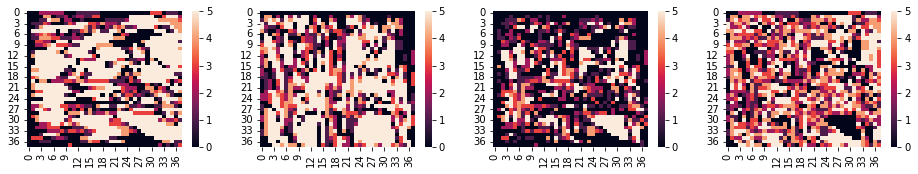

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


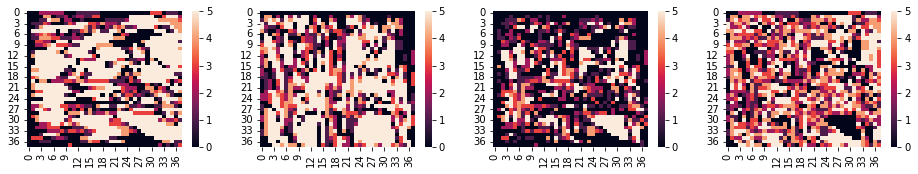

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


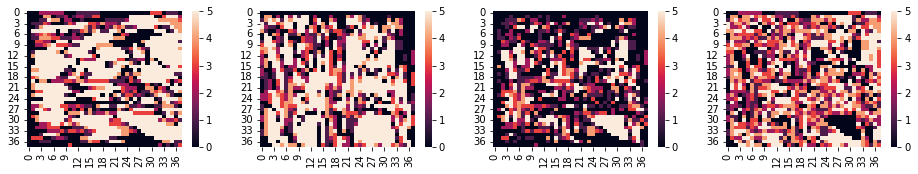

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


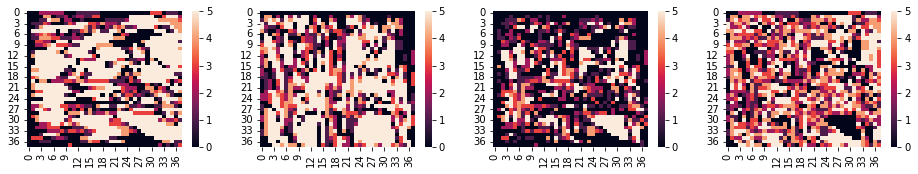

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


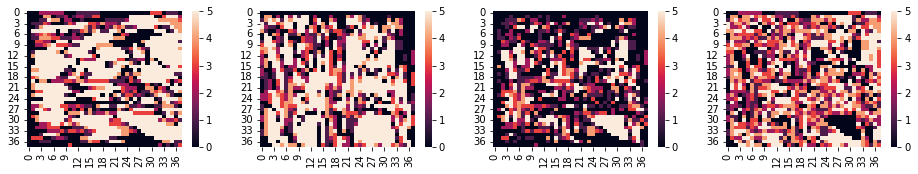

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


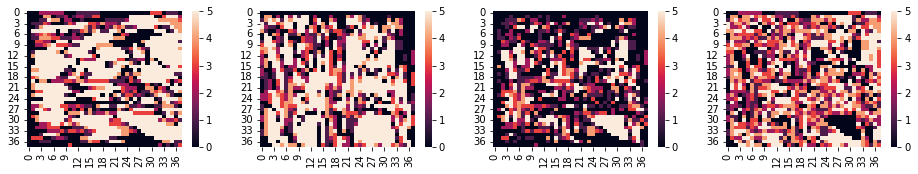

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


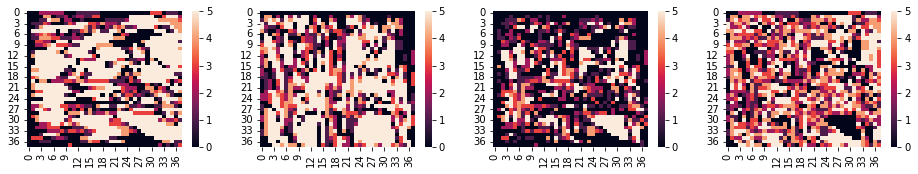

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


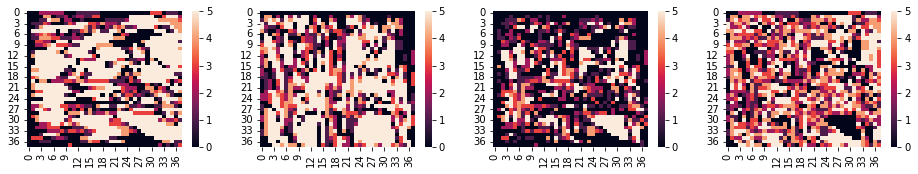

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


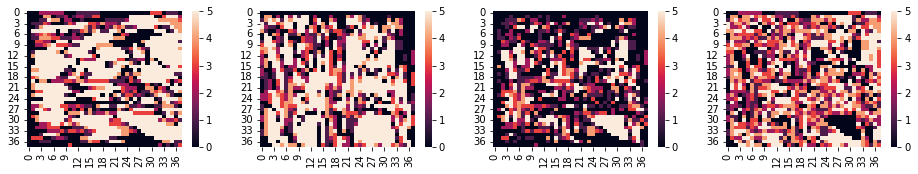

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


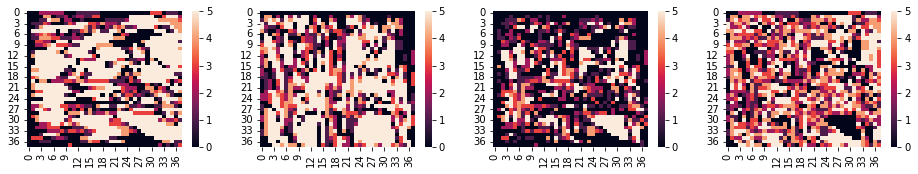

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


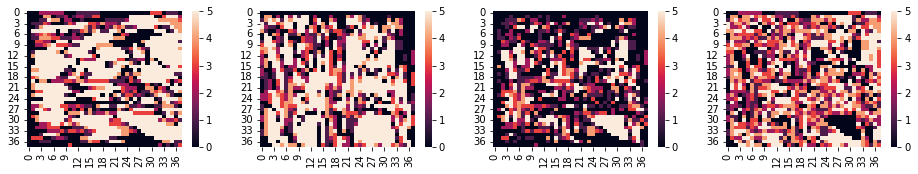

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


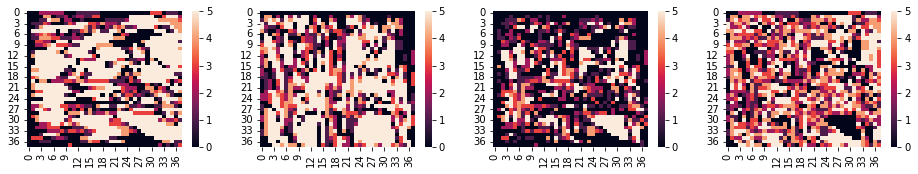

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


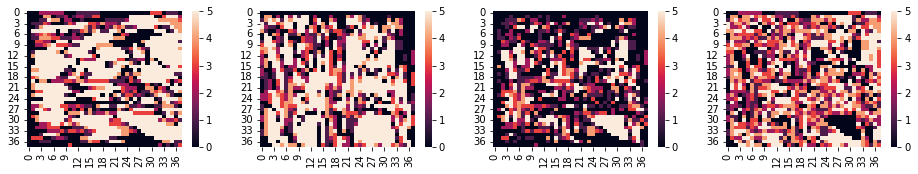

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


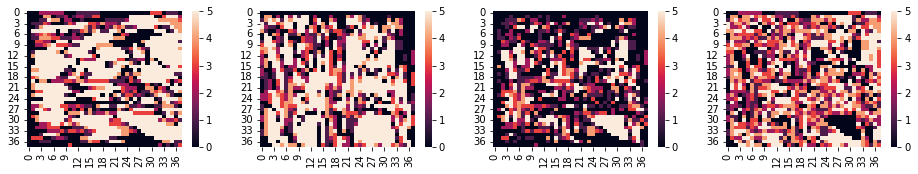

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


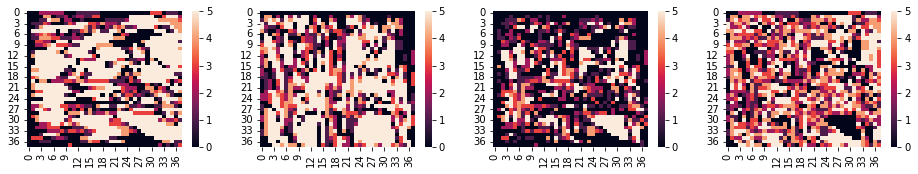

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


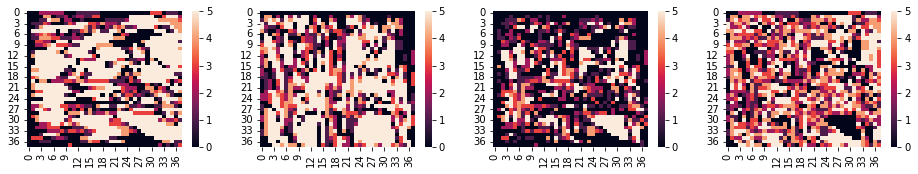

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


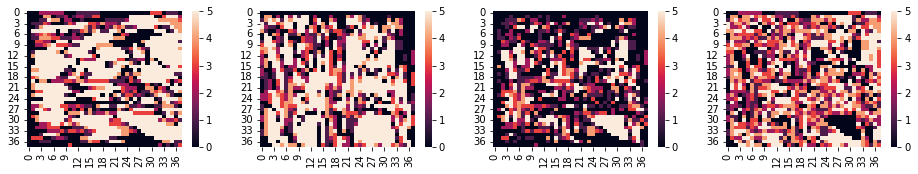

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


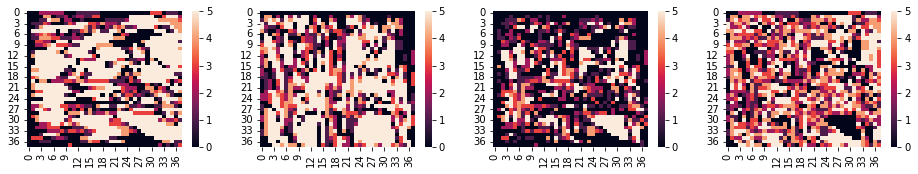

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


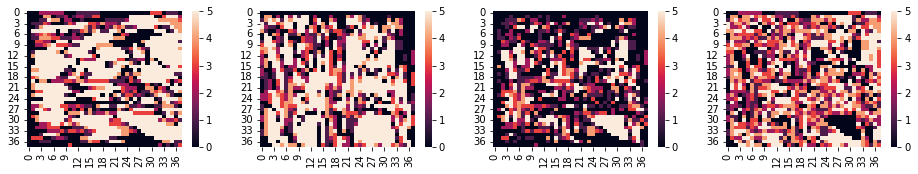

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


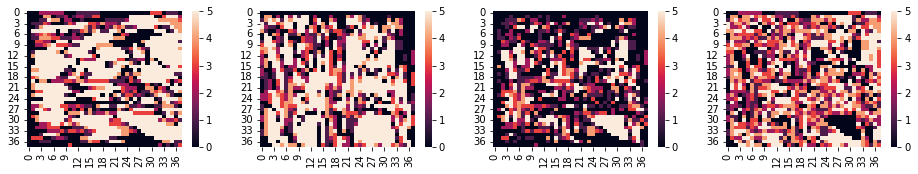

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


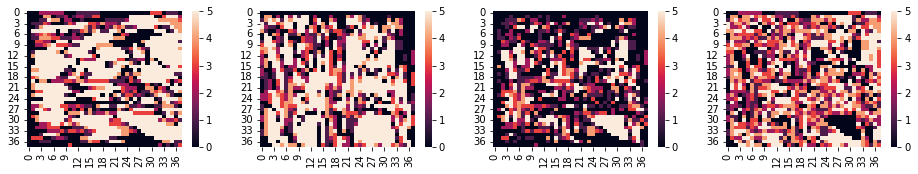

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


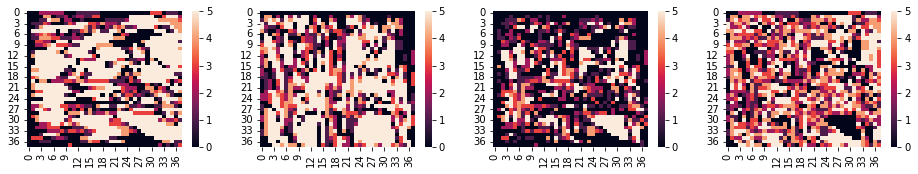

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


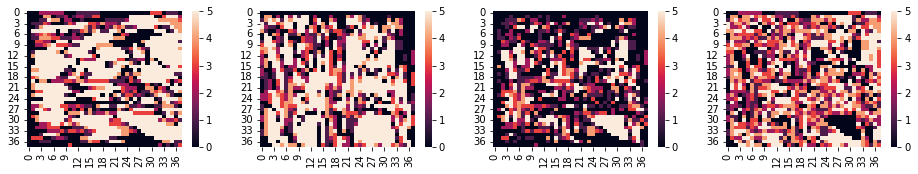

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


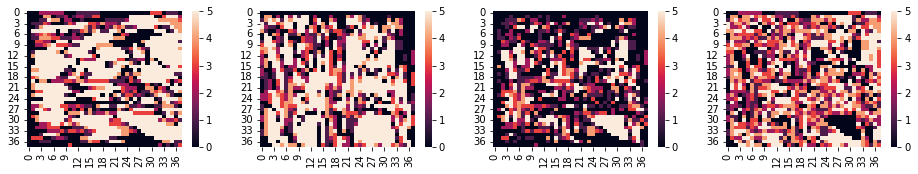

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


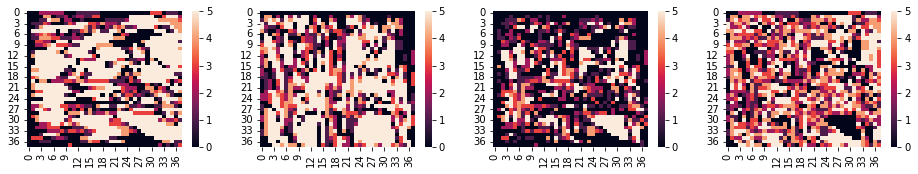

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


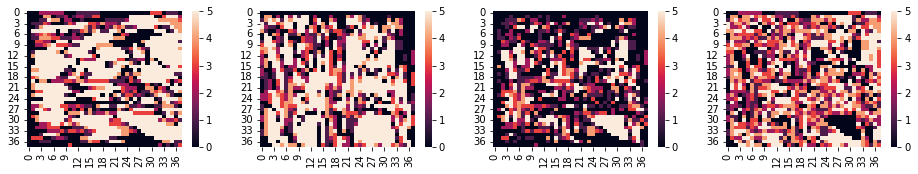

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


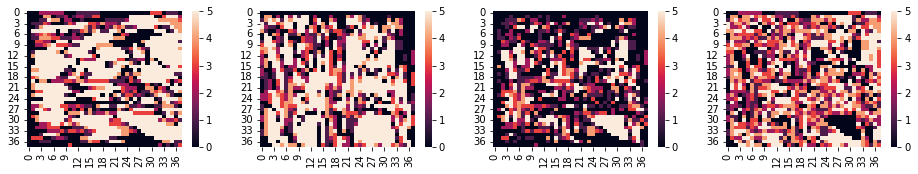

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


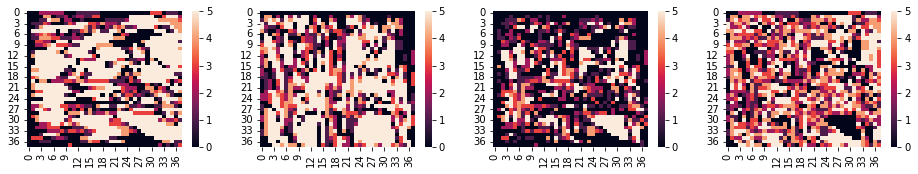

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


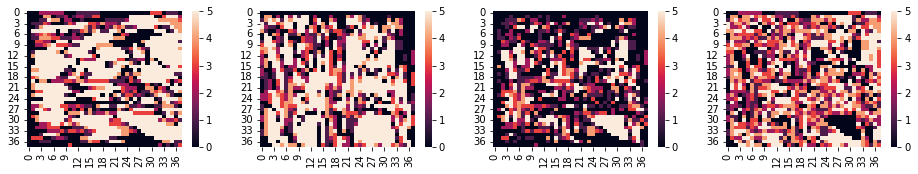

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


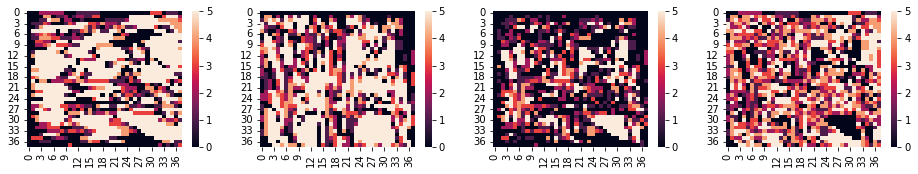

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


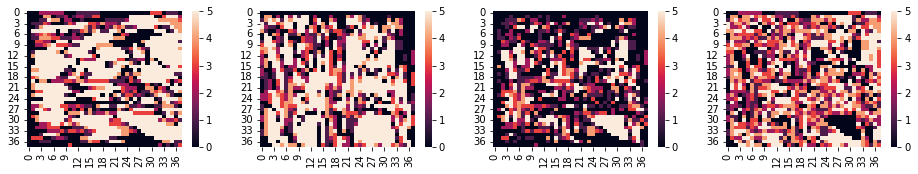

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


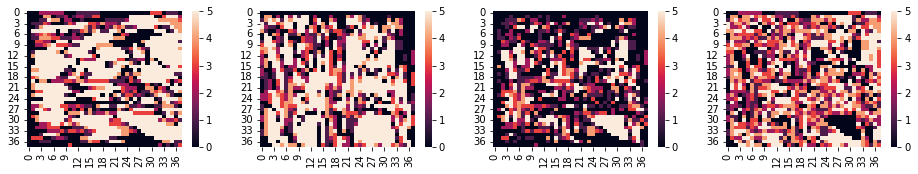

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


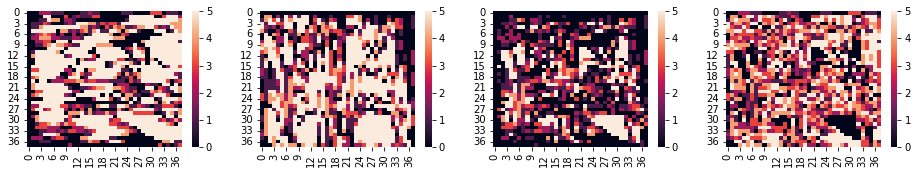

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


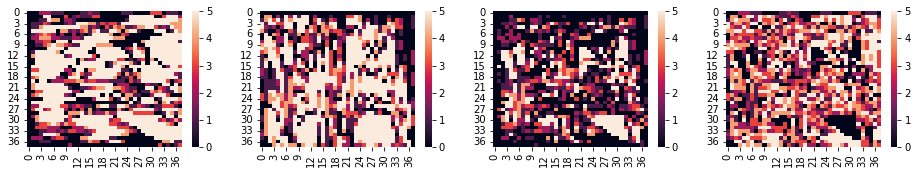

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


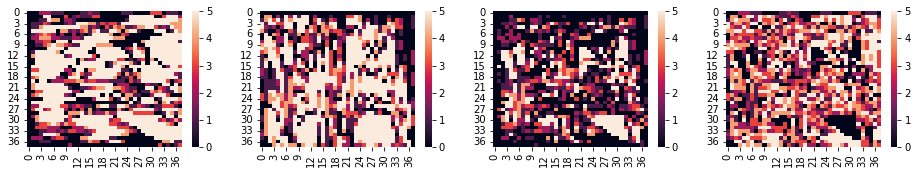

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


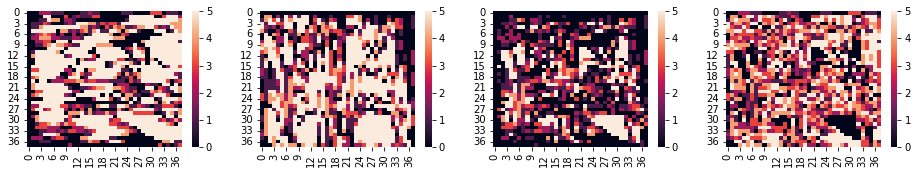

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


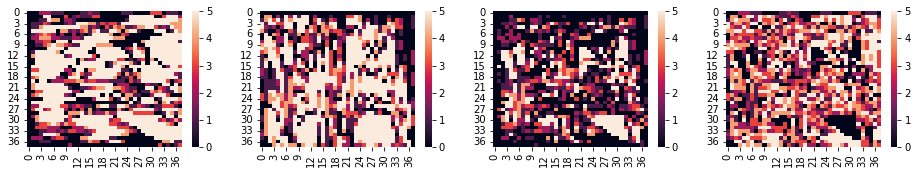

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


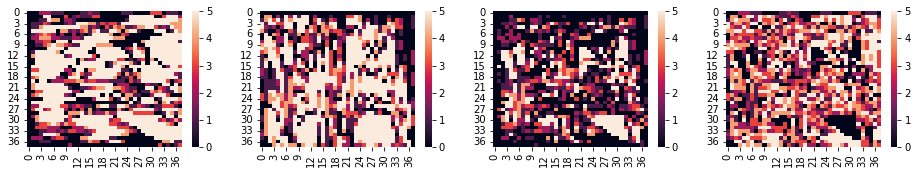

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


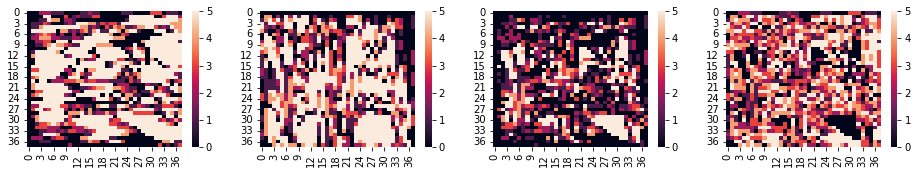

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


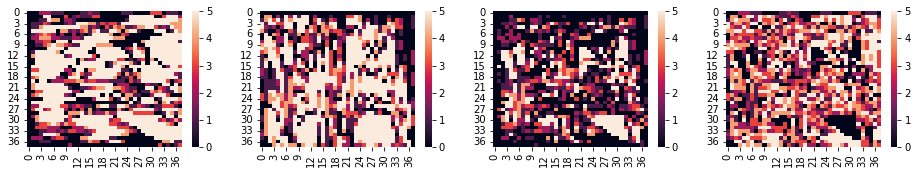

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


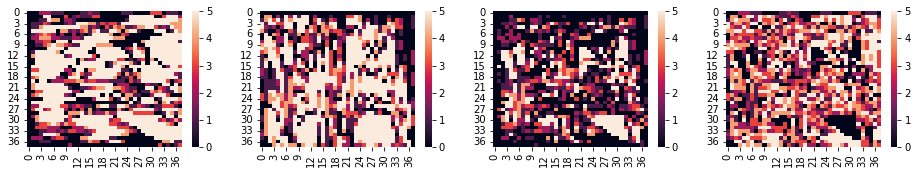

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


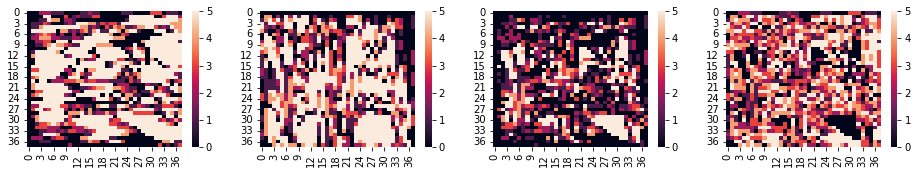

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


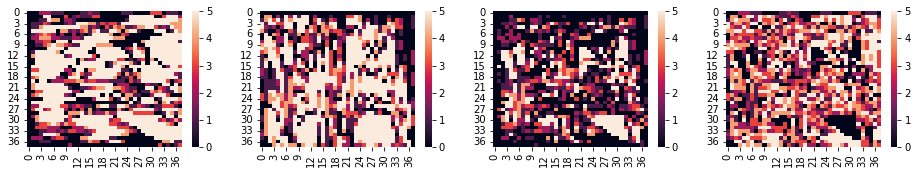

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


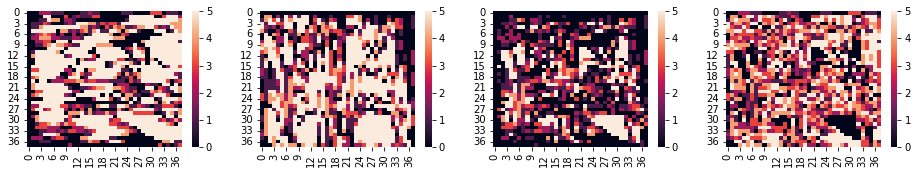

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


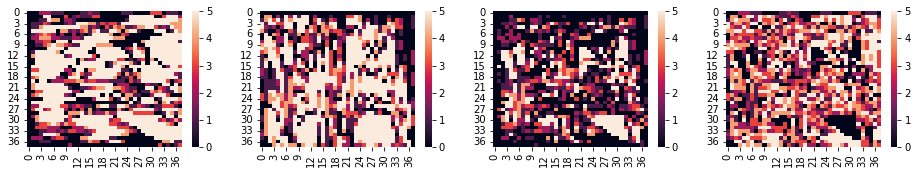

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


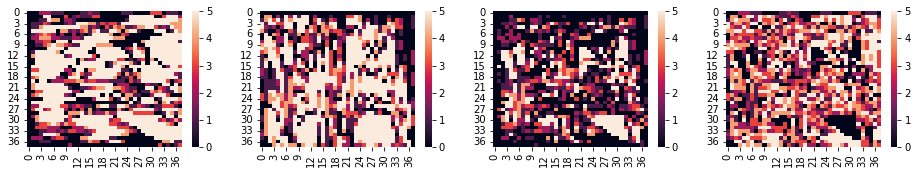

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


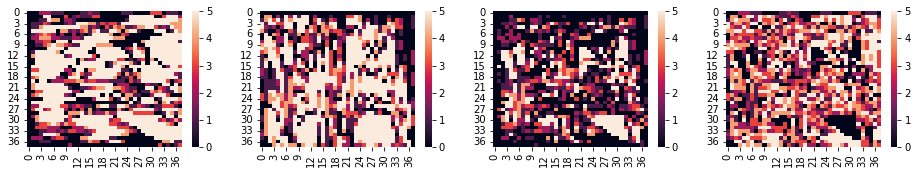

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


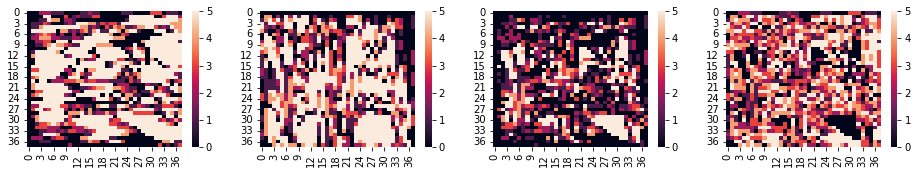

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


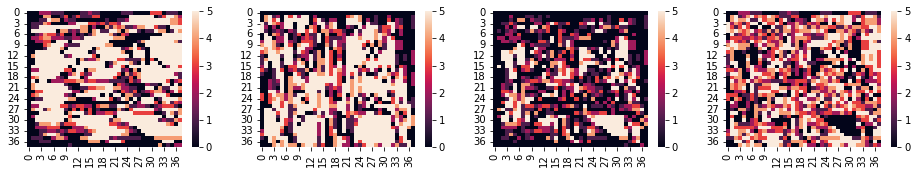

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


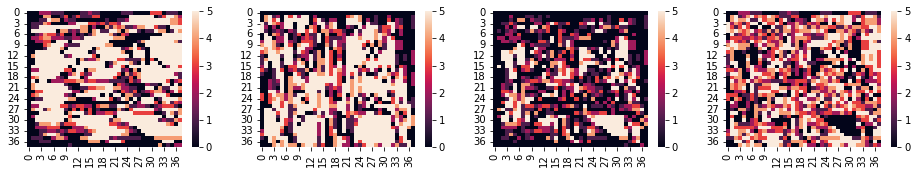

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


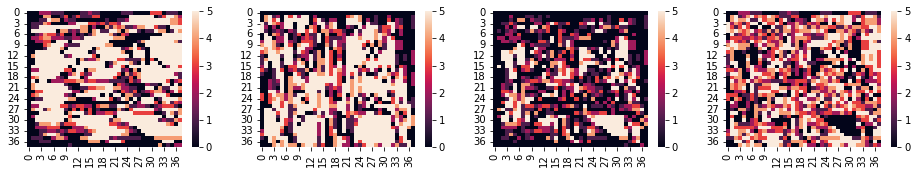

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


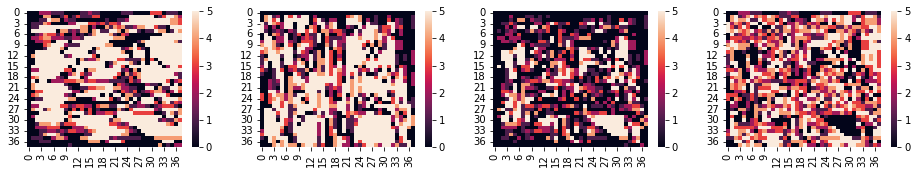

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


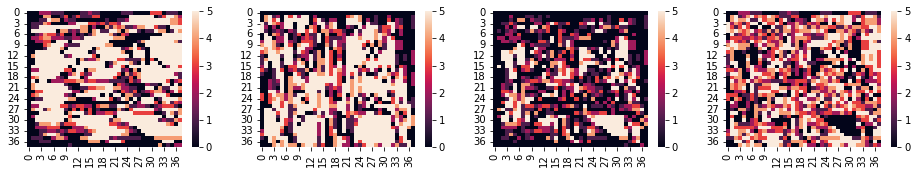

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


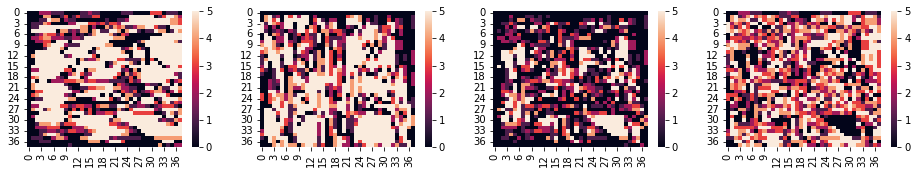

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


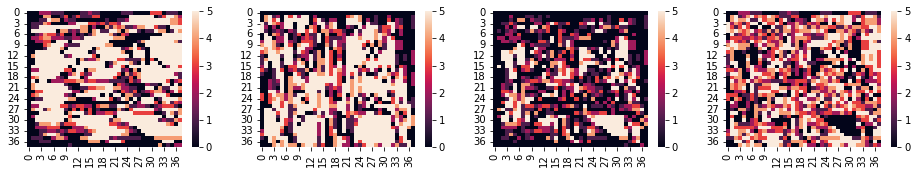

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


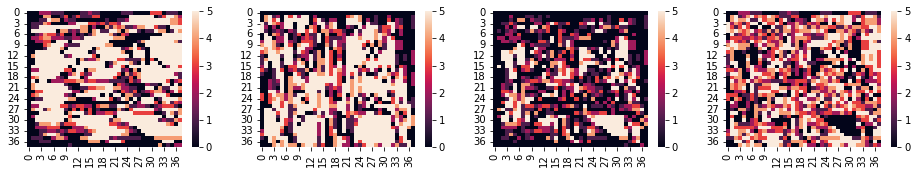

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


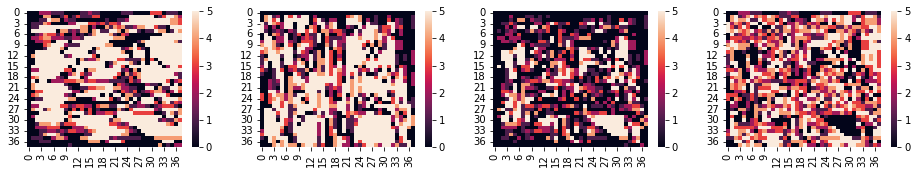

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


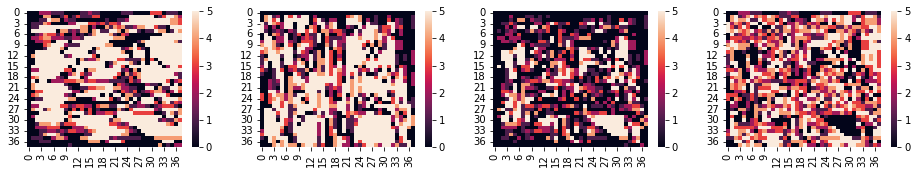

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


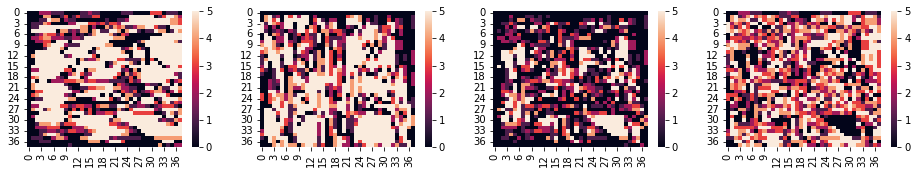

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


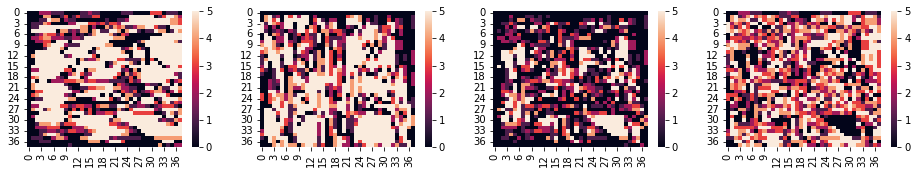

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


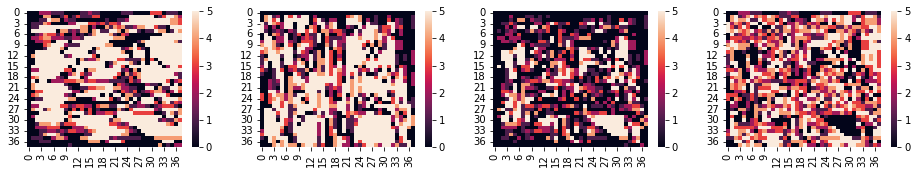

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


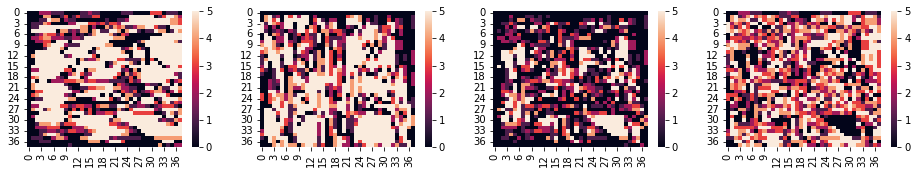

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


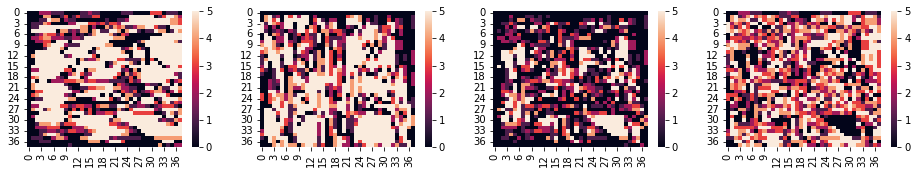

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


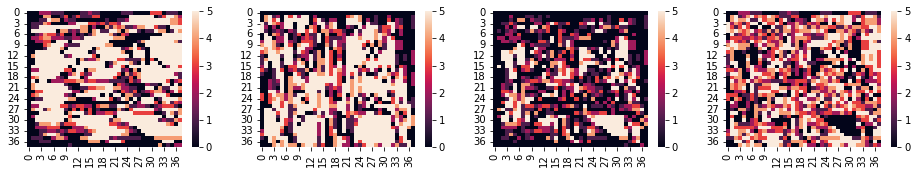

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


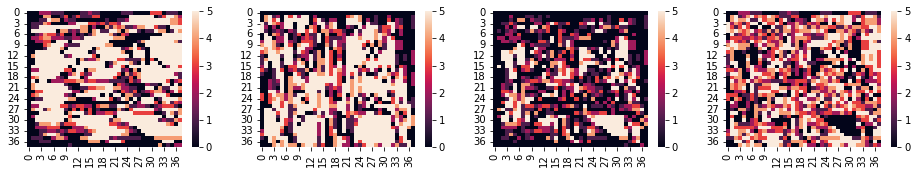

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


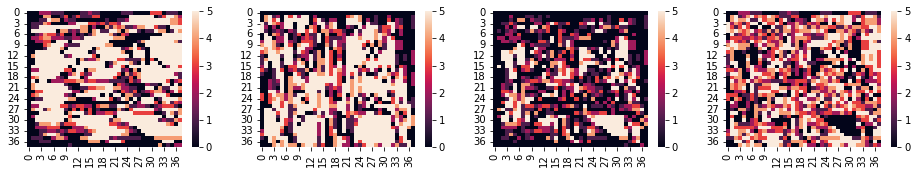

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


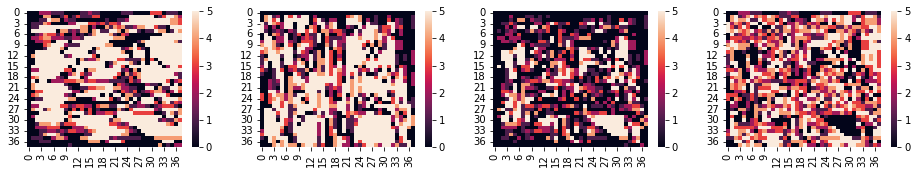

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


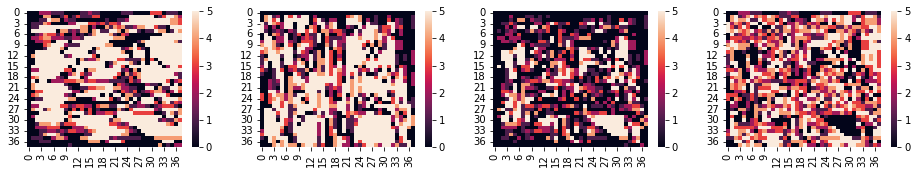

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


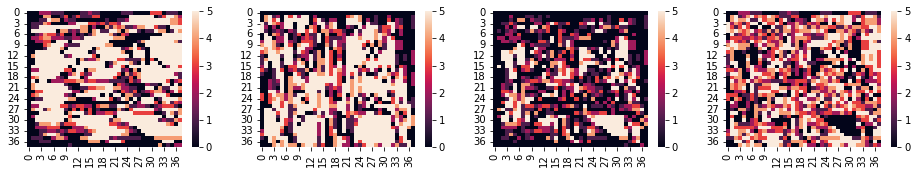

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


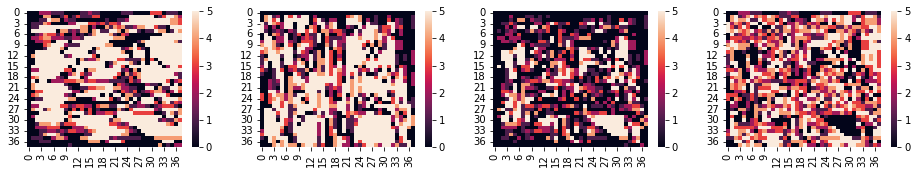

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


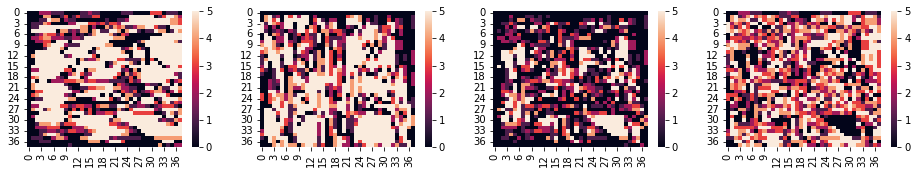

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


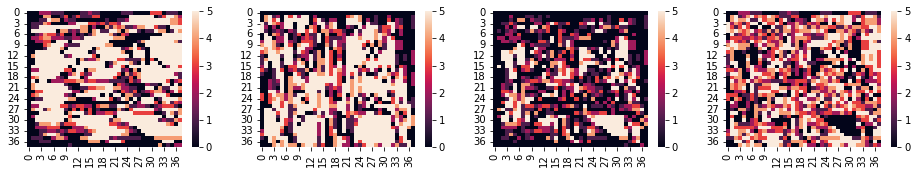

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


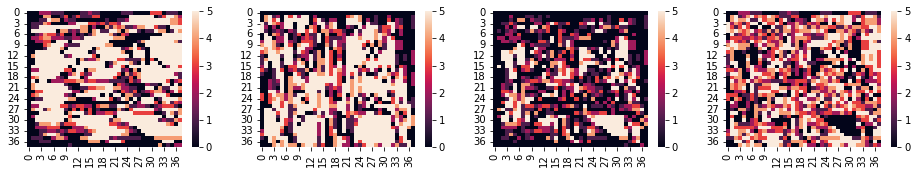

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


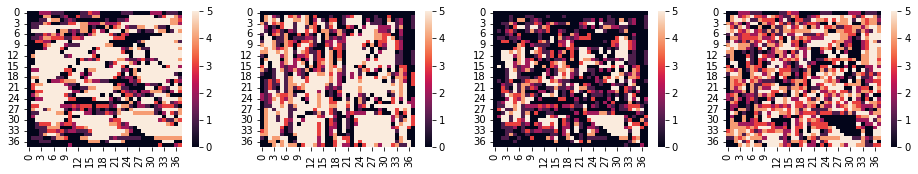

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


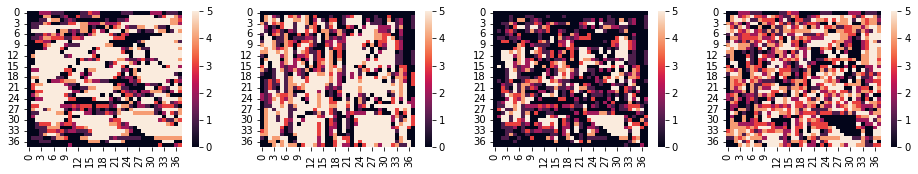

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


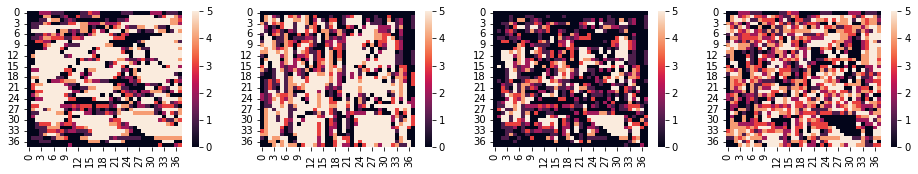

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


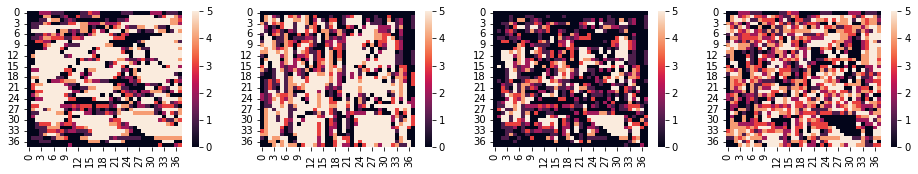

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


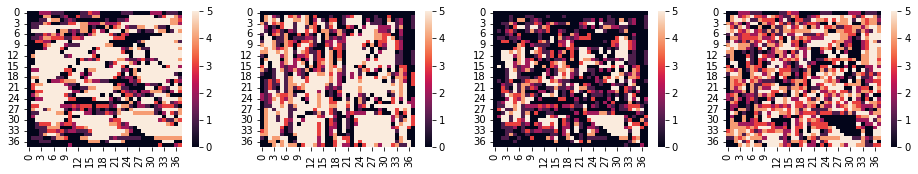

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


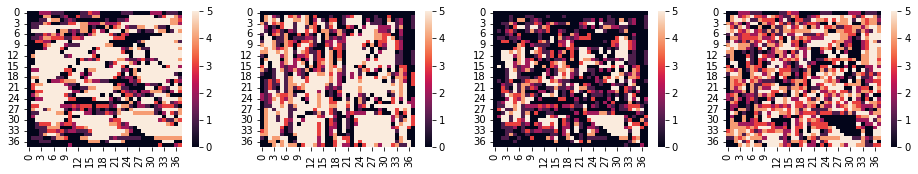

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


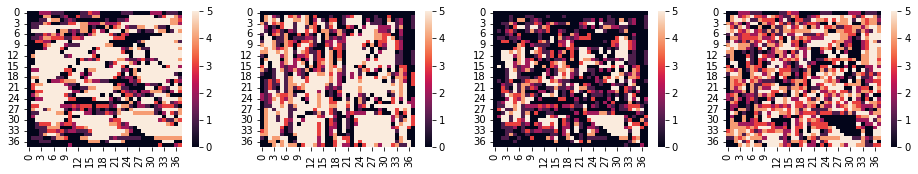

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


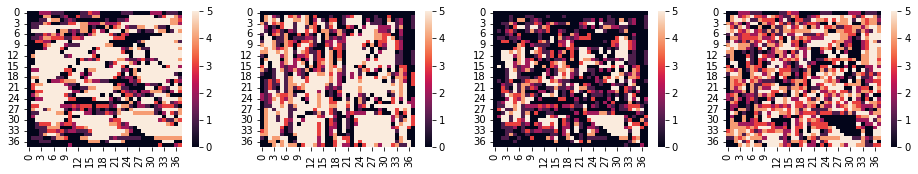

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


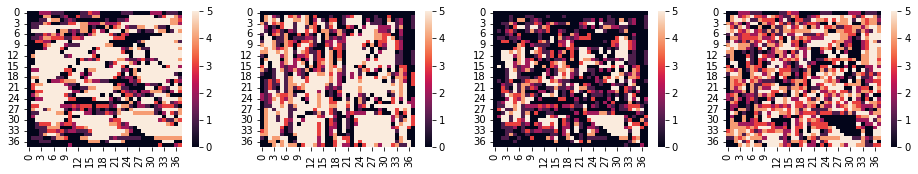

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


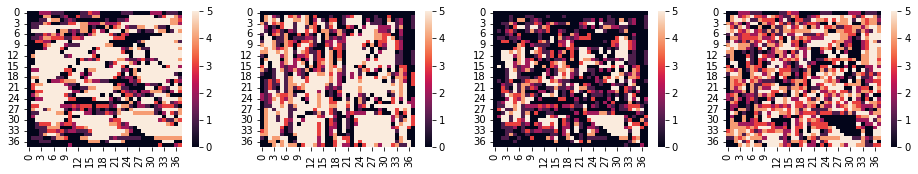

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


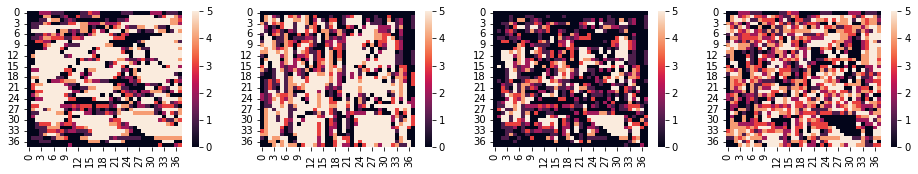

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


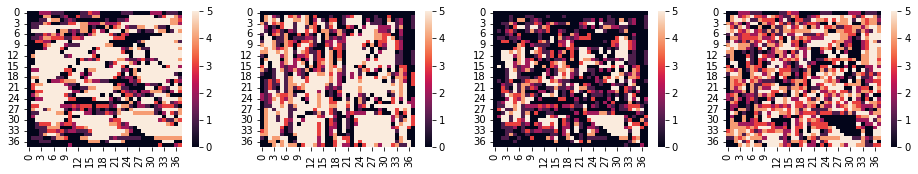

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


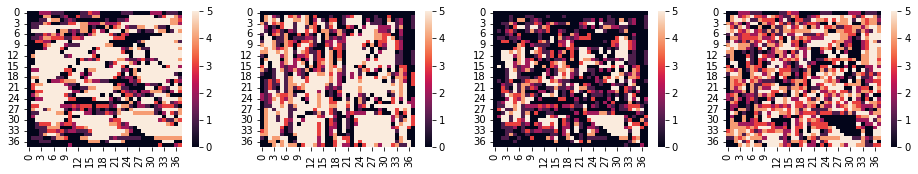

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


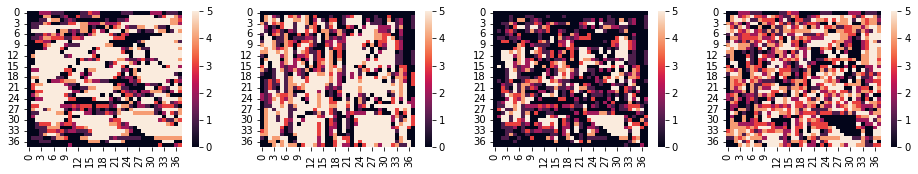

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


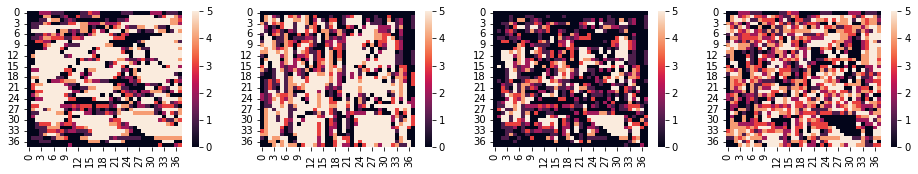

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


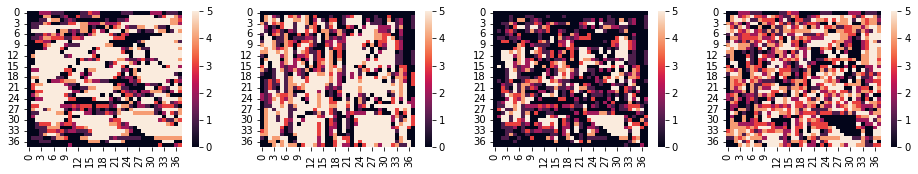

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


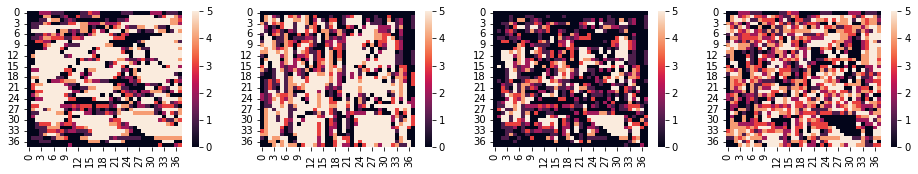

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


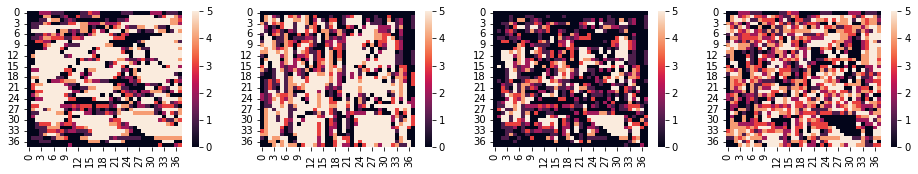

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


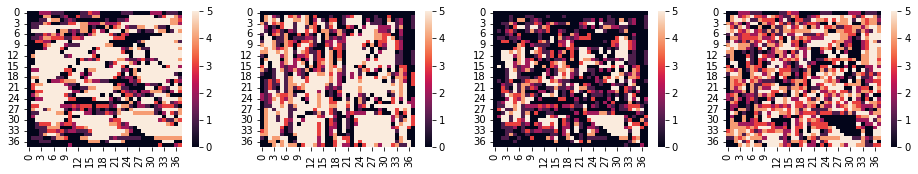

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


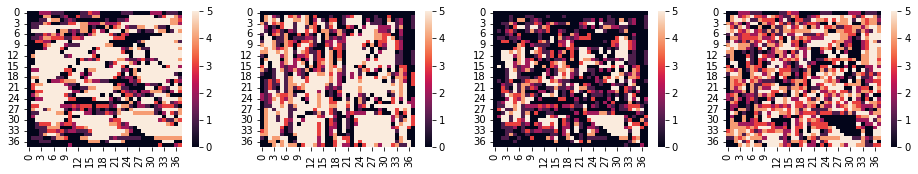

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


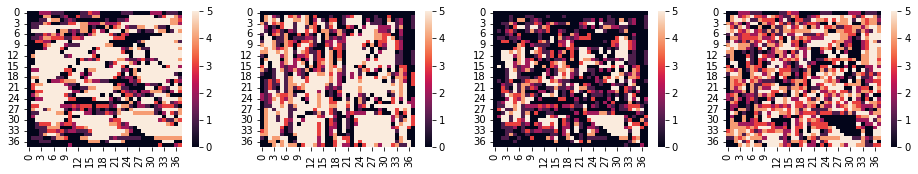

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


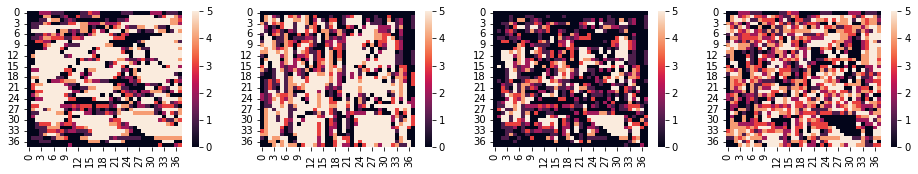

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


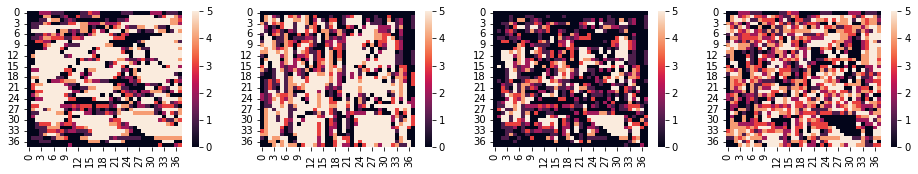

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


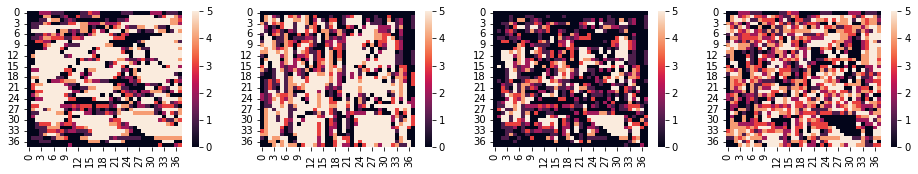

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


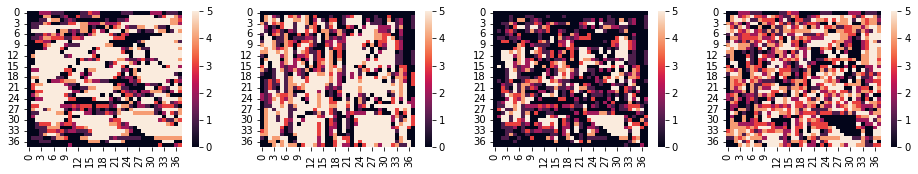

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


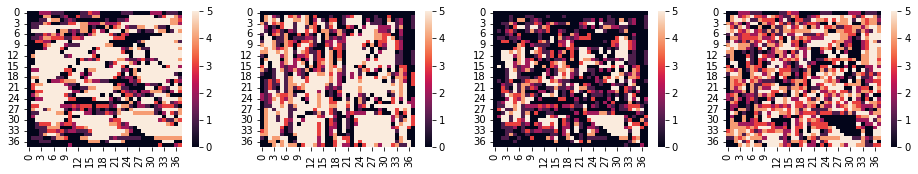

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


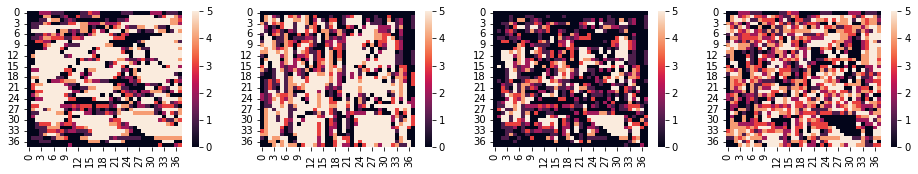

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


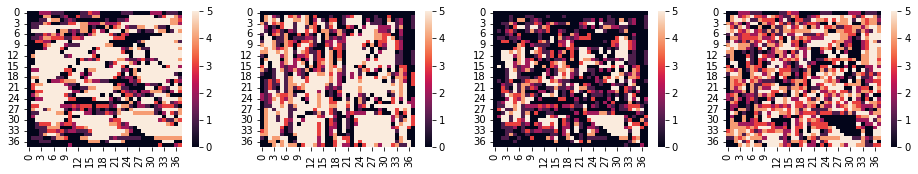

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


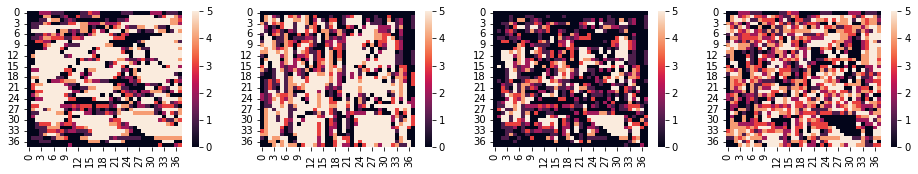

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


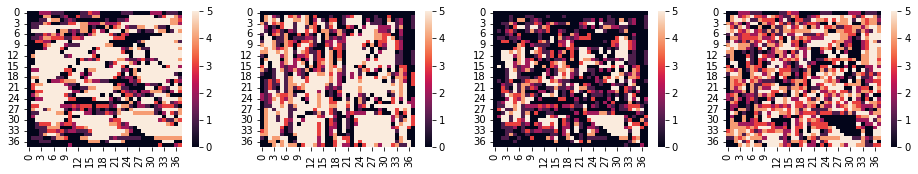

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


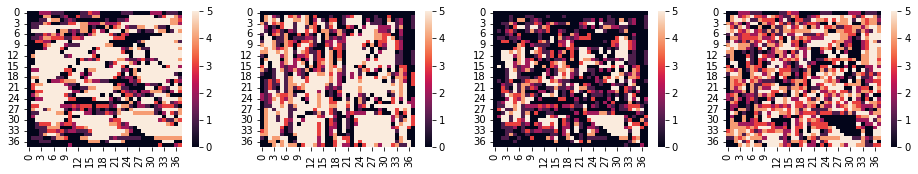

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


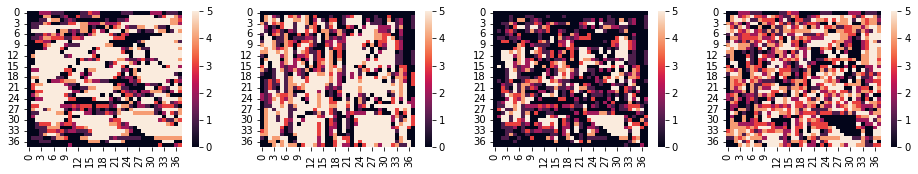

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


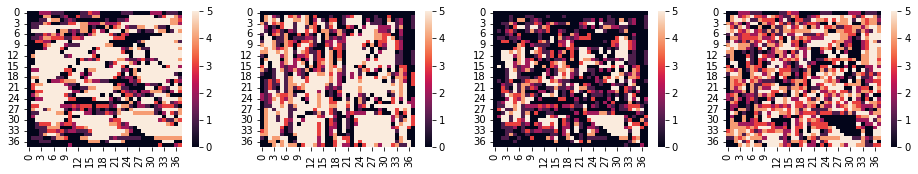

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


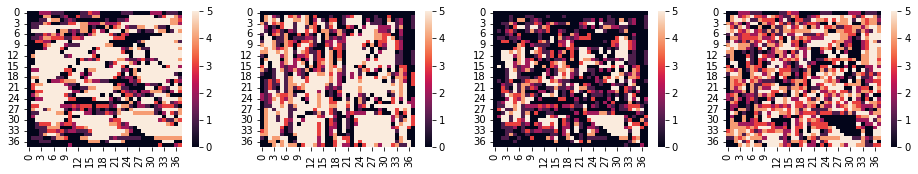

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


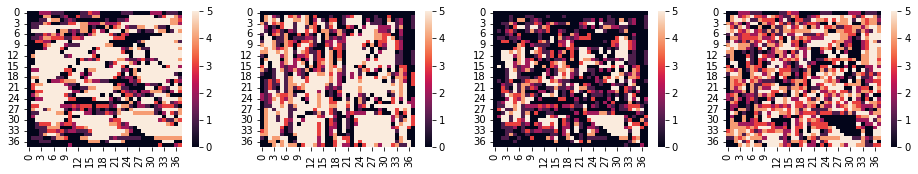

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


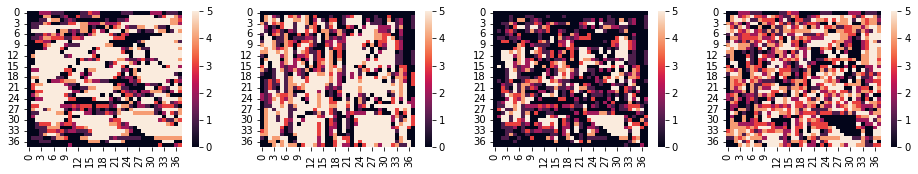

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


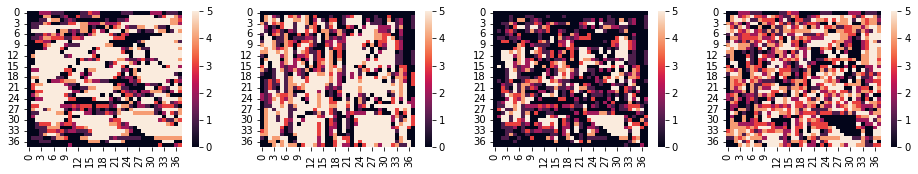

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


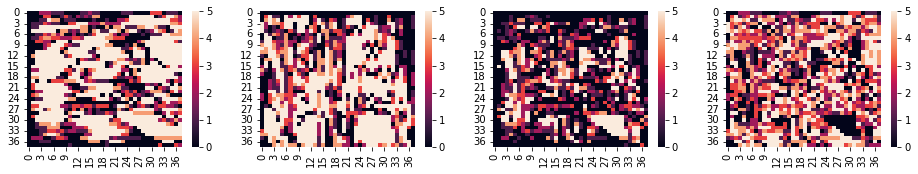

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


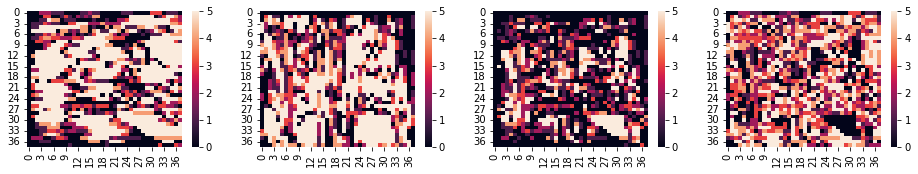

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


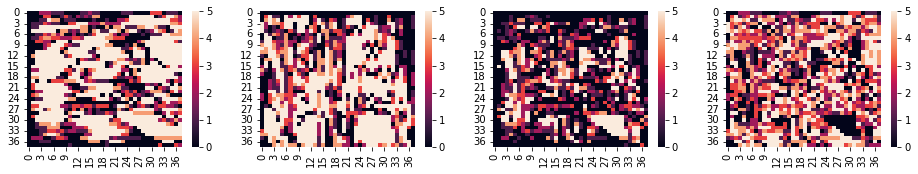

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


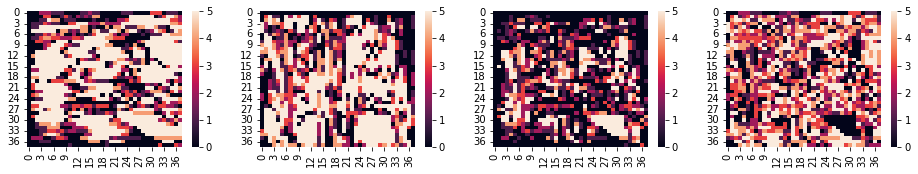

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


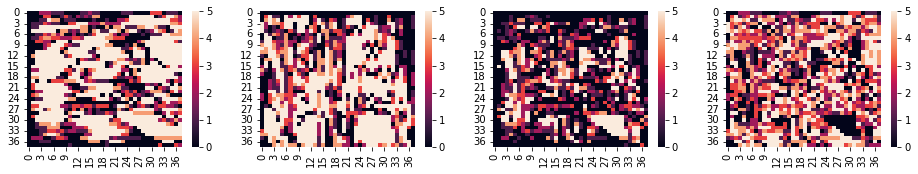

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


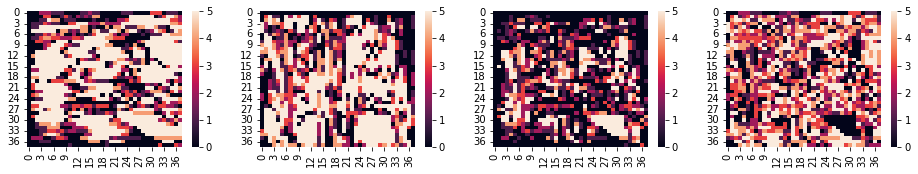

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


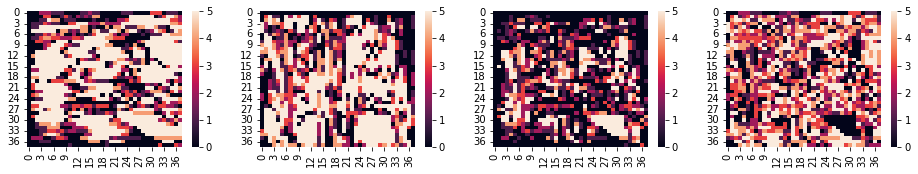

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


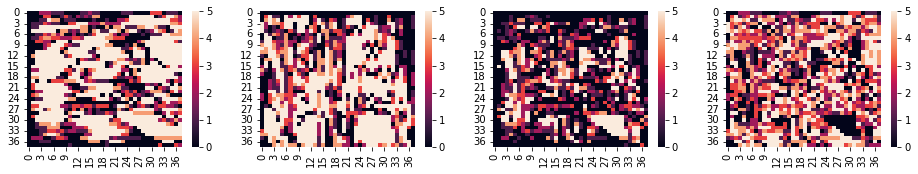

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


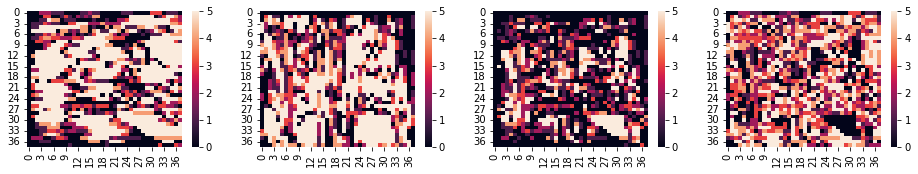

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


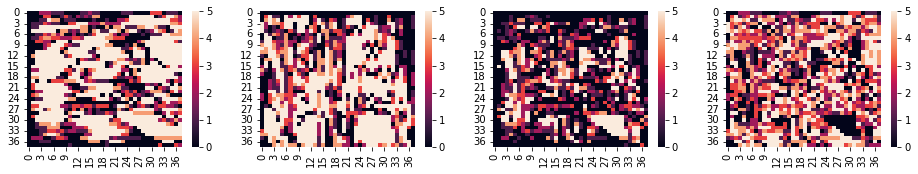

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


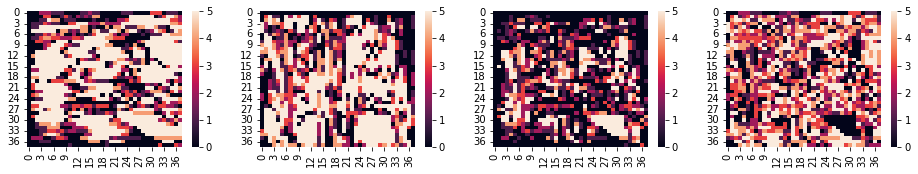

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


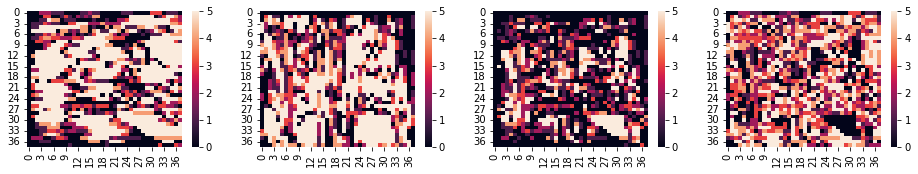

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


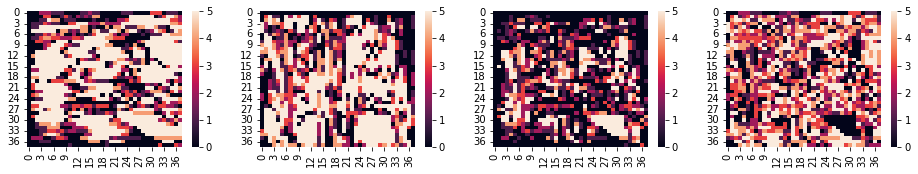

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


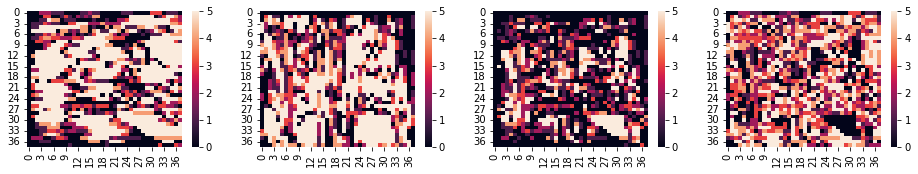

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


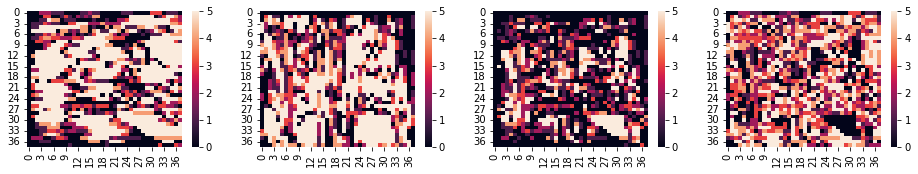

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


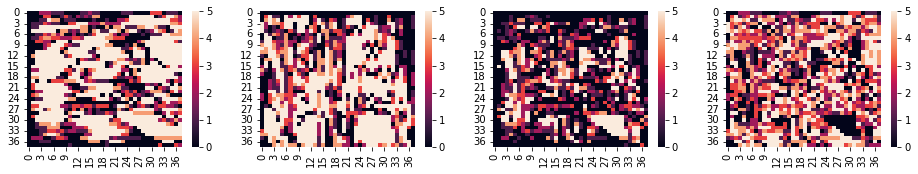

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


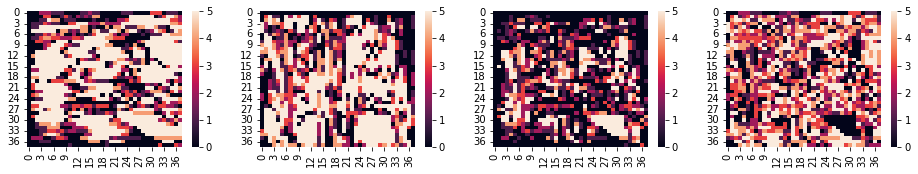

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


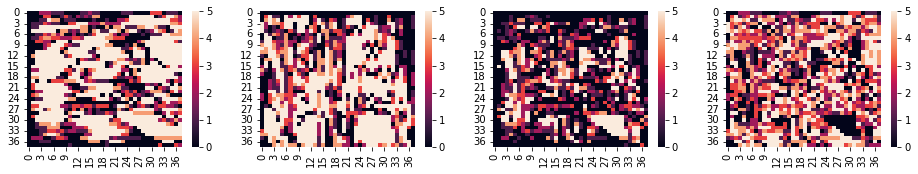

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


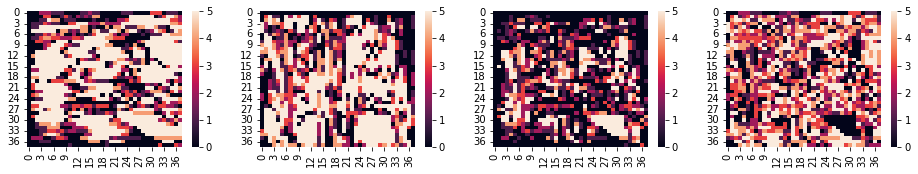

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


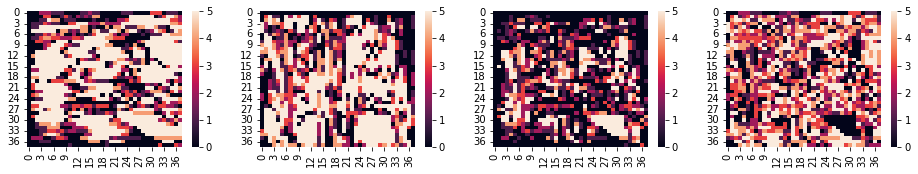

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


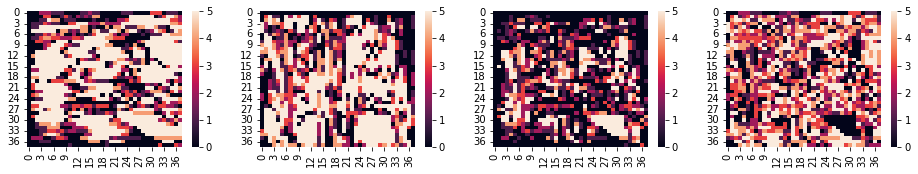

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


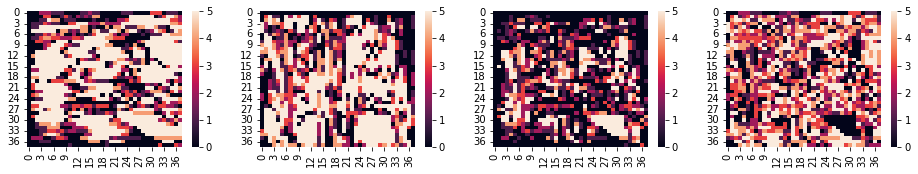

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


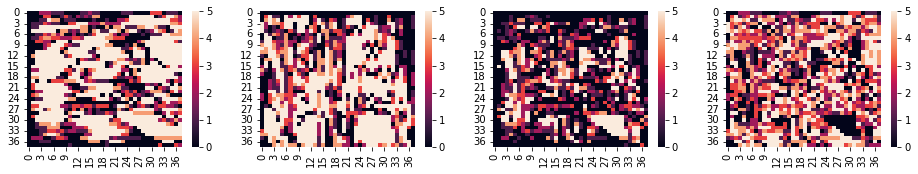

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


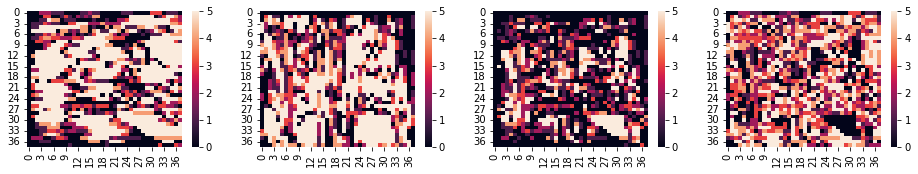

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


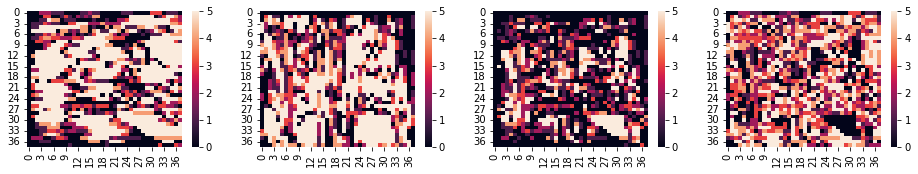

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


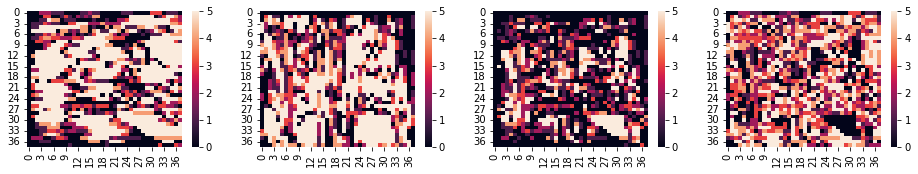

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


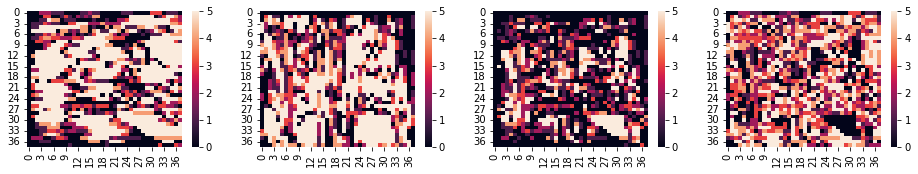

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


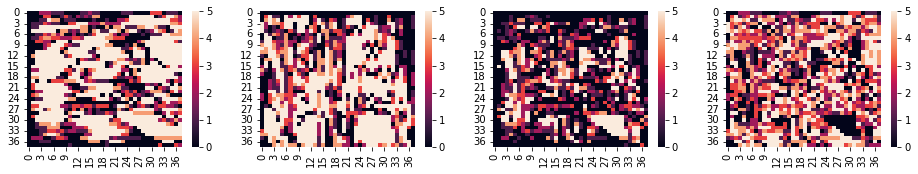

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


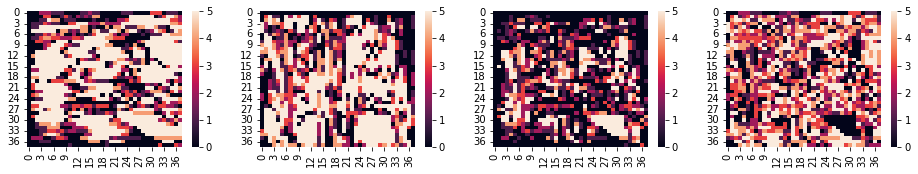

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


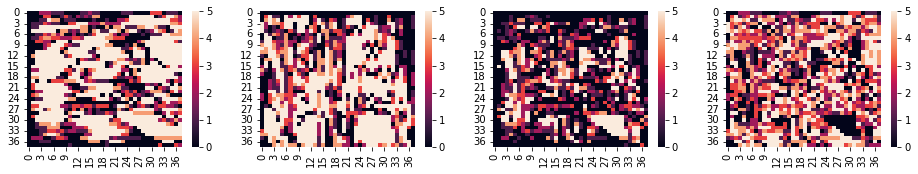

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


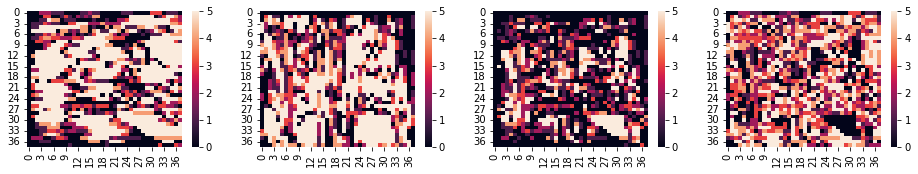

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


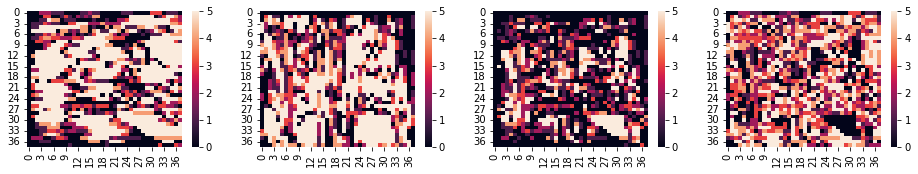

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


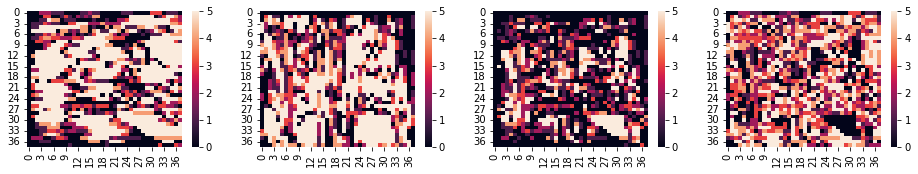

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


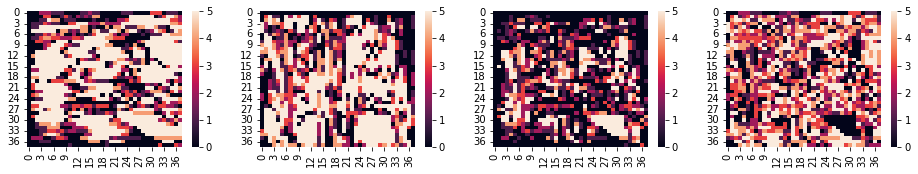

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


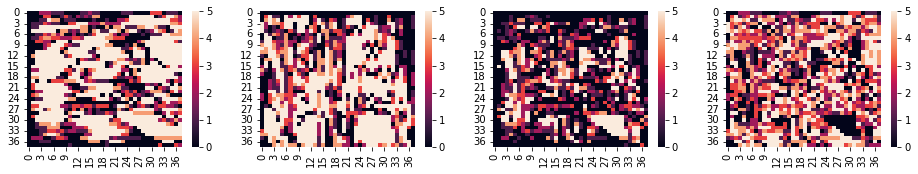

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


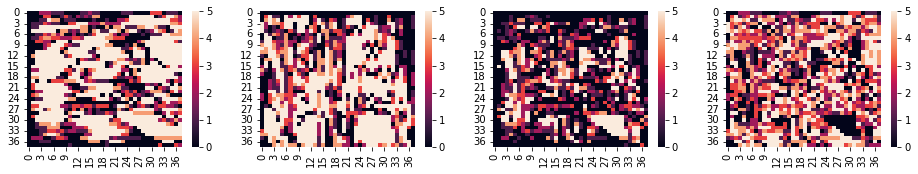

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


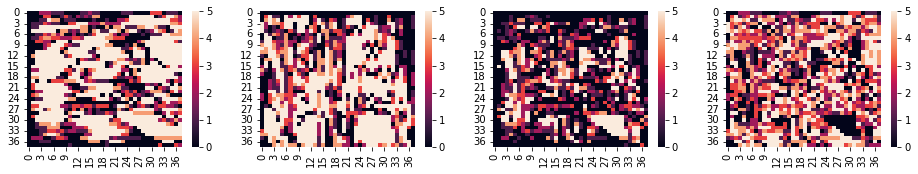

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


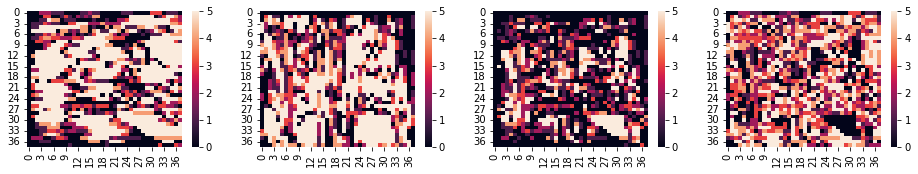

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


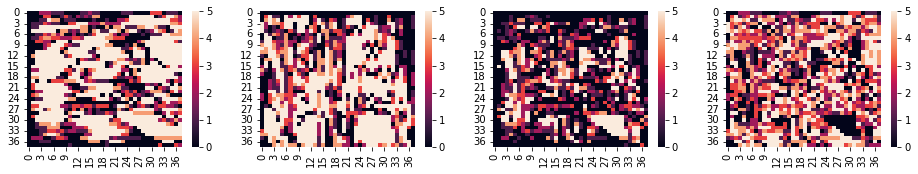

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


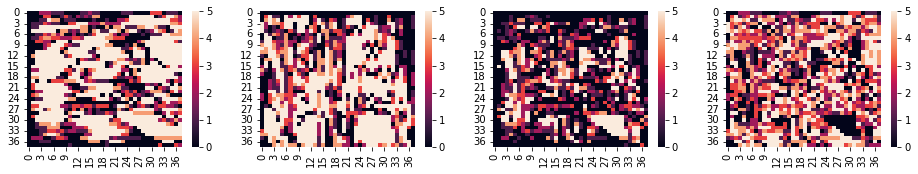

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


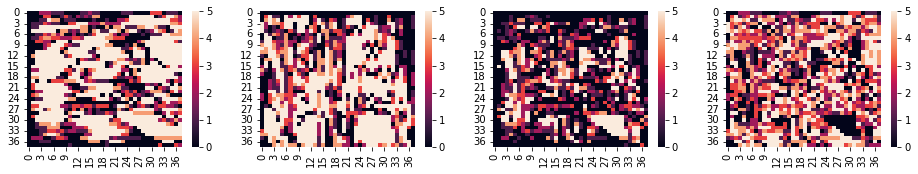

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


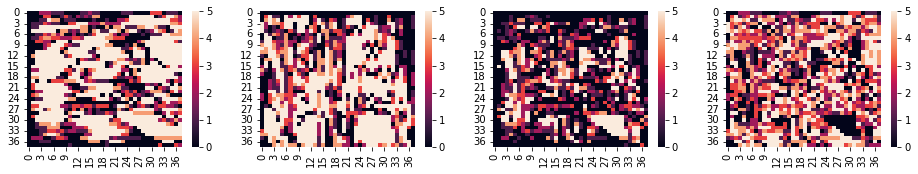

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


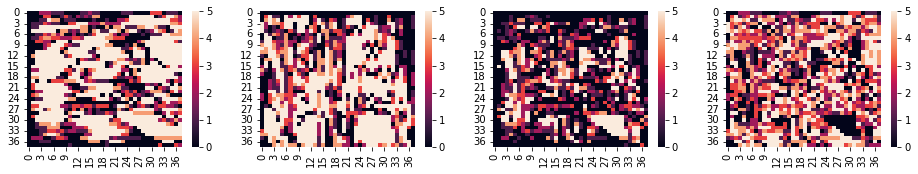

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


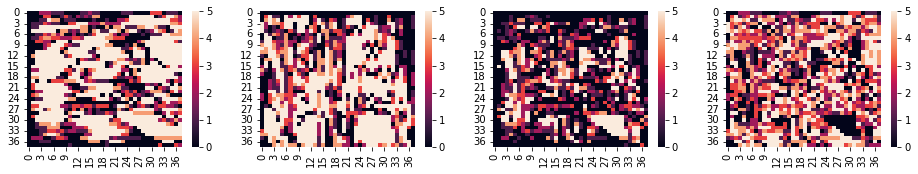

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


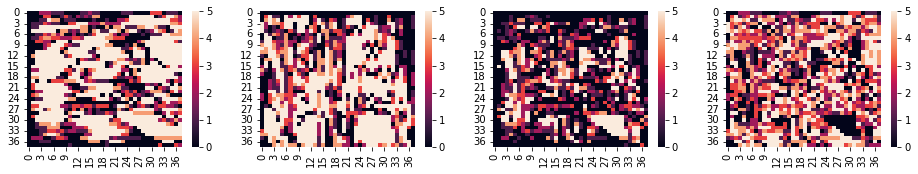

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


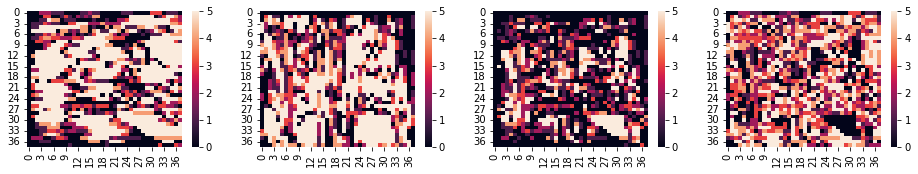

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


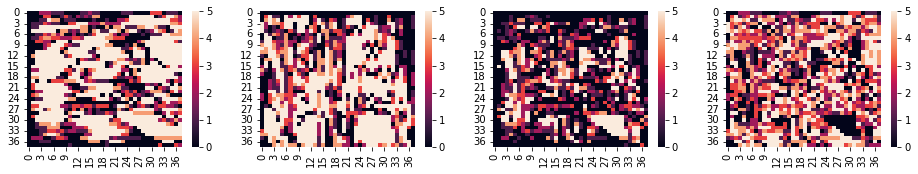

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


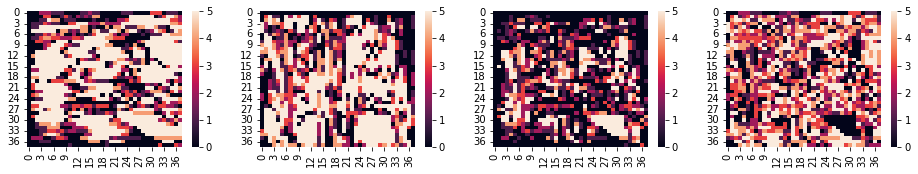

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


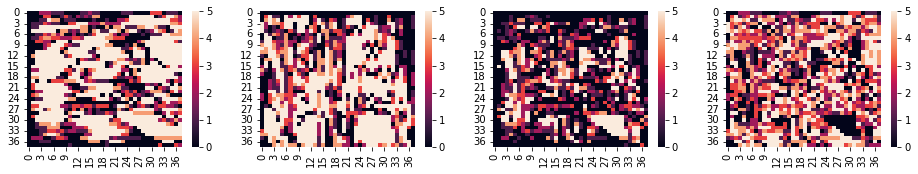

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


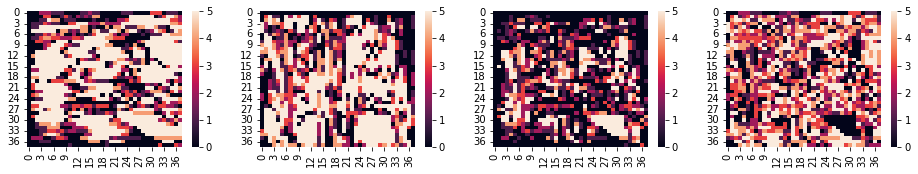

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


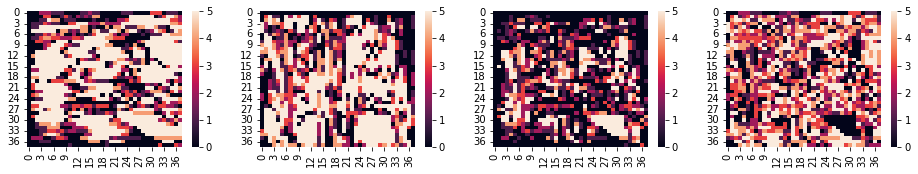

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


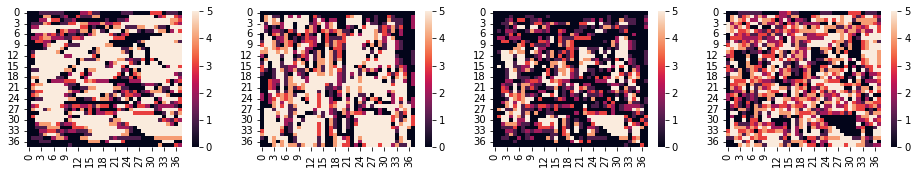

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


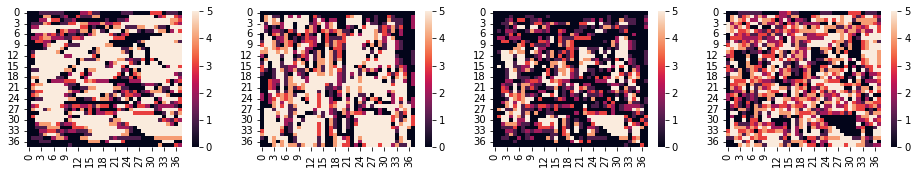

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


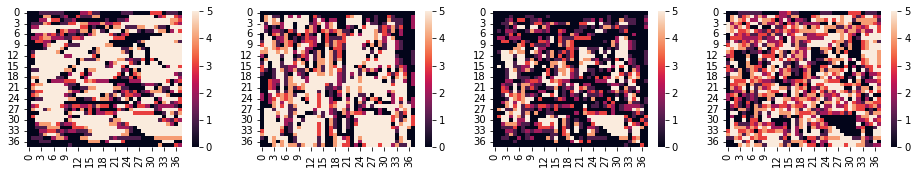

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


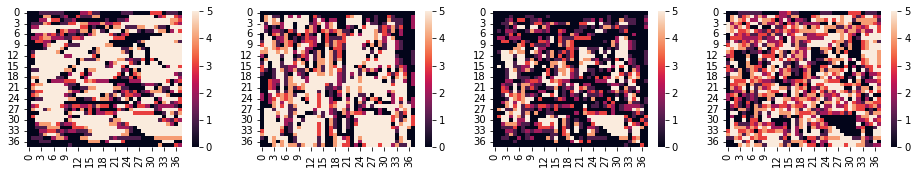

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


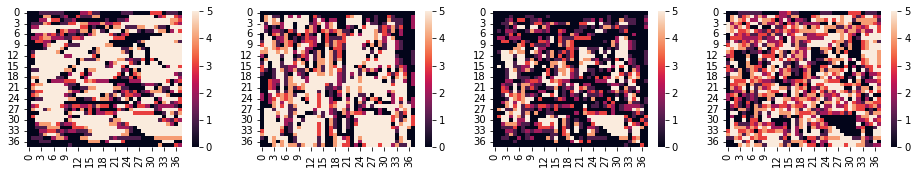

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


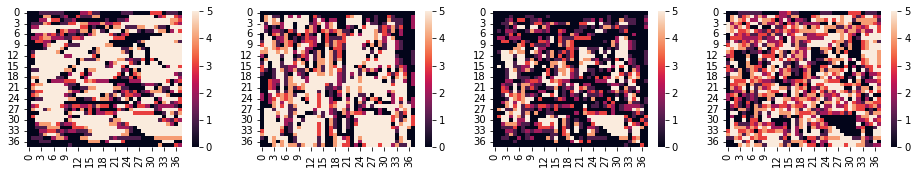

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


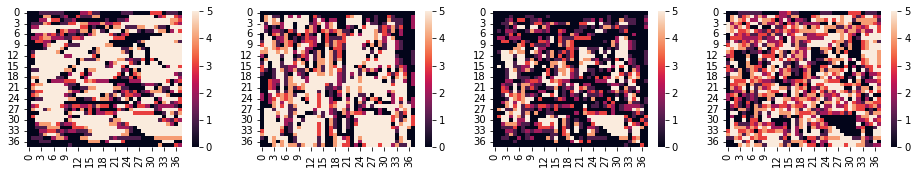

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


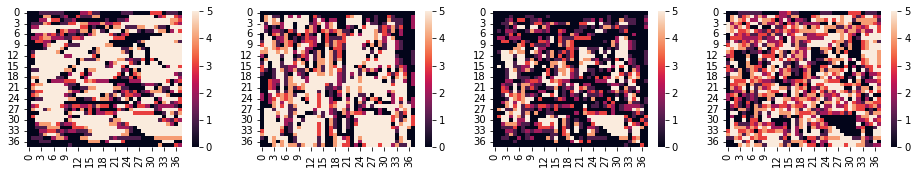

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


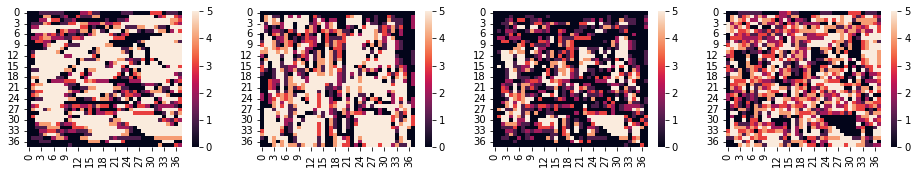

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


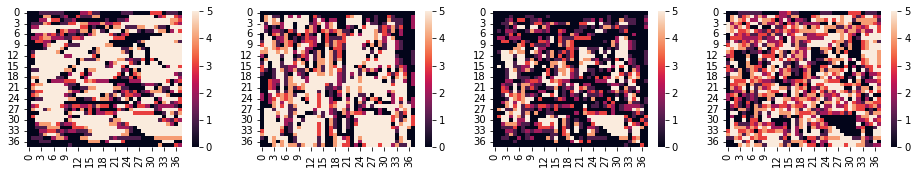

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


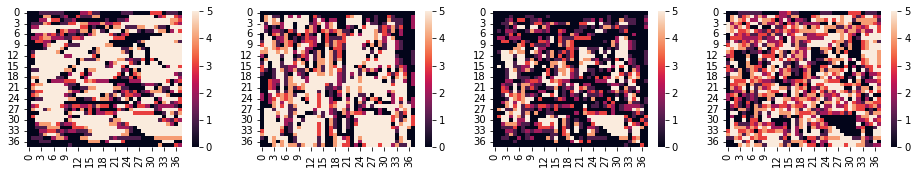

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


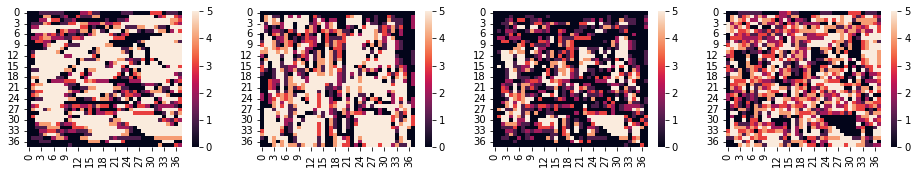

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


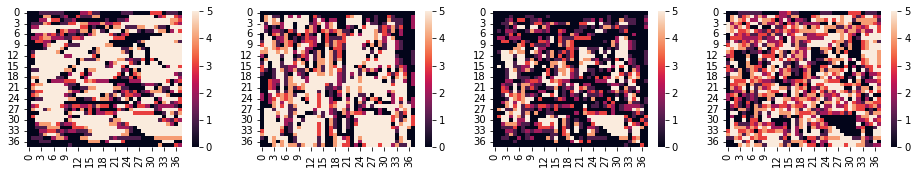

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


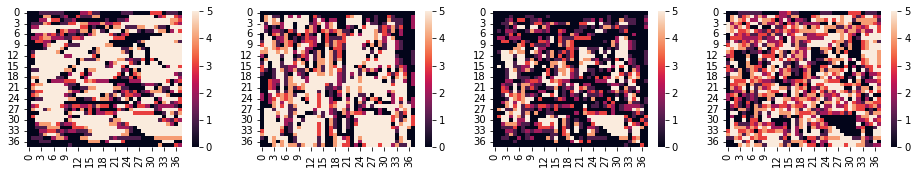

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


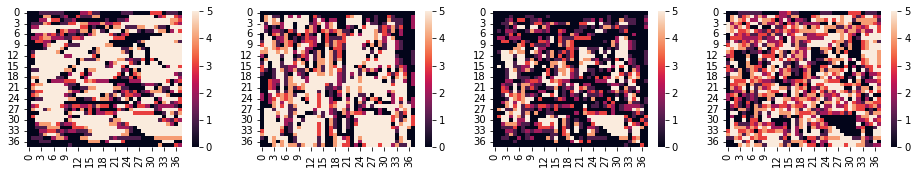

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


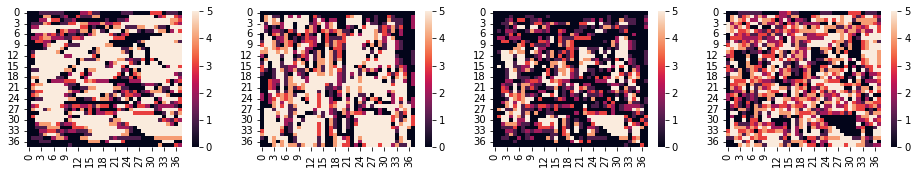

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


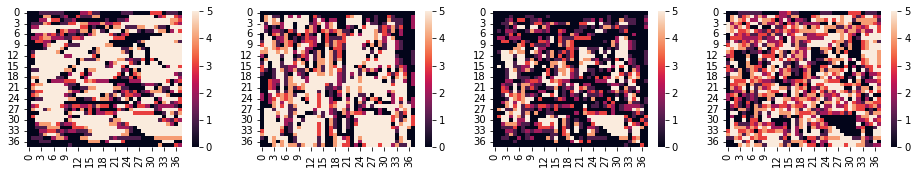

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


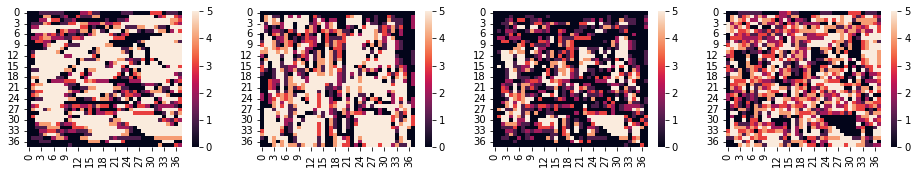

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


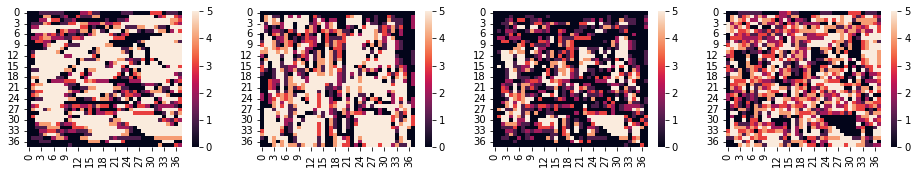

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


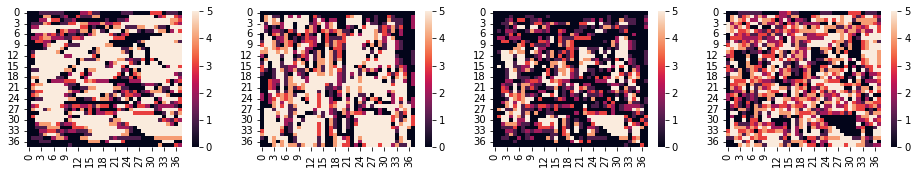

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


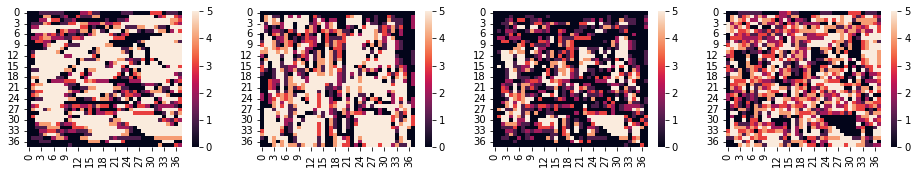

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


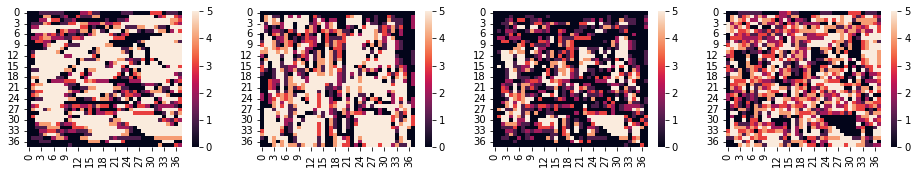

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


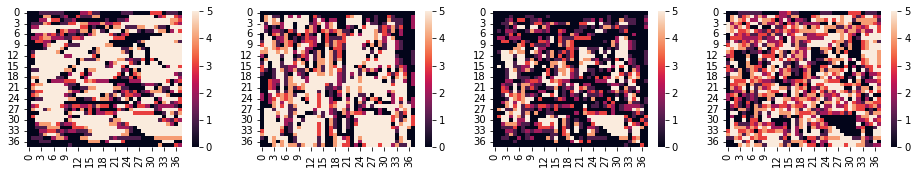

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


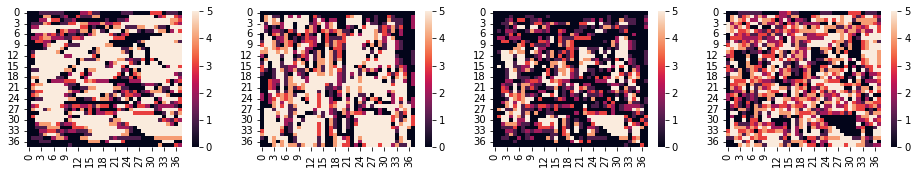

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


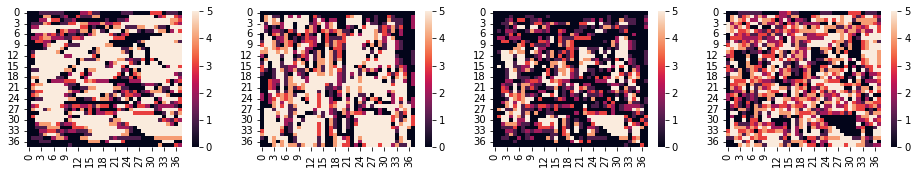

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


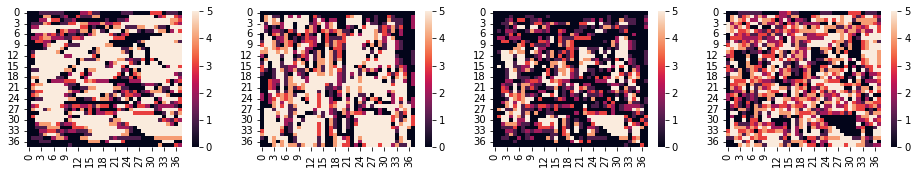

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


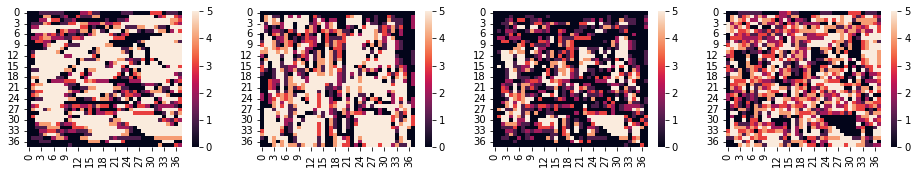

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


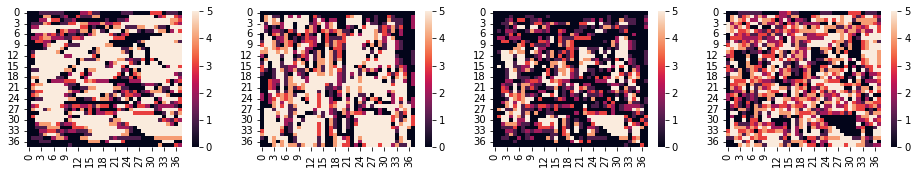

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


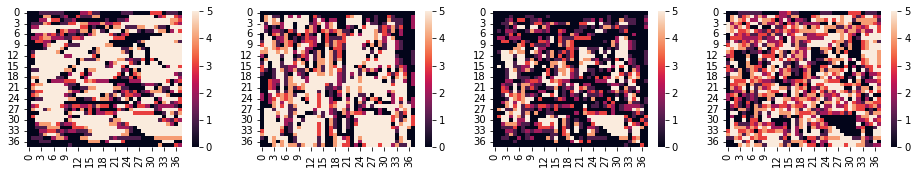

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


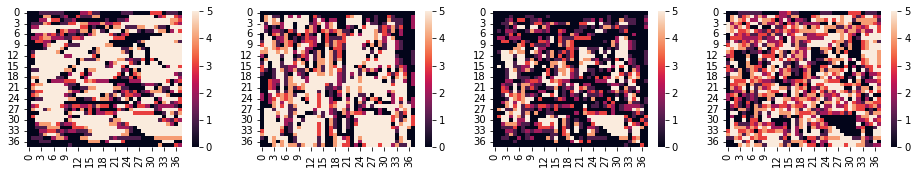

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


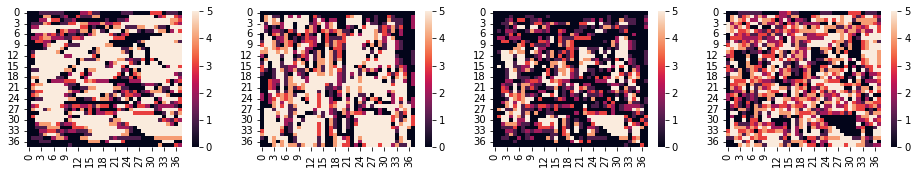

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


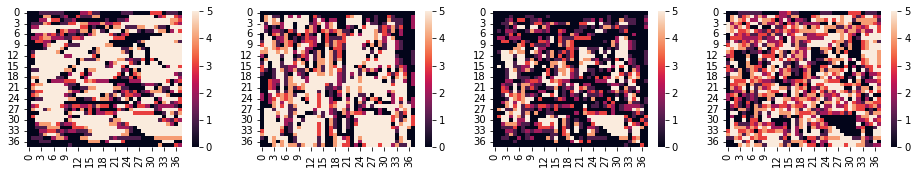

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


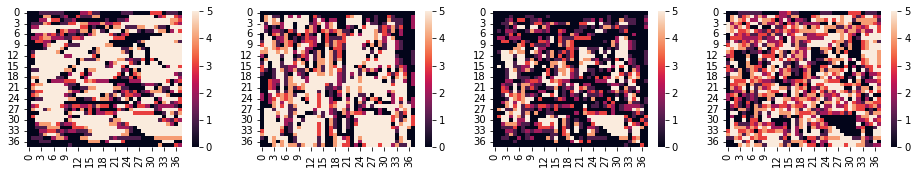

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


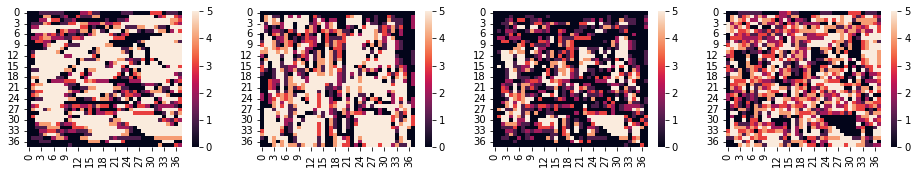

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


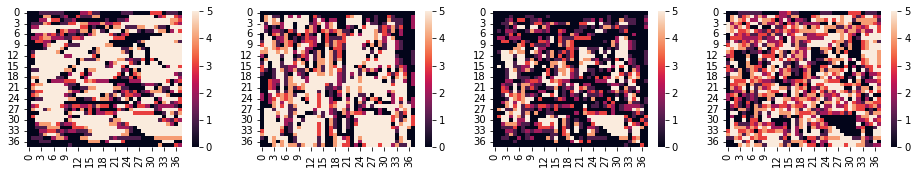

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


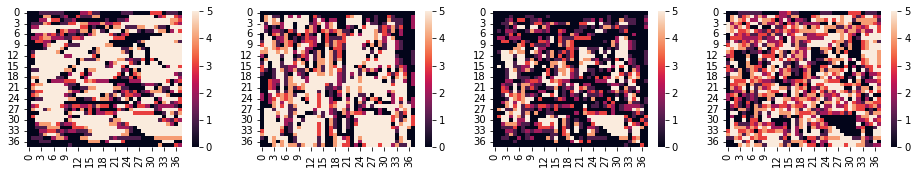

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


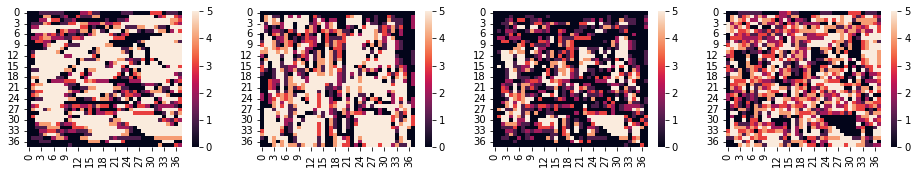

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


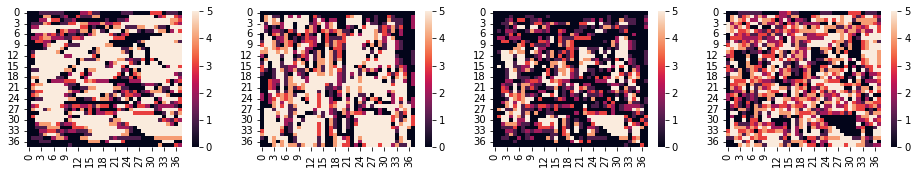

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


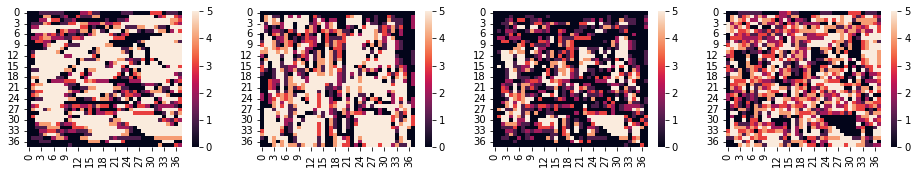

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


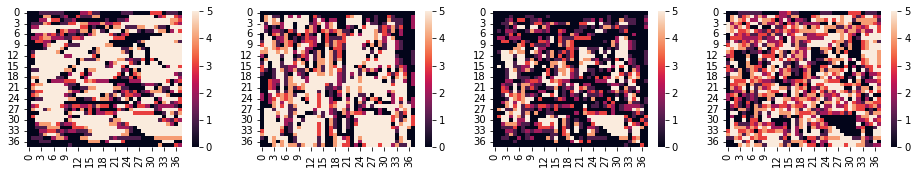

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


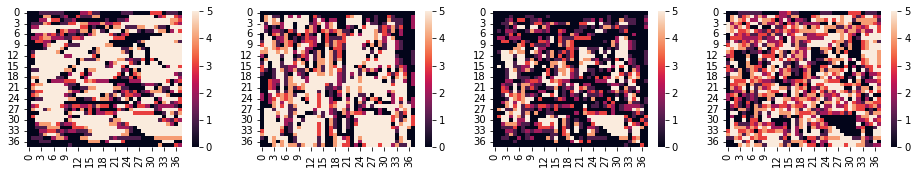

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


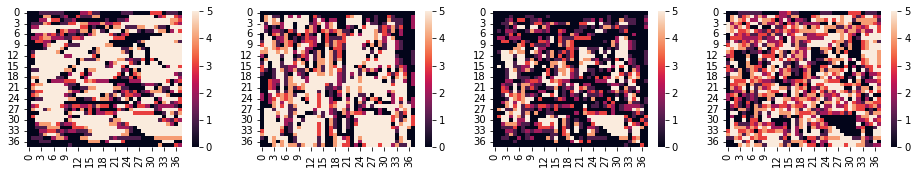

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


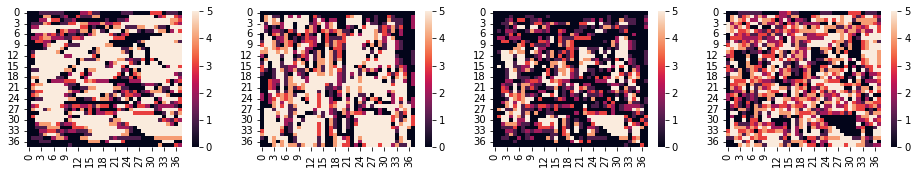

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


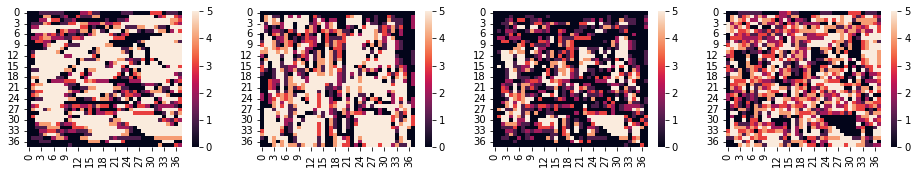

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


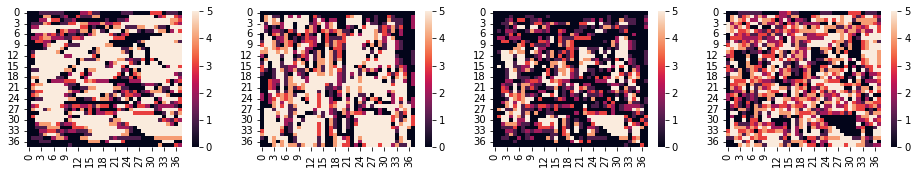

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


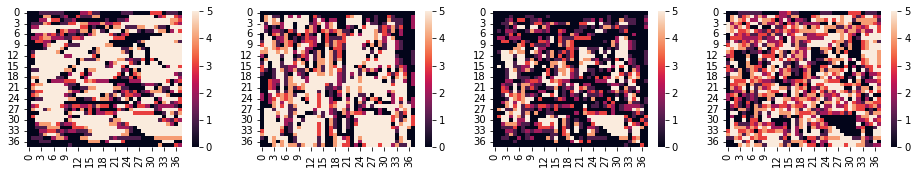

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


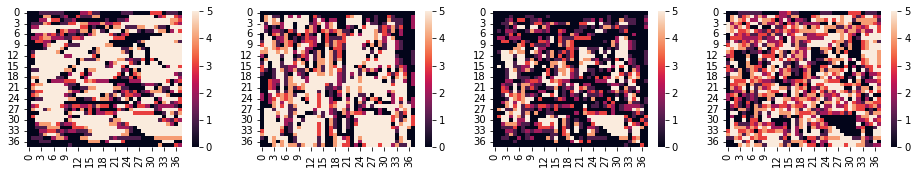

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


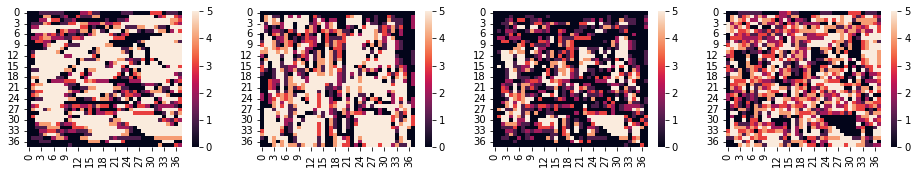

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


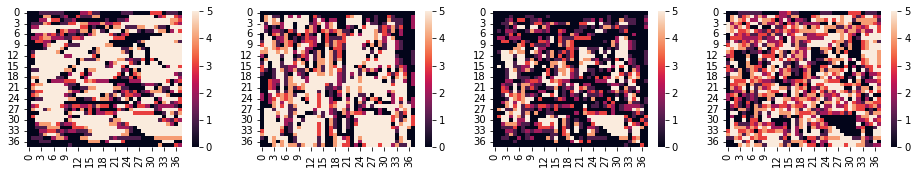

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


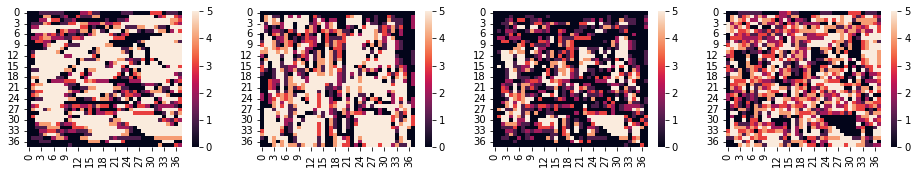

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


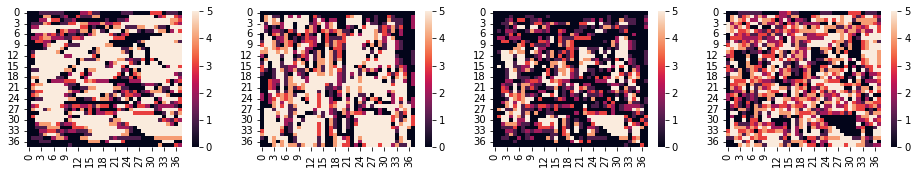

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


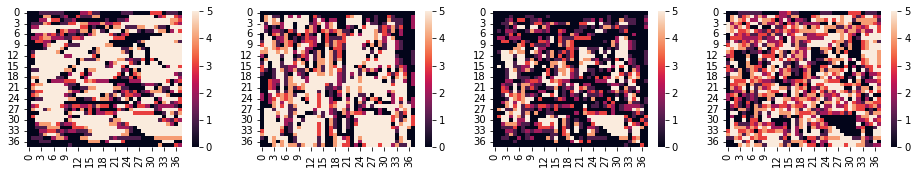

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


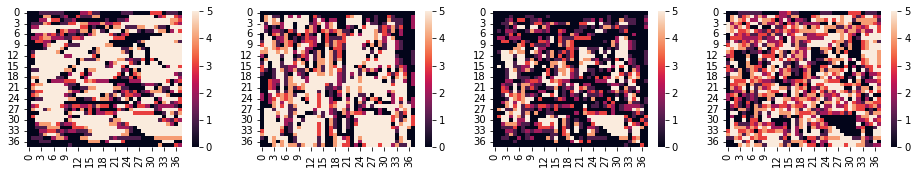

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


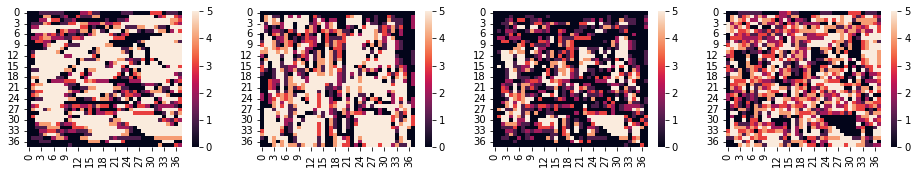

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


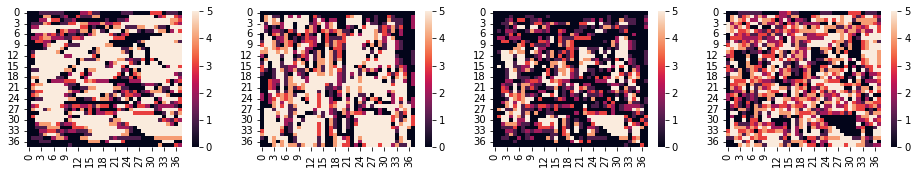

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


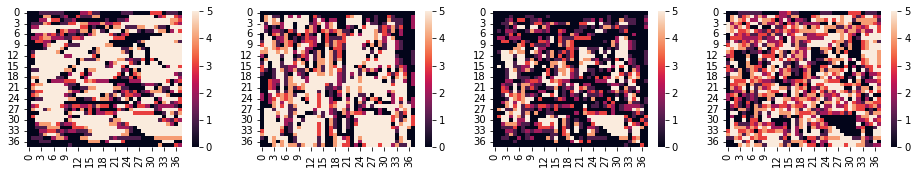

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


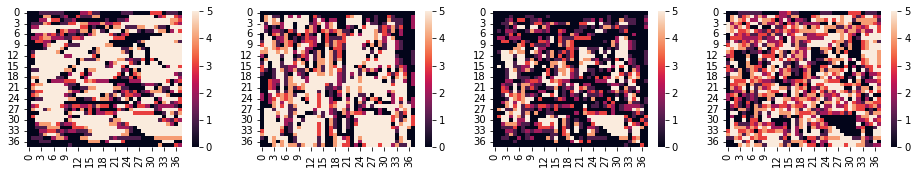

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


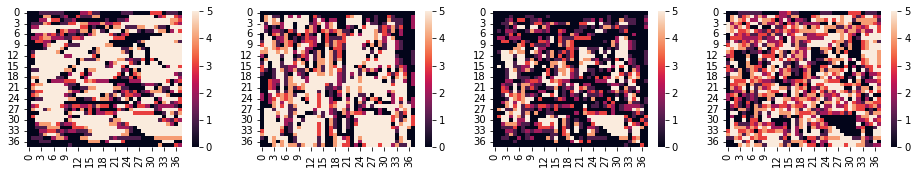

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


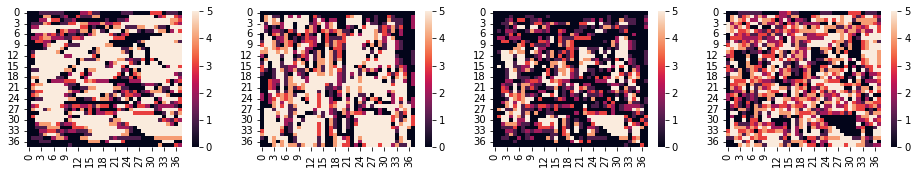

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


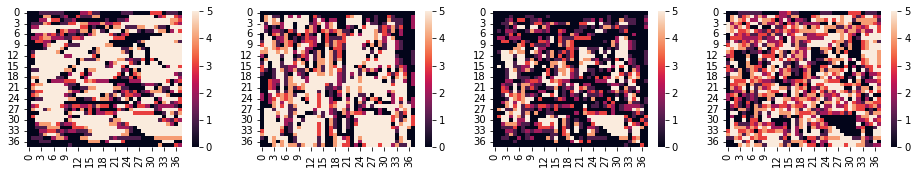

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


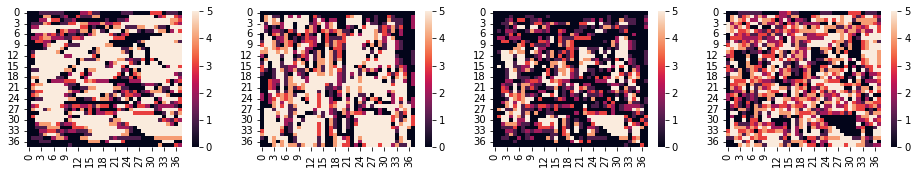

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


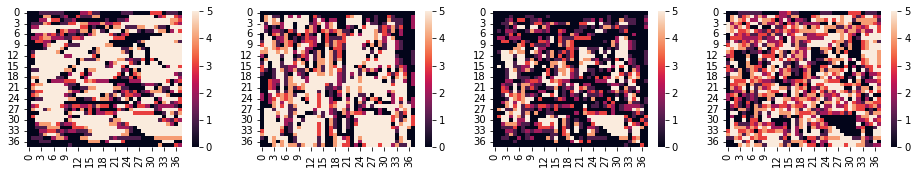

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


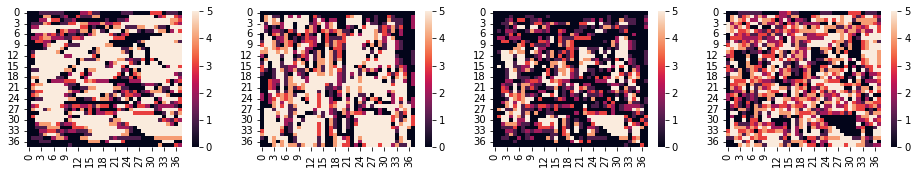

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


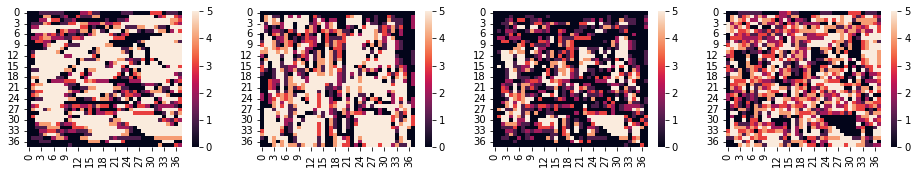

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


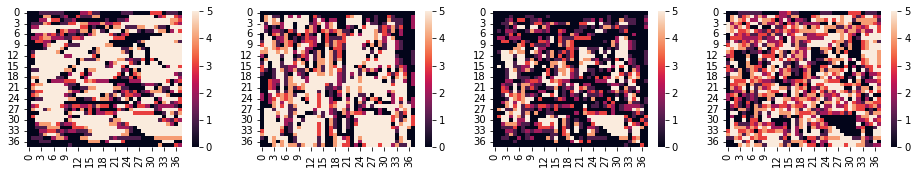

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


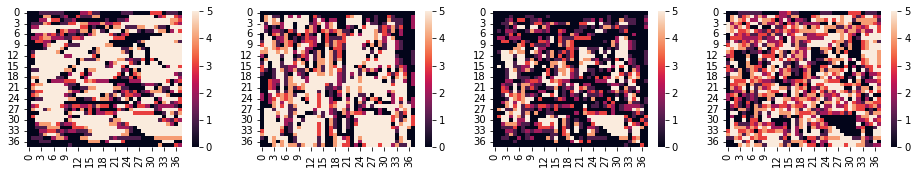

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


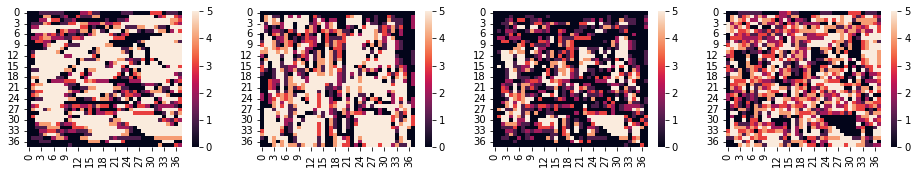

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


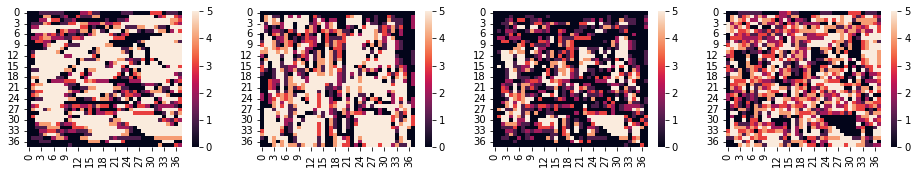

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


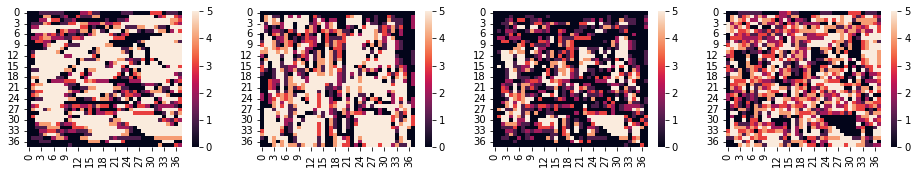

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


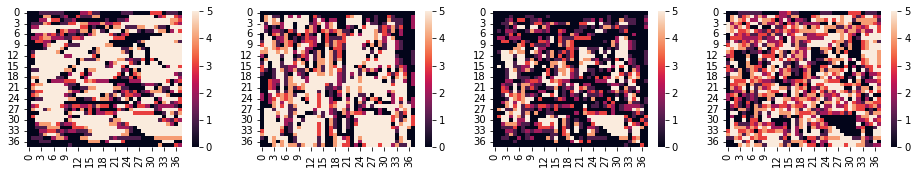

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


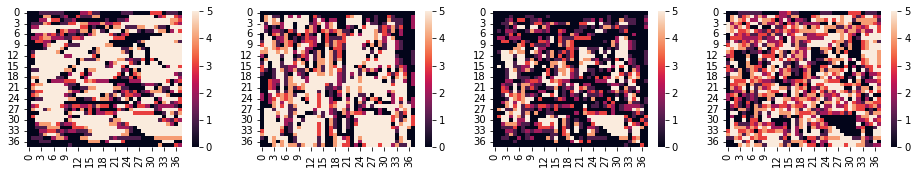

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


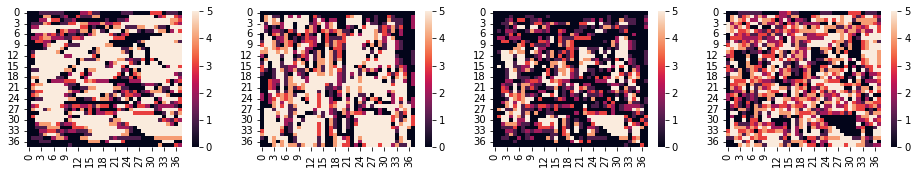

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


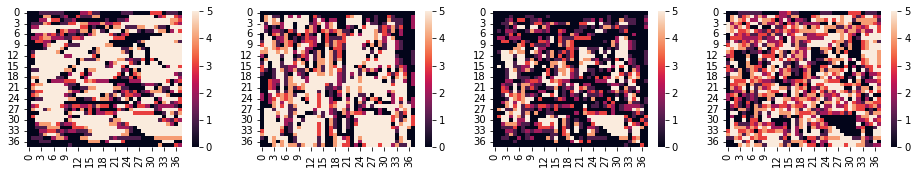

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


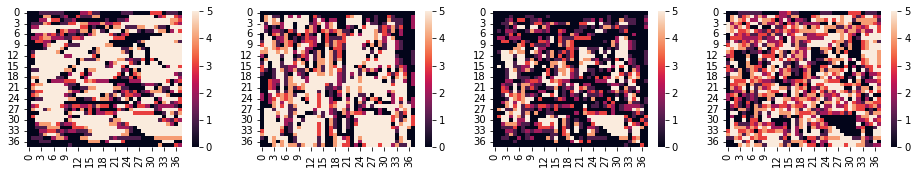

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


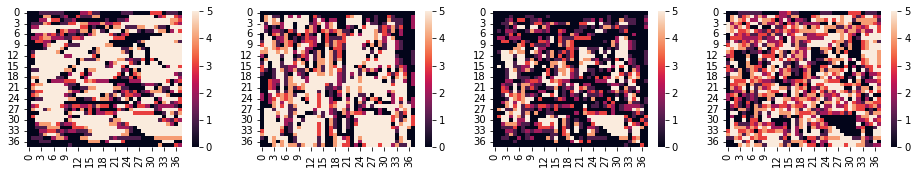

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


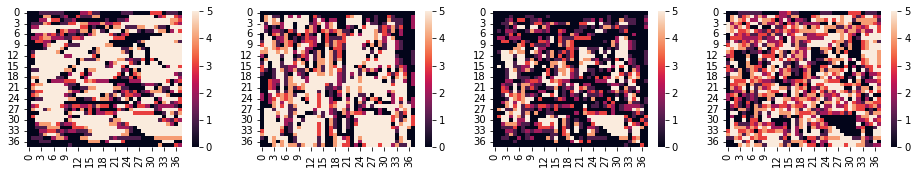

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


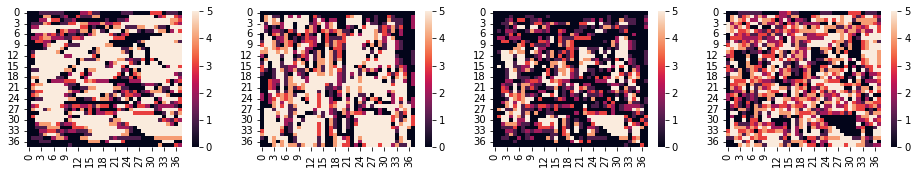

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


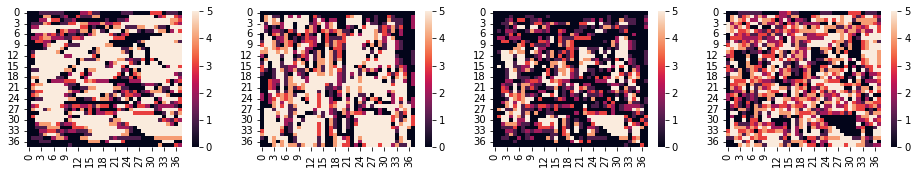

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


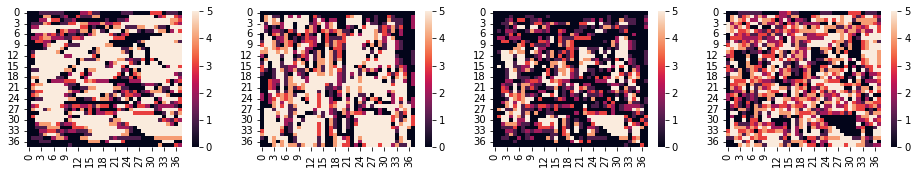

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


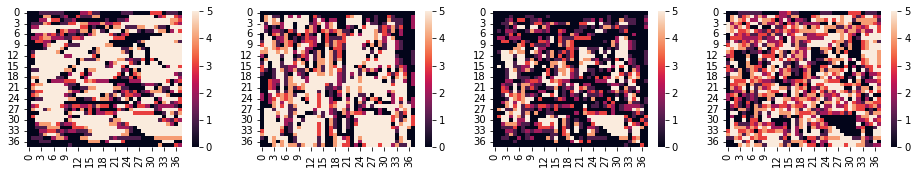

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


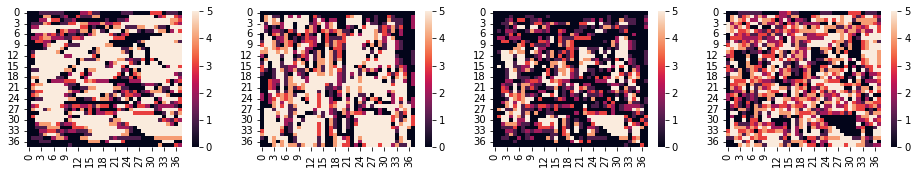

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


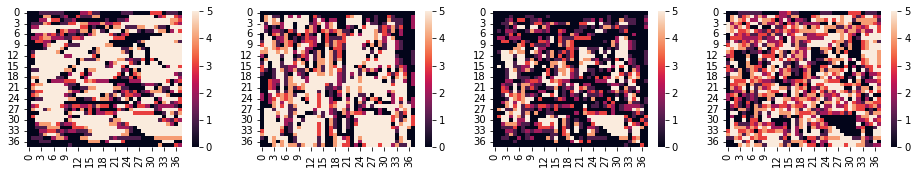

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


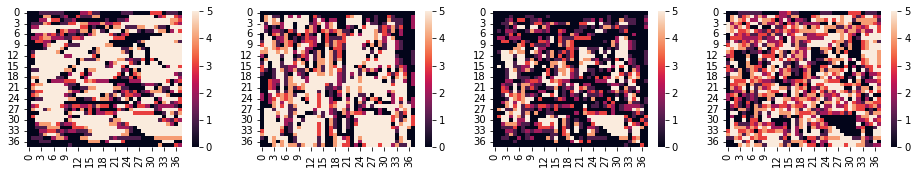

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


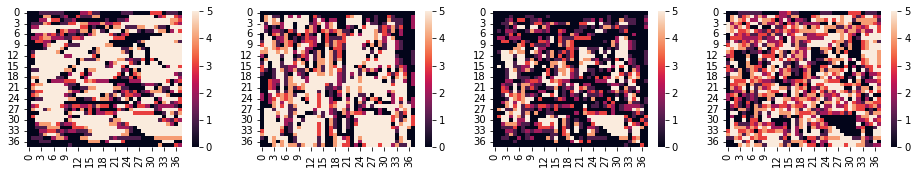

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


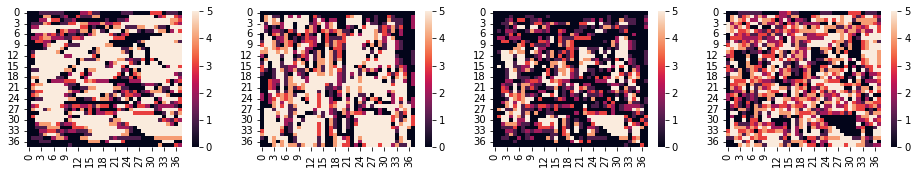

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


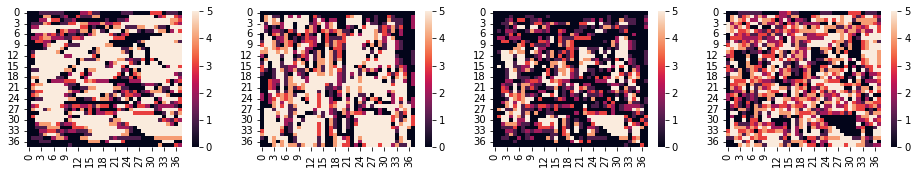

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


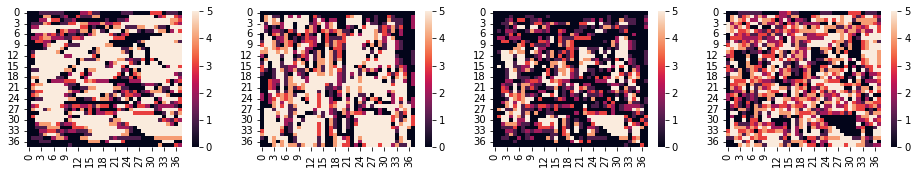

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


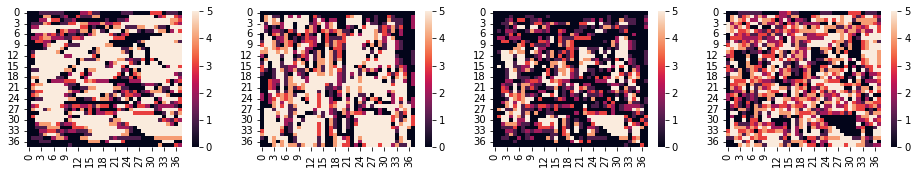

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


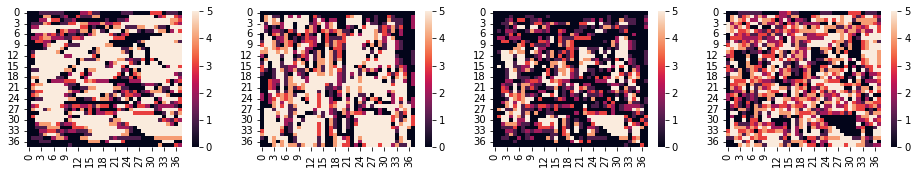

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


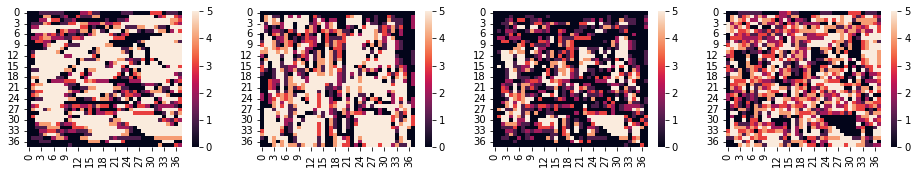

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


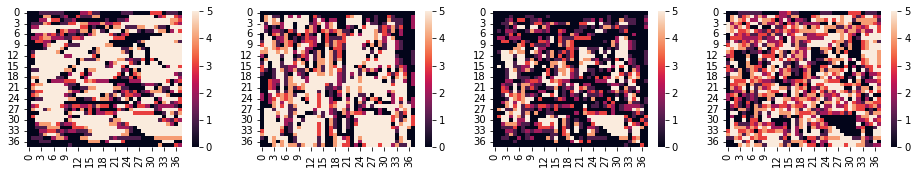

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


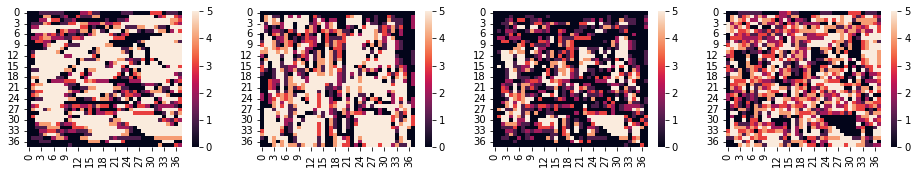

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


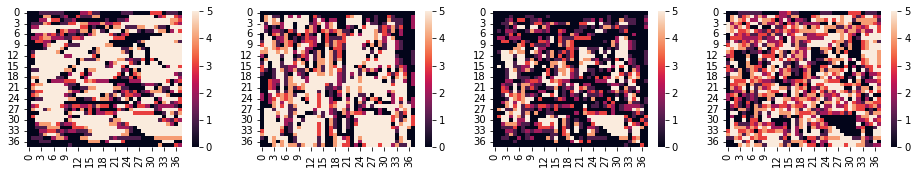

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


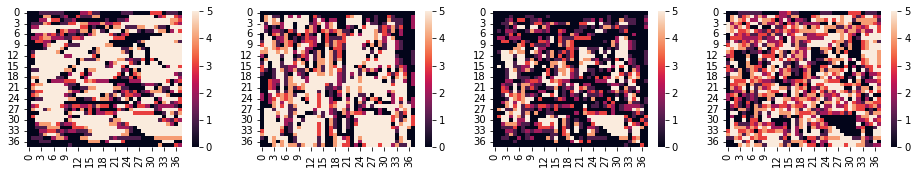

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


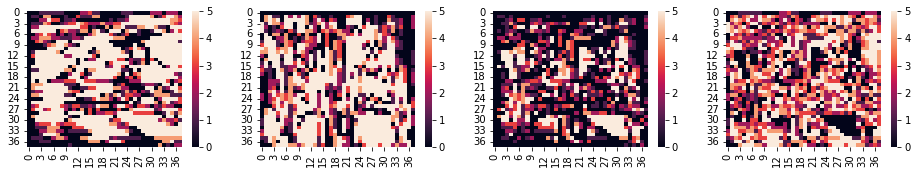

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


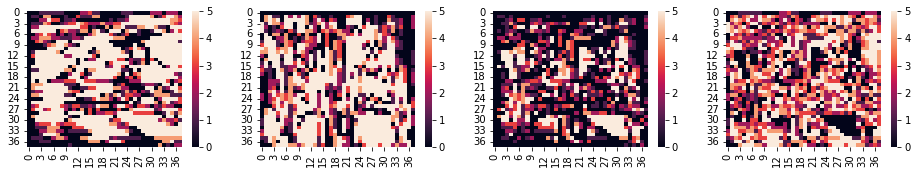

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


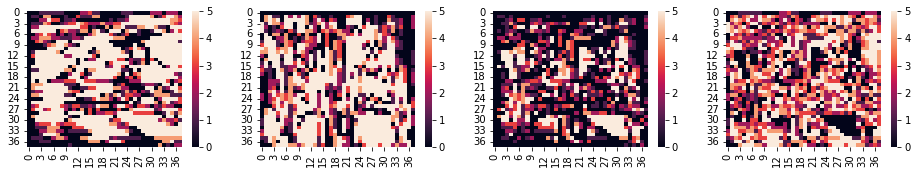

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


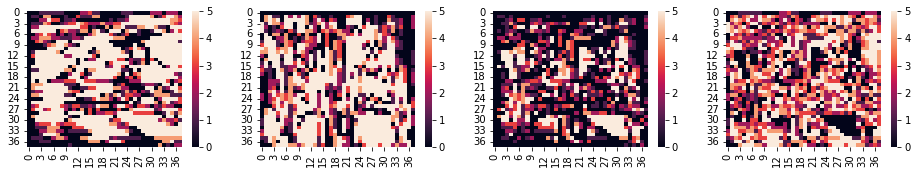

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


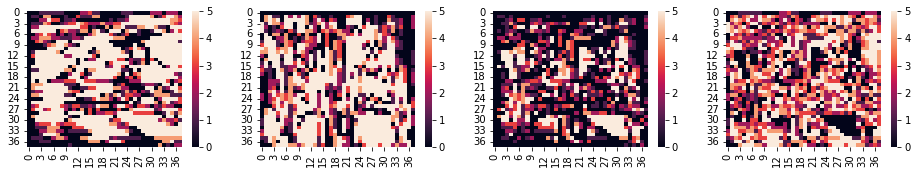

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


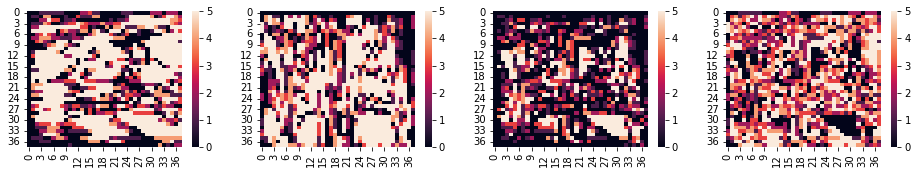

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


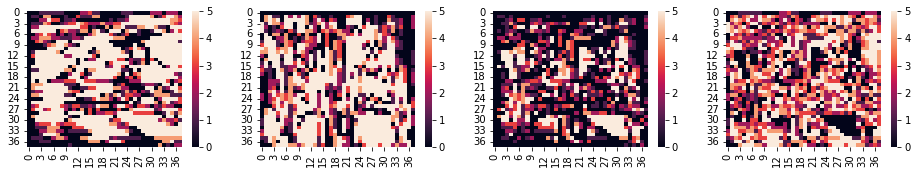

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


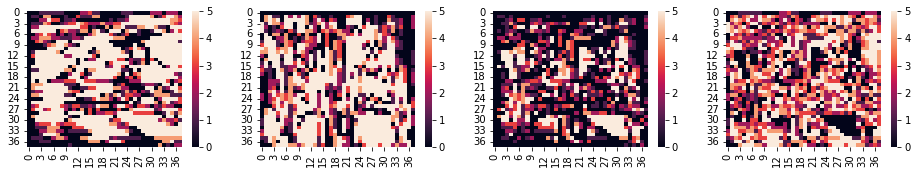

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


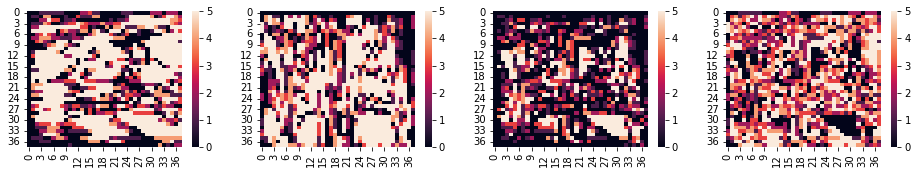

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


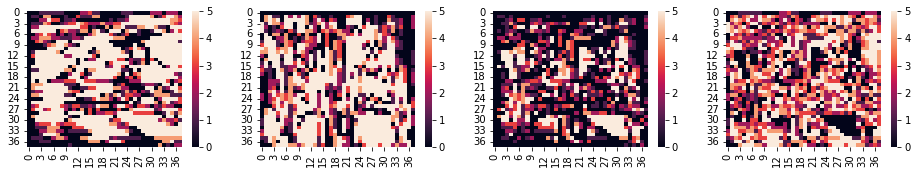

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


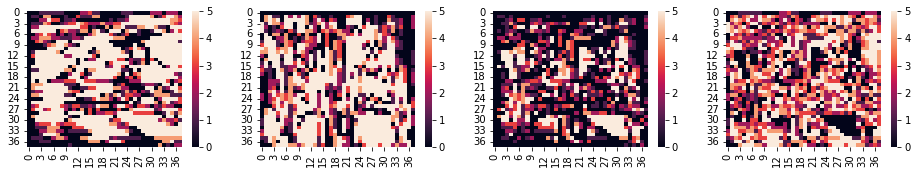

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


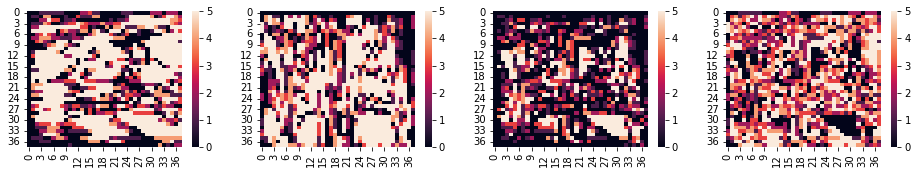

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


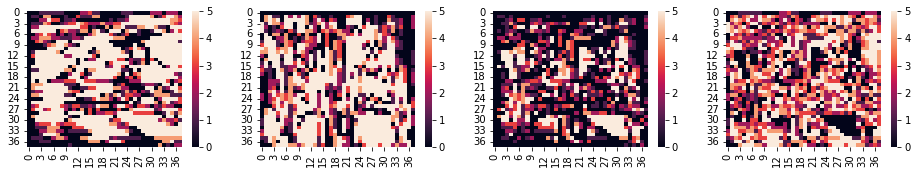

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


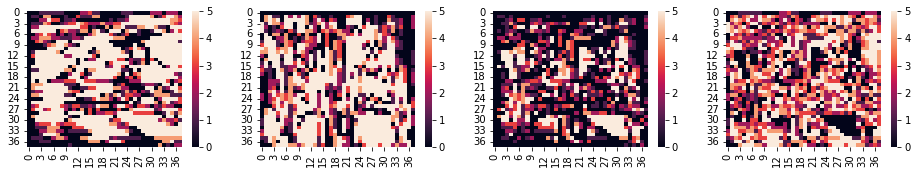

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


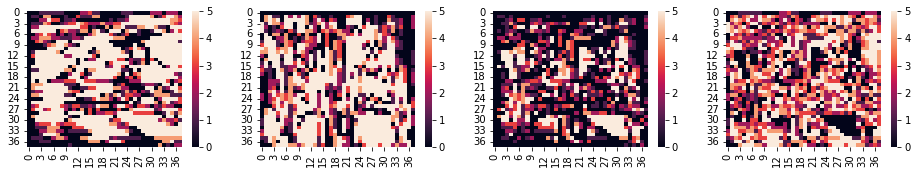

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


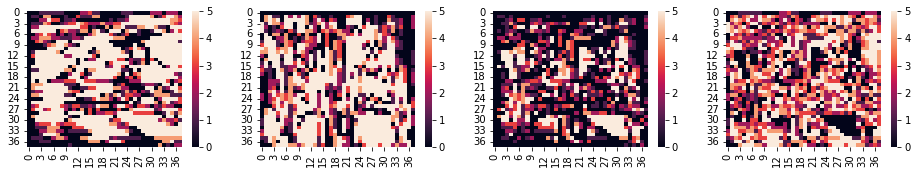

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


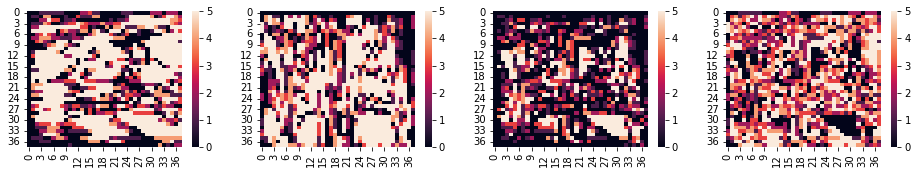

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


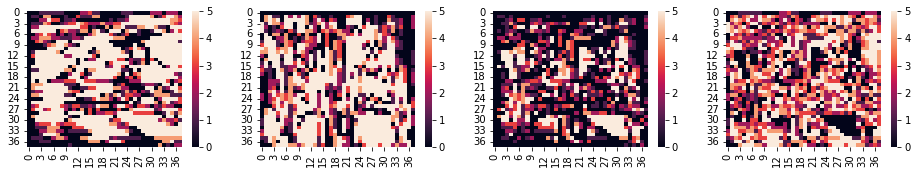

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


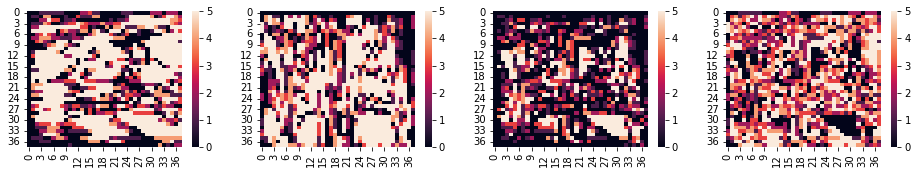

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


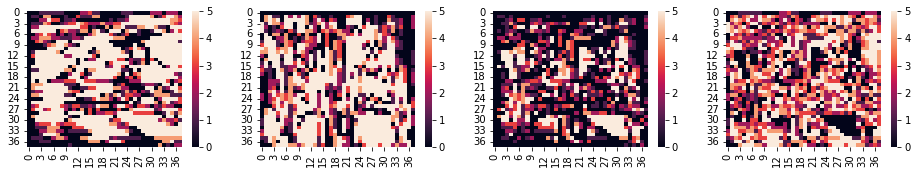

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


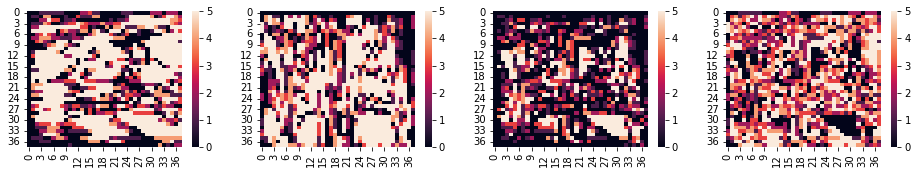

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


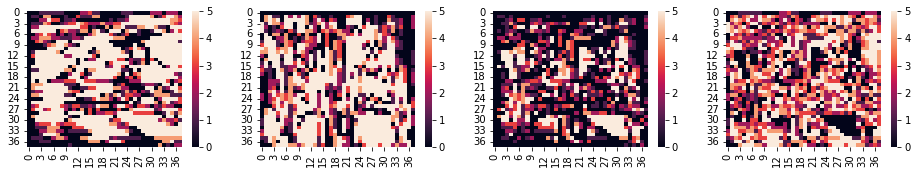

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


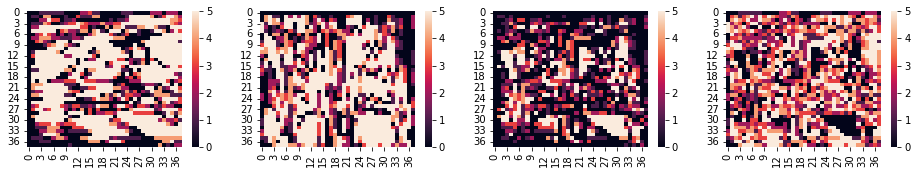

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


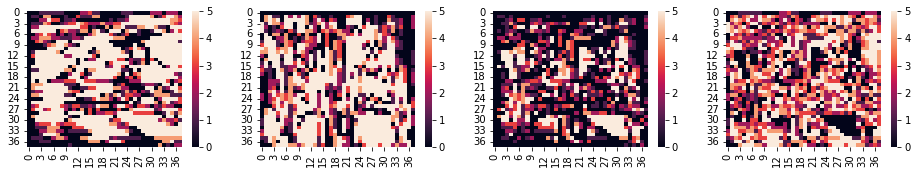

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


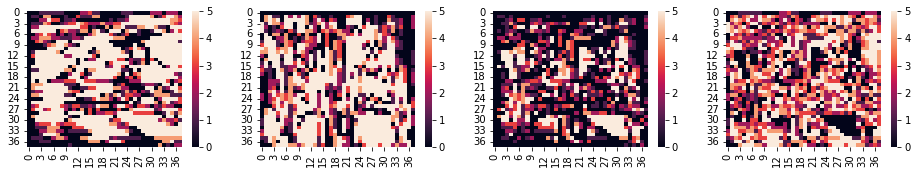

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


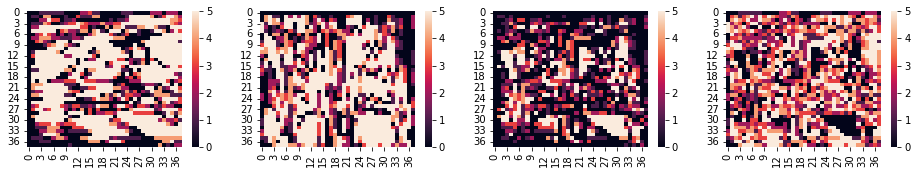

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


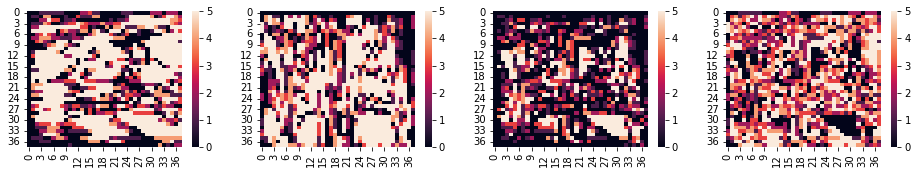

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


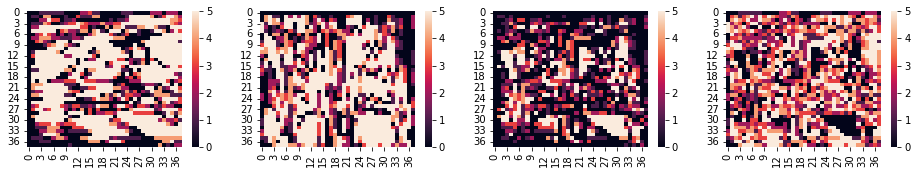

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


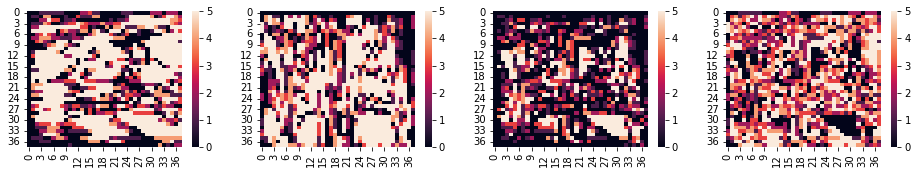

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


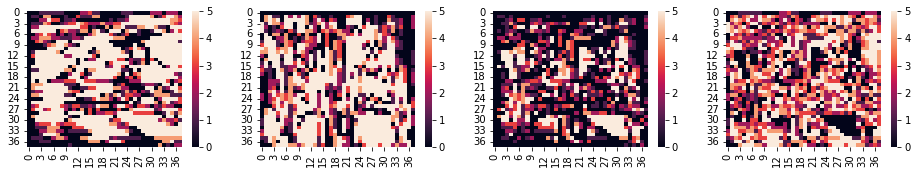

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


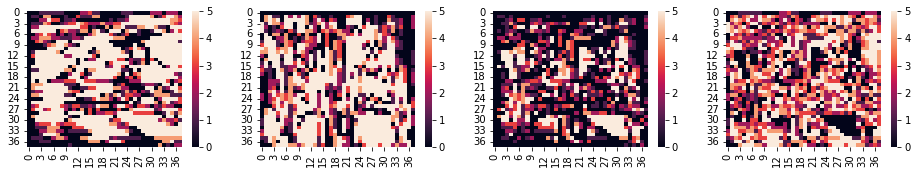

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


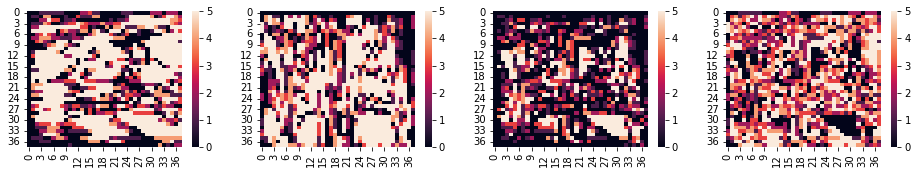

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


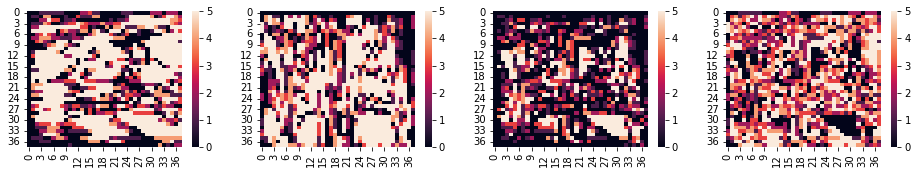

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


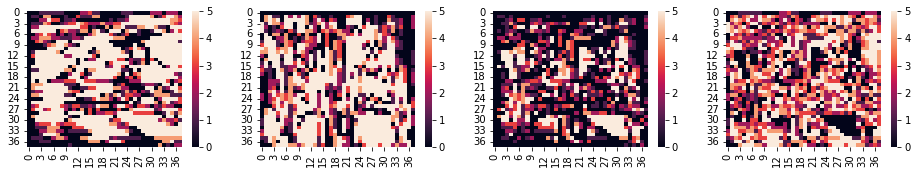

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


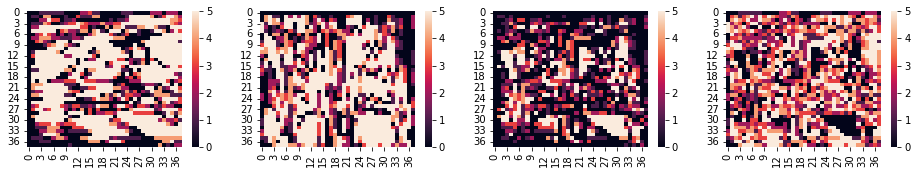

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


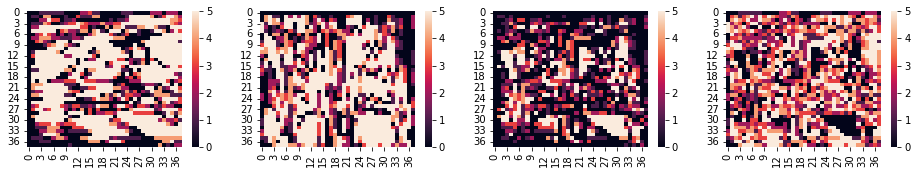

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


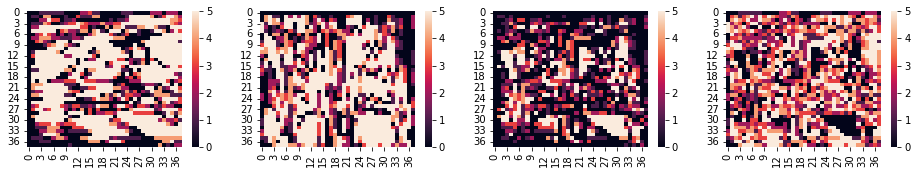

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


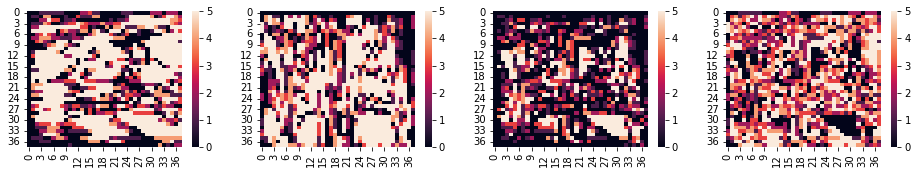

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


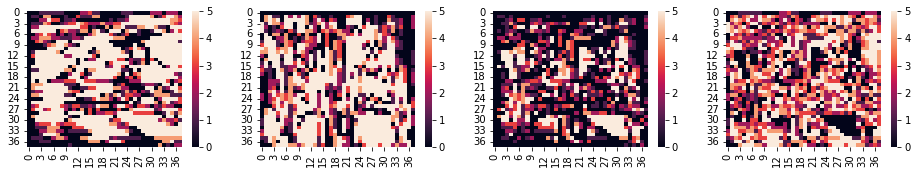

max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0
max fitness:  984.0 460.0


In [6]:
df = pd.read_csv('nonogram.csv')
M = Matrix(df.iloc[300])
M.solution,M.difficulty
aic = AIC(M)
air = AIR(M)
Fitness.setup(aic,air)

nai = 5
nchildren = 10
niteration = 10000
nshuffle = 10
mrate = 0.3

ais = np.array([AI(M,aic,air,aic.generate(),air.generate()) for _ in range(nai)])
goal = ais[0].goal
print('***goal**** ')
print(goal)


for n in range(niteration):
    
    S1, S2 = np.vstack([np.random.choice(ais,2,replace=False) for _ in range(nchildren)]).T    
    ais = np.append(ais,AI.crossover(S1, S2,mrate = mrate))
        
    fitness = list(map(lambda x: x.fitness,ais))
    ais = ais[np.argsort(fitness)[::-1][:nai]]
    print('max fitness: ',np.max(fitness), goal - np.max(fitness))
    
    if(not n%10):
        fig, (ax1,ax2,ax3,ax4) = plt.subplots(1,4,figsize = (16,2.5))
        sns.heatmap(np.sum(np.array([ai.C for ai in ais]),0),ax = ax1)
        sns.heatmap(np.sum(np.array([ai.R for ai in ais]),0),ax = ax2)
        sns.heatmap(np.sum(np.array([ai.C & ai.R for ai in ais]),0),ax = ax3)
        sns.heatmap(np.sum(np.array([ai.C ^ ai.R for ai in ais]),0),ax = ax4)
        plt.show()
